In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when ONI is removed as a predictor
df_trimmed = df_trimmed.drop(['ONI'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-20 23:58:07,946] A new study created in memory with name: no-name-dde087fc-8911-494e-89c6-0a4a8f4f8266
[I 2025-05-21 00:06:02,217] Trial 0 finished with value: 0.058322566002607344 and parameters: {'lr': 0.05891843281107494, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.11139627160786342}. Best is trial 0 with value: 0.058322566002607344.


Cross Validation Accuracies:
[0.05574357137084007, 0.05567898973822594, 0.06101219728589058, 0.06379520148038864, 0.0553828701376915]
Mean Cross Validation Accuracy:
0.058322566002607344
Standard Deviation of Cross Validation Accuracy:
0.003448633818403306


[I 2025-05-21 00:15:01,787] Trial 1 finished with value: 0.05275154113769531 and parameters: {'lr': 0.4309040716874003, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.34171028791223956}. Best is trial 1 with value: 0.05275154113769531.


Cross Validation Accuracies:
[0.04671493545174599, 0.04986303672194481, 0.056641433387994766, 0.061663802713155746, 0.048874497413635254]
Mean Cross Validation Accuracy:
0.05275154113769531
Standard Deviation of Cross Validation Accuracy:
0.005556531330139111


[I 2025-05-21 00:22:22,688] Trial 2 finished with value: 0.0824507862329483 and parameters: {'lr': 0.044164968111029594, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.21108479840346953}. Best is trial 1 with value: 0.05275154113769531.


Cross Validation Accuracies:
[0.07001562416553497, 0.11262262612581253, 0.09220175445079803, 0.07211373001337051, 0.06530019640922546]
Mean Cross Validation Accuracy:
0.0824507862329483
Standard Deviation of Cross Validation Accuracy:
0.017669476630264302


[I 2025-05-21 00:35:03,473] Trial 3 finished with value: 0.05607124492526054 and parameters: {'lr': 0.0559537417019566, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.35197990225327036}. Best is trial 1 with value: 0.05275154113769531.


Cross Validation Accuracies:
[0.04417237639427185, 0.05672008916735649, 0.05576680600643158, 0.06502647697925568, 0.05867047607898712]
Mean Cross Validation Accuracy:
0.05607124492526054
Standard Deviation of Cross Validation Accuracy:
0.006768292812149257


[I 2025-05-21 00:42:05,593] Trial 4 finished with value: 0.051412643492221834 and parameters: {'lr': 0.04802022347868649, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.1996555290458024}. Best is trial 4 with value: 0.051412643492221834.


Cross Validation Accuracies:
[0.04194111377000809, 0.047469671815633774, 0.05547327175736427, 0.0626155287027359, 0.049563631415367126]
Mean Cross Validation Accuracy:
0.051412643492221834
Standard Deviation of Cross Validation Accuracy:
0.007080523787533478


[I 2025-05-21 00:51:11,796] Trial 5 finished with value: 0.05542194172739982 and parameters: {'lr': 0.017094748646015998, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12297736180505857}. Best is trial 4 with value: 0.051412643492221834.


Cross Validation Accuracies:
[0.05152541771531105, 0.04831281676888466, 0.05737780034542084, 0.06382570415735245, 0.056067969650030136]
Mean Cross Validation Accuracy:
0.05542194172739982
Standard Deviation of Cross Validation Accuracy:
0.005302612847307561


[I 2025-05-21 00:59:17,257] Trial 6 finished with value: 0.051174584031105044 and parameters: {'lr': 0.011735984749685624, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.36583523122262107}. Best is trial 6 with value: 0.051174584031105044.


Cross Validation Accuracies:
[0.04261802136898041, 0.04542333260178566, 0.056889381259679794, 0.06255166232585907, 0.048390522599220276]
Mean Cross Validation Accuracy:
0.051174584031105044
Standard Deviation of Cross Validation Accuracy:
0.0074315472620351515


[I 2025-05-21 01:09:56,934] Trial 7 finished with value: 0.06314039006829261 and parameters: {'lr': 0.0025179170296910866, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.37901769043647626}. Best is trial 6 with value: 0.051174584031105044.


Cross Validation Accuracies:
[0.051847055554389954, 0.05591228976845741, 0.06573226302862167, 0.07805638015270233, 0.06415396183729172]
Mean Cross Validation Accuracy:
0.06314039006829261
Standard Deviation of Cross Validation Accuracy:
0.009055569907620267


[I 2025-05-21 01:15:59,541] Trial 8 finished with value: 0.04922466278076172 and parameters: {'lr': 0.307029694255516, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.27372747688080207}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.039780620485544205, 0.046494726091623306, 0.05550680309534073, 0.059640880674123764, 0.04470028355717659]
Mean Cross Validation Accuracy:
0.04922466278076172
Standard Deviation of Cross Validation Accuracy:
0.007281145221645076


[I 2025-05-21 01:22:10,309] Trial 9 finished with value: 0.4818878471851349 and parameters: {'lr': 0.0012611570208884025, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.18959370892761154}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.4852270185947418, 0.490329384803772, 0.48100554943084717, 0.4654592275619507, 0.4874180555343628]
Mean Cross Validation Accuracy:
0.4818878471851349
Standard Deviation of Cross Validation Accuracy:
0.00875980387344335


[I 2025-05-21 01:30:13,047] Trial 10 finished with value: 0.058339571207761766 and parameters: {'lr': 0.8835480978330209, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.48334139233140183}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.051330339163541794, 0.050085362046957016, 0.06283091008663177, 0.06934516876935959, 0.05810607597231865]
Mean Cross Validation Accuracy:
0.058339571207761766
Standard Deviation of Cross Validation Accuracy:
0.007191816534891655


[I 2025-05-21 01:38:37,864] Trial 11 finished with value: 0.267778280377388 and parameters: {'lr': 0.009051599208177144, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.28039467689021164}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.2982405424118042, 0.2829359769821167, 0.23063477873802185, 0.23300041258335114, 0.2940796911716461]
Mean Cross Validation Accuracy:
0.267778280377388
Standard Deviation of Cross Validation Accuracy:
0.0297946612221581


[I 2025-05-21 01:46:41,993] Trial 12 finished with value: 0.05751852914690971 and parameters: {'lr': 0.17790386995914895, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.45607013110742367}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.044715434312820435, 0.056038107722997665, 0.06083172932267189, 0.0704033374786377, 0.05560403689742088]
Mean Cross Validation Accuracy:
0.05751852914690971
Standard Deviation of Cross Validation Accuracy:
0.00832792587198579


[I 2025-05-21 01:53:09,832] Trial 13 finished with value: 0.3562532067298889 and parameters: {'lr': 0.006646530942614969, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.26567559083356523}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.3623002767562866, 0.36962825059890747, 0.32758137583732605, 0.33263757824897766, 0.3891185522079468]
Mean Cross Validation Accuracy:
0.3562532067298889
Standard Deviation of Cross Validation Accuracy:
0.02313163021956981


[I 2025-05-21 01:59:56,071] Trial 14 finished with value: 0.055252452939748765 and parameters: {'lr': 0.1693648733949656, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4016950218814678}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04706530272960663, 0.04768211022019386, 0.059596363455057144, 0.06291680783033371, 0.059001680463552475]
Mean Cross Validation Accuracy:
0.055252452939748765
Standard Deviation of Cross Validation Accuracy:
0.006572794214548873


[I 2025-05-21 02:08:24,538] Trial 15 finished with value: 0.05080052465200424 and parameters: {'lr': 0.1721011718129236, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.42689974354197013}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04180162772536278, 0.04588526859879494, 0.05529852211475372, 0.06182906776666641, 0.04918813705444336]
Mean Cross Validation Accuracy:
0.05080052465200424
Standard Deviation of Cross Validation Accuracy:
0.007065414724367695


[I 2025-05-21 02:16:50,353] Trial 16 finished with value: 1.0095977902412414 and parameters: {'lr': 0.19740508786618507, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4262522020358359}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.7753267884254456, 0.9580156803131104, 0.8537731170654297, 1.3460214138031006, 1.114851951599121]
Mean Cross Validation Accuracy:
1.0095977902412414
Standard Deviation of Cross Validation Accuracy:
0.20301932819335458


[I 2025-05-21 02:26:11,566] Trial 17 finished with value: 0.054539091885089874 and parameters: {'lr': 0.43355359558962775, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3091604372303199}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04722995683550835, 0.04477116838097572, 0.05659262835979462, 0.07046066969633102, 0.05364103615283966]
Mean Cross Validation Accuracy:
0.054539091885089874
Standard Deviation of Cross Validation Accuracy:
0.009026139162519306


[I 2025-05-21 02:33:44,169] Trial 18 finished with value: 0.050904926657676694 and parameters: {'lr': 0.13512006042164465, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24977925433352594}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04254759103059769, 0.04544813930988312, 0.056323274970054626, 0.06124182045459747, 0.04896380752325058]
Mean Cross Validation Accuracy:
0.050904926657676694
Standard Deviation of Cross Validation Accuracy:
0.006922418684820897


[I 2025-05-21 02:42:45,894] Trial 19 finished with value: 3.583577823638916 and parameters: {'lr': 0.6601063363232655, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.320751657596289}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[3.3907201290130615, 4.015238285064697, 3.7322158813476562, 3.3572654724121094, 3.4224493503570557]
Mean Cross Validation Accuracy:
3.583577823638916
Standard Deviation of Cross Validation Accuracy:
0.25408572638150817


[I 2025-05-21 02:48:13,191] Trial 20 finished with value: 0.05209379866719246 and parameters: {'lr': 0.3390948274417073, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.42954921057449574}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.044496554881334305, 0.04958527162671089, 0.0540342815220356, 0.06535351276397705, 0.04699937254190445]
Mean Cross Validation Accuracy:
0.05209379866719246
Standard Deviation of Cross Validation Accuracy:
0.007342336007552538


[I 2025-05-21 02:54:03,951] Trial 21 finished with value: 0.050507758557796475 and parameters: {'lr': 0.14832936339008312, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24526231662135525}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04110223054885864, 0.0443798303604126, 0.05669717863202095, 0.060949839651584625, 0.049409713596105576]
Mean Cross Validation Accuracy:
0.050507758557796475
Standard Deviation of Cross Validation Accuracy:
0.00741035953623793


[I 2025-05-21 03:01:08,775] Trial 22 finished with value: 0.05058673545718193 and parameters: {'lr': 0.08775473394358456, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24191689279589831}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0416838638484478, 0.04539952054619789, 0.0553533174097538, 0.062108173966407776, 0.048388801515102386]
Mean Cross Validation Accuracy:
0.05058673545718193
Standard Deviation of Cross Validation Accuracy:
0.007300179228766111


[I 2025-05-21 03:07:49,566] Trial 23 finished with value: 0.05097638517618179 and parameters: {'lr': 0.0860613067031404, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.22404610471098896}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04306517541408539, 0.0446401983499527, 0.0556405633687973, 0.06296885013580322, 0.048567138612270355]
Mean Cross Validation Accuracy:
0.05097638517618179
Standard Deviation of Cross Validation Accuracy:
0.007404225096830938


[I 2025-05-21 03:13:49,489] Trial 24 finished with value: 0.050673481076955795 and parameters: {'lr': 0.08434358934546138, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.17406602729935355}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04190734028816223, 0.045015834271907806, 0.05624586343765259, 0.062470220029354095, 0.047728147357702255]
Mean Cross Validation Accuracy:
0.050673481076955795
Standard Deviation of Cross Validation Accuracy:
0.007586088287150737


[I 2025-05-21 03:22:08,937] Trial 25 finished with value: 0.05166111066937447 and parameters: {'lr': 0.022729560374304392, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.23534076223911812}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.044298481196165085, 0.04581662639975548, 0.056801795959472656, 0.06281766295433044, 0.048570986837148666]
Mean Cross Validation Accuracy:
0.05166111066937447
Standard Deviation of Cross Validation Accuracy:
0.0070542253802224585


[I 2025-05-21 03:28:50,432] Trial 26 finished with value: 0.05073136612772942 and parameters: {'lr': 0.28259583395686994, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1567574910355038}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.045389577746391296, 0.044571686536073685, 0.05309498682618141, 0.06105007231235504, 0.049550507217645645]
Mean Cross Validation Accuracy:
0.05073136612772942
Standard Deviation of Cross Validation Accuracy:
0.0059988862912904945


[I 2025-05-21 03:35:05,472] Trial 27 finished with value: 0.050776638090610504 and parameters: {'lr': 0.09164821414899613, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.27014914694085757}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0417151041328907, 0.04552093520760536, 0.05598647519946098, 0.06262395530939102, 0.04803672060370445]
Mean Cross Validation Accuracy:
0.050776638090610504
Standard Deviation of Cross Validation Accuracy:
0.007546420161633728


[I 2025-05-21 03:41:20,001] Trial 28 finished with value: 0.18451630175113679 and parameters: {'lr': 0.029910829107837558, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.2969470582768451}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.2185036540031433, 0.14268921315670013, 0.16753023862838745, 0.1738298237323761, 0.2200285792350769]
Mean Cross Validation Accuracy:
0.18451630175113679
Standard Deviation of Cross Validation Accuracy:
0.030227452616258175


[I 2025-05-21 03:48:39,880] Trial 29 finished with value: 57.00103607177734 and parameters: {'lr': 0.5835919481903314, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.10652033469026126}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[57.802921295166016, 58.772830963134766, 66.47040557861328, 56.26148986816406, 45.697532653808594]
Mean Cross Validation Accuracy:
57.00103607177734
Standard Deviation of Cross Validation Accuracy:
6.65984014842449


[I 2025-05-21 03:58:32,754] Trial 30 finished with value: 0.08161590099334717 and parameters: {'lr': 0.11826575850107708, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24087947796007644}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.07850585877895355, 0.0772291049361229, 0.08386233448982239, 0.09501318633556366, 0.07346902042627335]
Mean Cross Validation Accuracy:
0.08161590099334717
Standard Deviation of Cross Validation Accuracy:
0.007480932070163564


[I 2025-05-21 04:04:39,488] Trial 31 finished with value: 0.0504643015563488 and parameters: {'lr': 0.09176816526305907, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.15814592358356194}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04198785126209259, 0.04496157914400101, 0.05530964955687523, 0.061990901827812195, 0.04807152599096298]
Mean Cross Validation Accuracy:
0.0504643015563488
Standard Deviation of Cross Validation Accuracy:
0.00726905013752091


[I 2025-05-21 04:09:50,997] Trial 32 finished with value: 0.05025300160050392 and parameters: {'lr': 0.253257618793313, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1562877151982431}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.041175153106451035, 0.04603995382785797, 0.057208288460969925, 0.06005748361349106, 0.04678412899374962]
Mean Cross Validation Accuracy:
0.05025300160050392
Standard Deviation of Cross Validation Accuracy:
0.007165110813264859


[I 2025-05-21 04:15:52,226] Trial 33 finished with value: 0.0496908575296402 and parameters: {'lr': 0.27258113383585153, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.16278225068072255}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04179564490914345, 0.044937774538993835, 0.05190882459282875, 0.06050070747733116, 0.04931133612990379]
Mean Cross Validation Accuracy:
0.0496908575296402
Standard Deviation of Cross Validation Accuracy:
0.006431834116590141


[I 2025-05-21 04:23:46,635] Trial 34 finished with value: 0.04997677877545357 and parameters: {'lr': 0.26126844147330786, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1343890708476798}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.043029434978961945, 0.043166302144527435, 0.054979369044303894, 0.05959974601864815, 0.049109041690826416]
Mean Cross Validation Accuracy:
0.04997677877545357
Standard Deviation of Cross Validation Accuracy:
0.006527305008603025


[I 2025-05-21 04:29:56,713] Trial 35 finished with value: 0.050626975297927854 and parameters: {'lr': 0.29940702558236154, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.13205614627332246}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04207957908511162, 0.044918403029441833, 0.05526411905884743, 0.06203616037964821, 0.048836614936590195]
Mean Cross Validation Accuracy:
0.050626975297927854
Standard Deviation of Cross Validation Accuracy:
0.007218362363794542


[I 2025-05-21 04:37:06,577] Trial 36 finished with value: 4.457945728302002 and parameters: {'lr': 0.863977138912649, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1426834581156341}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[4.77188777923584, 3.738696336746216, 5.723546028137207, 4.927459239959717, 3.1281392574310303]
Mean Cross Validation Accuracy:
4.457945728302002
Standard Deviation of Cross Validation Accuracy:
0.9172187967045095


[I 2025-05-21 04:44:27,957] Trial 37 finished with value: 0.05343364477157593 and parameters: {'lr': 0.4701612842547453, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1850361170817807}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04503932222723961, 0.046458467841148376, 0.06203880533576012, 0.06361190229654312, 0.050019726157188416]
Mean Cross Validation Accuracy:
0.05343364477157593
Standard Deviation of Cross Validation Accuracy:
0.007853894563523568


[I 2025-05-21 04:53:55,053] Trial 38 finished with value: 2.5715009212493896 and parameters: {'lr': 0.26081323697680353, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10129774203544747}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[2.6045784950256348, 2.1770846843719482, 2.5046701431274414, 3.115264654159546, 2.455906629562378]
Mean Cross Validation Accuracy:
2.5715009212493896
Standard Deviation of Cross Validation Accuracy:
0.3066482298017974


[I 2025-05-21 05:00:22,047] Trial 39 finished with value: 0.05109976306557655 and parameters: {'lr': 0.05606063225933993, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.20641331117004263}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042513877153396606, 0.045736148953437805, 0.056225523352622986, 0.0626295879483223, 0.04839367792010307]
Mean Cross Validation Accuracy:
0.05109976306557655
Standard Deviation of Cross Validation Accuracy:
0.007335106957672826


[I 2025-05-21 05:06:34,618] Trial 40 finished with value: 0.0505246490240097 and parameters: {'lr': 0.2418796462928354, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.16618109935354403}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04444798454642296, 0.04332686960697174, 0.05552290380001068, 0.06181807816028595, 0.04750740900635719]
Mean Cross Validation Accuracy:
0.0505246490240097
Standard Deviation of Cross Validation Accuracy:
0.0070761813076762456


[I 2025-05-21 05:13:02,408] Trial 41 finished with value: 0.05330533459782601 and parameters: {'lr': 0.45011680915156393, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14443081005399916}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04413100704550743, 0.05224442109465599, 0.053533364087343216, 0.06683329492807388, 0.0497845858335495]
Mean Cross Validation Accuracy:
0.05330533459782601
Standard Deviation of Cross Validation Accuracy:
0.007493293047845446


[I 2025-05-21 05:19:47,332] Trial 42 finished with value: 0.05041094496846199 and parameters: {'lr': 0.3687446366630814, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.12486435701769007}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04507012665271759, 0.0477280467748642, 0.05427710711956024, 0.05974721908569336, 0.045232225209474564]
Mean Cross Validation Accuracy:
0.05041094496846199
Standard Deviation of Cross Validation Accuracy:
0.005738547647476616


[I 2025-05-21 05:26:15,388] Trial 43 finished with value: 0.055991463363170624 and parameters: {'lr': 0.6955199841014523, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1273365505436475}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04376726597547531, 0.04752594605088234, 0.06458215415477753, 0.0702415406703949, 0.053840409964323044]
Mean Cross Validation Accuracy:
0.055991463363170624
Standard Deviation of Cross Validation Accuracy:
0.01002584347974325


[I 2025-05-21 05:33:05,245] Trial 44 finished with value: 0.051496551185846326 and parameters: {'lr': 0.3413235114339014, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.11888742012350252}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04436395317316055, 0.04233395308256149, 0.05406585708260536, 0.06686800718307495, 0.049850985407829285]
Mean Cross Validation Accuracy:
0.051496551185846326
Standard Deviation of Cross Validation Accuracy:
0.008722591786946416


[I 2025-05-21 05:41:22,143] Trial 45 finished with value: 11.973076629638673 and parameters: {'lr': 0.9774553278603858, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.19782092164145407}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[10.292664527893066, 12.948403358459473, 10.660543441772461, 10.335352897644043, 15.628418922424316]
Mean Cross Validation Accuracy:
11.973076629638673
Standard Deviation of Cross Validation Accuracy:
2.075642393509124


[I 2025-05-21 05:48:56,956] Trial 46 finished with value: 0.05124580562114715 and parameters: {'lr': 0.036986679483382315, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2166197078932245}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04297323524951935, 0.04559359326958656, 0.056609880179166794, 0.06261098384857178, 0.048441335558891296]
Mean Cross Validation Accuracy:
0.05124580562114715
Standard Deviation of Cross Validation Accuracy:
0.007296417605316708


[I 2025-05-21 05:55:22,093] Trial 47 finished with value: 0.04939144775271416 and parameters: {'lr': 0.21913495159944102, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.17876161802051246}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04109562933444977, 0.043607041239738464, 0.05378993973135948, 0.06057145819067955, 0.04789317026734352]
Mean Cross Validation Accuracy:
0.04939144775271416
Standard Deviation of Cross Validation Accuracy:
0.007054986356309433


[I 2025-05-21 06:01:38,106] Trial 48 finished with value: 0.3680573761463165 and parameters: {'lr': 0.22721782533955137, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.18534512315067592}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.28063613176345825, 0.31324848532676697, 0.3626149296760559, 0.5916848182678223, 0.29210251569747925]
Mean Cross Validation Accuracy:
0.3680573761463165
Standard Deviation of Cross Validation Accuracy:
0.11528615042710735


[I 2025-05-21 06:08:58,257] Trial 49 finished with value: 0.05634641498327255 and parameters: {'lr': 0.5583217692814445, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.14995408827429882}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04692971706390381, 0.055392757058143616, 0.05652124807238579, 0.06639599055051804, 0.056492362171411514]
Mean Cross Validation Accuracy:
0.05634641498327255
Standard Deviation of Cross Validation Accuracy:
0.006174617387585352


[I 2025-05-21 06:16:44,990] Trial 50 finished with value: 0.05091027542948723 and parameters: {'lr': 0.11479803071559105, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3484684087905006}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042073607444763184, 0.045044638216495514, 0.05659539997577667, 0.062046267092227936, 0.048791464418172836]
Mean Cross Validation Accuracy:
0.05091027542948723
Standard Deviation of Cross Validation Accuracy:
0.007393412101429225


[I 2025-05-21 06:23:38,472] Trial 51 finished with value: 0.050745264440774915 and parameters: {'lr': 0.36318047949874066, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.17802770813576613}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.043076179921627045, 0.044620055705308914, 0.05216604843735695, 0.06300035119056702, 0.050863686949014664]
Mean Cross Validation Accuracy:
0.050745264440774915
Standard Deviation of Cross Validation Accuracy:
0.007050572199689808


[I 2025-05-21 06:29:30,909] Trial 52 finished with value: 0.050999853760004044 and parameters: {'lr': 0.18564376241282235, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.13366363303754458}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04007737711071968, 0.04620496928691864, 0.0551772266626358, 0.06248481571674347, 0.051054880023002625]
Mean Cross Validation Accuracy:
0.050999853760004044
Standard Deviation of Cross Validation Accuracy:
0.007637397942616467


[I 2025-05-21 06:35:15,793] Trial 53 finished with value: 0.4237838089466095 and parameters: {'lr': 0.0034856698231001634, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.11619438384538423}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.414949893951416, 0.4254257082939148, 0.43292996287345886, 0.4137495756149292, 0.4318639039993286]
Mean Cross Validation Accuracy:
0.4237838089466095
Standard Deviation of Cross Validation Accuracy:
0.008128465954633601


[I 2025-05-21 06:41:00,861] Trial 54 finished with value: 0.04932766258716583 and parameters: {'lr': 0.2304560235840058, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.16619263661143321}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.041548952460289, 0.04087311774492264, 0.057149533182382584, 0.06120729818940163, 0.04585941135883331]
Mean Cross Validation Accuracy:
0.04932766258716583
Standard Deviation of Cross Validation Accuracy:
0.008322545619707132


[I 2025-05-21 06:49:07,356] Trial 55 finished with value: 0.05056726783514023 and parameters: {'lr': 0.21214635721550523, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.16854266562714493}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0413530133664608, 0.0438084714114666, 0.054997481405735016, 0.06503333896398544, 0.047644034028053284]
Mean Cross Validation Accuracy:
0.05056726783514023
Standard Deviation of Cross Validation Accuracy:
0.008579313685686398


[I 2025-05-21 06:57:42,566] Trial 56 finished with value: 0.0497737355530262 and parameters: {'lr': 0.1369162018949591, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.19330639789773632}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04049239307641983, 0.04371408745646477, 0.05596315488219261, 0.06102113425731659, 0.0476779080927372]
Mean Cross Validation Accuracy:
0.0497737355530262
Standard Deviation of Cross Validation Accuracy:
0.007642879499390941


[I 2025-05-21 07:04:45,509] Trial 57 finished with value: 0.04986767172813415 and parameters: {'lr': 0.13466545361336035, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.19784227126977233}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04241148754954338, 0.0443774051964283, 0.05351674184203148, 0.06106296926736832, 0.0479697547852993]
Mean Cross Validation Accuracy:
0.04986767172813415
Standard Deviation of Cross Validation Accuracy:
0.006752632042459555


[I 2025-05-21 07:11:15,986] Trial 58 finished with value: 0.05100823938846588 and parameters: {'lr': 0.06588318506186729, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.20278361461607283}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042309217154979706, 0.04504035413265228, 0.05665963888168335, 0.061873529106378555, 0.04915845766663551]
Mean Cross Validation Accuracy:
0.05100823938846588
Standard Deviation of Cross Validation Accuracy:
0.007276031494568717


[I 2025-05-21 07:17:27,818] Trial 59 finished with value: 0.21816010177135467 and parameters: {'lr': 0.131502403243542, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.22134465489446295}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.2900727391242981, 0.17165249586105347, 0.23454147577285767, 0.17917825281620026, 0.2153555452823639]
Mean Cross Validation Accuracy:
0.21816010177135467
Standard Deviation of Cross Validation Accuracy:
0.042732152573450755


[I 2025-05-21 07:23:45,479] Trial 60 finished with value: 0.05059167817234993 and parameters: {'lr': 0.06815329319992021, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.18994535336823645}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04185197502374649, 0.045165300369262695, 0.05623887479305267, 0.06243933364748955, 0.04726290702819824]
Mean Cross Validation Accuracy:
0.05059167817234993
Standard Deviation of Cross Validation Accuracy:
0.007604820503446033


[I 2025-05-21 07:31:09,411] Trial 61 finished with value: 0.04995094463229179 and parameters: {'lr': 0.15935714800495585, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2623286139190191}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04059236869215965, 0.043282054364681244, 0.05604276433587074, 0.061912693083286285, 0.047924842685461044]
Mean Cross Validation Accuracy:
0.04995094463229179
Standard Deviation of Cross Validation Accuracy:
0.007954317361450748


[I 2025-05-21 07:38:51,327] Trial 62 finished with value: 0.04935009926557541 and parameters: {'lr': 0.1753434841301319, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.29004147053005813}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04073960334062576, 0.04315315559506416, 0.05502810701727867, 0.06094254553318024, 0.04688708484172821]
Mean Cross Validation Accuracy:
0.04935009926557541
Standard Deviation of Cross Validation Accuracy:
0.007552930205911486


[I 2025-05-21 07:46:58,672] Trial 63 finished with value: 0.05040973797440529 and parameters: {'lr': 0.11083237624417502, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32939429717142765}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0412125289440155, 0.04567406326532364, 0.05545128881931305, 0.061968397349119186, 0.047742411494255066]
Mean Cross Validation Accuracy:
0.05040973797440529
Standard Deviation of Cross Validation Accuracy:
0.007391207491514241


[I 2025-05-21 07:56:06,032] Trial 64 finished with value: 0.051342417299747464 and parameters: {'lr': 0.19086582637257468, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2944601293946338}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04564541205763817, 0.04508792608976364, 0.05602175369858742, 0.06067007780075073, 0.049286916851997375]
Mean Cross Validation Accuracy:
0.051342417299747464
Standard Deviation of Cross Validation Accuracy:
0.006077845846524433


[I 2025-05-21 08:04:39,860] Trial 65 finished with value: 0.050016100704669955 and parameters: {'lr': 0.15449924066874893, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28748361500925773}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04192778840661049, 0.04377124458551407, 0.055645111948251724, 0.061038948595523834, 0.047697409987449646]
Mean Cross Validation Accuracy:
0.050016100704669955
Standard Deviation of Cross Validation Accuracy:
0.007252369180168563


[I 2025-05-21 08:10:57,586] Trial 66 finished with value: 41.41491584777832 and parameters: {'lr': 0.495700815268656, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3710791900463098}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[38.99787139892578, 37.31475830078125, 51.06492614746094, 30.834367752075195, 48.86265563964844]
Mean Cross Validation Accuracy:
41.41491584777832
Standard Deviation of Cross Validation Accuracy:
7.52586102150178


[I 2025-05-21 08:16:39,362] Trial 67 finished with value: 0.05189743787050247 and parameters: {'lr': 0.04238957975615886, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.22819211468949463}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.043743476271629333, 0.04628951847553253, 0.05764898285269737, 0.06278061866760254, 0.04902459308505058]
Mean Cross Validation Accuracy:
0.05189743787050247
Standard Deviation of Cross Validation Accuracy:
0.00717931724890682


[I 2025-05-21 08:22:30,695] Trial 68 finished with value: 0.08114607483148575 and parameters: {'lr': 0.013400769194114596, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2556435375442174}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.07854603230953217, 0.13222357630729675, 0.06569856405258179, 0.07143840938806534, 0.0578237920999527]
Mean Cross Validation Accuracy:
0.08114607483148575
Standard Deviation of Cross Validation Accuracy:
0.026429016658070122


[I 2025-05-21 08:28:17,414] Trial 69 finished with value: 0.0515285812318325 and parameters: {'lr': 0.3757544572318927, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3110551825471326}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042017318308353424, 0.0494852215051651, 0.05457042530179024, 0.06737785786390305, 0.044192083179950714]
Mean Cross Validation Accuracy:
0.0515285812318325
Standard Deviation of Cross Validation Accuracy:
0.009043406771158906


[I 2025-05-21 08:33:56,745] Trial 70 finished with value: 0.050819211453199384 and parameters: {'lr': 0.31393446683645204, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.21141681416389585}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04186060652136803, 0.04809446632862091, 0.05211987346410751, 0.06152653694152832, 0.05049457401037216]
Mean Cross Validation Accuracy:
0.050819211453199384
Standard Deviation of Cross Validation Accuracy:
0.006389440798183684


[I 2025-05-21 08:39:32,282] Trial 71 finished with value: 0.04961771667003632 and parameters: {'lr': 0.15761591982214423, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.26450558088164855}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.03937462717294693, 0.04378180950880051, 0.0553022176027298, 0.06164418160915375, 0.0479857474565506]
Mean Cross Validation Accuracy:
0.04961771667003632
Standard Deviation of Cross Validation Accuracy:
0.007982373433250606


[I 2025-05-21 08:46:28,159] Trial 72 finished with value: 0.049866237491369245 and parameters: {'lr': 0.21974546242185294, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.270689752921505}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0385686494410038, 0.047035228461027145, 0.05442804470658302, 0.06240757927298546, 0.04689168557524681]
Mean Cross Validation Accuracy:
0.049866237491369245
Standard Deviation of Cross Validation Accuracy:
0.00803235215537062


[I 2025-05-21 08:53:09,522] Trial 73 finished with value: 0.04947242736816406 and parameters: {'lr': 0.19631705993981857, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.27540579796457887}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04176710546016693, 0.044597331434488297, 0.054177176207304, 0.061061736196279526, 0.04575878754258156]
Mean Cross Validation Accuracy:
0.04947242736816406
Standard Deviation of Cross Validation Accuracy:
0.0071186572831592135


[I 2025-05-21 08:57:38,930] Trial 74 finished with value: 0.48999243378639223 and parameters: {'lr': 0.001062714746359638, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.27734748026709294}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.4938712418079376, 0.5010777115821838, 0.4884909391403198, 0.4691278338432312, 0.4973944425582886]
Mean Cross Validation Accuracy:
0.48999243378639223
Standard Deviation of Cross Validation Accuracy:
0.011227682630867736


[I 2025-05-21 09:01:46,391] Trial 75 finished with value: 0.05059947445988655 and parameters: {'lr': 0.10352261342296372, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.33524333075003454}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042865149676799774, 0.04516688361763954, 0.054848767817020416, 0.06220584735274315, 0.047910723835229874]
Mean Cross Validation Accuracy:
0.05059947445988655
Standard Deviation of Cross Validation Accuracy:
0.007061537917396557


[I 2025-05-21 09:06:05,311] Trial 76 finished with value: 0.7774669170379639 and parameters: {'lr': 0.16750403221305848, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3145303145581309}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.9462320804595947, 0.7724013924598694, 0.6476746797561646, 0.7171393036842346, 0.803887128829956]
Mean Cross Validation Accuracy:
0.7774669170379639
Standard Deviation of Cross Validation Accuracy:
0.09969033384103669


[I 2025-05-21 09:12:49,286] Trial 77 finished with value: 0.050930139422416684 and parameters: {'lr': 0.276888030122737, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.30295120553916854}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04118610918521881, 0.04411914944648743, 0.05711270496249199, 0.06162421405315399, 0.050608519464731216]
Mean Cross Validation Accuracy:
0.050930139422416684
Standard Deviation of Cross Validation Accuracy:
0.00766846135776823


[I 2025-05-21 09:17:43,390] Trial 78 finished with value: 18.65289726257324 and parameters: {'lr': 0.1971744719833083, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28606722650917205}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[17.7426700592041, 18.826862335205078, 18.906707763671875, 19.48320770263672, 18.305038452148438]
Mean Cross Validation Accuracy:
18.65289726257324
Standard Deviation of Cross Validation Accuracy:
0.5888324647275336


[I 2025-05-21 09:21:52,296] Trial 79 finished with value: 0.050373201817274095 and parameters: {'lr': 0.07521852988613499, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2537396671621188}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04172056168317795, 0.04482630640268326, 0.055384859442710876, 0.061580922454595566, 0.04835335910320282]
Mean Cross Validation Accuracy:
0.050373201817274095
Standard Deviation of Cross Validation Accuracy:
0.007217280771301713


[I 2025-05-21 09:25:59,950] Trial 80 finished with value: 0.05673164650797844 and parameters: {'lr': 0.14264095040933464, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.23495707699841856}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04886394739151001, 0.0491291843354702, 0.06384538859128952, 0.06461655348539352, 0.05720315873622894]
Mean Cross Validation Accuracy:
0.05673164650797844
Standard Deviation of Cross Validation Accuracy:
0.00682198693524763


[I 2025-05-21 09:30:07,755] Trial 81 finished with value: 0.04971893057227135 and parameters: {'lr': 0.21736652197269726, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2750542912755722}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.040610551834106445, 0.04502381011843681, 0.05380712449550629, 0.06067851930856705, 0.04847464710474014]
Mean Cross Validation Accuracy:
0.04971893057227135
Standard Deviation of Cross Validation Accuracy:
0.006976831307752195


[I 2025-05-21 09:34:13,307] Trial 82 finished with value: 0.05336144044995308 and parameters: {'lr': 0.39422212045667643, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.27453218583997957}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.046684324741363525, 0.04942210763692856, 0.05376652628183365, 0.06744149327278137, 0.04949275031685829]
Mean Cross Validation Accuracy:
0.05336144044995308
Standard Deviation of Cross Validation Accuracy:
0.0073956874267155906


[I 2025-05-21 09:38:21,117] Trial 83 finished with value: 0.048241648077964785 and parameters: {'lr': 0.22687330685163667, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28713470692398485}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.03782293573021889, 0.04260823503136635, 0.0544033907353878, 0.06025269255042076, 0.046120986342430115]
Mean Cross Validation Accuracy:
0.048241648077964785
Standard Deviation of Cross Validation Accuracy:
0.00808720443207467


[I 2025-05-21 09:42:23,509] Trial 84 finished with value: 0.05065953806042671 and parameters: {'lr': 0.28115288019224605, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2929298691504774}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.040390744805336, 0.046939823776483536, 0.05446036159992218, 0.06302051246166229, 0.04848624765872955]
Mean Cross Validation Accuracy:
0.05065953806042671
Standard Deviation of Cross Validation Accuracy:
0.00763213637412829


[I 2025-05-21 09:46:07,596] Trial 85 finished with value: 0.05612791106104851 and parameters: {'lr': 0.7215334296438529, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2658139465613002}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.053452011197805405, 0.05033581331372261, 0.057587478309869766, 0.06722868233919144, 0.05203557014465332]
Mean Cross Validation Accuracy:
0.05612791106104851
Standard Deviation of Cross Validation Accuracy:
0.00604671067758594


[I 2025-05-21 09:51:27,290] Trial 86 finished with value: 0.050357657670974734 and parameters: {'lr': 0.22131064411041293, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.3232386444182506}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04201679304242134, 0.04355920851230621, 0.05483503267168999, 0.060736123472452164, 0.05064113065600395]
Mean Cross Validation Accuracy:
0.050357657670974734
Standard Deviation of Cross Validation Accuracy:
0.006980382939890357


[I 2025-05-21 09:55:17,372] Trial 87 finished with value: 0.05428260415792465 and parameters: {'lr': 0.44729633645974515, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2794827497975255}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04917019233107567, 0.05416114628314972, 0.056149180978536606, 0.061579879373311996, 0.05035262182354927]
Mean Cross Validation Accuracy:
0.05428260415792465
Standard Deviation of Cross Validation Accuracy:
0.004434649985004566


[I 2025-05-21 10:00:13,234] Trial 88 finished with value: 0.0510143093764782 and parameters: {'lr': 0.3171451490820975, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3008740626227243}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.043501485139131546, 0.04800361767411232, 0.05566832050681114, 0.05875956639647484, 0.04913855716586113]
Mean Cross Validation Accuracy:
0.0510143093764782
Standard Deviation of Cross Validation Accuracy:
0.005489518463593379


[I 2025-05-21 10:04:03,376] Trial 89 finished with value: 0.055607248842716214 and parameters: {'lr': 0.5594782377561223, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.39326564864601854}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.044250860810279846, 0.05029955878853798, 0.06041010841727257, 0.0714169293642044, 0.051658786833286285]
Mean Cross Validation Accuracy:
0.055607248842716214
Standard Deviation of Cross Validation Accuracy:
0.009441852925976223


[I 2025-05-21 10:08:16,786] Trial 90 finished with value: 1.3506385564804078 and parameters: {'lr': 0.23856977574282623, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2470403202130502}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[2.0934298038482666, 1.4552441835403442, 1.187326431274414, 0.9300491809844971, 1.0871431827545166]
Mean Cross Validation Accuracy:
1.3506385564804078
Standard Deviation of Cross Validation Accuracy:
0.4088220295857814


[I 2025-05-21 10:12:21,158] Trial 91 finished with value: 0.0499629557132721 and parameters: {'lr': 0.16810487011471126, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.1630508797866346}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.041402123868465424, 0.043862875550985336, 0.056541915982961655, 0.06096772104501724, 0.04704014211893082]
Mean Cross Validation Accuracy:
0.0499629557132721
Standard Deviation of Cross Validation Accuracy:
0.007529000430410138


[I 2025-05-21 10:16:26,148] Trial 92 finished with value: 0.04985236823558807 and parameters: {'lr': 0.13451933521736917, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.48802945652962904}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.041242651641368866, 0.04369155690073967, 0.054707180708646774, 0.062347687780857086, 0.04727276414632797]
Mean Cross Validation Accuracy:
0.04985236823558807
Standard Deviation of Cross Validation Accuracy:
0.0077257930088845345


[I 2025-05-21 10:20:31,340] Trial 93 finished with value: 0.05036209747195244 and parameters: {'lr': 0.17693163268479994, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.17941730650233745}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04185199737548828, 0.04485594481229782, 0.055929139256477356, 0.06122416630387306, 0.04794923961162567]
Mean Cross Validation Accuracy:
0.05036209747195244
Standard Deviation of Cross Validation Accuracy:
0.007176878114576412


[I 2025-05-21 10:24:34,600] Trial 94 finished with value: 0.051836667209863664 and parameters: {'lr': 0.3170836526748434, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2602703282333171}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04719500243663788, 0.047993004322052, 0.052547916769981384, 0.061374906450510025, 0.050072506070137024]
Mean Cross Validation Accuracy:
0.051836667209863664
Standard Deviation of Cross Validation Accuracy:
0.005116931591054177


[I 2025-05-21 10:28:21,760] Trial 95 finished with value: 0.0514370322227478 and parameters: {'lr': 0.24973169476865323, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.14457643622353678}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.0455918163061142, 0.045357078313827515, 0.05539609119296074, 0.06198011338710785, 0.048860061913728714]
Mean Cross Validation Accuracy:
0.0514370322227478
Standard Deviation of Cross Validation Accuracy:
0.006396934781411094


[I 2025-05-21 10:32:28,857] Trial 96 finished with value: 0.051352304965257646 and parameters: {'lr': 0.10615795471337501, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3075312277977825}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04252619296312332, 0.045684803277254105, 0.05678514018654823, 0.0630638599395752, 0.04870152845978737]
Mean Cross Validation Accuracy:
0.051352304965257646
Standard Deviation of Cross Validation Accuracy:
0.0075329099689011745


[I 2025-05-21 10:37:28,463] Trial 97 finished with value: 0.05170494467020035 and parameters: {'lr': 0.19776954539886435, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.2848864634690664}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04438339173793793, 0.046763826161623, 0.05687938630580902, 0.06265474855899811, 0.04784337058663368]
Mean Cross Validation Accuracy:
0.05170494467020035
Standard Deviation of Cross Validation Accuracy:
0.006922493702446408


[I 2025-05-21 10:41:55,803] Trial 98 finished with value: 30.085352897644043 and parameters: {'lr': 0.40643014562295837, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.17258401401166915}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[13.419939994812012, 25.38787078857422, 29.74298858642578, 43.818092346191406, 38.0578727722168]
Mean Cross Validation Accuracy:
30.085352897644043
Standard Deviation of Cross Validation Accuracy:
10.507794674627535


[I 2025-05-21 10:46:11,476] Trial 99 finished with value: 0.05361431166529655 and parameters: {'lr': 0.12095877531634806, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.23848078166287284}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.05174488201737404, 0.050549183040857315, 0.05230645090341568, 0.06247307360172272, 0.05099796876311302]
Mean Cross Validation Accuracy:
0.05361431166529655
Standard Deviation of Cross Validation Accuracy:
0.0044704181838712866
Number of finished trials: 100
Best trial: {'lr': 0.22687330685163667, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28713470692398485}
Best hyperparameters:  {'lr': 0.22687330685163667, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28713470692398485}
Fold 1:
Epoch 1/100
84/84 [==============================] - 9s 31ms/step - loss: 0.1366 - val_loss: 0.0674
Epoch 2/100
84/84 [==============================] - 1s 16ms/step - loss: 0.0676 - val_loss: 0.0668
Epoch 3/100
84/84 [==============================] - 2s 18ms/step - loss: 0.0630 - val_loss: 0.0634
Epoch 4/100
84/84 [==============================] - 2s 18ms/st

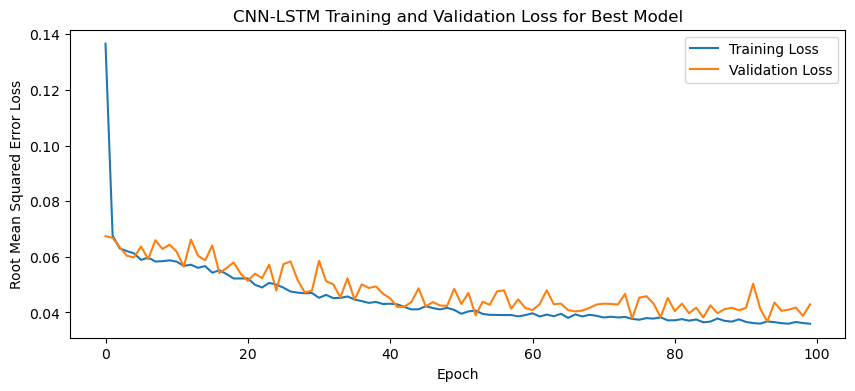

1/1 - 2s - loss: 0.0299 - 2s/epoch - 2s/step
Test Loss: 0.02988296002149582
1/1 [==============================] - 0s 83ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

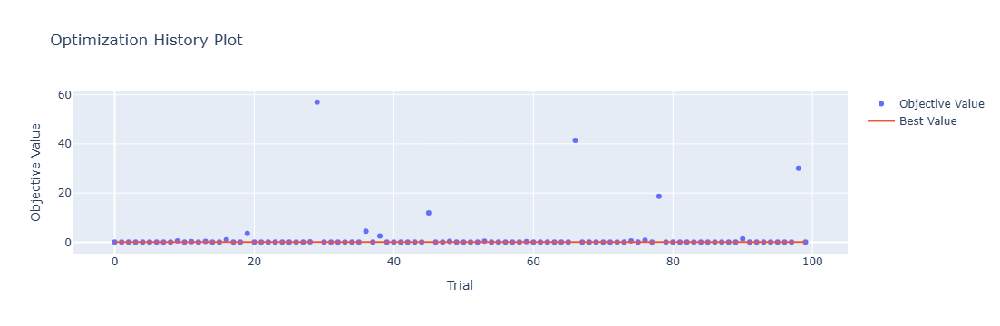

In [4]:
optuna.visualization.plot_optimization_history(study)

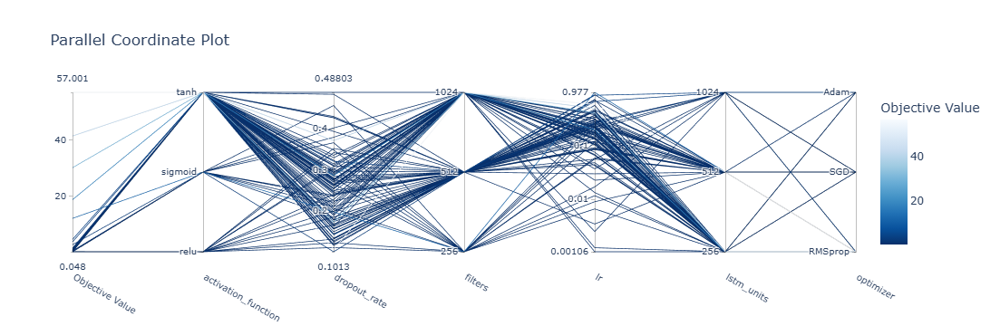

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

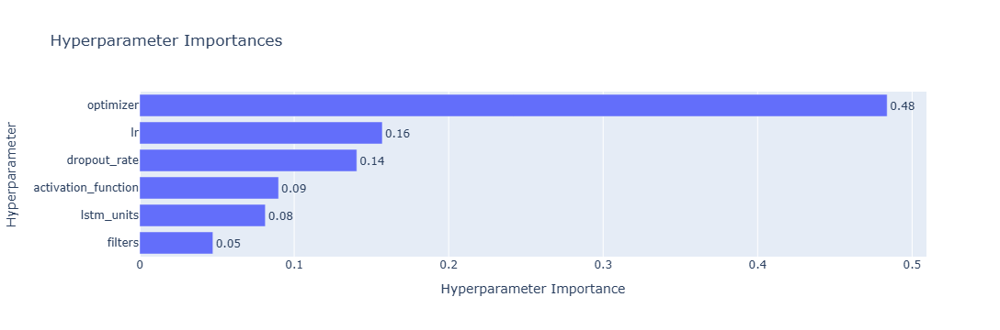

In [6]:
optuna.visualization.plot_param_importances(study)

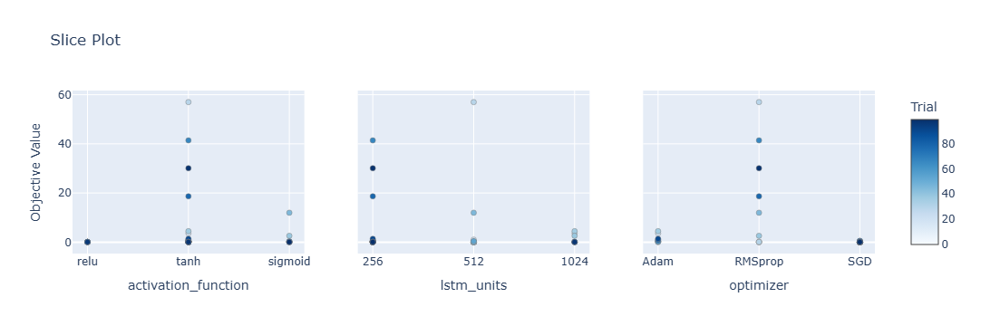

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

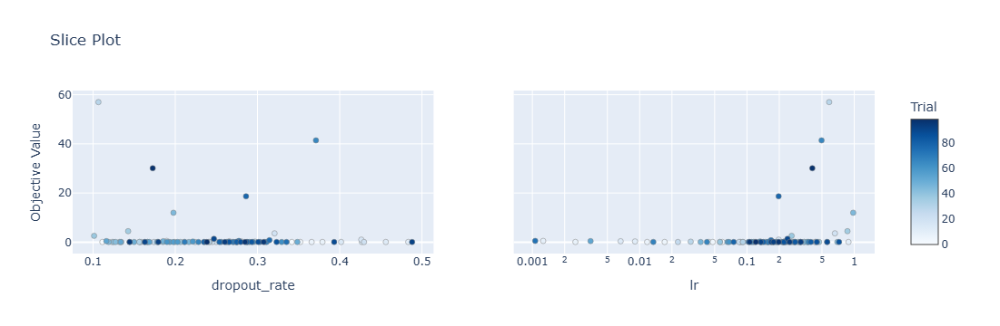

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[12.21  8.17 15.68 ... 23.86 20.59 15.82]
 [14.52 12.85 16.77 ... 26.49 23.17 21.15]
 [ 8.91  6.23 11.39 ... 22.62 16.72 14.05]
 ...
 [ 7.87  5.76 10.62 ... 21.07 15.24 12.04]
 [ 6.49  2.73  9.77 ... 21.93 16.5  11.44]
 [ 5.29  1.27  5.84 ... 22.11 15.37  9.87]]
Epoch 1/100
84/84 [==============================] - 45s 220ms/step - loss: 0.1394 - accuracy: 0.3452 - mae: 0.1211 - rmse: 0.1394 - mape: inf - pearson: 0.6413 - val_loss: 0.0649 - val_accuracy: 0.4000 - val_mae: 0.0515 - val_rmse: 0.0649 - val_mape: 11.4530 - val_pearson: 0.8070
Epoch 2/100
84/84 [==============================] - 10s 120ms/step - loss: 0.0679 - accuracy: 0.4881 - mae: 0.0539 - rmse: 0.0679 - mape: inf - pearson: 0.8080 - val_loss: 0.0706 - val_accuracy: 0.4000 - val_mae: 0.0570 - val_rmse: 0.0706 - val_mape: 12.6418 - val_pearson: 0.7886
Epoch 3/100
84/84 [==============================] - 11s 132ms/step - loss: 0.0636 - accuracy: 0.5119 - mae: 0.0504 - rmse: 0.0636 - mape: inf - pearson: 0.8237 - val_loss:

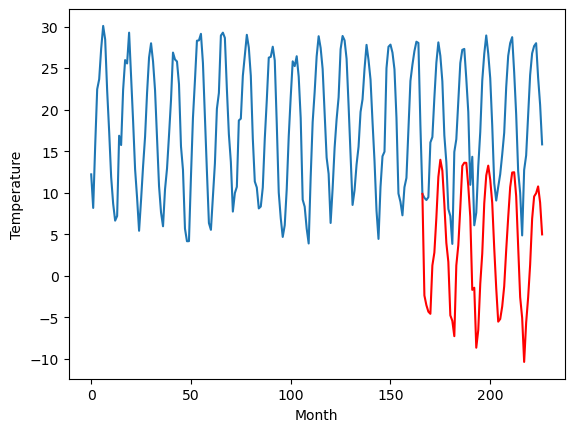

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.39		4.33		0.94
2.49		3.46		0.97
2.11		2.82		0.71
2.86		3.13		0.27
8.69		7.36		-1.33
9.18		8.40		-0.78
11.95		11.17		-0.78
15.70		14.56		-1.14
16.18		16.53		0.35
16.81		15.68		-1.13
13.83		12.93		-0.90
11.20		10.34		-0.86
7.78		7.18		-0.60
0.57		0.90		0.33
1.23		1.10		-0.13
1.14		1.85		0.71
6.20		6.29		0.09
7.60		8.37		0.77
11.62		12.29		0.67
15.10		15.25		0.15
16.32		15.82		-0.50
16.66		15.82		-0.84
14.53		13.26		-1.27
11.90		10.88		-1.02
6.39		2.63		-3.76
6.15		4.03		-2.12
-0.53		-1.94		-1.41
2.24		0.83		-1.41
6.10		4.58		-1.52
9.07		7.11		-1.96
13.38		11.67		-1.71
17.07		13.82		-3.25
17.21		14.28		-2.93
16.66		13.26		-3.40
15.64		11.18		-4.46
10.04		6.70		-3.34
7.35		4.07		-3.28
3.50		0.44		-3.06
4.29		0.73		-3.56
5.39		2.60		-2.79
6.98		4.24		-2.74
9.13		7.20		-1.93
12.31		9.05		-3.26
15.39		12.07		-3.32
17.22		14.32		-2.90
18.81		14.12		-4.69
15.43		11.41		-4.02
10.32		6.80		-3.52
5.08	

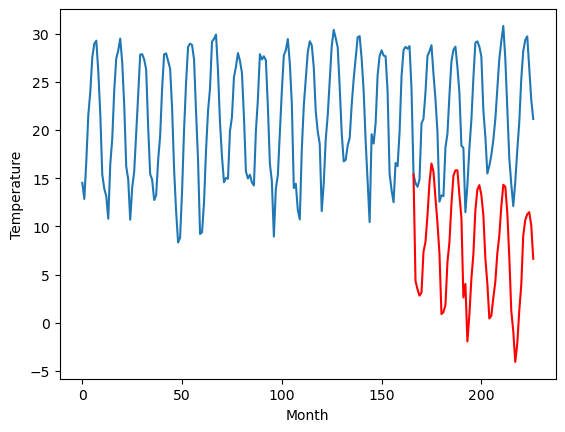

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.93		6.36		1.43
4.82		5.30		0.48
4.20		4.68		0.48
4.82		4.78		-0.04
11.07		9.35		-1.72
10.83		10.61		-0.22
14.52		14.00		-0.52
18.24		18.06		-0.18
20.61		20.31		-0.30
19.85		19.12		-0.73
16.46		15.93		-0.53
12.74		12.62		-0.12
7.81		9.70		1.89
0.81		3.32		2.51
1.63		3.06		1.43
2.49		3.04		0.55
8.47		8.68		0.21
10.11		11.11		1.00
14.09		15.27		1.18
18.23		19.11		0.88
19.99		19.65		-0.34
20.27		19.65		-0.62
16.70		16.83		0.13
12.82		14.11		1.29
4.46		5.38		0.92
6.64		6.22		-0.42
0.63		-0.25		-0.88
4.58		2.59		-1.99
8.08		6.87		-1.21
10.82		9.62		-1.20
16.58		14.96		-1.62
20.36		17.50		-2.86
21.28		18.33		-2.95
20.05		17.24		-2.81
16.93		14.71		-2.22
9.79		9.87		0.08
7.31		6.80		-0.51
2.79		2.65		-0.14
4.74		3.08		-1.66
7.52		4.68		-2.84
7.50		6.40		-1.10
10.57		10.22		-0.35
13.98		12.61		-1.37
17.30		15.86		-1.44
20.40		18.14		-2.26
20.01		17.71		-2.30
16.56		15.02		-1.54
10.58		10.12		-0.46
5

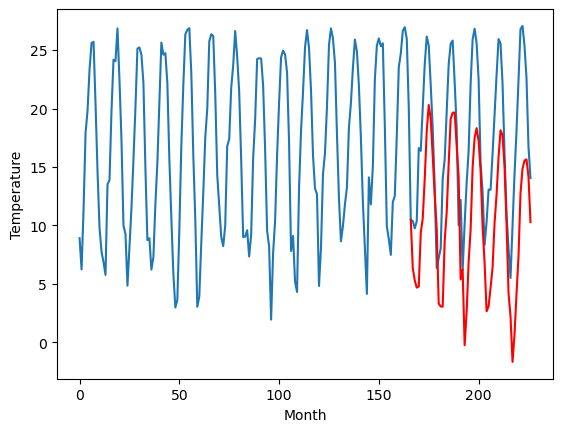

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.13		1.46		0.33
1.11		0.70		-0.41
1.15		-0.05		-1.20
1.15		0.05		-1.10
8.07		5.23		-2.84
8.15		6.21		-1.94
11.04		9.14		-1.90
13.95		12.70		-1.25
14.92		14.35		-0.57
15.26		13.56		-1.70
12.93		10.49		-2.44
8.87		7.36		-1.51
6.03		4.65		-1.38
-1.43		-1.67		-0.24
-1.34		-1.51		-0.17
-2.91		-1.69		1.22
5.00		4.38		-0.62
6.79		6.13		-0.66
10.76		10.15		-0.61
14.04		13.46		-0.58
14.67		13.88		-0.79
14.72		13.98		-0.74
12.21		11.62		-0.59
9.90		8.78		-1.12
1.81		0.68		-1.13
4.58		2.39		-2.19
-2.77		-4.17		-1.40
-0.33		-2.01		-1.68
3.46		2.43		-1.03
8.25		5.60		-2.65
12.77		10.19		-2.58
15.20		12.69		-2.51
15.18		13.18		-2.00
13.99		11.62		-2.37
12.75		9.59		-3.16
7.13		4.90		-2.23
3.02		1.31		-1.71
0.84		-1.81		-2.65
2.28		-1.73		-4.01
2.69		0.29		-2.40
6.21		2.45		-3.76
7.63		5.10		-2.53
12.06		7.76		-4.30
15.81		11.02		-4.79
16.93		12.75		-4.18
18.46		13.14		-5.32
15.02		10.25		-4.77
8.77		4.89	

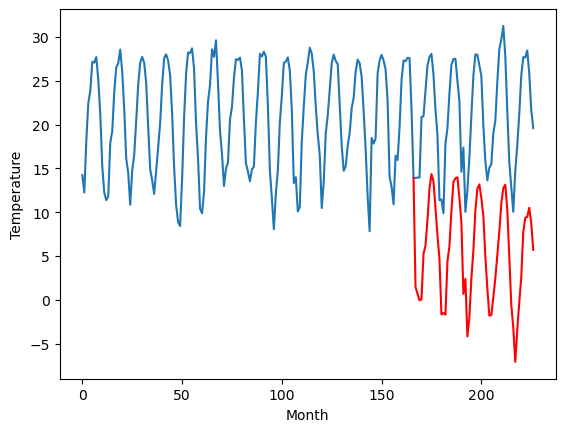

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.34		7.48		0.14
5.29		6.26		0.97
6.03		5.48		-0.55
5.36		5.27		-0.09
13.11		11.38		-1.73
13.36		13.01		-0.35
18.34		17.19		-1.15
22.54		21.84		-0.70
24.15		23.53		-0.62
24.64		22.66		-1.98
18.93		18.44		-0.49
14.05		13.57		-0.48
11.53		11.27		-0.26
5.06		5.12		0.06
4.18		4.75		0.57
1.09		2.59		1.50
10.99		11.35		0.36
12.92		13.54		0.62
16.78		18.02		1.24
21.98		23.02		1.04
22.41		23.48		1.07
23.17		23.31		0.14
21.16		20.81		-0.35
16.81		16.61		-0.20
9.24		8.64		-0.60
11.57		8.71		-2.86
3.12		1.92		-1.20
2.89		3.31		0.42
9.38		9.15		-0.23
15.42		13.15		-2.27
20.13		18.68		-1.45
24.47		22.33		-2.14
26.83		23.62		-3.21
24.47		21.65		-2.82
21.52		19.05		-2.47
15.60		13.62		-1.98
8.67		7.70		-0.97
5.94		4.47		-1.47
6.91		4.54		-2.37
7.04		6.08		-0.96
11.76		8.97		-2.79
13.26		12.84		-0.42
18.79		17.32		-1.47
23.34		20.94		-2.40
26.33		22.56		-3.77
28.07		23.11		-4.96
23.59		19.99		-3.60
15.93		13

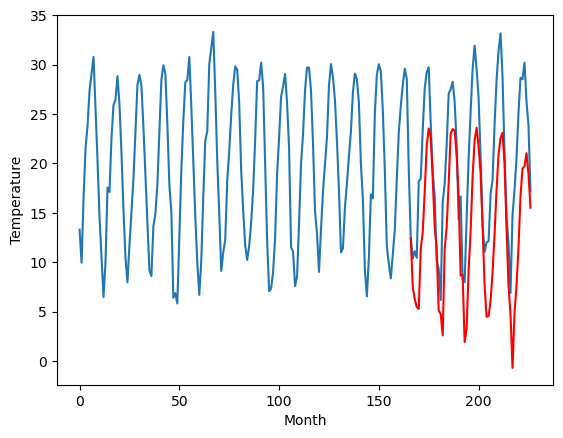

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.63		4.96		0.33
4.06		3.66		-0.40
3.53		3.17		-0.36
3.22		3.41		0.19
6.81		7.38		0.57
8.78		8.88		0.10
12.47		12.48		0.01
16.82		16.67		-0.15
20.56		19.19		-1.37
19.71		17.96		-1.75
16.68		14.75		-1.93
12.59		11.47		-1.12
8.47		8.23		-0.24
1.72		2.00		0.28
-0.06		1.61		1.67
0.59		1.91		1.32
5.49		6.79		1.30
8.86		9.68		0.82
12.37		13.85		1.48
16.94		17.84		0.90
18.93		18.52		-0.41
19.41		18.38		-1.03
16.40		15.36		-1.04
12.80		12.67		-0.13
4.63		3.87		-0.76
5.68		3.96		-1.72
-0.70		-2.00		-1.30
2.91		1.14		-1.77
6.83		5.21		-1.62
9.70		7.63		-2.07
14.33		13.14		-1.19
17.90		15.72		-2.18
20.04		16.78		-3.26
19.19		16.07		-3.12
16.54		13.34		-3.20
9.98		8.49		-1.49
8.29		5.56		-2.73
1.77		1.04		-0.73
3.46		1.62		-1.84
4.95		2.89		-2.06
5.86		4.40		-1.46
10.54		8.82		-1.72
12.06		10.97		-1.09
15.88		14.11		-1.77
19.71		16.88		-2.83
19.23		15.96		-3.27
15.71		13.39		-2.32
11.36		8.85		-2.51
5.92

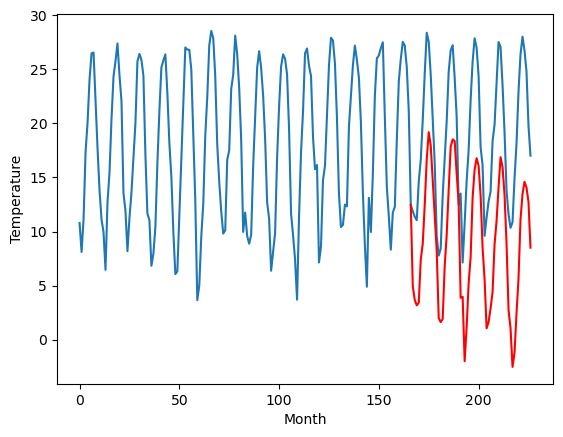

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.68		2.48		1.80
0.32		1.21		0.89
-0.15		0.66		0.81
0.96		0.77		-0.19
6.38		5.12		-1.26
7.62		6.62		-1.00
9.96		10.35		0.39
15.21		14.72		-0.49
18.28		17.22		-1.06
17.25		15.91		-1.34
13.36		12.52		-0.84
9.36		8.95		-0.41
5.18		5.92		0.74
-1.75		-0.39		1.36
-2.33		-0.87		1.46
-1.69		-1.00		0.69
5.29		4.65		-0.64
6.32		7.47		1.15
10.03		11.73		1.70
14.36		15.97		1.61
15.98		16.59		0.61
15.92		16.49		0.57
11.87		13.48		1.61
8.64		10.61		1.97
-0.01		1.71		1.72
1.93		1.87		-0.06
-4.72		-4.44		0.28
-0.74		-1.43		-0.69
3.60		2.93		-0.67
6.52		5.59		-0.93
11.59		11.29		-0.30
15.50		14.02		-1.48
16.60		15.12		-1.48
15.31		14.22		-1.09
12.25		11.43		-0.82
5.31		6.44		1.13
3.08		3.22		0.14
-3.43		-1.29		2.14
-0.24		-0.73		-0.49
2.76		0.60		-2.16
3.24		2.25		-0.99
6.80		6.71		-0.09
9.49		9.20		-0.29
12.84		12.47		-0.37
16.55		15.05		-1.50
15.86		14.26		-1.60
12.35		11.64		-0.71
7.14		6.81		-0.33
1.27		0

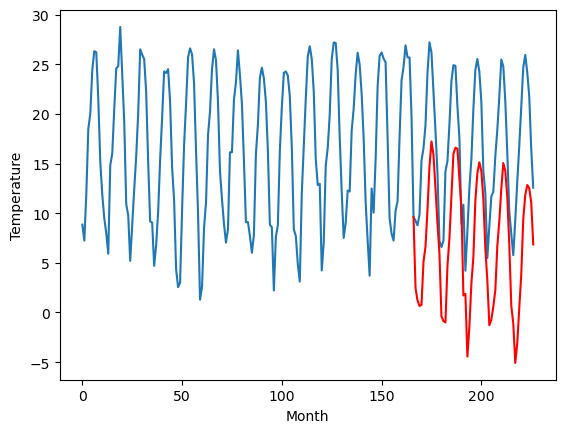

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.37		0.34		1.71
-1.74		-1.07		0.67
-1.86		-1.59		0.27
-0.82		-1.57		-0.75
4.76		2.83		-1.93
5.66		4.51		-1.15
8.78		8.61		-0.17
14.30		13.38		-0.92
17.56		16.06		-1.50
16.19		14.54		-1.65
11.32		10.94		-0.38
7.48		6.99		-0.49
3.25		4.03		0.78
-3.68		-2.31		1.37
-4.62		-3.05		1.57
-4.00		-3.52		0.48
2.52		2.61		0.09
6.15		5.69		-0.46
9.17		10.08		0.91
13.96		14.81		0.85
16.08		15.42		-0.66
16.03		15.32		-0.71
11.52		12.12		0.60
7.67		9.10		1.43
-1.83		-0.09		1.74
0.23		-0.37		-0.60
-6.95		-6.88		0.07
-2.71		-3.76		-1.05
2.13		0.84		-1.29
5.45		3.54		-1.91
10.43		9.71		-0.72
14.43		12.64		-1.79
16.30		13.96		-2.34
14.62		13.11		-1.51
10.92		10.05		-0.87
3.73		4.88		1.15
1.53		1.49		-0.04
-5.64		-3.39		2.25
-2.47		-2.74		-0.27
0.50		-1.64		-2.14
1.18		0.00		-1.18
5.80		5.04		-0.76
8.09		7.75		-0.34
11.84		11.11		-0.73
15.98		13.80		-2.18
14.84		12.78		-2.06
11.08		10.21		-0.87
5.69		5.33		-0.3

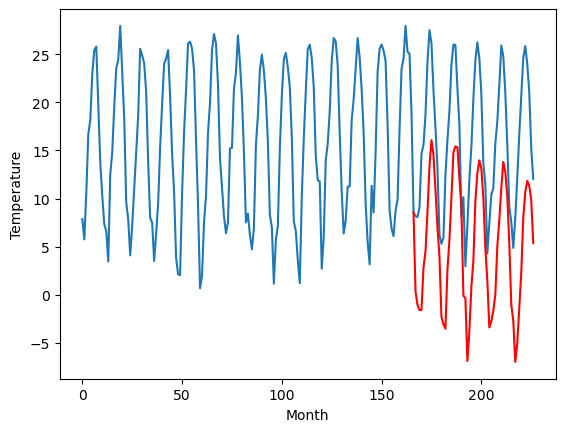

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		0.05		1.00
-1.11		-1.42		-0.31
-2.30		-2.34		-0.04
-1.80		-2.84		-1.04
4.77		3.29		-1.48
7.05		5.43		-1.62
11.93		10.55		-1.38
17.86		16.52		-1.34
20.60		18.83		-1.77
17.59		17.12		-0.47
14.03		12.53		-1.50
6.77		6.71		-0.06
3.91		4.70		0.79
-2.80		-1.84		0.96
-3.59		-3.02		0.57
-7.86		-6.05		1.81
4.61		4.10		-0.51
7.21		7.13		-0.08
11.90		11.93		0.03
18.09		18.14		0.05
18.66		18.42		-0.24
18.60		18.37		-0.23
14.86		15.17		0.31
10.90		11.01		0.11
0.86		1.65		0.79
2.66		0.64		-2.02
-5.85		-7.00		-1.15
-3.81		-4.72		-0.91
3.41		1.62		-1.79
7.36		5.43		-1.93
14.20		12.61		-1.59
18.72		16.50		-2.22
21.05		18.00		-3.05
18.17		16.30		-1.87
14.53		13.01		-1.52
7.97		7.13		-0.84
2.00		1.58		-0.42
-3.29		-3.31		-0.02
-0.73		-2.80		-2.07
0.88		-1.65		-2.53
2.70		0.88		-1.82
8.48		6.62		-1.86
14.07		11.40		-2.67
17.94		15.31		-2.63
19.43		17.09		-2.34
18.17		16.75		-1.42
15.00		13.98		-1.02
9.40	

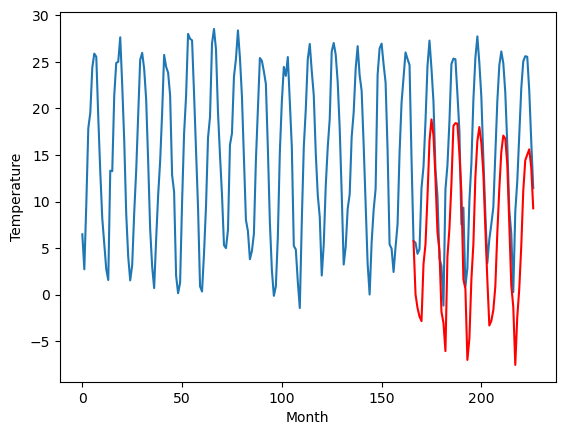

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.56		-2.21		2.35
-4.38		-3.82		0.56
-5.66		-4.60		1.06
-6.53		-5.10		1.43
0.66		0.43		-0.23
2.32		2.75		0.43
7.41		8.12		0.71
14.39		14.39		-0.00
17.02		17.23		0.21
14.64		15.05		0.41
10.97		10.57		-0.40
4.58		4.83		0.25
0.90		2.61		1.71
-6.61		-3.98		2.63
-8.20		-5.53		2.67
-10.37		-8.14		2.23
0.38		1.36		0.98
3.44		4.93		1.49
7.91		9.75		1.84
14.39		16.18		1.79
15.40		16.43		1.03
16.00		16.48		0.48
12.14		12.82		0.68
7.67		9.08		1.41
-2.99		-1.03		1.96
-1.76		-2.42		-0.66
-10.73		-10.21		0.52
-7.15		-7.21		-0.06
-0.17		-1.14		-0.97
2.56		2.24		-0.32
10.73		10.03		-0.70
14.63		13.79		-0.84
16.66		15.43		-1.23
14.75		14.19		-0.56
11.02		10.51		-0.51
3.98		4.61		0.63
-1.04		-0.07		0.97
-6.75		-5.81		0.94
-4.86		-5.05		-0.19
-2.82		-4.32		-1.50
-2.48		-2.27		0.21
3.80		4.27		0.47
8.76		8.53		-0.23
12.60		12.44		-0.16
15.43		14.71		-0.72
14.63		13.60		-1.03
12.02		11.06		-0.96
5.44		5.32		-0.

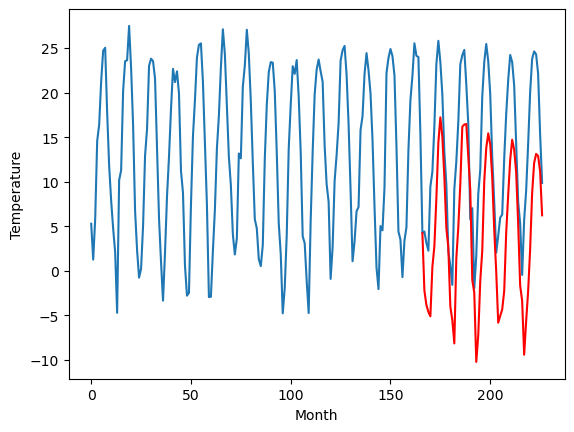

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.06		-3.45		1.61
-5.73		-5.26		0.47
-6.76		-6.12		0.64
-8.22		-6.75		1.47
-2.08		-1.10		0.98
0.57		1.60		1.03
7.00		7.55		0.55
14.96		14.42		-0.54
18.12		17.44		-0.68
15.43		15.06		-0.37
10.60		10.24		-0.36
3.85		3.78		-0.07
0.37		1.69		1.32
-6.66		-4.93		1.73
-8.27		-6.80		1.47
-12.58		-10.08		2.50
-0.85		0.27		1.12
3.12		4.22		1.10
8.27		9.27		1.00
15.58		16.37		0.79
16.17		16.54		0.37
16.88		16.50		-0.38
12.83		12.58		-0.25
8.48		8.54		0.06
-2.38		-1.87		0.51
-3.28		-4.17		-0.89
-12.23		-12.05		0.18
-8.99		-8.97		0.02
-2.08		-2.48		-0.40
1.53		0.93		-0.60
10.85		9.40		-1.45
15.61		13.48		-2.13
16.72		15.32		-1.40
15.60		14.16		-1.44
11.76		10.18		-1.58
4.52		4.02		-0.50
-0.51		-1.13		-0.62
-6.69		-7.42		-0.73
-5.56		-6.56		-1.00
-5.15		-6.12		-0.97
-3.29		-4.00		-0.71
3.56		3.41		-0.15
8.58		8.20		-0.38
14.09		12.22		-1.87
16.55		14.53		-2.02
14.74		13.18		-1.56
12.36		10.69		-1.67
6.40

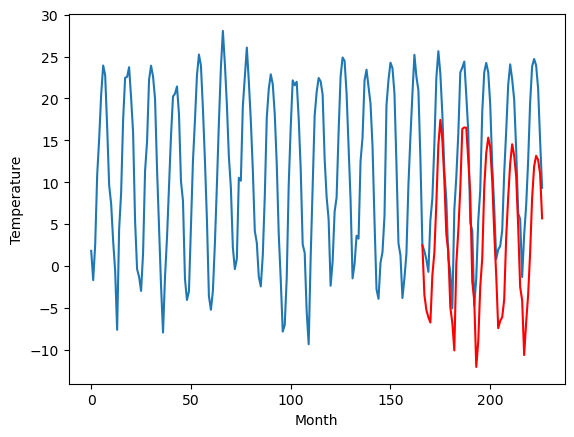

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.98  -2.367195
1                 1    3.39   4.329133
2                 2    4.93   6.355551
3                 3    1.13   1.464819
4                 4    7.34   7.476773
5                 5    4.63   4.961696
6                 6    0.68   2.476459
7                 7   -1.37   0.337665
8                 8   -0.95   0.053162
9                 9   -4.56  -2.214378
10               10   -5.06  -3.451468


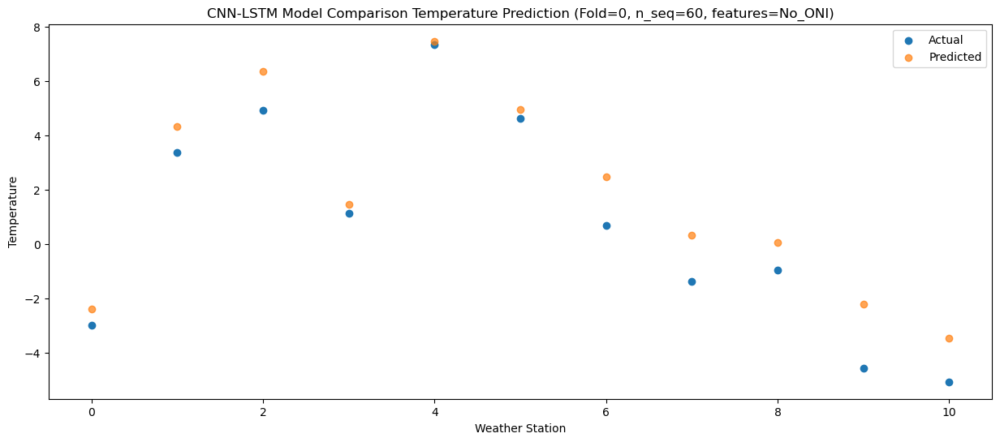

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.45  -3.539353
1                 1    2.49   3.461346
2                 2    4.82   5.302598
3                 3    1.11   0.704151
4                 4    5.29   6.258592
5                 5    4.06   3.663725
6                 6    0.32   1.207475
7                 7   -1.74  -1.065807
8                 8   -1.11  -1.418954
9                 9   -4.38  -3.818317
10               10   -5.73  -5.260624


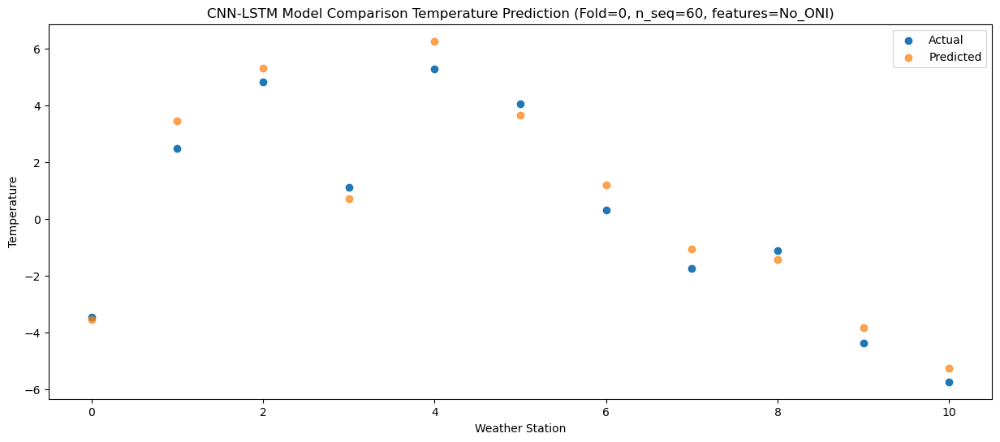

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.72  -4.319728
1                 1    2.11   2.816740
2                 2    4.20   4.677287
3                 3    1.15  -0.050975
4                 4    6.03   5.475497
5                 5    3.53   3.169488
6                 6   -0.15   0.658970
7                 7   -1.86  -1.592051
8                 8   -2.30  -2.340211
9                 9   -5.66  -4.601697
10               10   -6.76  -6.121486


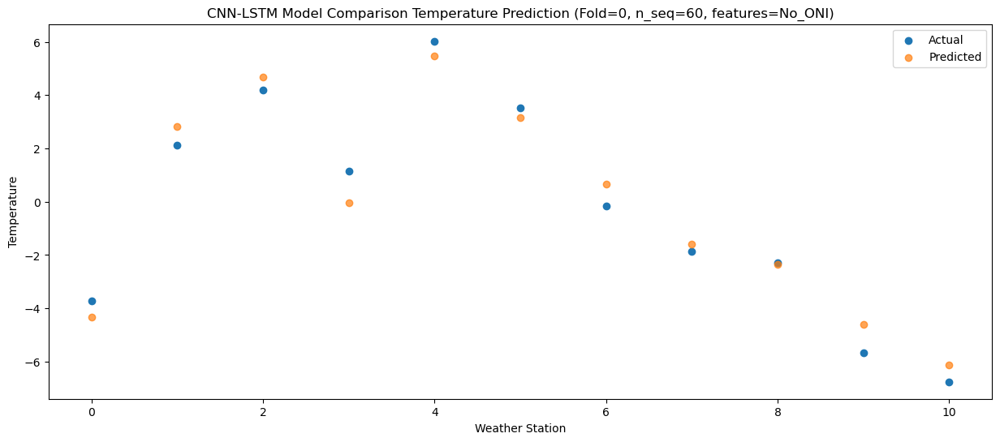

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.37  -4.576703
1                 1    2.86   3.129756
2                 2    4.82   4.779587
3                 3    1.15   0.050823
4                 4    5.36   5.274953
5                 5    3.22   3.407307
6                 6    0.96   0.766196
7                 7   -0.82  -1.574525
8                 8   -1.80  -2.835431
9                 9   -6.53  -5.101277
10               10   -8.22  -6.751895


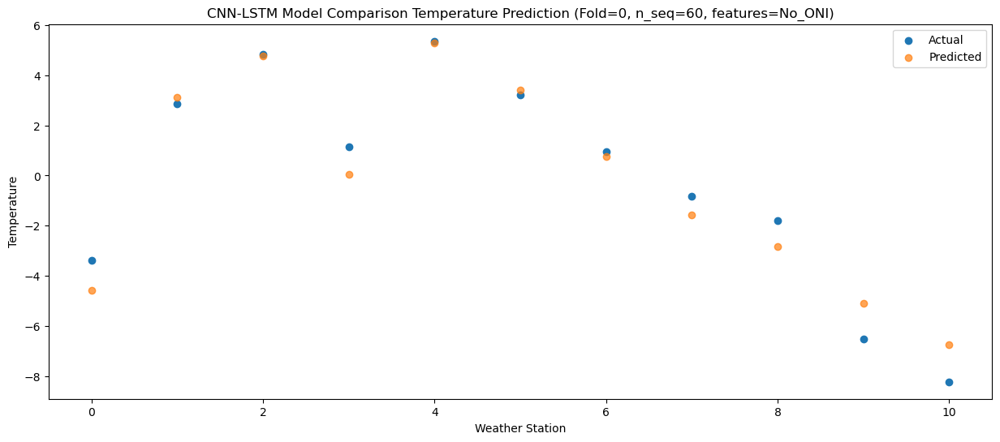

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.21   1.244980
1                 1    8.69   7.361973
2                 2   11.07   9.347365
3                 3    8.07   5.234915
4                 4   13.11  11.377081
5                 5    6.81   7.377188
6                 6    6.38   5.116462
7                 7    4.76   2.827955
8                 8    4.77   3.285134
9                 9    0.66   0.432183
10               10   -2.08  -1.100441


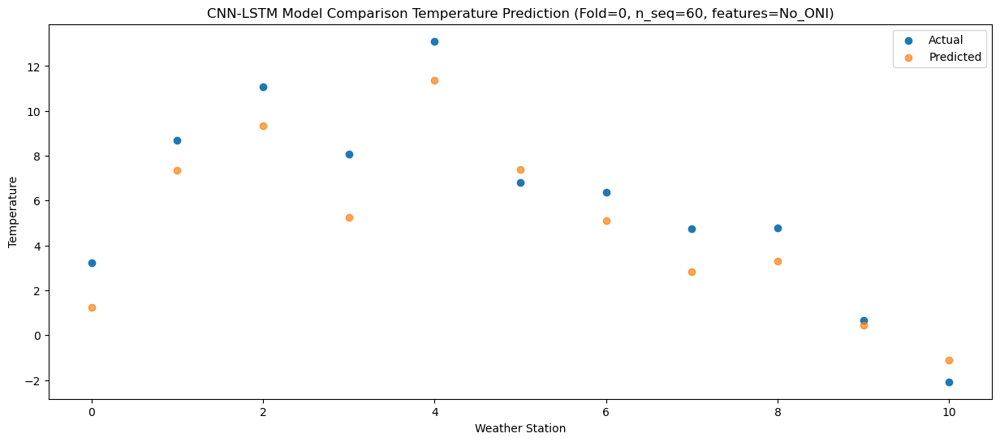

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.86   2.797861
1                 1    9.18   8.400512
2                 2   10.83  10.607993
3                 3    8.15   6.205708
4                 4   13.36  13.013397
5                 5    8.78   8.883740
6                 6    7.62   6.618660
7                 7    5.66   4.512891
8                 8    7.05   5.426289
9                 9    2.32   2.753448
10               10    0.57   1.602512


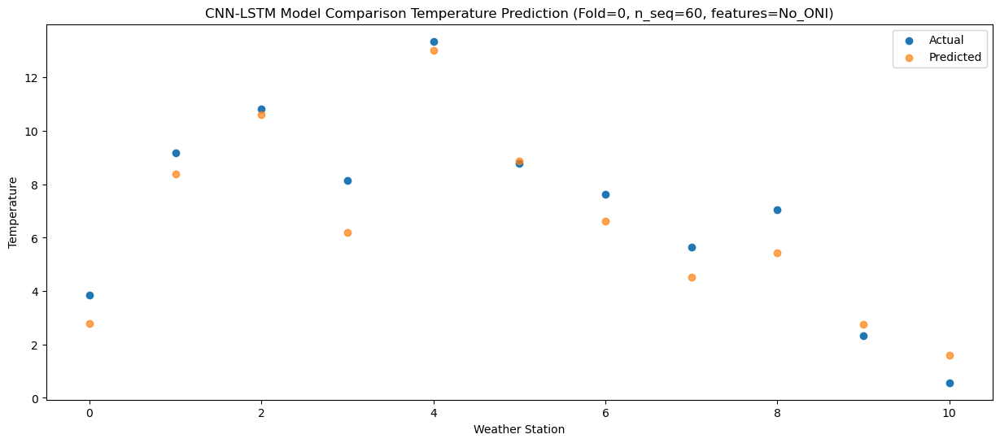

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.59   6.991772
1                 1   11.95  11.169640
2                 2   14.52  13.997915
3                 3   11.04   9.144347
4                 4   18.34  17.189695
5                 5   12.47  12.478447
6                 6    9.96  10.348155
7                 7    8.78   8.613802
8                 8   11.93  10.546042
9                 9    7.41   8.124862
10               10    7.00   7.545434


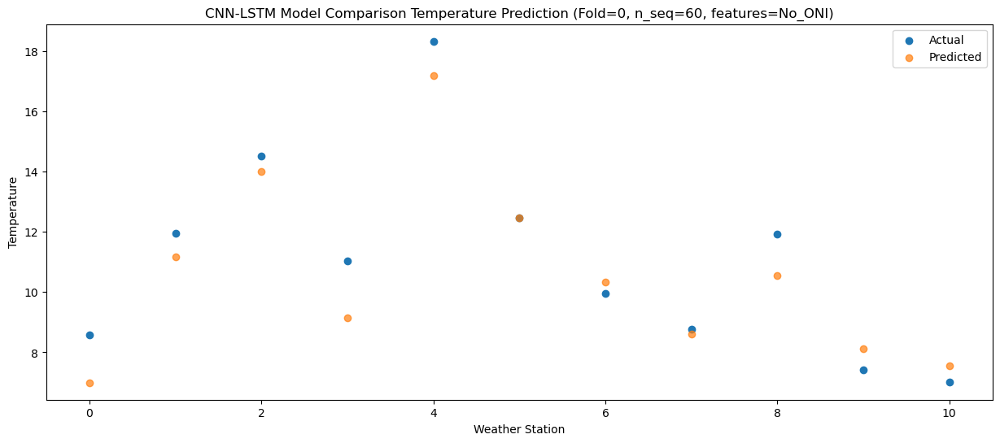

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.81  11.903325
1                 1   15.70  14.555682
2                 2   18.24  18.063679
3                 3   13.95  12.695179
4                 4   22.54  21.843125
5                 5   16.82  16.665056
6                 6   15.21  14.723604
7                 7   14.30  13.375802
8                 8   17.86  16.523936
9                 9   14.39  14.388802
10               10   14.96  14.422155


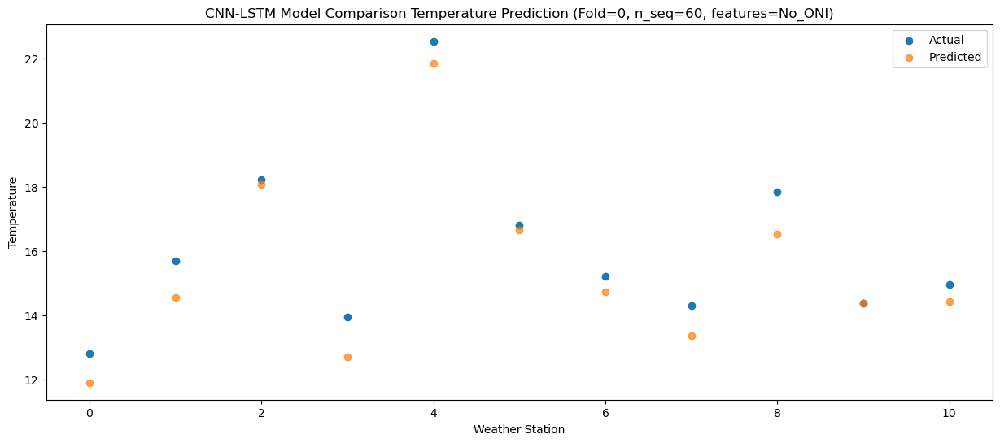

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.26  13.966540
1                 1   16.18  16.529599
2                 2   20.61  20.305197
3                 3   14.92  14.354866
4                 4   24.15  23.533698
5                 5   20.56  19.194870
6                 6   18.28  17.217808
7                 7   17.56  16.061793
8                 8   20.60  18.825977
9                 9   17.02  17.227489
10               10   18.12  17.439151


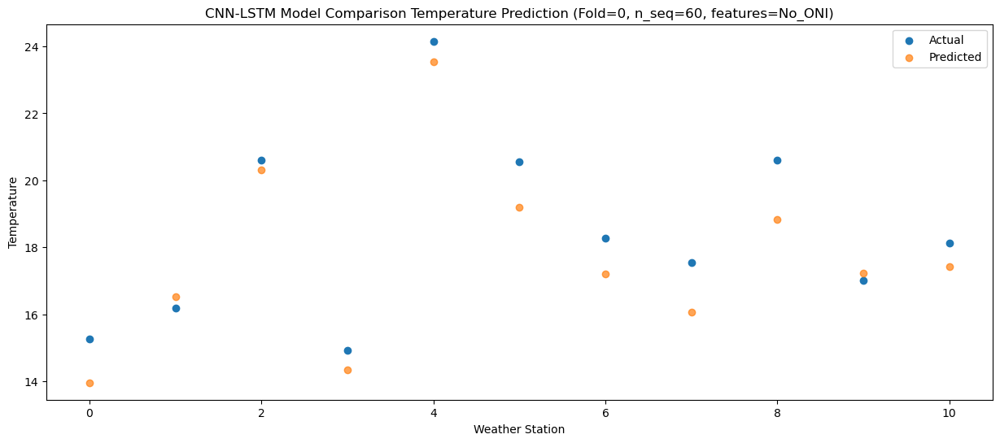

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.63  12.665743
1                 1   16.81  15.676898
2                 2   19.85  19.120045
3                 3   15.26  13.555407
4                 4   24.64  22.656127
5                 5   19.71  17.963707
6                 6   17.25  15.906468
7                 7   16.19  14.540536
8                 8   17.59  17.119755
9                 9   14.64  15.053013
10               10   15.43  15.057106


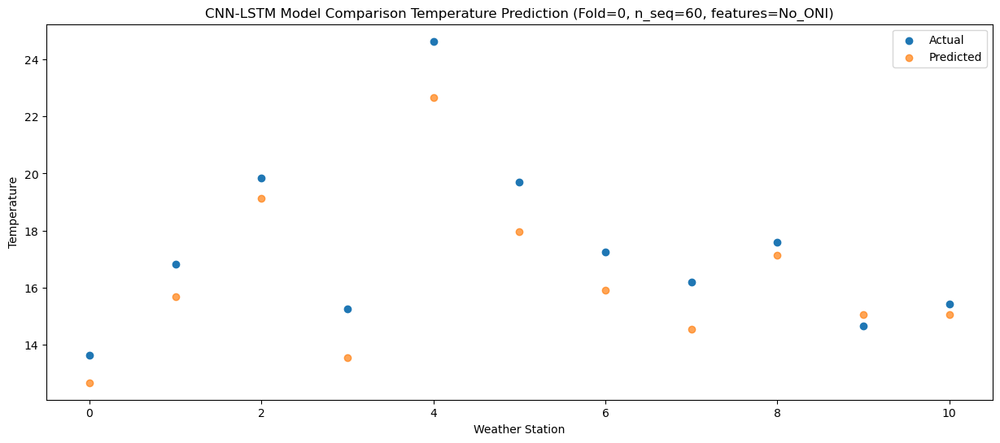

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.57   8.643847
1                 1   13.83  12.929033
2                 2   16.46  15.925243
3                 3   12.93  10.487967
4                 4   18.93  18.439870
5                 5   16.68  14.751803
6                 6   13.36  12.520534
7                 7   11.32  10.936626
8                 8   14.03  12.534054
9                 9   10.97  10.569249
10               10   10.60  10.241204


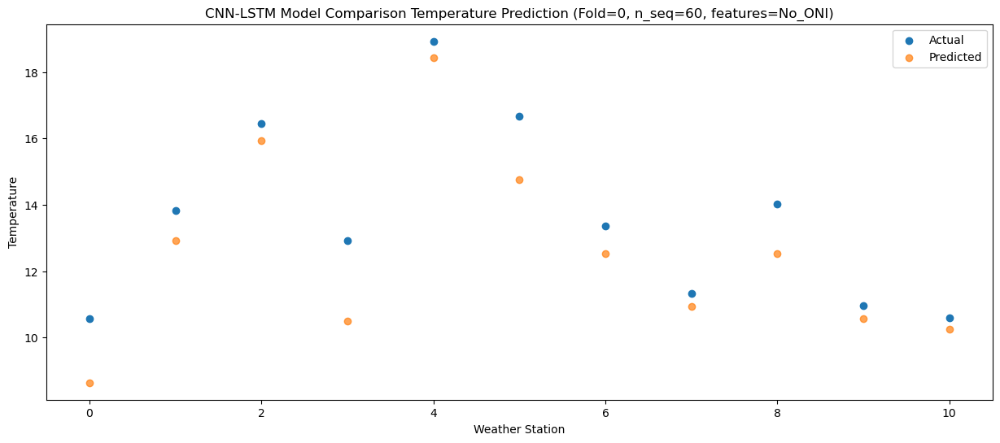

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.07   3.961886
1                 1   11.20  10.338214
2                 2   12.74  12.617778
3                 3    8.87   7.355056
4                 4   14.05  13.567172
5                 5   12.59  11.470449
6                 6    9.36   8.951897
7                 7    7.48   6.990875
8                 8    6.77   6.706854
9                 9    4.58   4.827053
10               10    3.85   3.775909


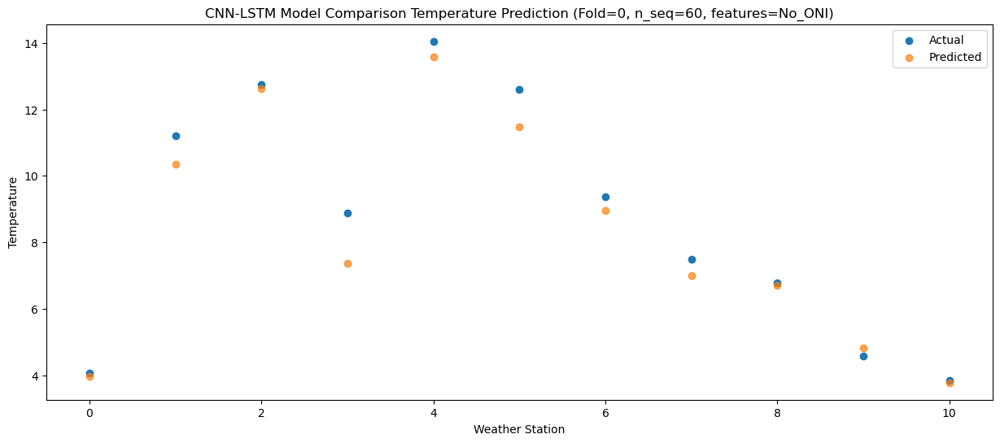

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    0.83   1.678532
1                 1    7.78   7.175135
2                 2    7.81   9.696329
3                 3    6.03   4.649775
4                 4   11.53  11.269911
5                 5    8.47   8.229370
6                 6    5.18   5.919964
7                 7    3.25   4.029787
8                 8    3.91   4.702569
9                 9    0.90   2.614870
10               10    0.37   1.694228


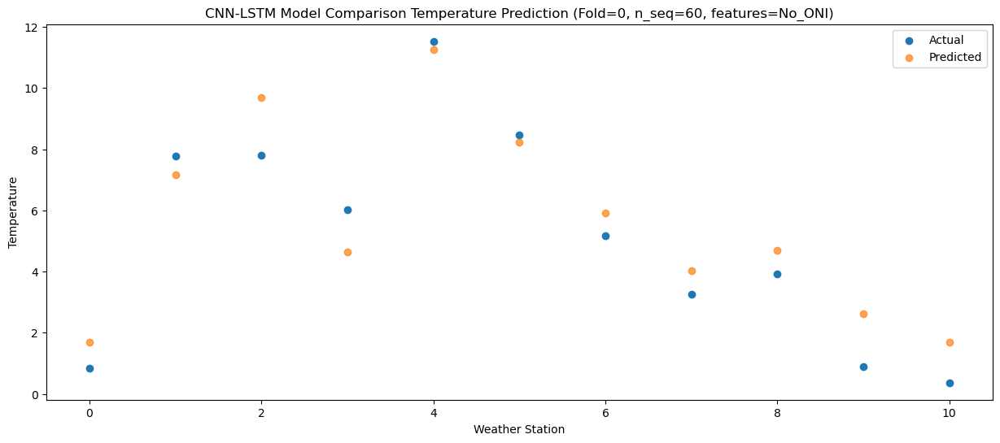

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.79  -4.763359
1                 1    0.57   0.899933
2                 2    0.81   3.320530
3                 3   -1.43  -1.666603
4                 4    5.06   5.115788
5                 5    1.72   2.003518
6                 6   -1.75  -0.386938
7                 7   -3.68  -2.306317
8                 8   -2.80  -1.837258
9                 9   -6.61  -3.984132
10               10   -6.66  -4.929127


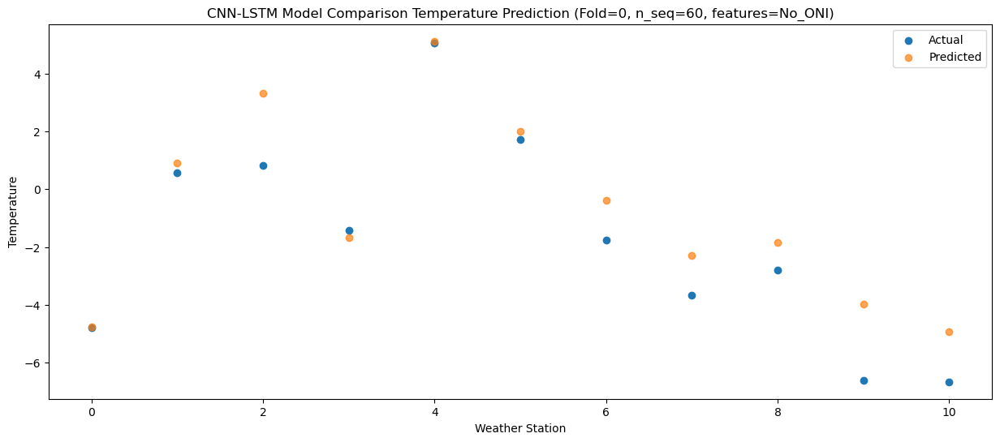

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -5.65  -5.418024
1                 1    1.23   1.101222
2                 2    1.63   3.064389
3                 3   -1.34  -1.505023
4                 4    4.18   4.750731
5                 5   -0.06   1.614552
6                 6   -2.33  -0.869812
7                 7   -4.62  -3.053997
8                 8   -3.59  -3.021884
9                 9   -8.20  -5.531579
10               10   -8.27  -6.799378


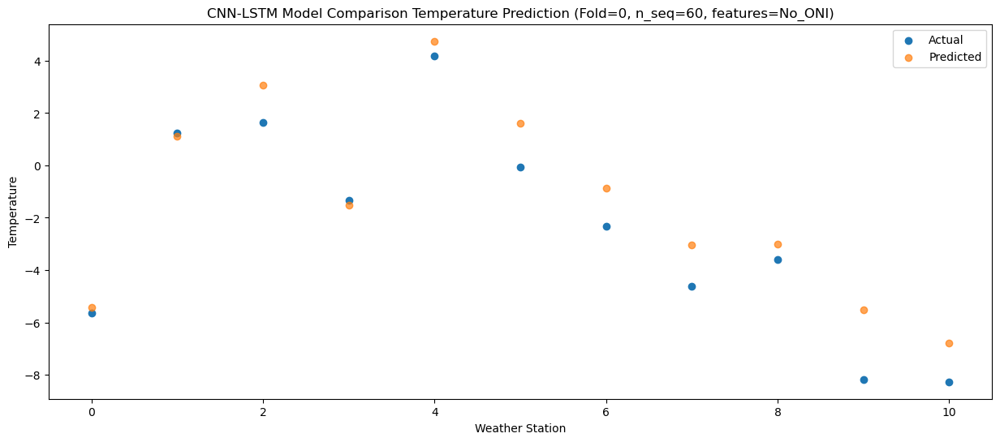

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.00  -7.269136
1                 1    1.14   1.851444
2                 2    2.49   3.043142
3                 3   -2.91  -1.690461
4                 4    1.09   2.591353
5                 5    0.59   1.914578
6                 6   -1.69  -1.001380
7                 7   -4.00  -3.524627
8                 8   -7.86  -6.054112
9                 9  -10.37  -8.138930
10               10  -12.58 -10.077378


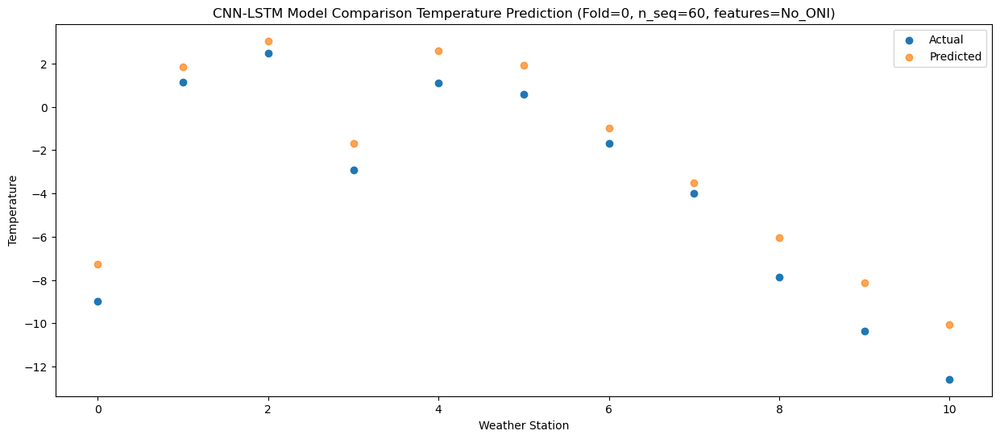

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.07   1.249425
1                 1    6.20   6.285999
2                 2    8.47   8.684697
3                 3    5.00   4.382183
4                 4   10.99  11.352544
5                 5    5.49   6.793478
6                 6    5.29   4.653058
7                 7    2.52   2.612855
8                 8    4.61   4.102706
9                 9    0.38   1.363872
10               10   -0.85   0.273208


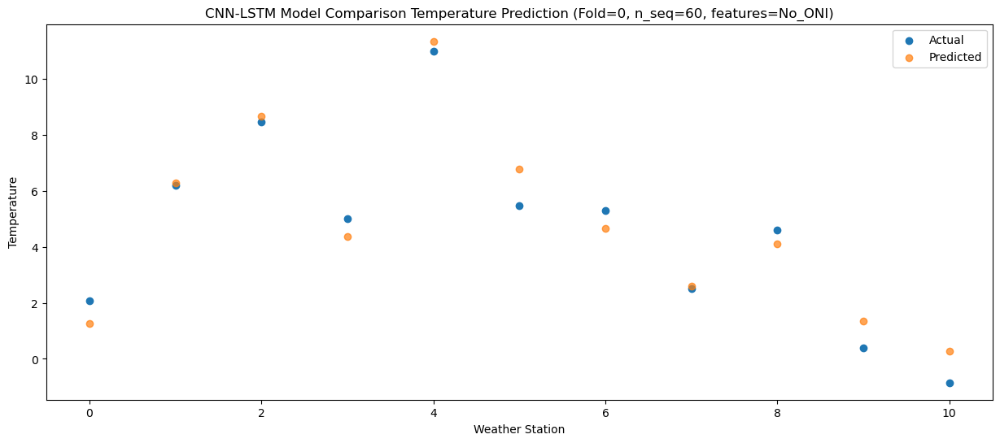

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.60   3.682775
1                 1    7.60   8.367744
2                 2   10.11  11.111880
3                 3    6.79   6.131634
4                 4   12.92  13.541614
5                 5    8.86   9.681449
6                 6    6.32   7.468917
7                 7    6.15   5.694561
8                 8    7.21   7.125087
9                 9    3.44   4.925120
10               10    3.12   4.220634


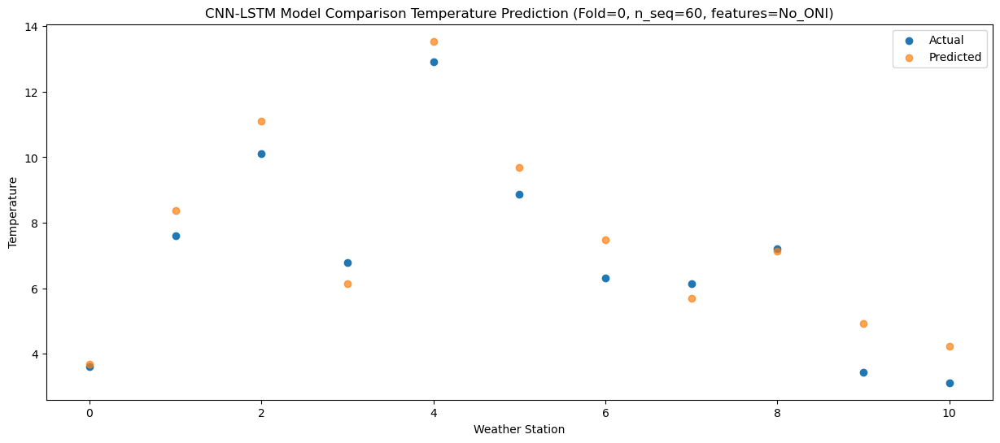

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.10   8.180331
1                 1   11.62  12.285209
2                 2   14.09  15.268365
3                 3   10.76  10.150926
4                 4   16.78  18.018702
5                 5   12.37  13.850609
6                 6   10.03  11.726140
7                 7    9.17  10.077741
8                 8   11.90  11.926244
9                 9    7.91   9.754065
10               10    8.27   9.267950


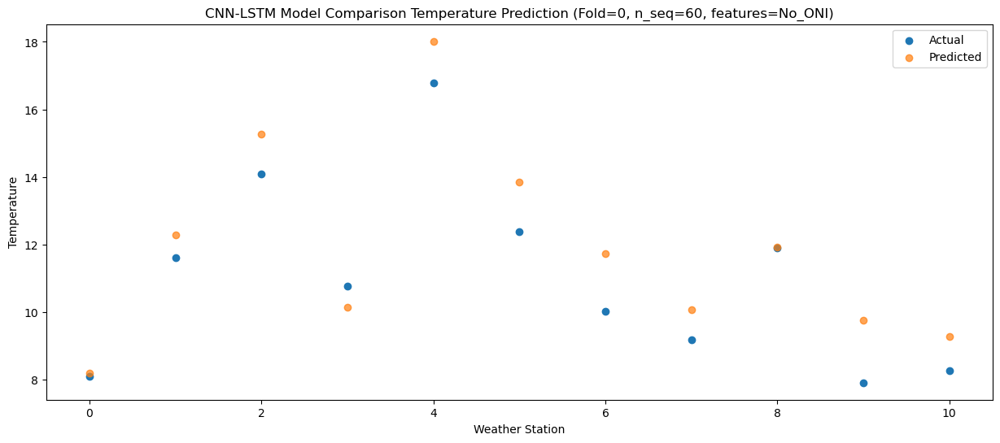

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.77  13.226949
1                 1   15.10  15.253618
2                 2   18.23  19.109220
3                 3   14.04  13.457098
4                 4   21.98  23.015465
5                 5   16.94  17.839751
6                 6   14.36  15.973373
7                 7   13.96  14.808031
8                 8   18.09  18.135487
9                 9   14.39  16.176257
10               10   15.58  16.366354


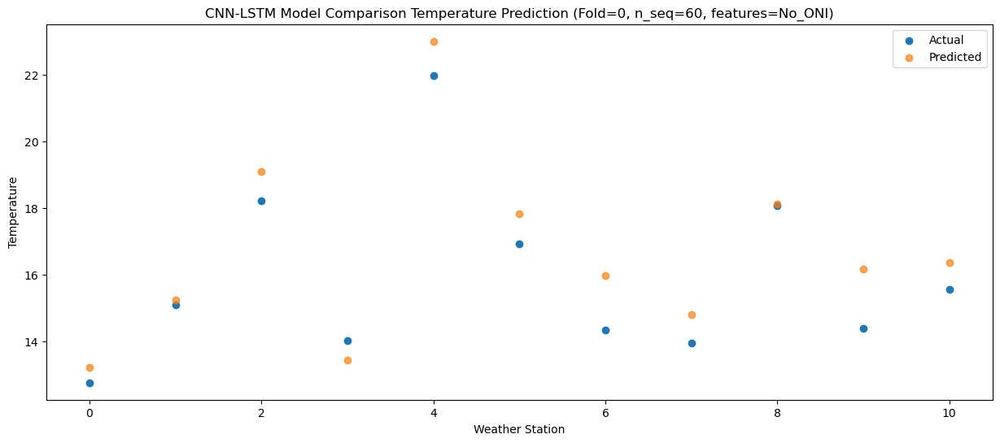

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.36  13.608888
1                 1   16.32  15.822930
2                 2   19.99  19.646837
3                 3   14.67  13.879380
4                 4   22.41  23.477729
5                 5   18.93  18.524618
6                 6   15.98  16.592241
7                 7   16.08  15.416720
8                 8   18.66  18.421291
9                 9   15.40  16.427992
10               10   16.17  16.544862


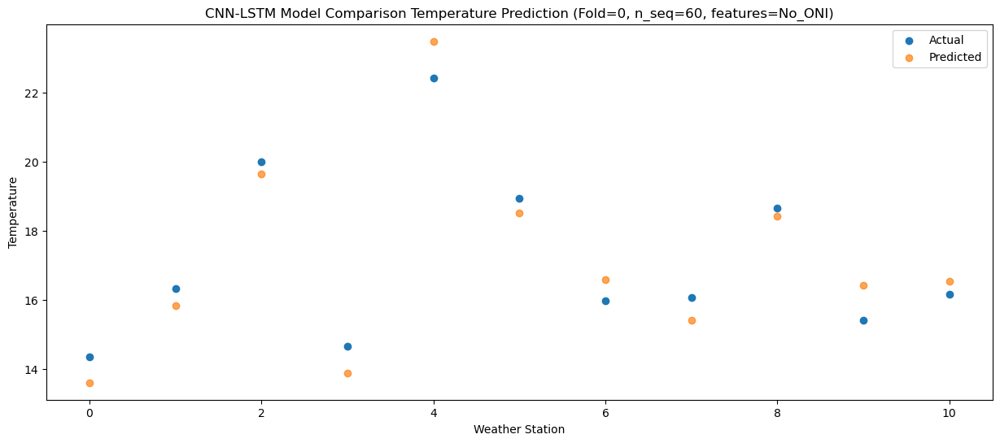

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.47  13.599187
1                 1   16.66  15.817101
2                 2   20.27  19.652616
3                 3   14.72  13.984053
4                 4   23.17  23.309737
5                 5   19.41  18.375453
6                 6   15.92  16.489783
7                 7   16.03  15.317404
8                 8   18.60  18.367324
9                 9   16.00  16.482152
10               10   16.88  16.499940


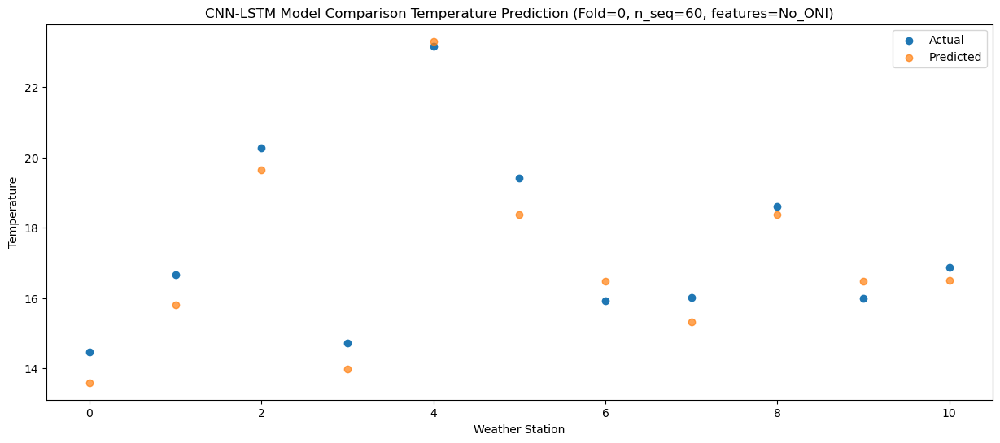

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.89  10.789205
1                 1   14.53  13.257062
2                 2   16.70  16.832980
3                 3   12.21  11.620366
4                 4   21.16  20.805000
5                 5   16.40  15.364040
6                 6   11.87  13.483720
7                 7   11.52  12.117061
8                 8   14.86  15.167954
9                 9   12.14  12.823546
10               10   12.83  12.584880


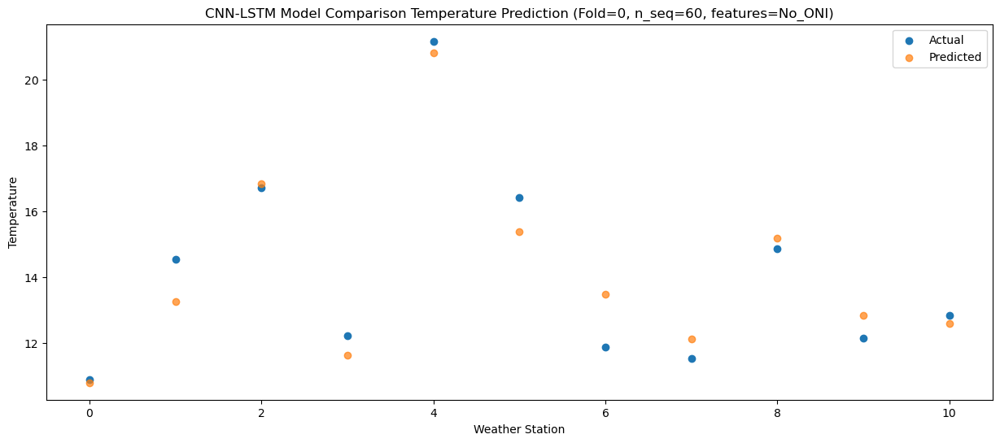

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.87   7.094324
1                 1   11.90  10.878381
2                 2   12.82  14.112758
3                 3    9.90   8.783001
4                 4   16.81  16.607789
5                 5   12.80  12.666450
6                 6    8.64  10.606596
7                 7    7.67   9.102244
8                 8   10.90  11.010996
9                 9    7.67   9.076988
10               10    8.48   8.536641


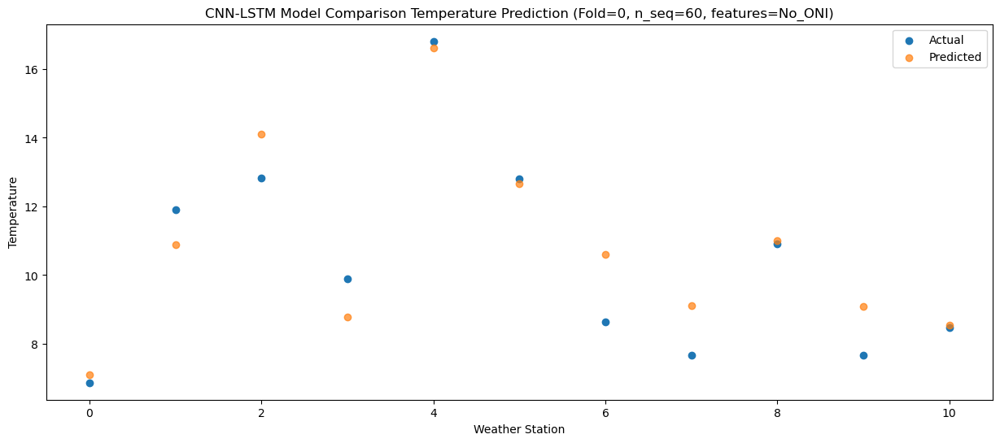

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.89  -1.693707
1                 1    6.39   2.629083
2                 2    4.46   5.375391
3                 3    1.81   0.677637
4                 4    9.24   8.638047
5                 5    4.63   3.866789
6                 6   -0.01   1.710868
7                 7   -1.83  -0.090463
8                 8    0.86   1.647638
9                 9   -2.99  -1.027930
10               10   -2.38  -1.866245


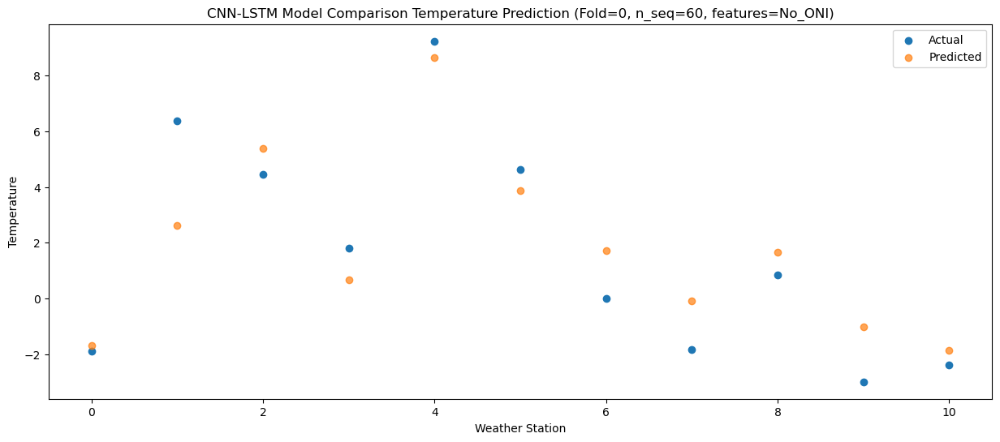

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.49  -1.435580
1                 1    6.15   4.029255
2                 2    6.64   6.218161
3                 3    4.58   2.390613
4                 4   11.57   8.706429
5                 5    5.68   3.957410
6                 6    1.93   1.871518
7                 7    0.23  -0.370276
8                 8    2.66   0.643800
9                 9   -1.76  -2.422914
10               10   -3.28  -4.166878


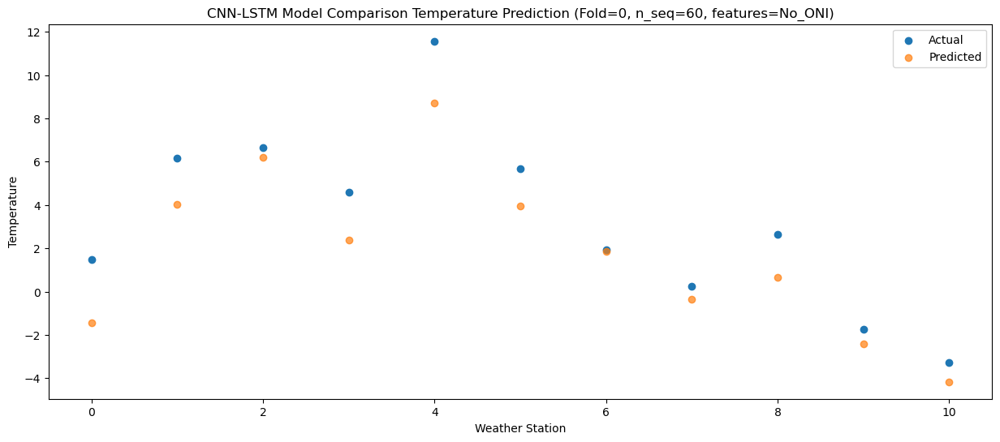

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -6.76  -8.656926
1                 1   -0.53  -1.937113
2                 2    0.63  -0.250493
3                 3   -2.77  -4.171247
4                 4    3.12   1.919987
5                 5   -0.70  -2.001288
6                 6   -4.72  -4.441305
7                 7   -6.95  -6.875498
8                 8   -5.85  -7.003154
9                 9  -10.73 -10.213744
10               10  -12.23 -12.049240
84/84 [==============================] - 9s 109ms/step - loss: 0.0596 - accuracy: 0.5238 - mae: 0.0472 - rmse: 0.0596 - mape: inf - pearson: 0.8438 - val_loss: 0.0673 - val_accuracy: 0.6000 - val_mae: 0.0540 - val_rmse: 0.0673 - val_mape: 12.4292 - val_pearson: 0.8445
Epoch 8/100
84/84 [==============================] - 9s 109ms/step - loss: 0.0592 - accuracy: 0.5714 - mae: 0.0467 - rmse: 0.0592 - mape: inf - pearson: 0.8419 - val_loss: 0.0563 - val_accuracy: 0.6000 - val_mae: 0.0452 - val_rmse: 0.0563 

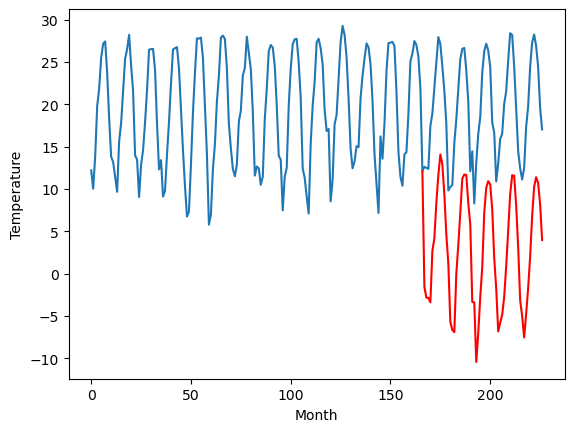

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.52		2.58		-0.94
2.61		1.29		-1.32
1.50		1.06		-0.44
1.59		0.32		-1.27
7.59		7.30		-0.29
8.81		8.83		0.02
12.16		13.47		1.31
16.51		17.49		0.98
19.88		19.76		-0.12
18.47		18.25		-0.22
14.93		14.34		-0.59
11.21		8.79		-2.42
7.11		5.90		-1.21
0.22		-1.25		-1.47
0.02		-2.45		-2.47
0.68		-3.89		-4.57
7.45		5.13		-2.32
9.59		8.41		-1.18
13.32		12.45		-0.87
17.46		17.08		-0.38
18.84		17.46		-1.38
19.11		17.49		-1.62
15.37		14.05		-1.32
11.59		11.20		-0.39
3.93		1.48		-2.45
5.56		1.61		-3.95
-1.17		-6.45		-5.28
3.06		-3.30		-6.36
6.63		1.78		-4.85
9.63		5.78		-3.85
15.51		12.89		-2.62
19.48		16.09		-3.39
19.98		17.07		-2.91
18.52		16.18		-2.34
15.43		12.99		-2.44
9.09		6.89		-2.20
6.09		2.68		-3.41
0.28		-2.57		-2.85
2.47		-1.43		-3.90
5.84		-0.41		-6.25
6.61		1.97		-4.64
9.88		6.02		-3.86
13.16		10.99		-2.17
16.35		15.64		-0.71
19.95		17.42		-2.53
19.41		17.46		-1.95
15.90		13.89		-2.01
10.89		8.3

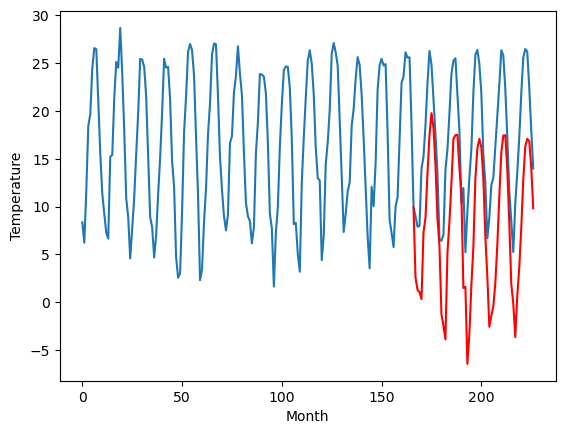

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.48		-1.06		0.42
-1.05		-2.18		-1.13
-1.58		-2.42		-0.84
-1.30		-3.09		-1.79
5.80		4.15		-1.65
4.83		5.46		0.63
8.98		9.80		0.82
13.21		13.58		0.37
14.68		15.53		0.85
14.67		14.21		-0.46
11.87		10.41		-1.46
7.52		4.97		-2.55
2.72		2.16		-0.56
-4.34		-4.98		-0.64
-3.92		-5.95		-2.03
-3.43		-7.49		-4.06
3.63		1.76		-1.87
5.03		4.63		-0.40
9.15		8.58		-0.57
13.03		12.93		-0.10
13.80		13.36		-0.44
14.46		13.39		-1.07
11.44		10.19		-1.25
7.66		7.28		-0.38
-0.08		-2.18		-2.10
2.52		-1.50		-4.02
-4.37		-9.64		-5.27
-1.02		-6.78		-5.76
2.98		-1.68		-4.66
6.57		2.47		-4.10
11.93		9.20		-2.73
14.90		12.44		-2.46
15.61		13.25		-2.36
14.00		12.10		-1.90
11.61		9.21		-2.40
4.92		3.13		-1.79
1.60		-1.29		-2.89
-1.56		-6.01		-4.45
-0.56		-4.95		-4.39
2.03		-3.66		-5.69
3.46		-1.11		-4.57
6.15		2.25		-3.90
9.39		7.39		-2.00
13.14		11.99		-1.15
15.51		13.52		-1.99
15.95		14.00		-1.95
12.99		10.27		-2.72
6.9

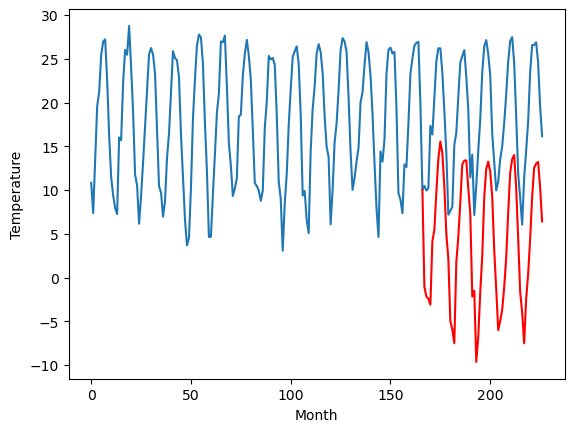

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		2.57		-1.48
2.63		1.20		-1.43
3.38		0.95		-2.43
2.85		0.37		-2.48
10.49		8.04		-2.45
10.37		9.56		-0.81
14.12		14.01		-0.11
16.90		17.81		0.91
18.55		19.27		0.72
18.79		18.41		-0.38
15.38		14.33		-1.05
10.84		8.24		-2.60
7.94		5.66		-2.28
1.76		-1.11		-2.87
1.66		-1.74		-3.40
0.07		-4.30		-4.37
7.44		6.05		-1.39
9.78		8.59		-1.19
13.67		12.68		-0.99
17.56		17.34		-0.22
17.44		17.93		0.49
18.41		17.65		-0.76
15.40		14.84		-0.56
12.71		10.91		-1.80
5.55		2.39		-3.16
8.92		2.64		-6.28
0.87		-4.98		-5.85
0.40		-3.12		-3.52
6.24		2.50		-3.74
12.24		7.07		-5.17
16.67		13.50		-3.17
19.67		17.33		-2.34
20.61		18.39		-2.22
18.97		16.89		-2.08
16.20		14.26		-1.94
10.64		7.97		-2.67
5.59		1.77		-3.82
3.50		-2.05		-5.55
4.21		-1.11		-5.32
5.21		0.28		-4.93
9.04		3.47		-5.57
9.88		6.41		-3.47
14.47		12.73		-1.74
18.62		17.25		-1.37
20.34		18.56		-1.78
22.31		19.74		-2.57
19.23		15.60		-3.63
11.97		9

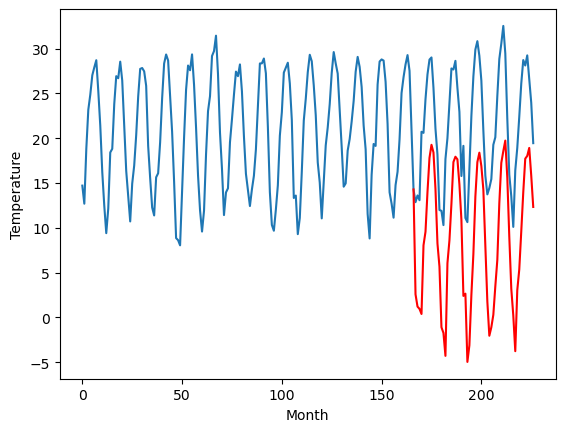

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.11		6.46		-1.65
6.22		5.09		-1.13
7.03		4.79		-2.24
6.65		4.18		-2.47
14.69		12.06		-2.63
14.43		13.56		-0.87
18.23		18.11		-0.12
21.26		22.05		0.79
23.30		23.47		0.17
23.54		22.55		-0.99
19.96		18.40		-1.56
15.02		12.15		-2.87
11.92		9.68		-2.24
5.56		2.85		-2.71
5.55		2.17		-3.38
3.85		-0.64		-4.49
11.46		10.18		-1.28
13.76		12.66		-1.10
17.88		16.80		-1.08
21.35		21.57		0.22
21.44		22.14		0.70
22.41		21.87		-0.54
18.83		19.07		0.24
15.79		15.07		-0.72
8.24		6.44		-1.80
12.12		6.75		-5.37
3.64		-1.09		-4.73
3.33		0.69		-2.64
9.11		6.50		-2.61
15.38		11.17		-4.21
20.00		17.72		-2.28
23.37		21.61		-1.76
24.46		22.71		-1.75
22.45		21.10		-1.35
19.27		18.43		-0.84
13.88		12.07		-1.81
8.88		5.71		-3.17
6.86		1.87		-4.99
7.34		2.84		-4.50
8.52		4.26		-4.26
12.34		7.52		-4.82
13.30		10.51		-2.79
17.94		17.02		-0.92
22.83		21.60		-1.23
24.78		22.80		-1.98
26.21		24.03		-2.18
22.36		19.87		-2.49
1

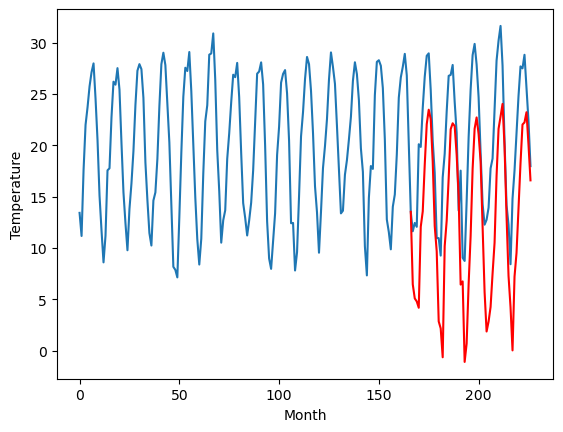

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.80		6.07		-1.73
5.77		4.05		-1.72
5.11		3.86		-1.25
4.59		3.37		-1.22
11.94		10.34		-1.60
14.73		12.75		-1.98
19.92		17.83		-2.09
22.64		21.82		-0.82
25.34		23.56		-1.78
25.19		22.94		-2.25
17.66		18.50		0.84
14.82		11.78		-3.04
11.10		8.88		-2.22
4.35		2.69		-1.66
2.84		2.14		-0.70
3.22		-0.66		-3.88
10.56		9.24		-1.32
12.83		12.50		-0.33
18.42		16.79		-1.63
22.69		22.22		-0.47
22.03		22.97		0.94
21.44		22.28		0.84
21.08		19.37		-1.71
16.76		14.61		-2.15
10.29		6.86		-3.43
10.55		4.96		-5.59
3.23		-1.17		-4.40
3.12		0.39		-2.73
10.07		6.12		-3.95
16.98		10.49		-6.49
22.38		17.12		-5.26
24.44		21.45		-2.99
25.36		23.16		-2.20
22.51		22.14		-0.37
19.46		19.19		-0.27
13.38		12.74		-0.64
6.42		5.24		-1.18
5.30		1.20		-4.10
5.76		2.19		-3.57
5.90		2.99		-2.91
10.96		6.37		-4.59
14.12		10.35		-3.77
18.73		17.20		-1.53
25.42		21.58		-3.84
26.52		23.44		-3.08
25.71		24.28		-1.43
23.43		20.14		-3.2

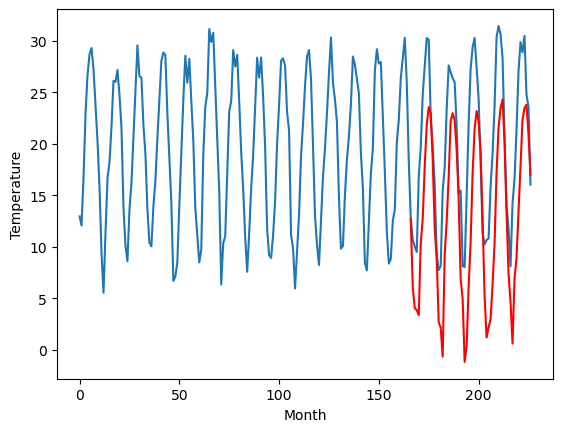

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.88		3.29		-0.59
3.15		1.95		-1.20
2.34		1.76		-0.58
2.41		1.03		-1.38
8.08		7.81		-0.27
9.71		9.39		-0.32
12.49		14.07		1.58
17.16		18.07		0.91
20.34		20.46		0.12
18.71		18.95		0.24
15.29		15.05		-0.24
11.80		9.56		-2.24
7.65		6.57		-1.08
0.44		-0.53		-0.97
0.24		-1.76		-2.00
1.02		-3.02		-4.04
7.30		5.65		-1.65
9.87		9.07		-0.80
13.64		13.10		-0.54
17.65		17.74		0.09
19.01		18.13		-0.88
19.27		18.15		-1.12
15.94		14.65		-1.29
11.99		11.84		-0.15
4.39		2.13		-2.26
5.91		2.07		-3.84
-0.48		-5.82		-5.34
3.33		-2.57		-5.90
7.17		2.40		-4.77
9.93		6.31		-3.62
15.85		13.44		-2.41
19.43		16.60		-2.83
20.17		17.63		-2.54
18.67		16.87		-1.80
15.78		13.62		-2.16
9.44		7.55		-1.89
6.55		3.45		-3.10
0.54		-1.91		-2.45
2.67		-0.75		-3.42
6.26		0.15		-6.11
6.93		2.47		-4.46
10.19		6.67		-3.52
13.19		11.49		-1.70
16.47		16.12		-0.35
19.92		18.05		-1.87
19.50		17.93		-1.57
16.33		14.42		-1.91
11.32		8.95	

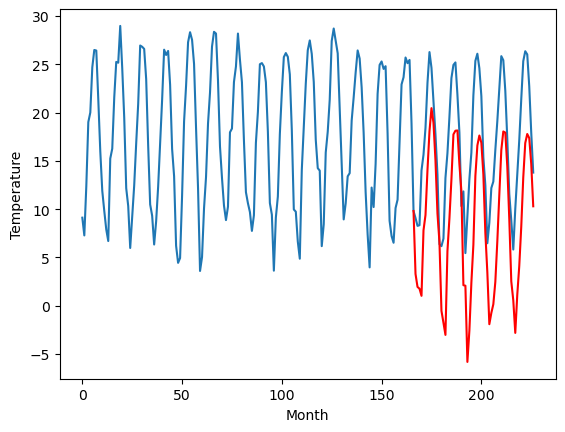

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.92		0.73		-0.19
0.30		-0.94		-1.24
-0.55		-1.51		-0.96
0.13		-2.45		-2.58
7.05		6.12		-0.93
8.19		8.02		-0.17
12.69		13.52		0.83
18.25		18.67		0.42
20.79		20.24		-0.55
18.77		18.73		-0.04
15.47		13.96		-1.51
8.70		6.51		-2.19
5.03		4.57		-0.46
-1.57		-2.57		-1.00
-1.88		-3.78		-1.90
-4.88		-7.92		-3.04
6.44		5.09		-1.35
8.15		8.00		-0.15
12.81		12.56		-0.25
18.89		18.45		-0.44
19.88		18.88		-1.00
21.10		18.63		-2.47
17.39		15.47		-1.92
12.19		11.07		-1.12
2.89		1.60		-1.29
5.30		1.08		-4.22
-3.53		-7.57		-4.04
-1.48		-5.80		-4.32
4.47		0.94		-3.53
9.66		5.93		-3.73
15.13		13.72		-1.41
19.19		17.96		-1.23
23.32		19.59		-3.73
20.45		17.79		-2.66
16.61		14.43		-2.18
9.94		7.65		-2.29
3.34		0.58		-2.76
-0.40		-4.26		-3.86
0.79		-3.08		-3.87
2.29		-1.86		-4.15
5.12		1.56		-3.56
9.52		6.01		-3.51
14.87		13.33		-1.54
18.68		18.33		-0.35
20.98		19.31		-1.67
21.48		20.13		-1.35
17.86		16.12		-1.74
1

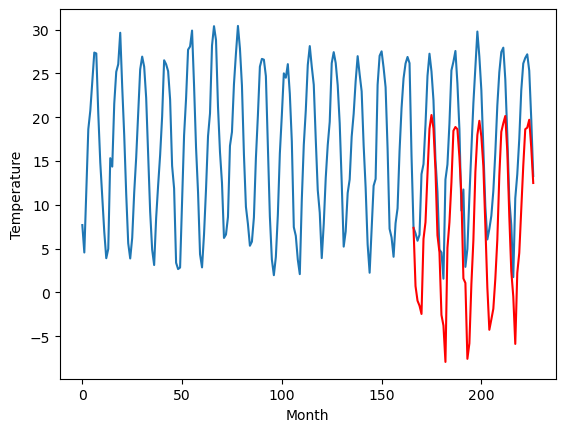

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.44		0.67		0.23
-1.41		-1.52		-0.11
-1.23		-2.07		-0.84
-1.74		-2.91		-1.17
6.09		5.70		-0.39
7.47		8.16		0.69
13.58		14.05		0.47
18.69		19.37		0.68
21.23		20.64		-0.59
20.30		19.55		-0.75
13.65		14.31		0.66
7.47		6.01		-1.46
4.59		4.18		-0.41
-2.09		-2.50		-0.41
-2.44		-3.41		-0.97
-7.22		-8.56		-1.34
5.34		5.26		-0.08
7.14		8.17		1.03
11.95		12.97		1.02
17.98		19.56		1.58
19.49		20.21		0.72
19.88		19.50		-0.38
17.37		16.57		-0.80
11.12		10.96		-0.16
3.37		2.61		-0.76
2.56		0.69		-1.87
-5.06		-6.83		-1.77
-4.08		-6.00		-1.92
3.17		1.18		-1.99
10.28		6.44		-3.84
15.64		14.12		-1.52
19.93		19.08		-0.85
24.08		21.25		-2.83
21.41		19.40		-2.01
17.58		16.04		-1.54
9.35		8.95		-0.40
1.50		-0.13		-1.63
-2.13		-4.51		-2.38
-1.27		-3.41		-2.14
-0.90		-2.36		-1.46
3.53		1.65		-1.88
7.86		6.33		-1.53
13.55		14.87		1.32
18.48		19.77		1.29
21.36		20.77		-0.59
23.17		22.00		-1.17
18.53		17.60		-0.93
9.95

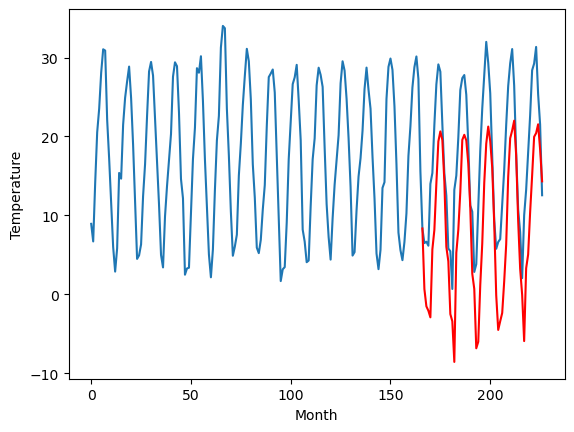

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.68		2.36		-2.32
3.32		-0.22		-3.54
2.87		-0.66		-3.53
1.63		-1.39		-3.02
9.59		6.44		-3.15
11.90		9.40		-2.50
18.43		15.53		-2.90
24.81		20.75		-4.06
26.39		22.33		-4.06
25.16		21.44		-3.72
18.41		16.07		-2.34
11.81		7.69		-4.12
8.63		5.50		-3.13
1.36		-0.78		-2.14
1.47		-1.61		-3.08
-2.90		-6.50		-3.60
7.81		6.29		-1.52
11.57		9.75		-1.82
16.12		14.61		-1.51
23.23		21.49		-1.74
23.90		22.22		-1.68
23.75		21.25		-2.50
21.80		18.22		-3.58
14.36		12.29		-2.07
8.11		4.45		-3.66
6.50		1.18		-5.32
-0.42		-5.19		-4.77
-0.36		-4.37		-4.01
6.57		2.58		-3.99
13.05		7.52		-5.53
18.50		15.20		-3.30
23.07		20.32		-2.75
26.67		22.79		-3.88
23.84		21.48		-2.36
21.43		17.96		-3.47
12.89		10.88		-2.01
3.90		1.37		-2.53
1.55		-3.18		-4.73
1.83		-2.09		-3.92
2.98		-1.46		-4.44
6.71		2.48		-4.23
12.06		7.76		-4.30
17.17		16.32		-0.85
20.40		21.03		0.63
25.02		22.53		-2.49
25.42		23.42		-2.00
21.90		19.09		-2

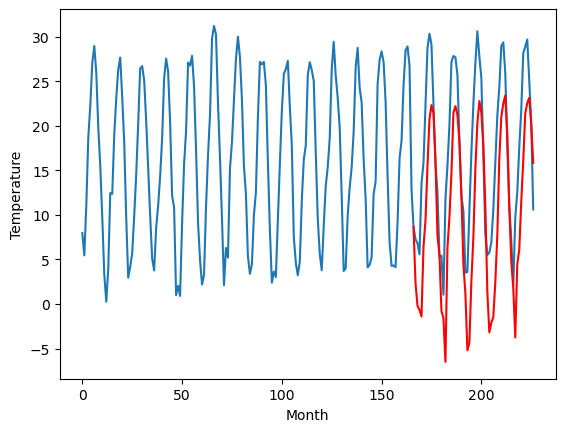

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.56		-1.93		-0.37
-4.37		-4.11		0.26
-4.03		-4.26		-0.23
-3.29		-5.28		-1.99
1.03		1.04		0.01
2.66		3.39		0.73
8.12		9.44		1.32
15.44		14.59		-0.85
19.31		17.91		-1.40
17.12		15.78		-1.34
12.59		11.12		-1.47
7.05		4.64		-2.41
2.85		1.66		-1.19
-4.16		-5.31		-1.15
-6.00		-7.43		-1.43
-6.96		-9.26		-2.30
0.26		-0.26		-0.52
4.91		4.47		-0.44
9.45		9.00		-0.45
15.54		14.95		-0.59
17.77		15.15		-2.62
17.55		15.15		-2.40
13.85		10.93		-2.92
9.43		7.71		-1.72
0.11		-2.78		-2.89
-0.66		-4.96		-4.30
-7.68		-12.79		-5.11
-3.78		-9.06		-5.28
0.78		-3.57		-4.35
4.13		0.31		-3.82
11.11		8.88		-2.23
15.50		12.29		-3.21
19.44		14.19		-5.25
18.90		14.04		-4.86
13.99		9.74		-4.25
5.89		3.32		-2.57
2.38		-1.15		-3.53
-4.77		-8.01		-3.24
-1.81		-6.48		-4.67
-2.13		-6.57		-4.44
-1.01		-4.42		-3.41
6.21		2.20		-4.01
8.77		7.27		-1.50
13.14		12.16		-0.98
18.28		14.81		-3.47
16.54		13.39		-3.15
13.35		10.24		-3.

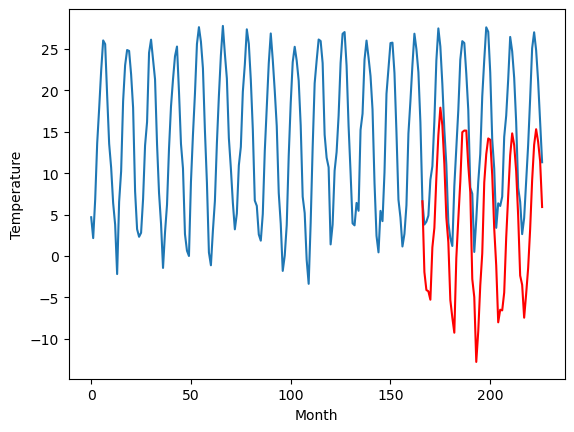

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.84  -1.549357
1                 1    3.52   2.576513
2                 2   -1.48  -1.055187
3                 3    4.05   2.570542
4                 4    8.11   6.461982
5                 5    7.80   6.065278
6                 6    3.88   3.291703
7                 7    0.92   0.727849
8                 8    0.44   0.669928
9                 9    4.68   2.356255
10               10   -1.56  -1.934209


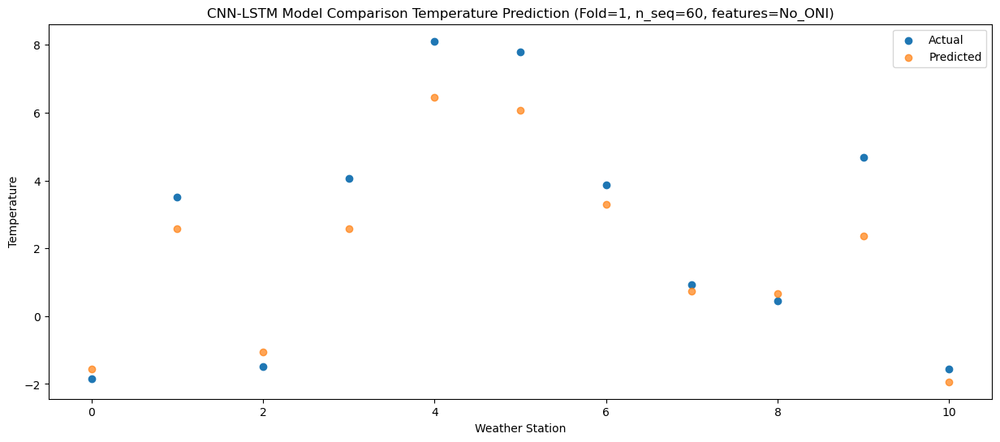

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.31  -2.835621
1                 1    2.61   1.289918
2                 2   -1.05  -2.180290
3                 3    2.63   1.201162
4                 4    6.22   5.093780
5                 5    5.77   4.051022
6                 6    3.15   1.949019
7                 7    0.30  -0.938754
8                 8   -1.41  -1.520222
9                 9    3.32  -0.215224
10               10   -4.37  -4.108642


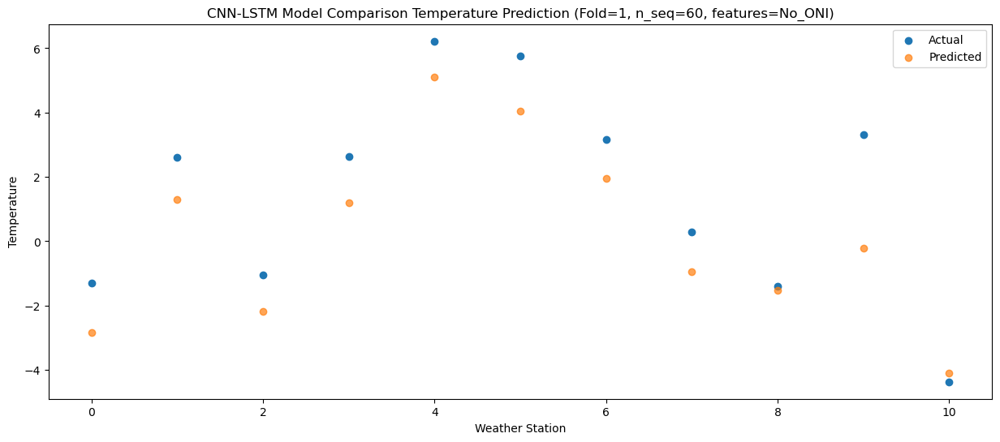

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -2.865891
1                 1    1.50   1.064866
2                 2   -1.58  -2.415696
3                 3    3.38   0.945708
4                 4    7.03   4.794744
5                 5    5.11   3.855588
6                 6    2.34   1.762846
7                 7   -0.55  -1.509249
8                 8   -1.23  -2.073239
9                 9    2.87  -0.661058
10               10   -4.03  -4.259986


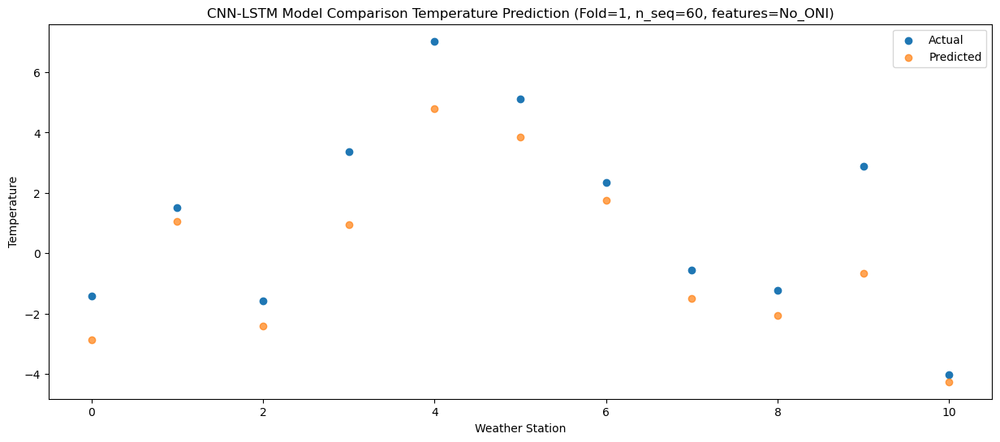

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -3.384483
1                 1    1.59   0.322713
2                 2   -1.30  -3.091523
3                 3    2.85   0.374848
4                 4    6.65   4.183513
5                 5    4.59   3.371734
6                 6    2.41   1.027547
7                 7    0.13  -2.451142
8                 8   -1.74  -2.910682
9                 9    1.63  -1.393225
10               10   -3.29  -5.275611


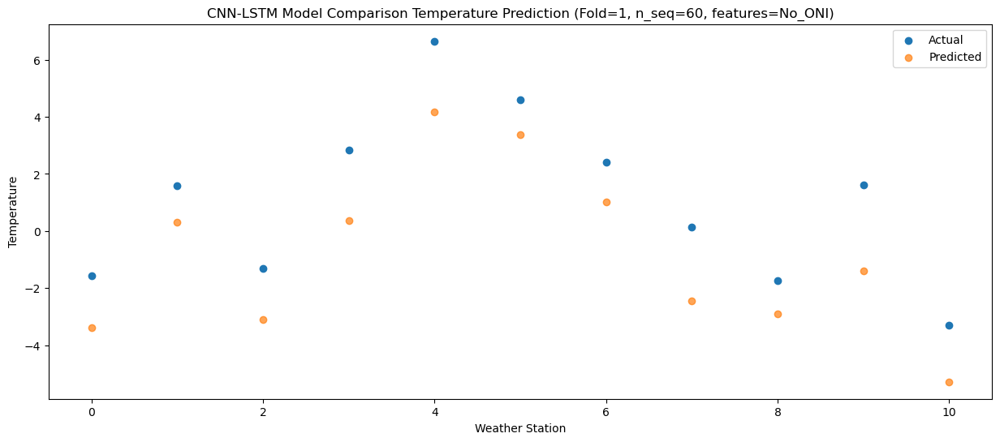

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.50   2.670665
1                 1    7.59   7.298125
2                 2    5.80   4.146962
3                 3   10.49   8.044393
4                 4   14.69  12.062134
5                 5   11.94  10.338724
6                 6    8.08   7.805976
7                 7    7.05   6.115195
8                 8    6.09   5.698011
9                 9    9.59   6.439876
10               10    1.03   1.040759


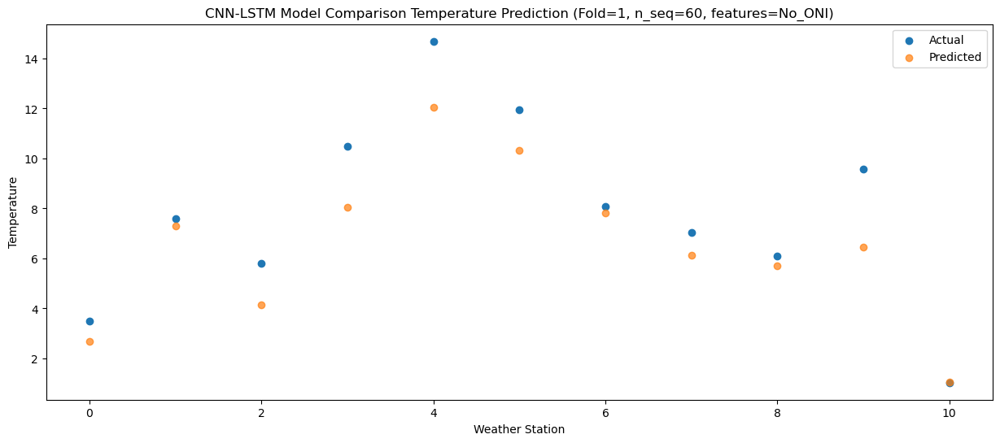

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.99   4.208492
1                 1    8.81   8.825294
2                 2    4.83   5.461813
3                 3   10.37   9.557038
4                 4   14.43  13.564764
5                 5   14.73  12.749463
6                 6    9.71   9.392993
7                 7    8.19   8.015614
8                 8    7.47   8.157795
9                 9   11.90   9.403273
10               10    2.66   3.388853


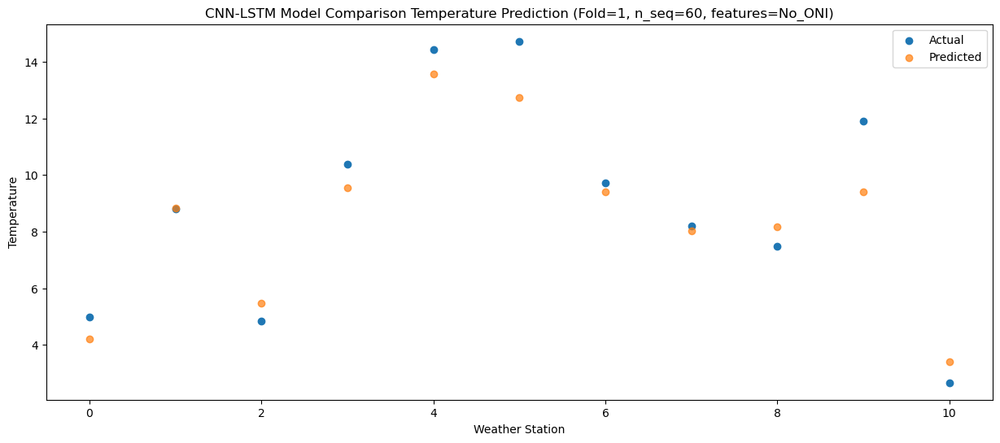

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.07   8.397362
1                 1   12.16  13.472703
2                 2    8.98   9.803106
3                 3   14.12  14.014502
4                 4   18.23  18.107374
5                 5   19.92  17.827569
6                 6   12.49  14.072674
7                 7   12.69  13.523456
8                 8   13.58  14.047024
9                 9   18.43  15.532512
10               10    8.12   9.442050


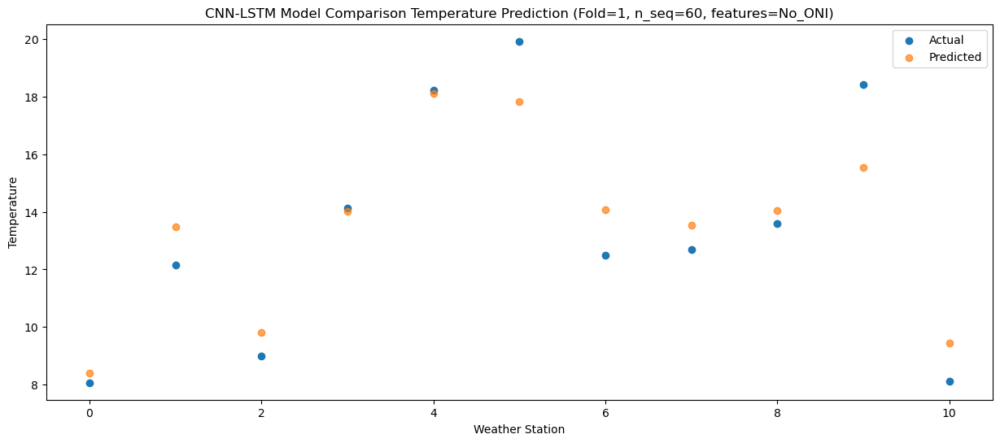

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   11.07  11.654188
1                 1   16.51  17.487780
2                 2   13.21  13.580155
3                 3   16.90  17.806566
4                 4   21.26  22.054842
5                 5   22.64  21.817753
6                 6   17.16  18.070215
7                 7   18.25  18.672978
8                 8   18.69  19.370127
9                 9   24.81  20.754570
10               10   15.44  14.587014


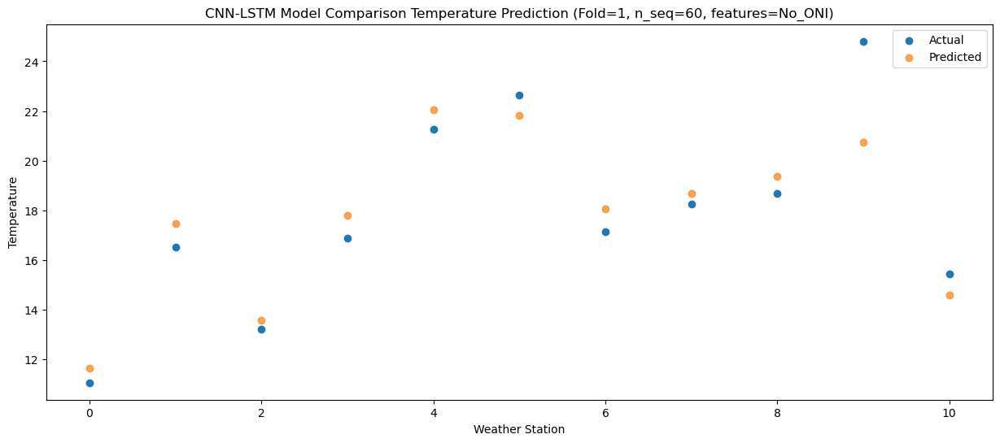

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.02  14.075002
1                 1   19.88  19.761721
2                 2   14.68  15.534373
3                 3   18.55  19.267148
4                 4   23.30  23.465281
5                 5   25.34  23.559383
6                 6   20.34  20.462760
7                 7   20.79  20.243377
8                 8   21.23  20.638712
9                 9   26.39  22.329065
10               10   19.31  17.909321


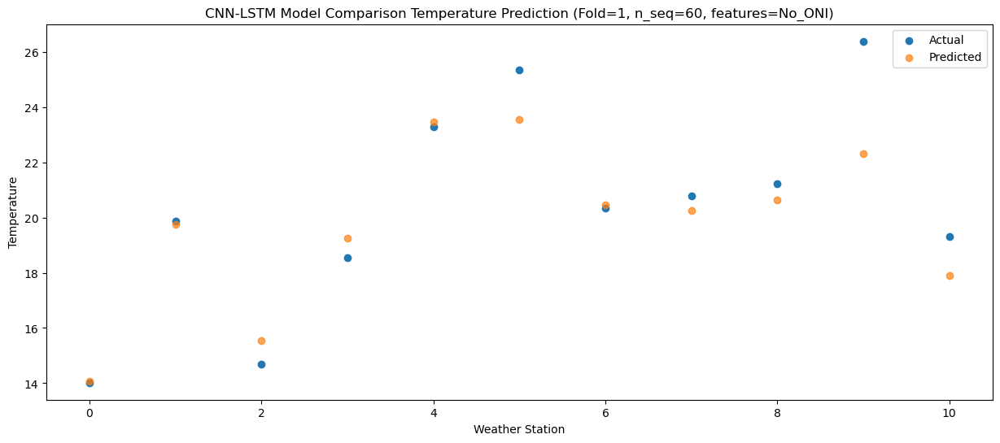

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.18  12.915740
1                 1   18.47  18.252438
2                 2   14.67  14.213190
3                 3   18.79  18.407389
4                 4   23.54  22.549534
5                 5   25.19  22.941257
6                 6   18.71  18.952306
7                 7   18.77  18.725616
8                 8   20.30  19.554275
9                 9   25.16  21.439396
10               10   17.12  15.779406


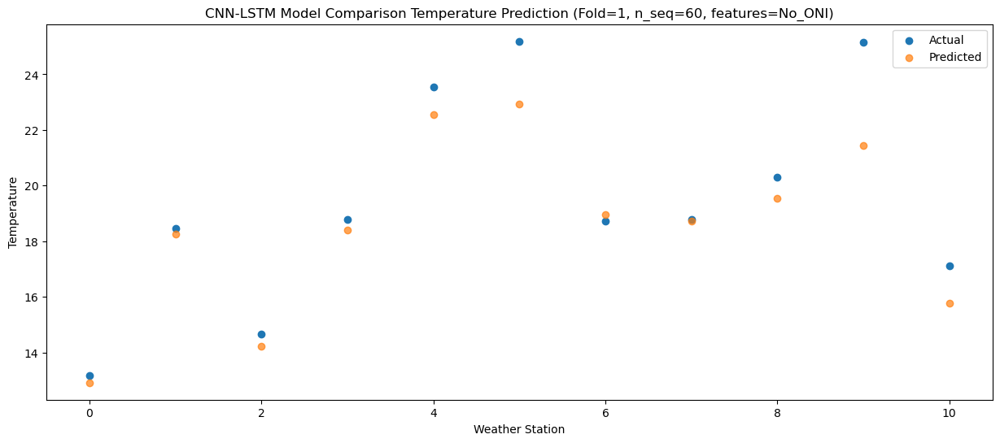

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.56   9.362719
1                 1   14.93  14.335531
2                 2   11.87  10.412256
3                 3   15.38  14.332424
4                 4   19.96  18.403367
5                 5   17.66  18.497007
6                 6   15.29  15.046187
7                 7   15.47  13.957730
8                 8   13.65  14.308121
9                 9   18.41  16.072863
10               10   12.59  11.124397


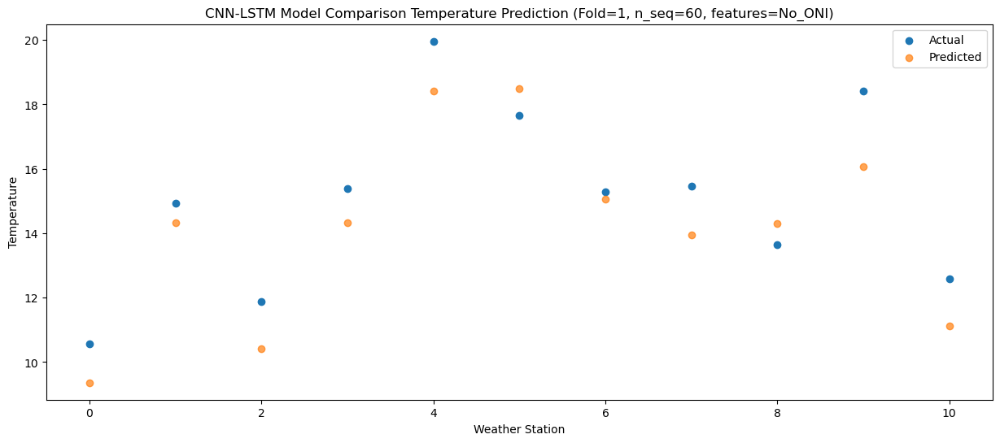

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   4.592346
1                 1   11.21   8.786588
2                 2    7.52   4.969336
3                 3   10.84   8.243060
4                 4   15.02  12.147929
5                 5   14.82  11.778129
6                 6   11.80   9.556243
7                 7    8.70   6.512002
8                 8    7.47   6.011998
9                 9   11.81   7.691464
10               10    7.05   4.641845


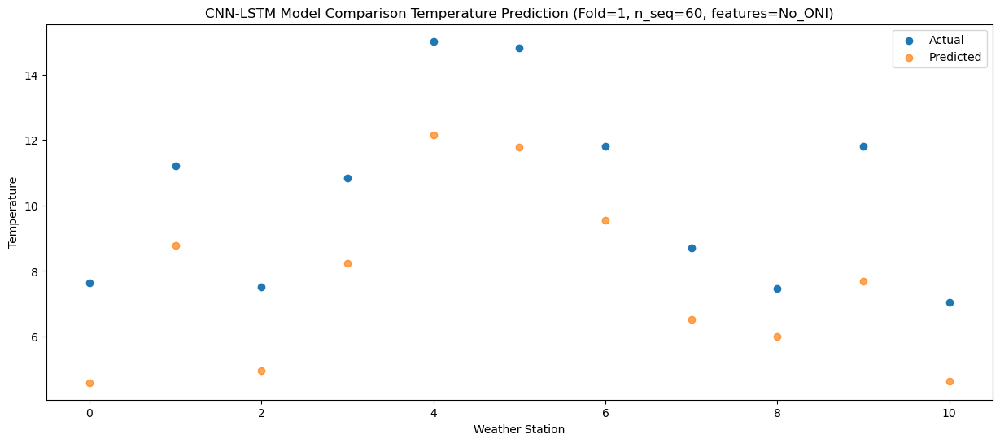

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    3.73   1.185684
1                 1    7.11   5.898835
2                 2    2.72   2.161486
3                 3    7.94   5.659947
4                 4   11.92   9.675632
5                 5   11.10   8.882741
6                 6    7.65   6.569984
7                 7    5.03   4.574699
8                 8    4.59   4.178896
9                 9    8.63   5.500197
10               10    2.85   1.659845


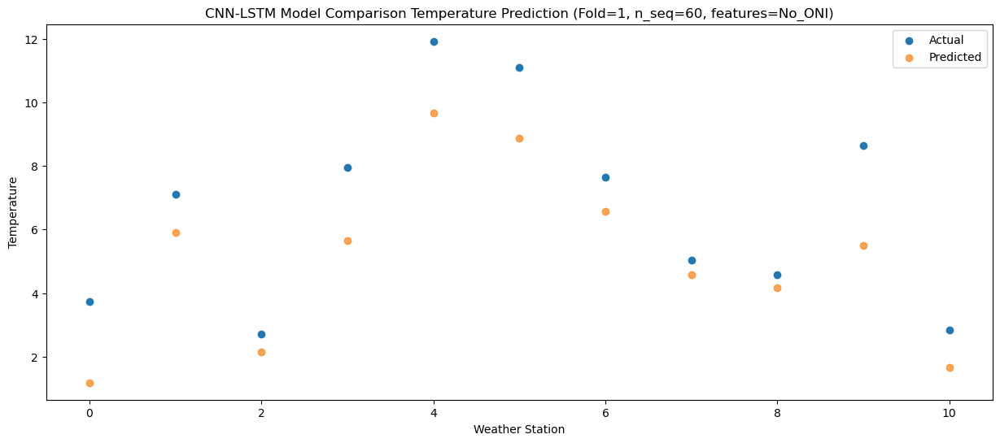

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.11  -5.696576
1                 1    0.22  -1.254638
2                 2   -4.34  -4.977443
3                 3    1.76  -1.107833
4                 4    5.56   2.851465
5                 5    4.35   2.694008
6                 6    0.44  -0.525991
7                 7   -1.57  -2.569129
8                 8   -2.09  -2.502852
9                 9    1.36  -0.777573
10               10   -4.16  -5.307963


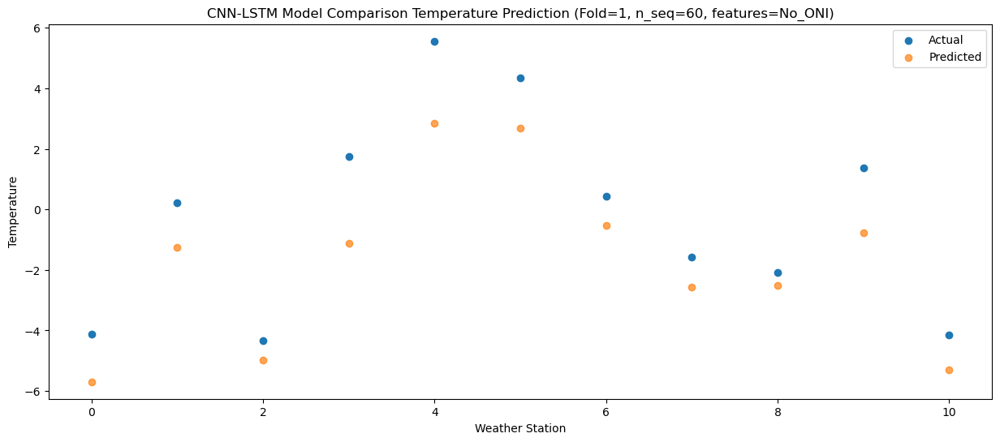

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.69  -6.651586
1                 1    0.02  -2.452613
2                 2   -3.92  -5.948420
3                 3    1.66  -1.741877
4                 4    5.55   2.173796
5                 5    2.84   2.143963
6                 6    0.24  -1.757695
7                 7   -1.88  -3.776389
8                 8   -2.44  -3.412630
9                 9    1.47  -1.613065
10               10   -6.00  -7.427352


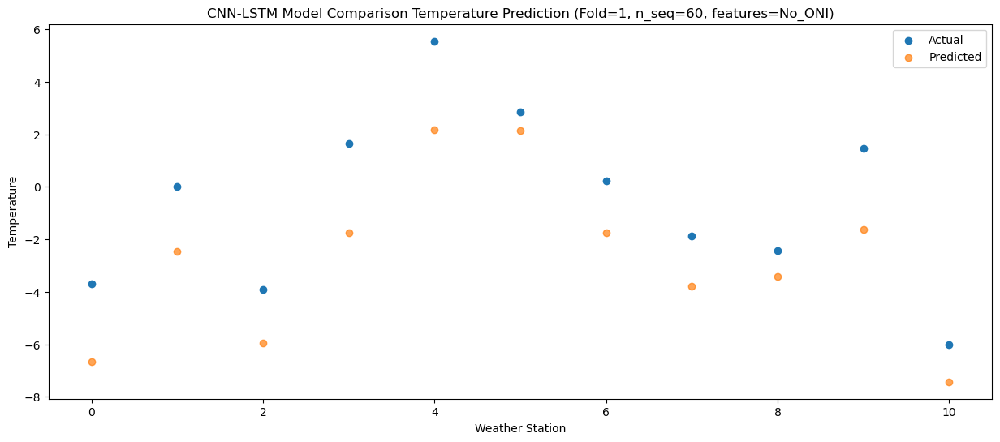

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -6.912421
1                 1    0.68  -3.886848
2                 2   -3.43  -7.493364
3                 3    0.07  -4.300410
4                 4    3.85  -0.638838
5                 5    3.22  -0.658396
6                 6    1.02  -3.021886
7                 7   -4.88  -7.924571
8                 8   -7.22  -8.560555
9                 9   -2.90  -6.497748
10               10   -6.96  -9.260746


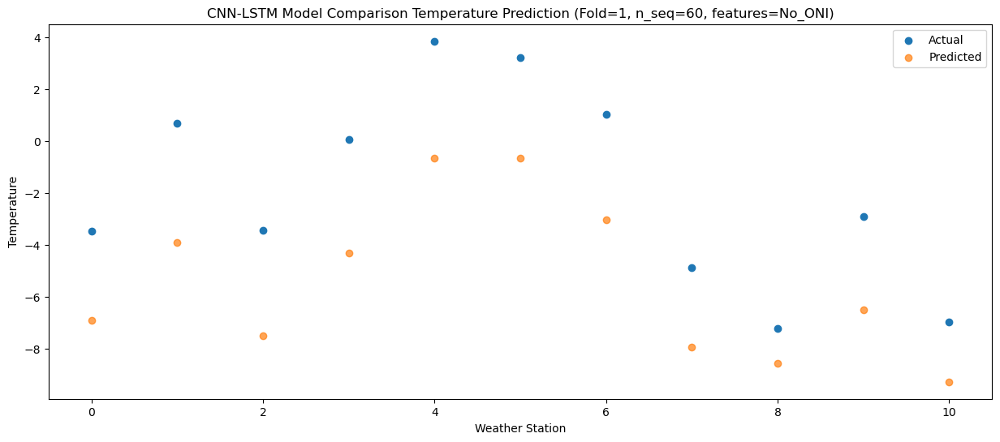

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.51  -0.005197
1                 1    7.45   5.126168
2                 2    3.63   1.760182
3                 3    7.44   6.054501
4                 4   11.46  10.177558
5                 5   10.56   9.238819
6                 6    7.30   5.654598
7                 7    6.44   5.093517
8                 8    5.34   5.264227
9                 9    7.81   6.290482
10               10    0.26  -0.257595


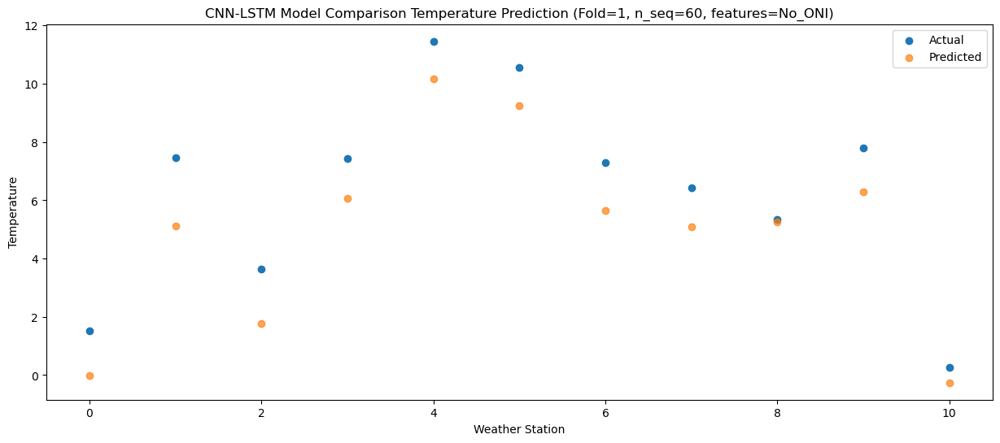

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.32   3.415969
1                 1    9.59   8.411110
2                 2    5.03   4.631209
3                 3    9.78   8.589429
4                 4   13.76  12.658149
5                 5   12.83  12.496592
6                 6    9.87   9.067071
7                 7    8.15   7.997157
8                 8    7.14   8.166505
9                 9   11.57   9.753419
10               10    4.91   4.471557


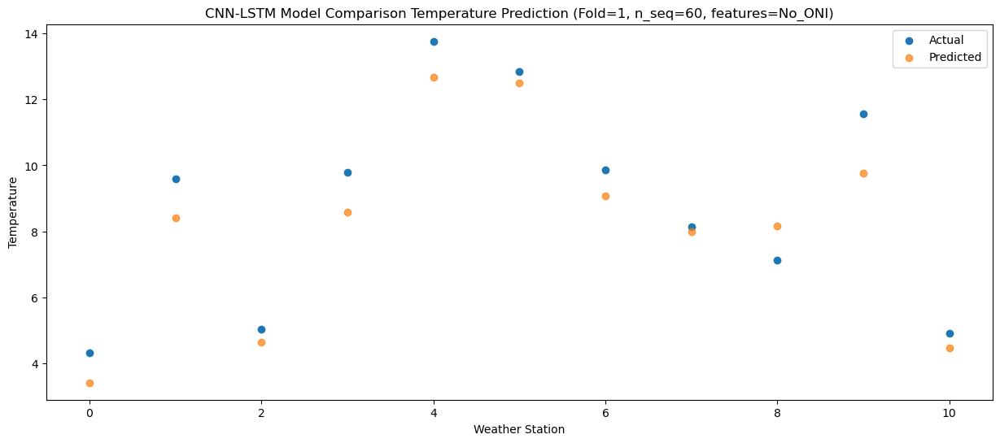

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.93   7.183582
1                 1   13.32  12.445921
2                 2    9.15   8.576859
3                 3   13.67  12.683500
4                 4   17.88  16.798923
5                 5   18.42  16.788431
6                 6   13.64  13.101593
7                 7   12.81  12.561352
8                 8   11.95  12.967149
9                 9   16.12  14.611268
10               10    9.45   8.996739


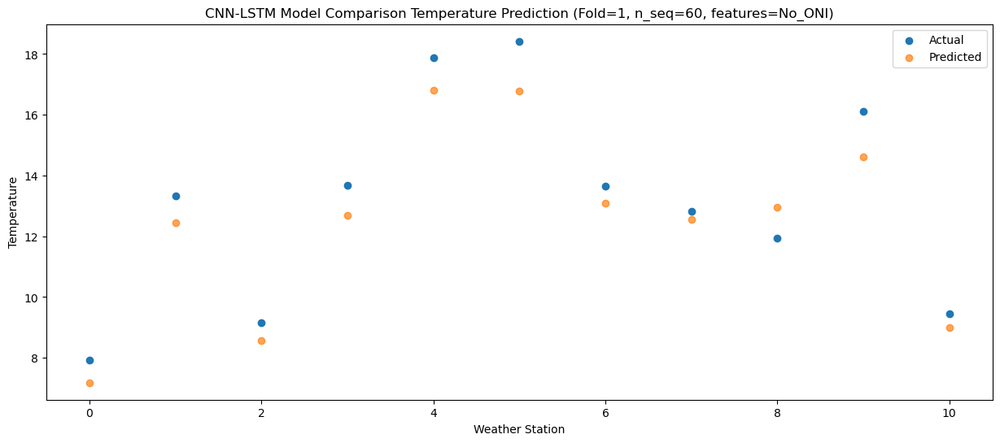

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.42  11.234736
1                 1   17.46  17.076515
2                 2   13.03  12.933215
3                 3   17.56  17.339936
4                 4   21.35  21.565420
5                 5   22.69  22.218220
6                 6   17.65  17.743679
7                 7   18.89  18.452682
8                 8   17.98  19.564063
9                 9   23.23  21.486508
10               10   15.54  14.951402


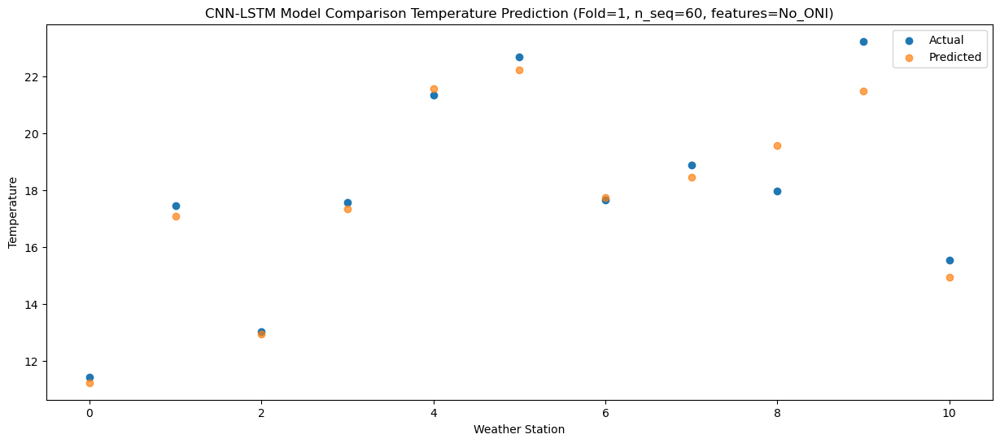

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.62  11.708439
1                 1   18.84  17.455398
2                 2   13.80  13.359700
3                 3   17.44  17.934966
4                 4   21.44  22.141700
5                 5   22.03  22.966316
6                 6   19.01  18.125341
7                 7   19.88  18.876463
8                 8   19.49  20.209291
9                 9   23.90  22.218131
10               10   17.77  15.147205


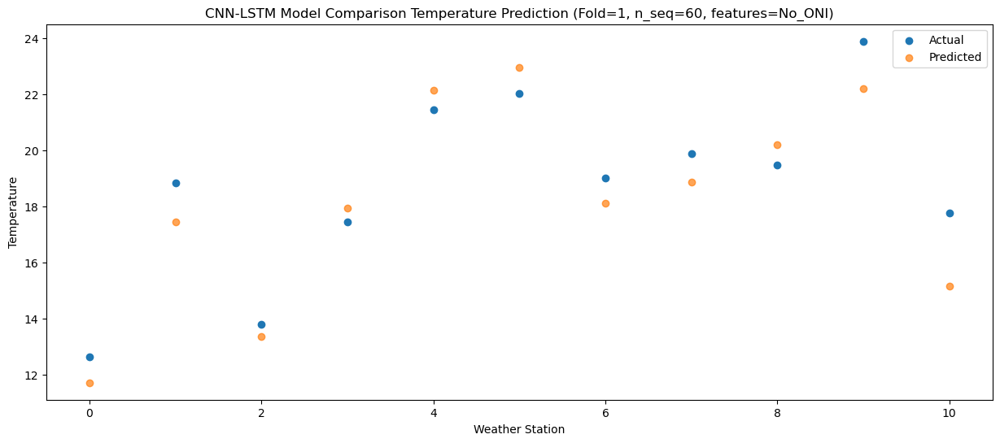

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.73  11.662627
1                 1   19.11  17.491869
2                 2   14.46  13.387837
3                 3   18.41  17.645333
4                 4   22.41  21.868520
5                 5   21.44  22.275770
6                 6   19.27  18.154335
7                 7   21.10  18.630863
8                 8   19.88  19.498345
9                 9   23.75  21.251419
10               10   17.55  15.145760


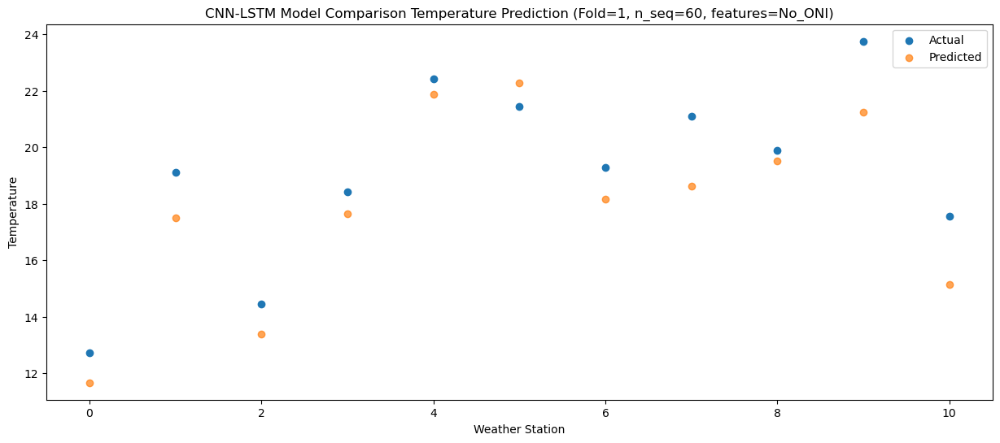

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.08   8.317049
1                 1   15.37  14.053992
2                 2   11.44  10.187212
3                 3   15.40  14.844562
4                 4   18.83  19.067376
5                 5   21.08  19.372026
6                 6   15.94  14.651001
7                 7   17.39  15.467696
8                 8   17.37  16.569632
9                 9   21.80  18.216090
10               10   13.85  10.927656


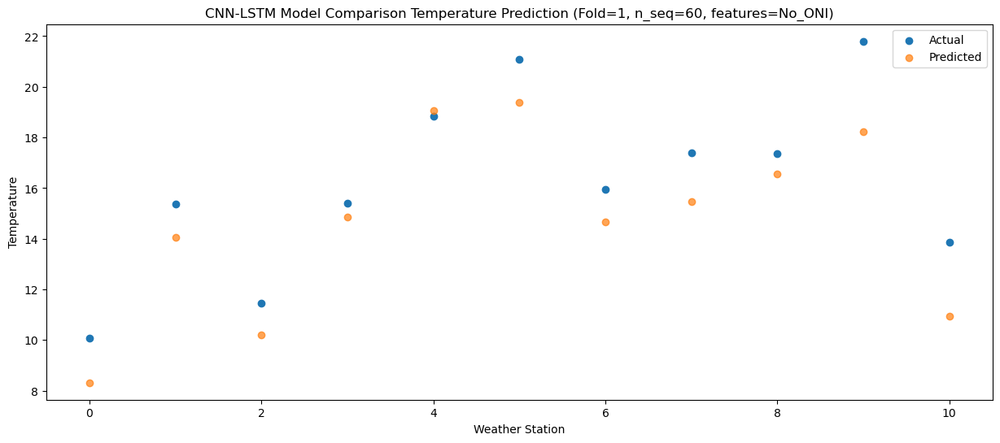

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.38   5.789365
1                 1   11.59  11.203149
2                 2    7.66   7.276237
3                 3   12.71  10.912500
4                 4   15.79  15.065671
5                 5   16.76  14.606641
6                 6   11.99  11.837081
7                 7   12.19  11.066539
8                 8   11.12  10.961134
9                 9   14.36  12.289203
10               10    9.43   7.706517


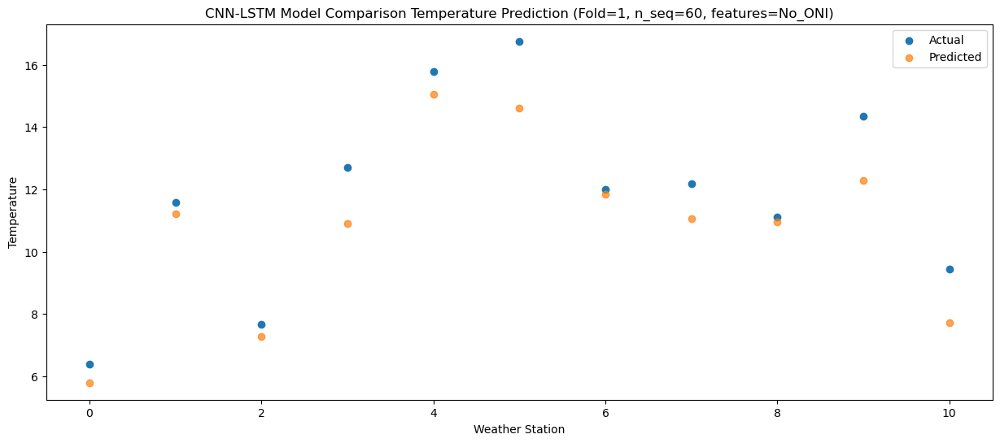

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.83  -3.347270
1                 1    3.93   1.476291
2                 2   -0.08  -2.180954
3                 3    5.55   2.393480
4                 4    8.24   6.435929
5                 5   10.29   6.859636
6                 6    4.39   2.125814
7                 7    2.89   1.595318
8                 8    3.37   2.611417
9                 9    8.11   4.451343
10               10    0.11  -2.780180


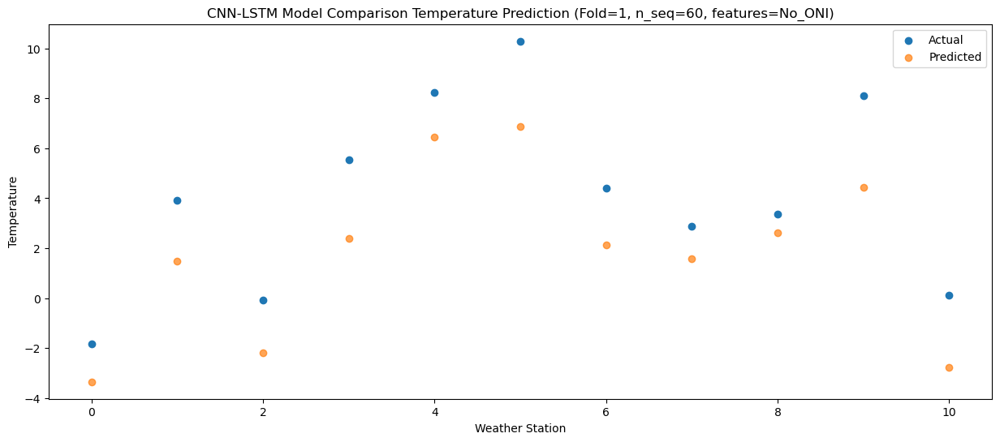

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.52  -3.397358
1                 1    5.56   1.606172
2                 2    2.52  -1.496462
3                 3    8.92   2.644256
4                 4   12.12   6.747347
5                 5   10.55   4.959663
6                 6    5.91   2.073322
7                 7    5.30   1.082838
8                 8    2.56   0.686628
9                 9    6.50   1.180703
10               10   -0.66  -4.959224


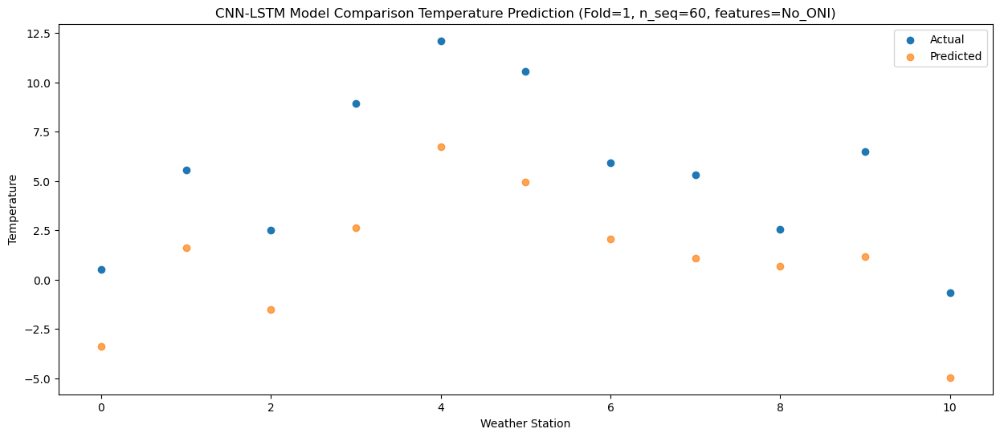

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.64 -10.422821
1                 1   -1.17  -6.451651
2                 2   -4.37  -9.639130
3                 3    0.87  -4.976870
4                 4    3.64  -1.091251
5                 5    3.23  -1.165496
6                 6   -0.48  -5.820736
7                 7   -3.53  -7.573175
8                 8   -5.06  -6.832526
9                 9   -0.42  -5.189581
10               10   -7.68 -12.788761


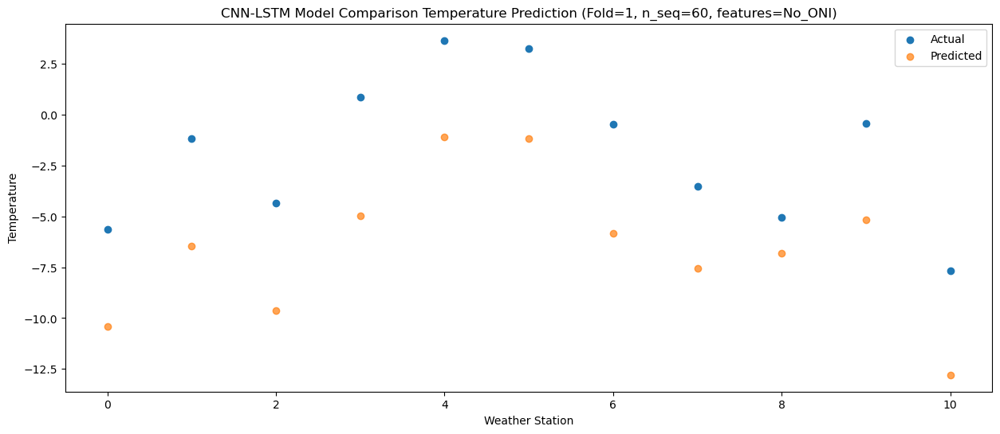

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.80  -7.002395
1                 1    3.06  -3.302634
2                 2   -1.02  -6.778392
3                 3    0.40  -3.121475
4                 4    3.33   0.694704
5                 5    3.12   0.393160
6                 6    3.33  -2.573786
7                 7   -1.48  -5.803317
8                 8   -4.08  -6.003950
9                 9   -0.36  -4.365165
10               10   -3.78  -9.063459


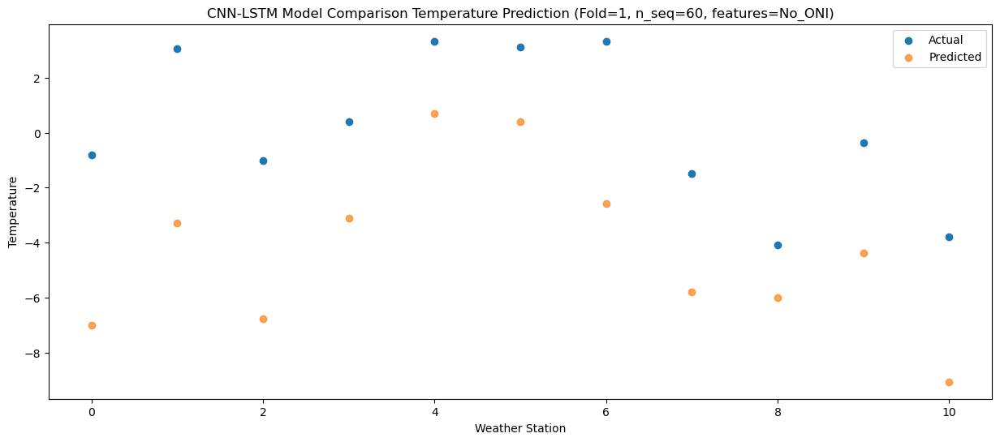

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.59  -2.753972
1                 1    6.63   1.777495
2                 2    2.98  -1.681516
3                 3    6.24   2.503383
4                 4    9.11   6.497678
5                 5   10.07   6.119961
6                 6    7.17   2.402174
7                 7    4.47   0.940348
8                 8    3.17   1.177010
9                 9    6.57   2.582718
10               10    0.78  -3.569928


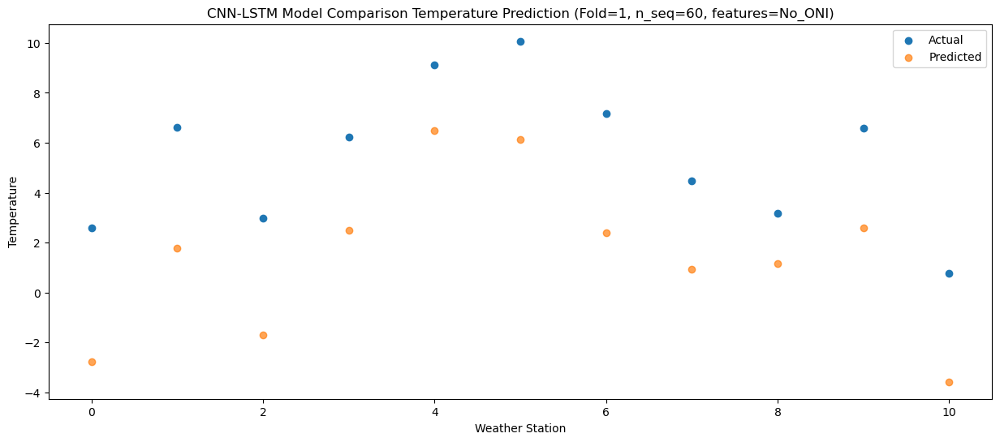

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.58   0.766508
1                 1    9.63   5.782288
2                 2    6.57   2.465310
3                 3   12.24   7.069545
4                 4   15.38  11.174498
5                 5   16.98  10.489904
6                 6    9.93   6.312296
7                 7    9.66   5.928032
8                 8   10.28   6.438461
9                 9   13.05   7.516834
10               10    4.13   0.306854


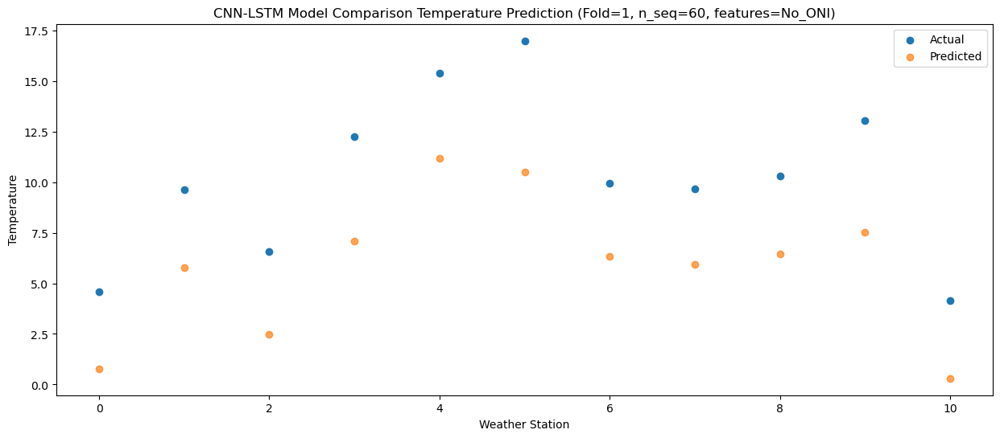

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.83   7.195211
1                 1   15.51  12.890391
2                 2   11.93   9.203629
3                 3   16.67  13.498061
4                 4   20.00  17.718802
5                 5   22.38  17.116433
6                 6   15.85  13.438222
7                 7   15.13  13.724824
8                 8   15.64  14.120343
9                 9   18.50  15.197839
10               10   11.11   8.877533


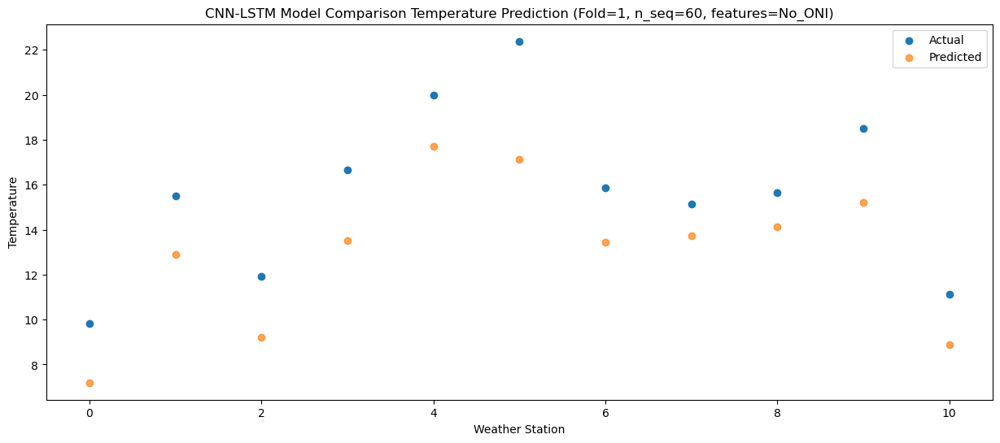

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.33  10.150209
1                 1   19.48  16.086483
2                 2   14.90  12.440361
3                 3   19.67  17.332369
4                 4   23.37  21.609630
5                 5   24.44  21.454927
6                 6   19.43  16.597042
7                 7   19.19  17.964534
8                 8   19.93  19.084209
9                 9   23.07  20.324258
10               10   15.50  12.290999


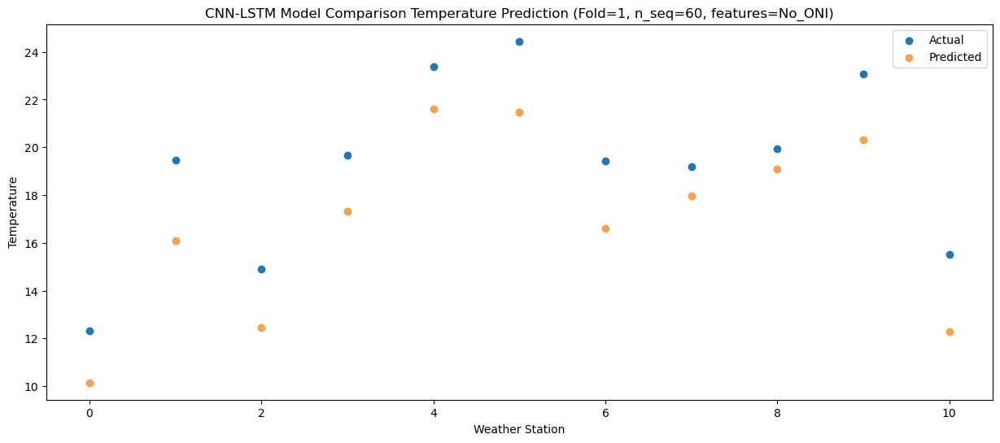

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.23  10.924490
1                 1   19.98  17.070813
2                 2   15.61  13.245189
3                 3   20.61  18.389120
4                 4   24.46  22.710408
5                 5   25.36  23.163666
6                 6   20.17  17.628770
7                 7   23.32  19.585376
8                 8   24.08  21.247961
9                 9   26.67  22.788497
10               10   19.44  14.192017


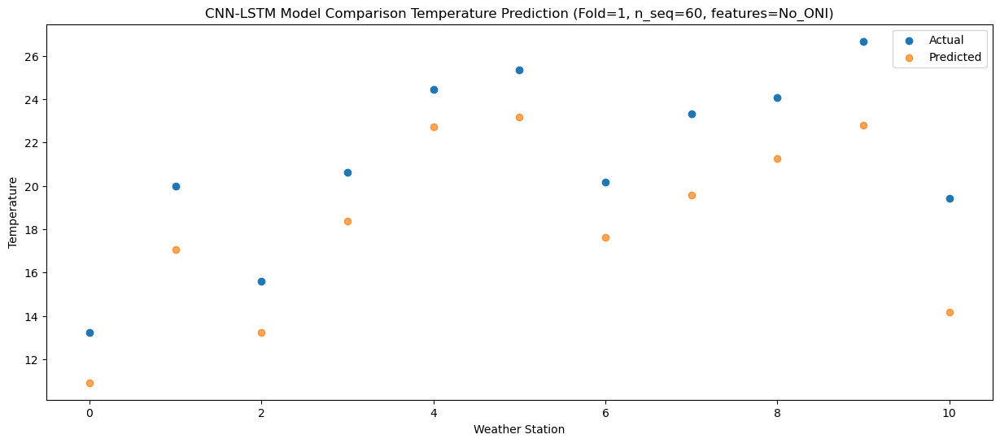

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.43  10.538618
1                 1   18.52  16.180087
2                 2   14.00  12.100374
3                 3   18.97  16.890640
4                 4   22.45  21.097029
5                 5   22.51  22.136024
6                 6   18.67  16.873841
7                 7   20.45  17.787713
8                 8   21.41  19.403404
9                 9   23.84  21.482168
10               10   18.90  14.036254


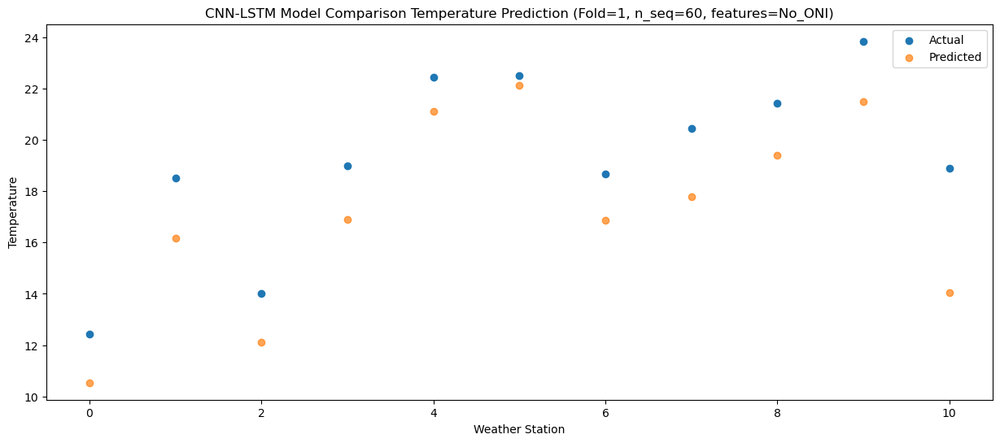

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.47   7.605428
1                 1   15.43  12.989834
2                 2   11.61   9.205381
3                 3   16.20  14.261010
4                 4   19.27  18.428059
5                 5   19.46  19.194999
6                 6   15.78  13.620463
7                 7   16.61  14.434303
8                 8   17.58  16.035916
9                 9   21.43  17.964149
10               10   13.99   9.742412


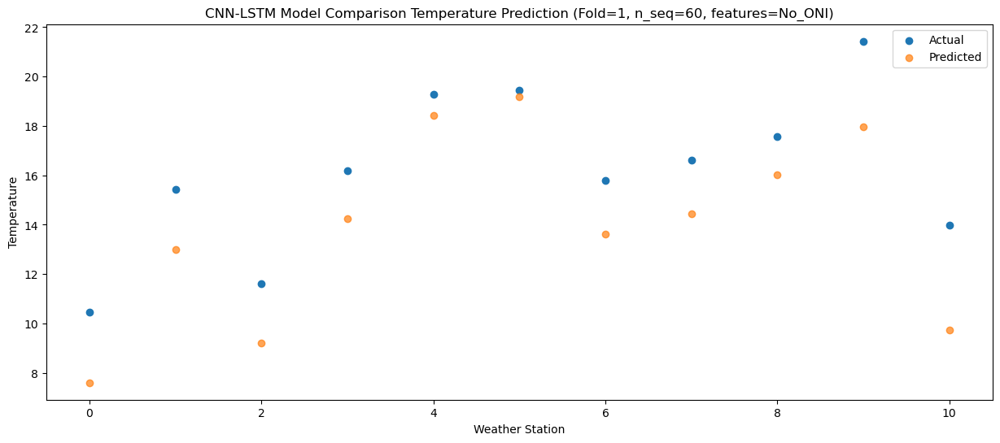

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.92   1.832599
1                 1    9.09   6.889747
2                 2    4.92   3.132217
3                 3   10.64   7.966515
4                 4   13.88  12.068636
5                 5   13.38  12.738318
6                 6    9.44   7.547041
7                 7    9.94   7.654433
8                 8    9.35   8.949142
9                 9   12.89  10.883551
10               10    5.89   3.315943


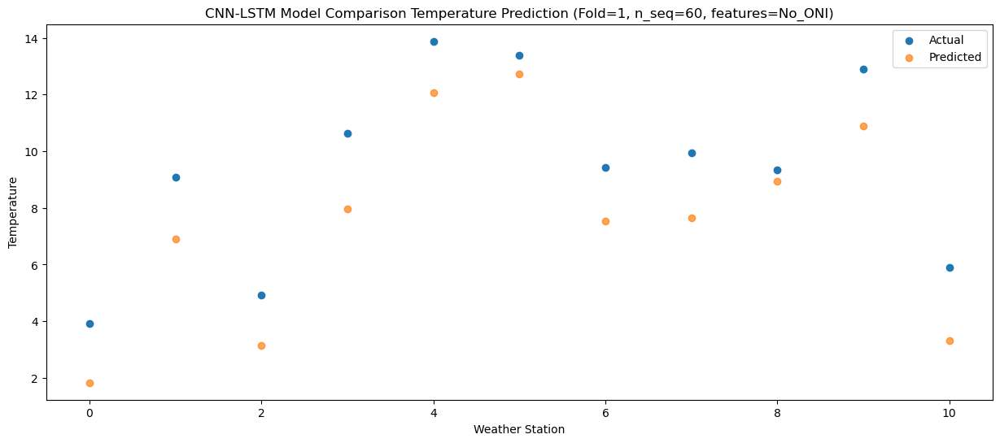

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.72  -1.754271
1                 1    6.09   2.675626
2                 2    1.60  -1.292712
3                 3    5.59   1.766118
4                 4    8.88   5.711598
5                 5    6.42   5.242851
6                 6    6.55   3.449778
7                 7    3.34   0.578557
8                 8    1.50  -0.127516
9                 9    3.90   1.374175
10               10    2.38  -1.149280


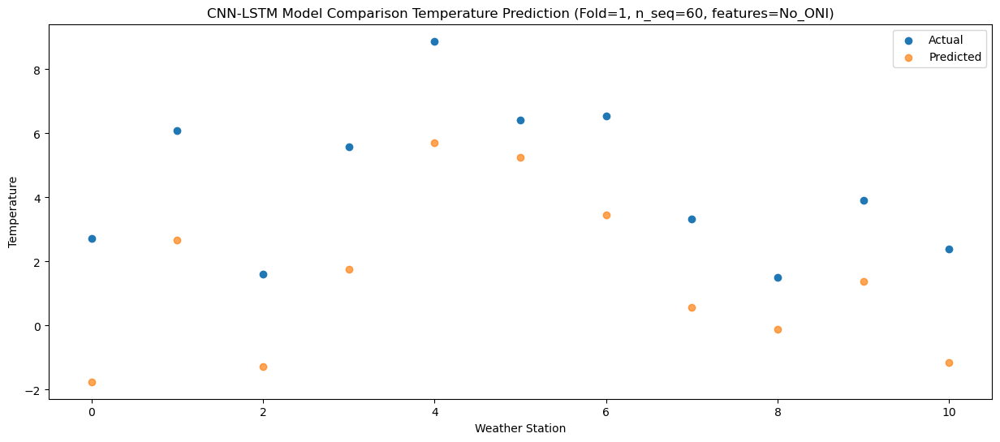

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.04  -6.819202
1                 1    0.28  -2.567769
2                 2   -1.56  -6.005389
3                 3    3.50  -2.051135
4                 4    6.86   1.870858
5                 5    5.30   1.198629
6                 6    0.54  -1.914105
7                 7   -0.40  -4.257645
8                 8   -2.13  -4.506152
9                 9    1.55  -3.183268
10               10   -4.77  -8.008152


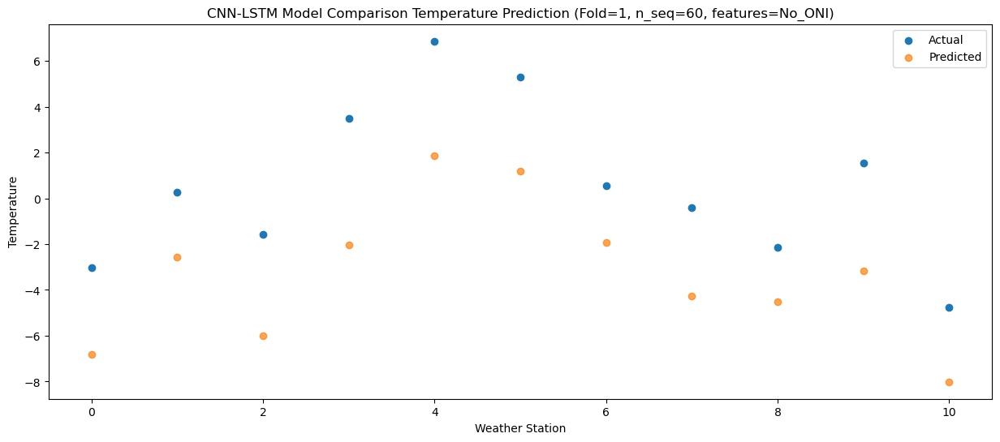

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -5.784326
1                 1    2.47  -1.425252
2                 2   -0.56  -4.951571
3                 3    4.21  -1.105601
4                 4    7.34   2.839633
5                 5    5.76   2.191794
6                 6    2.67  -0.748947
7                 7    0.79  -3.080316
8                 8   -1.27  -3.405429
9                 9    1.83  -2.086760
10               10   -1.81  -6.484685


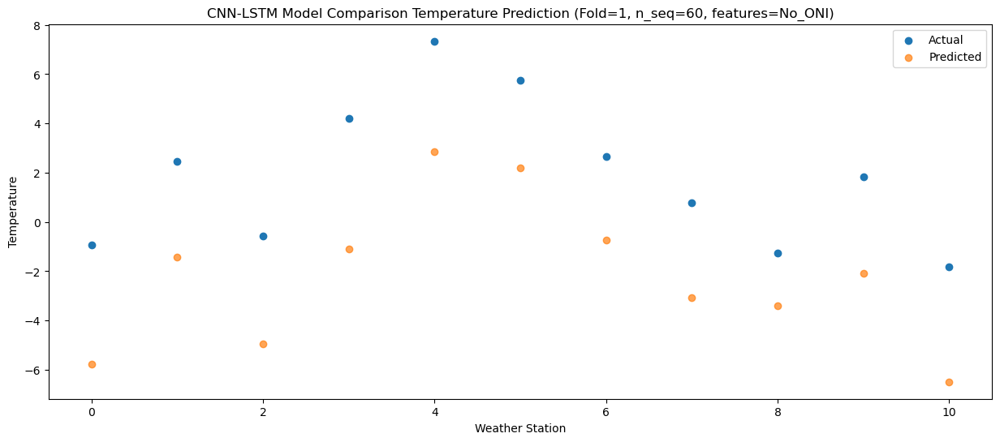

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.98  -4.850923
1                 1    5.84  -0.412142
2                 2    2.03  -3.658520
3                 3    5.21   0.282221
4                 4    8.52   4.262241
5                 5    5.90   2.989560
6                 6    6.26   0.154217
7                 7    2.29  -1.859701
8                 8   -0.90  -2.356708
9                 9    2.98  -1.458472
10               10   -2.13  -6.568801


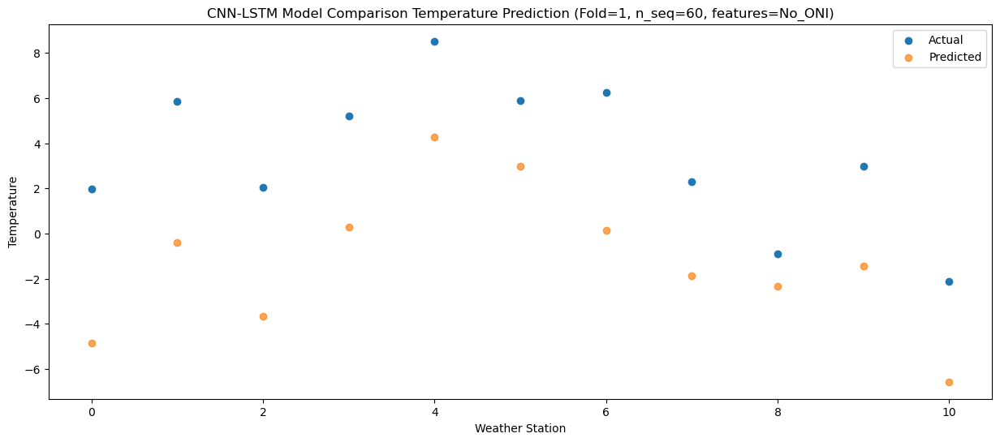

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.62  -2.729657
1                 1    6.61   1.968735
2                 2    3.46  -1.110194
3                 3    9.04   3.468063
4                 4   12.34   7.516040
5                 5   10.96   6.367051
6                 6    6.93   2.466427
7                 7    5.12   1.557215
8                 8    3.53   1.650731
9                 9    6.71   2.475698
10               10   -1.01  -4.417195


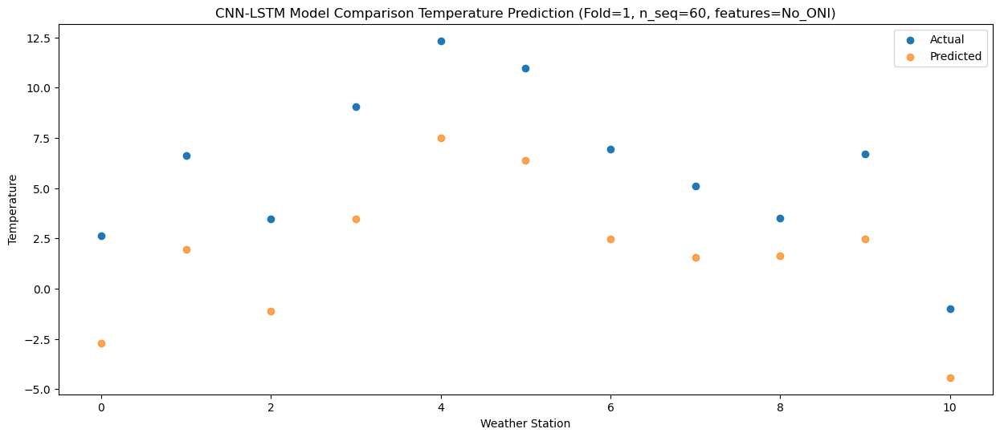

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    6.12   0.897879
1                 1    9.88   6.021631
2                 2    6.15   2.252136
3                 3    9.88   6.408640
4                 4   13.30  10.511548
5                 5   14.12  10.354542
6                 6   10.19   6.667258
7                 7    9.52   6.006625
8                 8    7.86   6.334748
9                 9   12.06   7.763054
10               10    6.21   2.201636


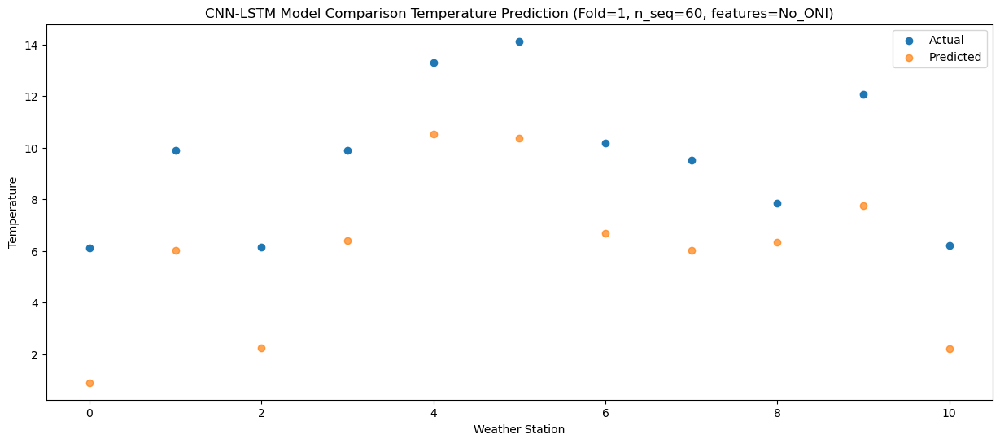

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.62   5.082326
1                 1   13.16  10.988241
2                 2    9.39   7.390971
3                 3   14.47  12.734108
4                 4   17.94  17.015780
5                 5   18.73  17.195179
6                 6   13.19  11.494652
7                 7   14.87  13.332203
8                 8   13.55  14.871902
9                 9   17.17  16.315437
10               10    8.77   7.271787


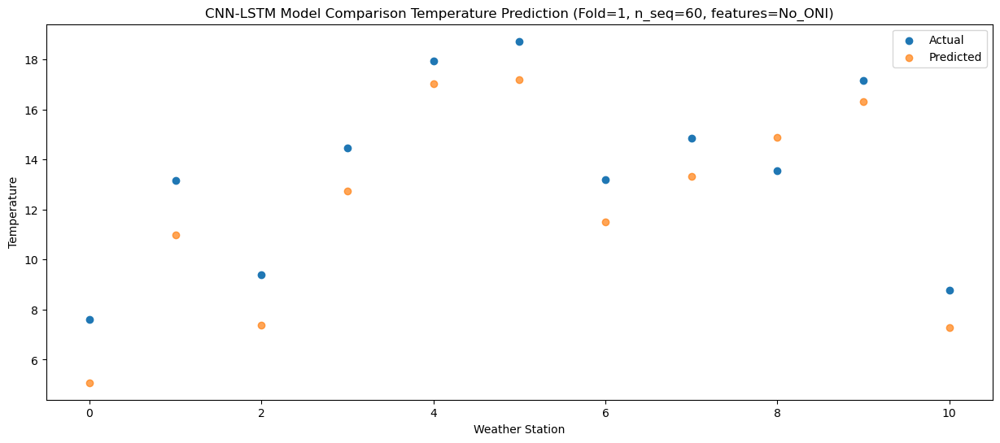

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.24   9.425382
1                 1   16.35  15.642522
2                 2   13.14  11.991522
3                 3   18.62  17.254752
4                 4   22.83  21.602428
5                 5   25.42  21.577274
6                 6   16.47  16.121401
7                 7   18.68  18.331550
8                 8   18.48  19.767366
9                 9   20.40  21.027175
10               10   13.14  12.157421


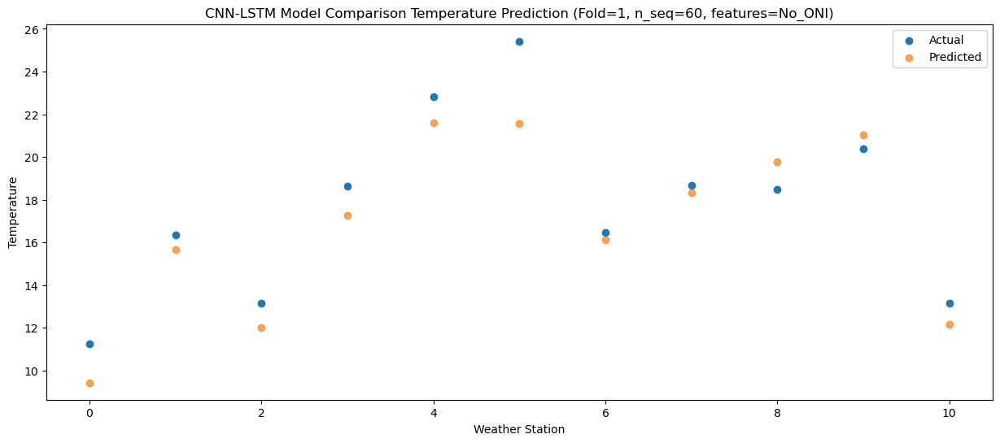

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   14.47  11.629689
1                 1   19.95  17.422884
2                 2   15.51  13.523786
3                 3   20.34  18.557382
4                 4   24.78  22.803867
5                 5   26.52  23.443110
6                 6   19.92  18.046035
7                 7   20.98  19.308729
8                 8   21.36  20.767455
9                 9   25.02  22.528525
10               10   18.28  14.805817


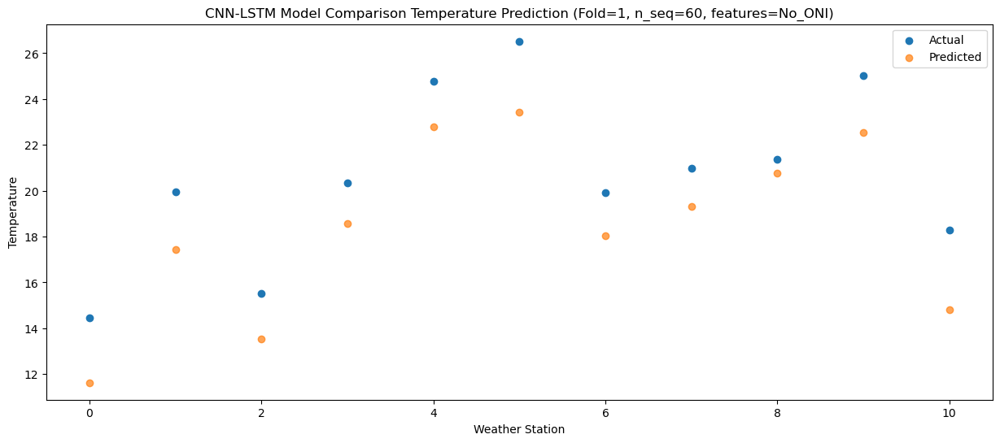

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.26  11.559218
1                 1   19.41  17.455277
2                 2   15.95  13.998182
3                 3   22.31  19.736605
4                 4   26.21  24.027075
5                 5   25.71  24.281872
6                 6   19.50  17.931835
7                 7   21.48  20.132963
8                 8   23.17  22.001645
9                 9   25.42  23.424655
10               10   16.54  13.394818


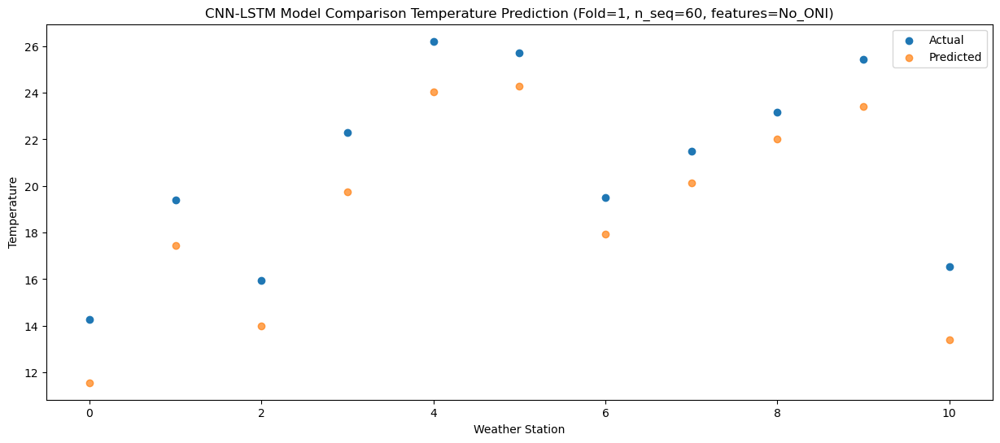

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   10.57   8.044363
1                 1   15.90  13.892249
2                 2   12.99  10.267940
3                 3   19.23  15.604975
4                 4   22.36  19.872977
5                 5   23.43  20.142332
6                 6   16.33  14.417246
7                 7   17.86  16.120171
8                 8   18.53  17.596568
9                 9   21.90  19.086211
10               10   13.35  10.240778


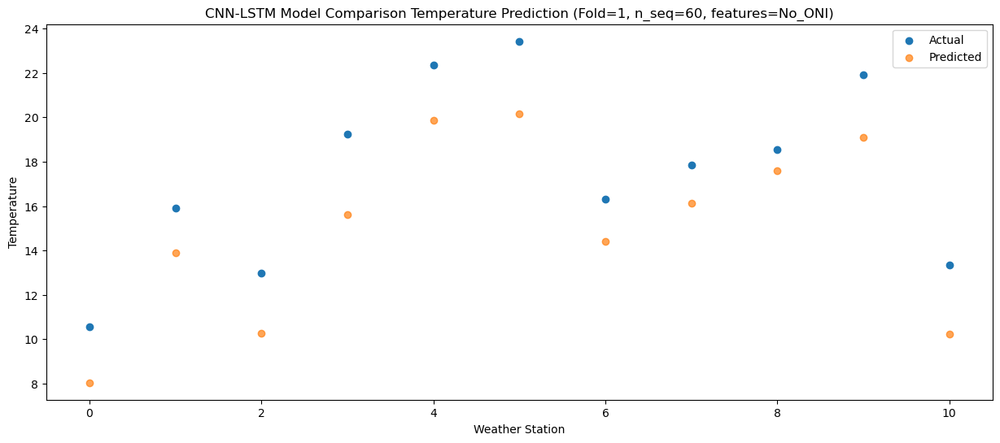

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.69   3.126339
1                 1   10.89   8.301196
2                 2    6.95   4.519450
3                 3   11.97   9.001271
4                 4   14.96  13.111298
5                 5   15.83  13.348832
6                 6   11.32   8.953103
7                 7   11.55   8.707234
8                 8    9.95   9.317415
9                 9   13.80  10.978029
10               10    8.00   4.833994


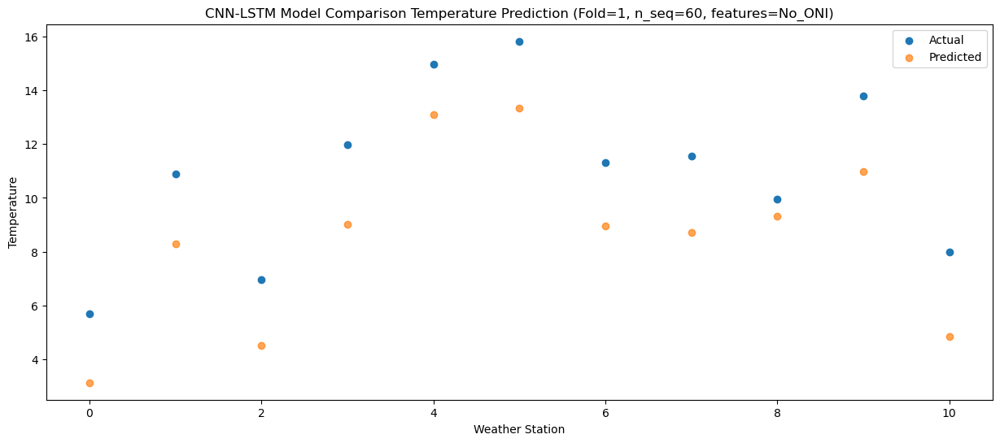

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.54  -3.123681
1                 1    5.27   1.923336
2                 2    0.39  -1.623581
3                 3    5.69   3.195840
4                 4    8.76   7.282061
5                 5    9.17   7.401998
6                 6    5.63   2.521626
7                 7    4.15   2.424628
8                 8    2.83   3.232255
9                 9    7.05   4.797684
10               10    0.06  -2.364551


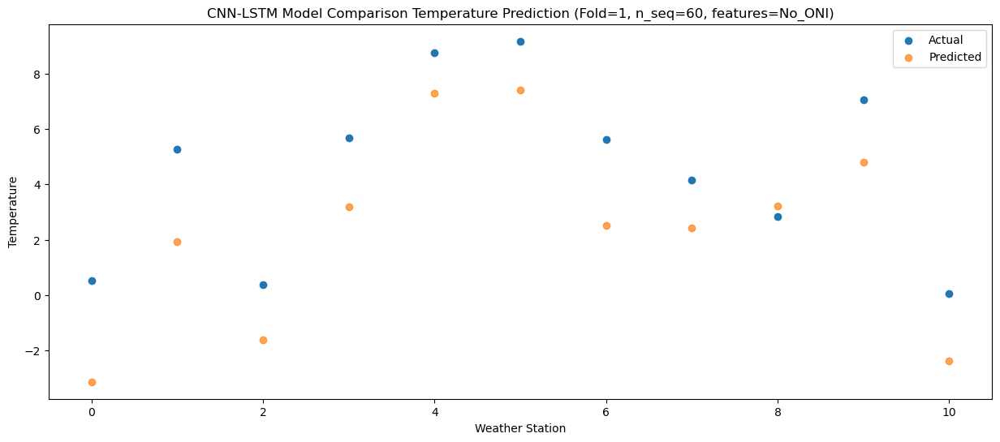

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.49  -5.020179
1                 1    2.13  -0.148144
2                 2   -2.39  -4.005113
3                 3    3.29   0.219124
4                 4    6.86   4.244672
5                 5    6.81   4.640445
6                 6    2.89   0.565129
7                 7    1.23  -0.468819
8                 8   -0.02  -0.061714
9                 9    3.22   1.769597
10               10   -1.63  -3.479110


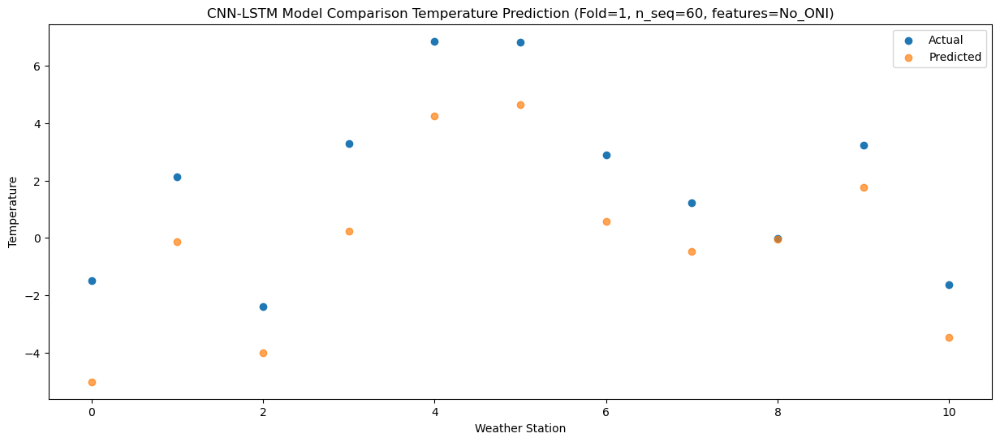

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -7.532219
1                 1   -1.15  -3.651055
2                 2   -5.47  -7.504110
3                 3   -0.13  -3.778127
4                 4    3.01   0.030639
5                 5    3.20   0.612220
6                 6   -0.11  -2.815093
7                 7   -4.70  -5.871305
8                 8   -5.85  -5.921465
9                 9   -1.95  -3.756510
10               10   -5.53  -7.449382


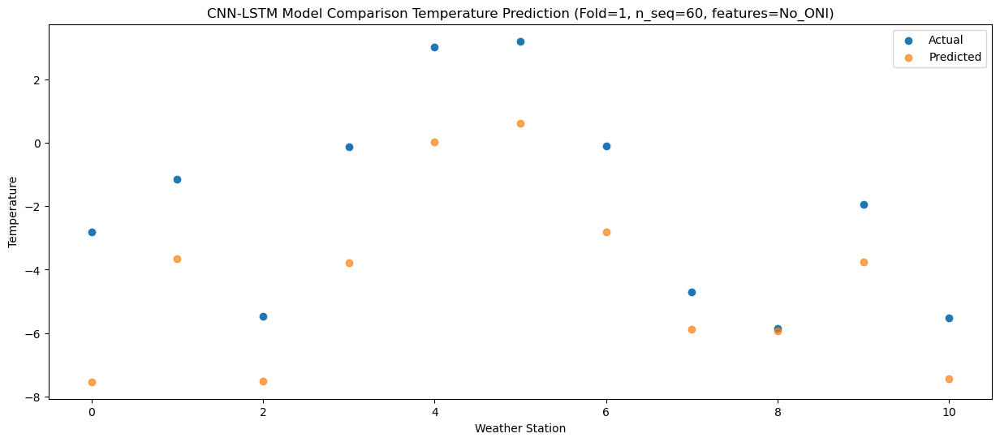

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -4.755937
1                 1    3.93   0.677158
2                 2   -0.13  -2.467215
3                 3    6.18   3.026387
4                 4    9.38   7.208837
5                 5    9.32   6.887594
6                 6    4.10   1.135874
7                 7    4.30   2.217595
8                 8    2.10   3.303559
9                 9    5.76   4.476331
10               10   -3.58  -4.586748


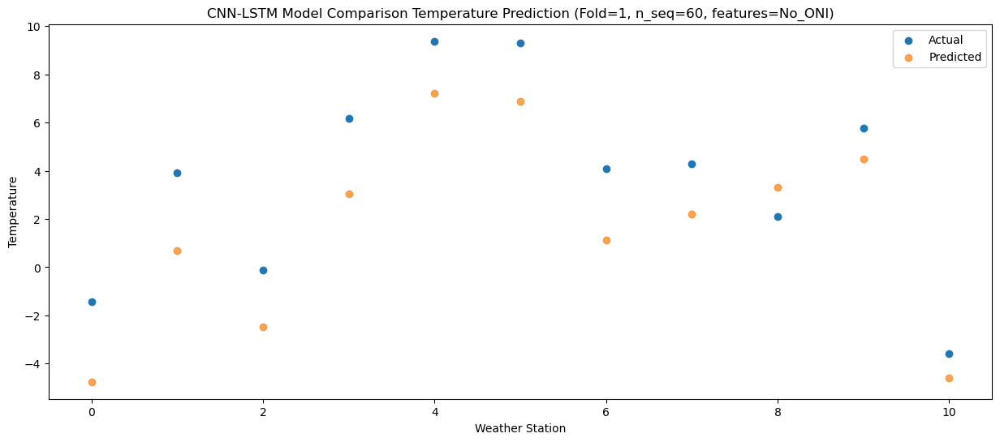

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.42  -1.699348
1                 1    7.15   3.632183
2                 2    2.97   0.376561
3                 3    8.69   5.352741
4                 4   12.12   9.516556
5                 5   11.67   8.904894
6                 6    7.76   4.124142
7                 7    7.02   4.506723
8                 8    5.34   5.039888
9                 9    8.59   6.111465
10               10    0.82  -1.459039


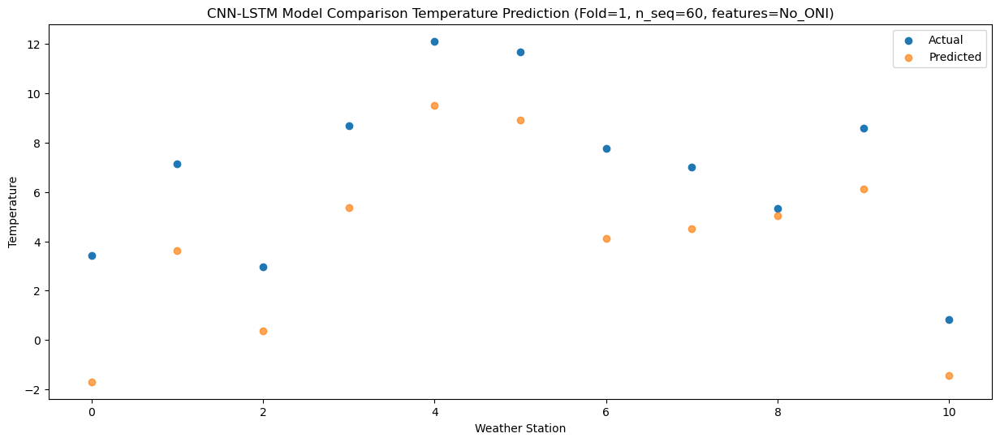

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.82   1.976437
1                 1   10.82   7.721261
2                 2    6.31   4.378691
3                 3   12.17   9.596000
4                 4   15.68  13.851048
5                 5   16.47  13.391280
6                 6   11.23   8.198133
7                 7   11.06   9.494339
8                 8   10.02  10.415360
9                 9   13.66  11.491155
10               10    5.21   3.223358


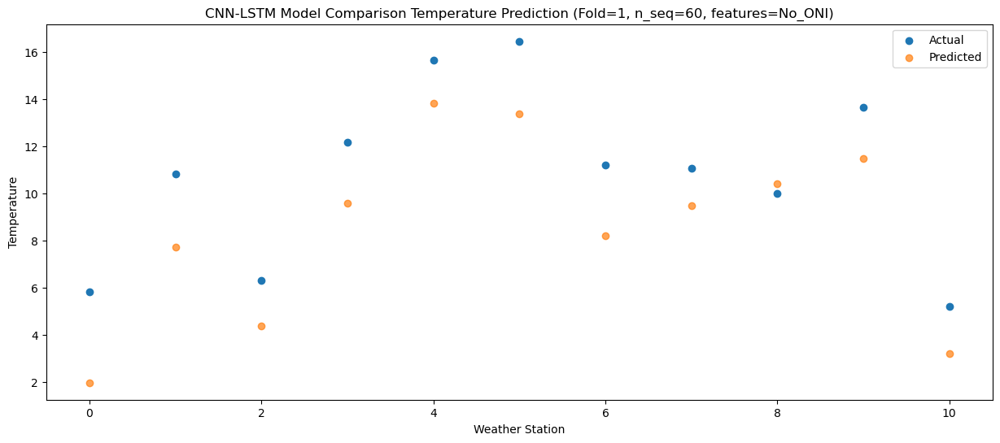

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   10.49   6.778102
1                 1   15.39  12.754958
2                 2   11.92   9.155916
3                 3   15.87  13.951960
4                 4   19.38  18.239329
5                 5   22.09  17.773795
6                 6   15.47  13.274680
7                 7   16.60  14.436112
8                 8   14.78  15.055740
9                 9   17.80  16.116329
10               10   10.80   9.126878


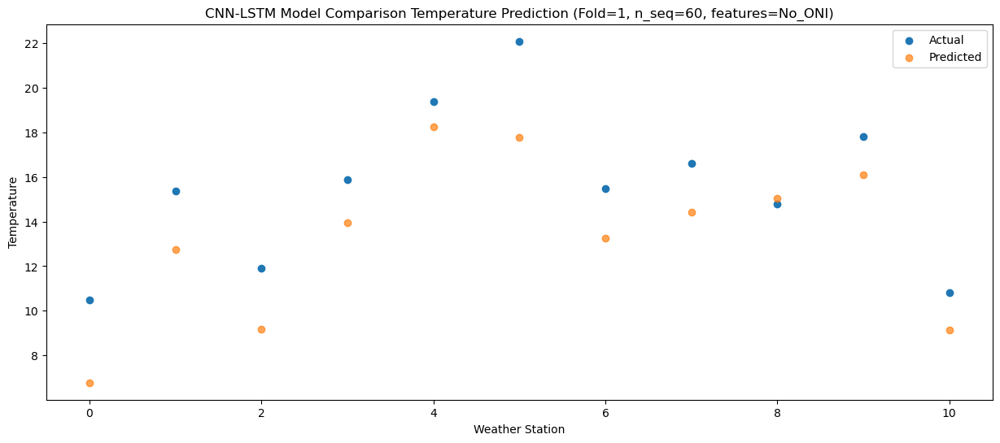

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.36  10.232238
1                 1   19.15  16.291883
2                 2   15.03  12.545387
3                 3   18.50  17.719822
4                 4   22.27  22.021063
5                 5   24.95  22.299748
6                 6   19.40  16.851290
7                 7   19.67  18.626995
8                 8   20.48  19.955148
9                 9   24.21  21.412655
10               10   16.91  13.418648


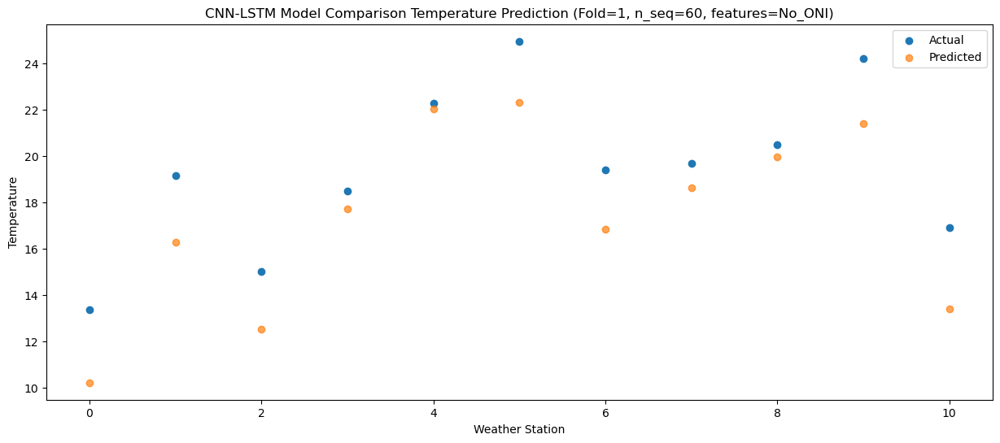

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.32  11.397877
1                 1   20.08  17.075779
2                 2   15.05  13.005531
3                 3   17.89  18.027038
4                 4   22.08  22.225339
5                 5   23.95  23.459536
6                 6   20.43  17.786212
7                 7   20.31  18.802768
8                 8   21.33  20.422468
9                 9   24.94  22.566987
10               10   18.84  15.305661


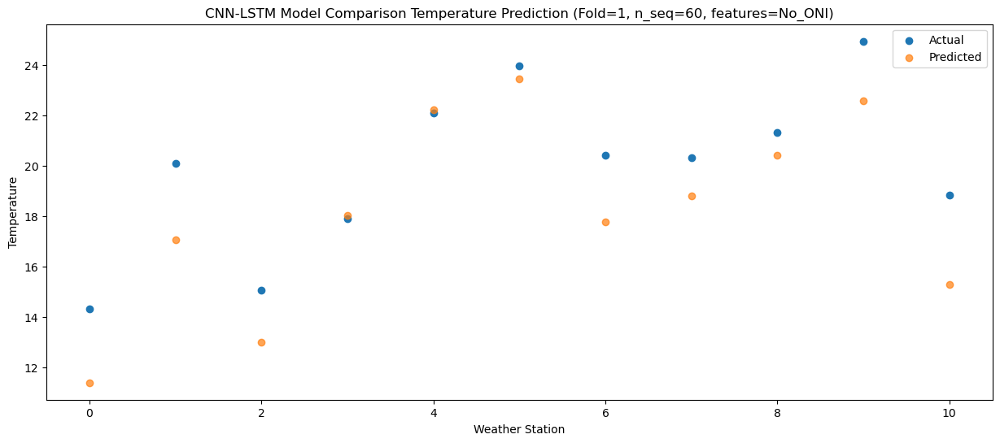

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.97  10.723697
1                 1   19.80  16.841109
2                 2   15.36  13.213556
3                 3   19.02  18.914793
4                 4   23.40  23.217607
5                 5   25.55  23.784274
6                 6   20.10  17.367145
7                 7   20.72  19.702720
8                 8   23.44  21.537576
9                 9   25.74  23.154988
10               10   16.69  13.804167


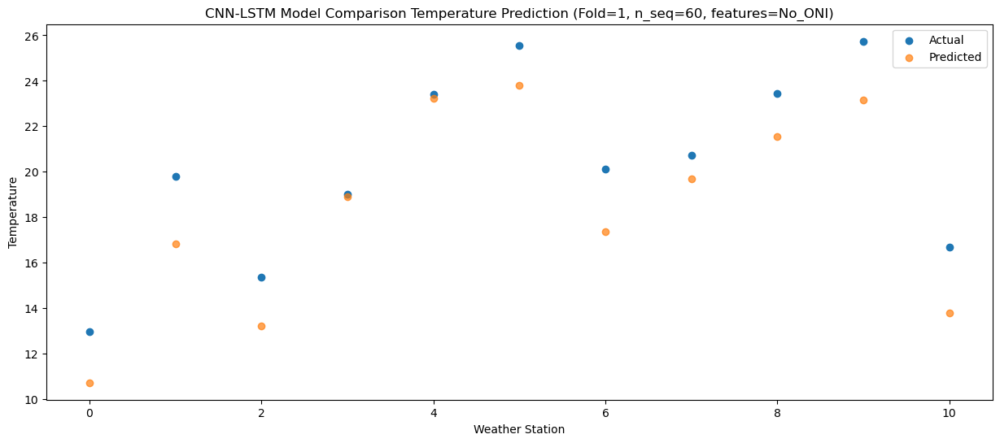

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   10.53   8.212555
1                 1   16.08  14.111885
2                 2   13.05  10.331193
3                 3   16.42  15.820625
4                 4   20.11  20.071690
5                 5   19.84  20.937918
6                 6   16.80  14.689364
7                 7   18.85  16.561362
8                 8   17.47  18.355087
9                 9   21.18  20.229083
10               10   12.96  11.460667


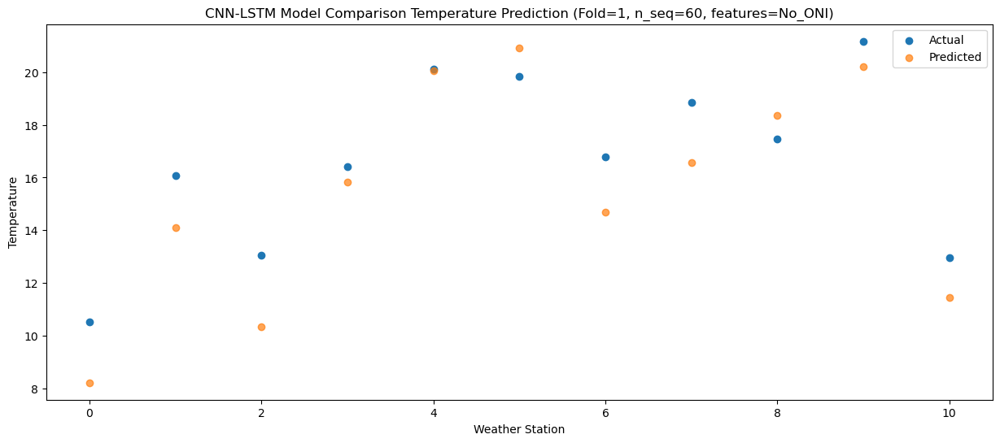

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.65   3.975592
1                 1   11.63   9.814315
2                 2    8.05   6.411988
3                 3   13.73  12.327062
4                 4   16.96  16.585460
5                 5   18.69  17.000226
6                 6   12.00  10.297734
7                 7   13.38  12.488710
8                 8   13.61  14.312211
9                 9   16.33  15.835069
10               10    8.09   5.914380


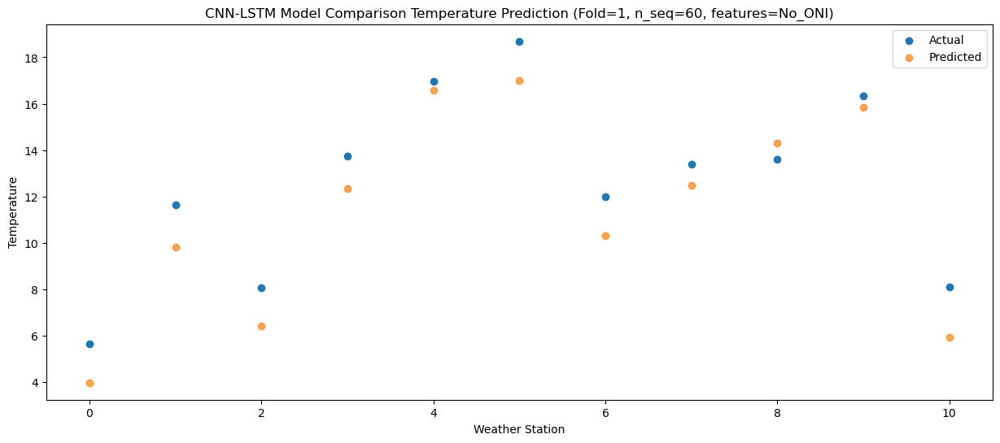

f, t:
[[-1.840e+00  3.520e+00 -1.480e+00  4.050e+00  8.110e+00  7.800e+00
   3.880e+00  9.200e-01  4.400e-01  4.680e+00 -1.560e+00]
 [-1.310e+00  2.610e+00 -1.050e+00  2.630e+00  6.220e+00  5.770e+00
   3.150e+00  3.000e-01 -1.410e+00  3.320e+00 -4.370e+00]
 [-1.420e+00  1.500e+00 -1.580e+00  3.380e+00  7.030e+00  5.110e+00
   2.340e+00 -5.500e-01 -1.230e+00  2.870e+00 -4.030e+00]
 [-1.560e+00  1.590e+00 -1.300e+00  2.850e+00  6.650e+00  4.590e+00
   2.410e+00  1.300e-01 -1.740e+00  1.630e+00 -3.290e+00]
 [ 3.500e+00  7.590e+00  5.800e+00  1.049e+01  1.469e+01  1.194e+01
   8.080e+00  7.050e+00  6.090e+00  9.590e+00  1.030e+00]
 [ 4.990e+00  8.810e+00  4.830e+00  1.037e+01  1.443e+01  1.473e+01
   9.710e+00  8.190e+00  7.470e+00  1.190e+01  2.660e+00]
 [ 8.070e+00  1.216e+01  8.980e+00  1.412e+01  1.823e+01  1.992e+01
   1.249e+01  1.269e+01  1.358e+01  1.843e+01  8.120e+00]
 [ 1.107e+01  1.651e+01  1.321e+01  1.690e+01  2.126e+01  2.264e+01
   1.716e+01  1.825e+01  1.869e+01  2.481e+0

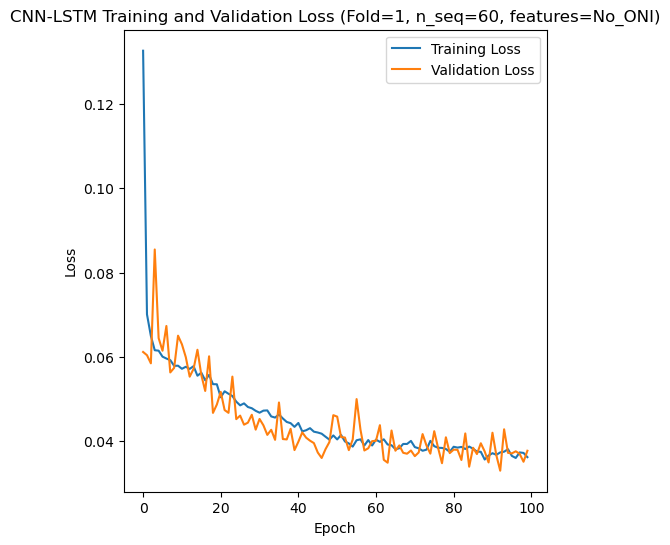

[[ 8.61  4.71 12.22 ... 22.49 18.22 13.52]
 [ 6.28  3.18  8.73 ... 22.36 17.39  7.52]
 [17.82 16.52 20.35 ... 28.79 25.32 22.93]
 ...
 [ 6.77  9.55 12.16 ... 24.55 20.29 10.24]
 [12.04 12.81 10.78 ... 23.32 20.33 13.93]
 [ 8.57  6.56 11.36 ... 21.36 16.14 12.65]]
Epoch 1/100
84/84 [==============================] - 30s 140ms/step - loss: 0.1361 - accuracy: 0.3452 - mae: 0.1181 - rmse: 0.1361 - mape: inf - pearson: 0.6357 - val_loss: 0.0462 - val_accuracy: 0.6000 - val_mae: 0.0369 - val_rmse: 0.0462 - val_mape: 7.7996 - val_pearson: 0.9184
Epoch 2/100
84/84 [==============================] - 6s 71ms/step - loss: 0.0688 - accuracy: 0.4524 - mae: 0.0547 - rmse: 0.0688 - mape: inf - pearson: 0.8023 - val_loss: 0.0493 - val_accuracy: 0.6000 - val_mae: 0.0385 - val_rmse: 0.0493 - val_mape: 8.4423 - val_pearson: 0.9227
Epoch 3/100
84/84 [==============================] - 6s 75ms/step - loss: 0.0627 - accuracy: 0.5119 - mae: 0.0496 - rmse: 0.0627 - mape: inf - pearson: 0.8270 - val_loss: 0.046

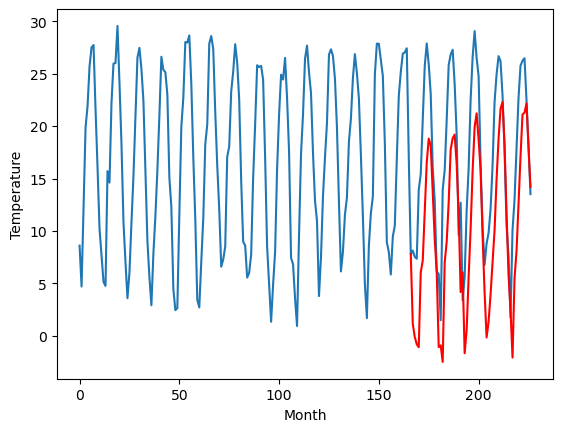

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.41		3.20		-0.21
1.13		0.94		-0.19
0.89		0.15		-0.74
0.16		0.18		0.02
8.17		6.80		-1.37
10.40		9.08		-1.32
17.20		14.57		-2.63
24.40		19.51		-4.89
24.43		21.73		-2.70
23.10		21.67		-1.43
16.97		16.37		-0.60
9.98		10.50		0.52
6.86		6.80		-0.06
0.23		0.48		0.25
0.15		1.03		0.88
-3.89		-1.53		2.36
6.30		8.09		1.79
10.06		10.69		0.63
15.24		14.88		-0.36
22.49		21.18		-1.31
23.18		22.60		-0.58
23.94		21.98		-1.96
21.70		19.20		-2.50
13.44		12.70		-0.74
6.73		6.70		-0.03
4.34		5.42		1.08
-0.35		-0.23		0.12
-0.36		0.83		1.19
6.62		6.55		-0.07
13.30		11.08		-2.22
19.10		16.65		-2.45
22.90		21.83		-1.07
26.14		24.19		-1.95
23.83		22.01		-1.82
21.07		18.76		-2.31
12.69		11.96		-0.73
2.70		3.66		0.96
-0.01		-0.34		-0.33
-0.26		1.14		1.40
1.34		3.13		1.79
5.41		6.77		1.36
11.27		11.05		-0.22
16.76		17.60		0.84
19.37		21.07		1.70
23.47		24.36		0.89
23.96		24.94		0.98
21.09		20.46		-0.63
12.05		13.13		1.0

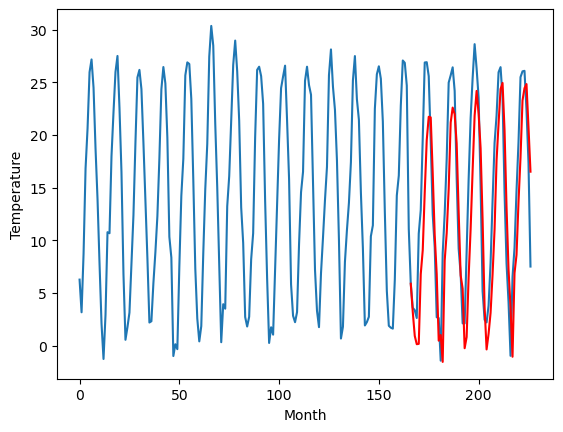

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.10		-1.17		-1.07
-1.22		-1.87		-0.65
-2.37		-2.40		-0.03
-1.33		-1.84		-0.51
2.29		2.44		0.15
3.68		3.23		-0.45
4.99		5.47		0.48
7.58		7.34		-0.24
8.22		9.94		1.72
7.91		10.38		2.47
6.65		8.35		1.70
5.38		7.12		1.74
1.96		2.55		0.59
-5.03		-3.86		1.17
-4.37		-2.51		1.86
-1.64		0.43		2.07
0.17		2.57		2.40
1.98		4.55		2.57
5.56		7.37		1.81
6.78		9.26		2.48
7.57		10.90		3.33
7.62		10.95		3.33
6.34		8.79		2.45
5.20		5.84		0.64
-1.65		0.27		1.92
-0.75		3.19		3.94
-5.01		-1.58		3.43
-2.68		1.91		4.59
0.79		4.07		3.28
2.60		6.84		4.24
5.36		9.93		4.57
7.17		12.98		5.81
7.35		13.09		5.74
6.78		11.88		5.10
5.37		10.10		4.73
2.74		5.35		2.61
0.98		3.01		2.03
-3.12		-0.19		2.93
-3.32		1.06		4.38
-0.26		3.71		3.97
0.76		5.63		4.87
3.30		6.17		2.87
4.28		8.03		3.75
6.69		10.92		4.23
8.60		14.46		5.86
8.78		15.00		6.22
6.83		11.19		4.36
3.25		6.94		3.69
-0.73		2.06		2.79
-2.66		-1.00		1.66
-4.66		-1.58	

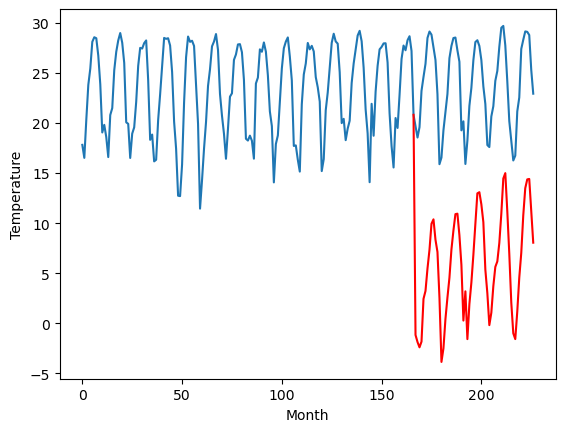

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.24		9.22		-0.02
6.18		7.41		1.23
6.45		6.83		0.38
6.60		6.65		0.05
10.15		11.18		1.03
11.38		13.28		1.90
17.27		18.64		1.37
23.33		23.60		0.27
27.61		27.35		-0.26
25.76		26.20		0.44
21.18		22.14		0.96
15.96		17.82		1.86
12.00		13.54		1.54
5.17		6.88		1.71
2.09		6.33		4.24
2.11		6.61		4.50
6.22		12.50		6.28
10.72		16.40		5.68
15.98		20.31		4.33
21.55		25.71		4.16
23.55		26.89		3.34
24.61		27.15		2.54
21.44		23.30		1.86
17.61		19.26		1.65
9.53		11.25		1.72
7.61		10.71		3.10
1.46		4.57		3.11
3.78		8.57		4.79
7.64		12.56		4.92
12.08		15.57		3.49
17.42		22.15		4.73
21.66		25.94		4.28
26.28		27.62		1.34
26.20		26.64		0.44
21.16		22.80		1.64
15.72		16.66		0.94
11.92		12.91		0.99
5.75		6.86		1.11
7.04		8.93		1.89
5.16		10.16		5.00
7.60		11.88		4.28
13.32		17.24		3.92
16.95		20.64		3.69
20.74		24.07		3.33
26.31		28.64		2.33
24.30		27.16		2.86
21.88		23.82		1.94
16.86		19.07		2.21
8.88		12.47		3.59
8

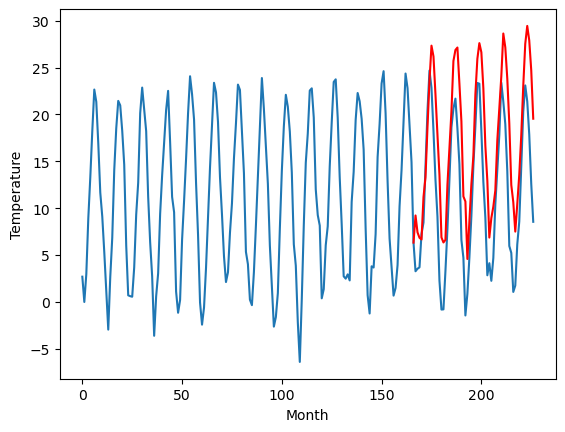

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.25		-4.80		1.45
-5.90		-5.58		0.32
-5.56		-6.18		-0.62
-4.92		-6.02		-1.10
1.77		-0.09		-1.86
1.24		0.55		-0.69
4.21		3.72		-0.49
7.25		6.71		-0.54
7.99		9.01		1.02
8.36		8.95		0.59
6.01		5.92		-0.09
2.32		3.36		1.04
-1.80		-0.34		1.46
-8.10		-7.27		0.83
-7.75		-6.42		1.33
-8.49		-5.57		2.92
-1.16		0.17		1.33
-0.29		1.80		2.09
4.18		4.97		0.79
7.66		8.04		0.38
8.25		9.37		1.12
8.42		9.66		1.24
5.88		7.34		1.46
3.14		3.75		0.61
-5.13		-2.77		2.36
-1.72		0.34		2.06
-9.45		-6.10		3.35
-6.31		-3.32		2.99
-2.55		0.20		2.75
1.25		4.01		2.76
6.41		8.02		1.61
9.00		11.51		2.51
8.83		12.01		3.18
8.01		10.03		2.02
6.04		7.88		1.84
-0.15		2.56		2.71
-3.22		-1.04		2.18
-5.73		-4.48		1.25
-4.56		-3.20		1.36
-2.43		-0.36		2.07
-0.60		2.21		2.81
1.32		3.38		2.06
5.35		6.53		1.18
9.00		9.94		0.94
10.44		12.95		2.51
11.74		13.80		2.06
7.31		9.86		2.55
1.15		4.43		3.28
-3.96		-0.78		3.18
-6.56		-4.13		2.43


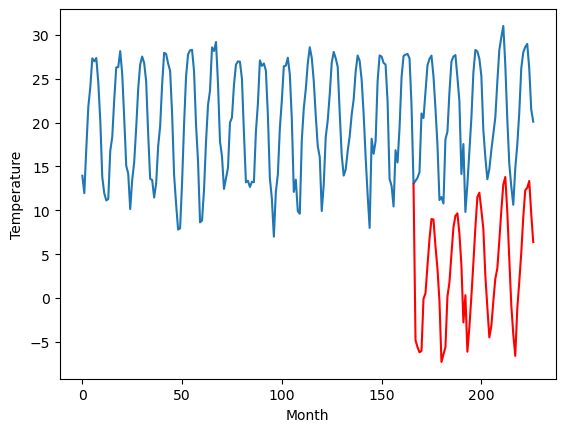

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.27		7.34		0.07
5.84		6.17		0.33
6.21		5.57		-0.64
5.45		5.56		0.11
13.54		12.37		-1.17
13.51		13.36		-0.15
17.35		17.36		0.01
20.96		21.01		0.05
22.66		23.06		0.40
22.96		22.97		0.01
18.56		18.95		0.39
14.09		15.12		1.03
11.41		11.59		0.18
5.30		4.78		-0.52
4.71		5.59		0.88
2.36		4.81		2.45
10.74		12.77		2.03
12.86		14.33		1.47
16.90		17.88		0.98
21.45		22.09		0.64
21.53		23.33		1.80
22.64		23.45		0.81
19.90		21.12		1.22
16.60		16.37		-0.23
8.96		9.97		1.01
12.20		12.18		-0.02
3.77		5.45		1.68
3.39		7.14		3.75
9.51		11.79		2.28
15.66		16.34		0.68
20.26		20.71		0.45
23.98		24.86		0.88
25.34		25.98		0.64
22.62		23.52		0.90
19.96		21.08		1.12
14.39		15.22		0.83
8.51		9.55		1.04
6.28		6.45		0.17
7.04		7.75		0.71
8.23		10.43		2.20
12.03		13.78		1.75
12.95		15.53		2.58
18.03		20.15		2.12
22.95		23.70		0.75
25.11		26.63		1.52
26.81		27.74		0.93
22.33		23.50		1.17
14.44		17.06		2.62
8.16		11.67		3.

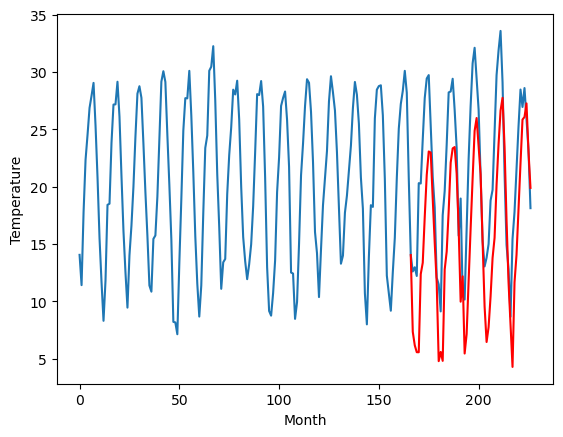

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.65		7.60		0.95
4.84		6.27		1.43
5.19		5.61		0.42
4.63		5.45		0.82
12.28		12.82		0.54
12.59		13.93		1.34
17.49		18.42		0.93
22.23		22.66		0.43
23.41		24.61		1.20
23.64		24.36		0.72
17.70		19.84		2.14
12.22		15.27		3.05
9.73		12.06		2.33
3.27		5.11		1.84
2.57		5.72		3.15
-0.54		3.95		4.49
9.83		13.43		3.60
11.53		14.98		3.45
15.61		18.76		3.15
21.17		23.63		2.46
22.06		24.81		2.75
22.62		24.91		2.29
20.35		22.49		2.14
15.84		17.29		1.45
7.87		10.60		2.73
10.16		12.42		2.26
1.68		5.22		3.54
1.51		6.61		5.10
8.09		11.85		3.76
14.36		16.75		2.39
19.38		21.61		2.23
24.09		26.01		1.92
26.88		27.44		0.56
24.07		24.73		0.66
20.24		22.05		1.81
13.86		15.88		2.02
7.19		9.49		2.30
4.57		6.13		1.56
5.45		7.45		2.00
5.64		10.15		4.51
10.29		13.75		3.46
12.11		16.06		3.95
17.85		21.40		3.55
22.00		25.12		3.12
24.56		27.87		3.31
26.90		29.04		2.14
22.12		24.71		2.59
13.40		17.73		4.33
8.06		12.15		4.09
5.0

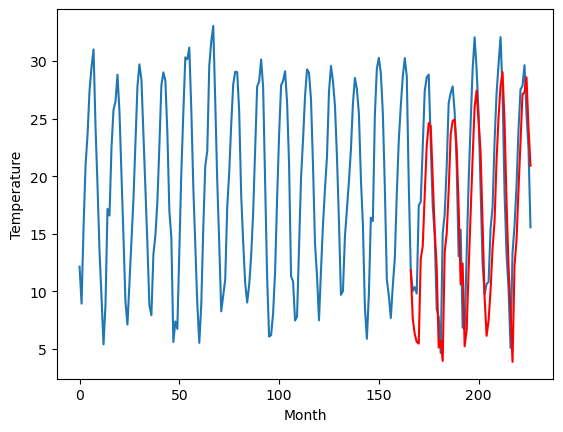

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.03		6.57		0.54
1.50		4.60		3.10
2.75		4.13		1.38
3.56		4.61		1.05
8.06		9.16		1.10
13.04		11.48		-1.56
19.33		15.61		-3.72
22.85		18.74		-4.11
24.95		21.43		-3.52
25.39		21.87		-3.52
19.14		18.02		-1.12
13.54		14.19		0.65
7.98		9.07		1.09
0.33		3.54		3.21
0.87		4.74		3.87
3.79		5.42		1.63
6.89		9.86		2.97
13.55		12.79		-0.76
18.56		16.39		-2.17
23.55		20.94		-2.61
22.35		22.64		0.29
21.83		21.96		0.13
19.65		19.38		-0.27
13.09		13.94		0.85
7.69		9.12		1.43
4.34		8.38		4.04
1.34		4.64		3.30
2.31		6.51		4.20
7.37		10.36		2.99
14.56		13.66		-0.90
19.26		17.72		-1.54
23.12		22.22		-0.90
24.26		23.84		-0.42
21.24		22.53		1.29
19.51		19.85		0.34
11.30		14.01		2.71
4.41		7.53		3.12
2.24		4.50		2.26
1.53		6.03		4.50
2.74		7.69		4.95
7.44		10.64		3.20
13.08		13.50		0.42
17.73		17.93		0.20
22.39		20.73		-1.66
27.14		25.01		-2.13
24.14		25.10		0.96
21.48		20.83		-0.65
14.74		15.34		0.60
7.63		9.88		2.

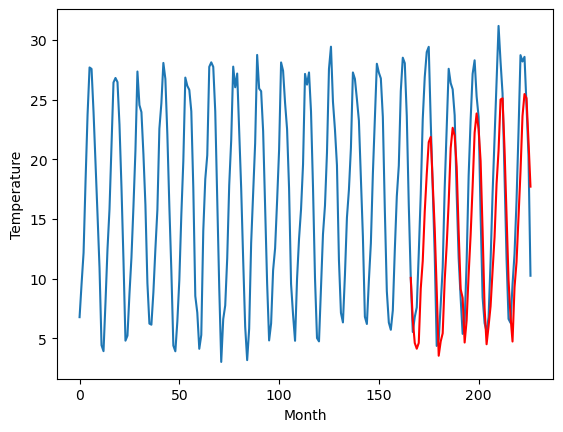

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.17		2.21		0.04
-1.37		-0.24		1.13
-0.83		-0.57		0.26
1.28		0.45		-0.83
1.35		3.08		1.73
4.56		6.19		1.63
8.61		9.91		1.30
9.90		11.99		2.09
12.31		15.00		2.69
14.71		16.17		1.46
13.11		12.89		-0.22
9.87		9.62		-0.25
3.15		3.09		-0.06
1.10		-1.28		-2.38
1.04		0.58		-0.46
0.12		2.97		2.85
-0.28		3.84		4.12
3.58		7.55		3.97
5.80		10.97		5.17
10.04		15.13		5.09
13.02		17.24		4.22
12.62		15.95		3.33
10.84		13.38		2.54
5.86		7.62		1.76
4.60		4.46		-0.14
-1.91		2.04		3.95
0.50		0.94		0.44
1.37		2.77		1.40
3.16		5.70		2.54
5.28		7.94		2.66
6.24		11.02		4.78
11.16		15.68		4.52
11.97		17.42		5.45
14.01		16.98		2.97
13.60		14.45		0.85
7.33		8.88		1.55
1.10		1.90		0.80
-1.60		-0.43		1.17
-1.94		1.14		3.08
-2.26		2.12		4.38
-1.25		4.85		6.10
2.59		7.63		5.04
3.80		11.63		7.83
5.76		13.69		7.93
12.68		19.09		6.41
12.31		18.69		6.38
8.81		14.30		5.49
7.22		9.74		2.52
2.83		4.48		1.65
0.50		1.70		1.20
-1.3

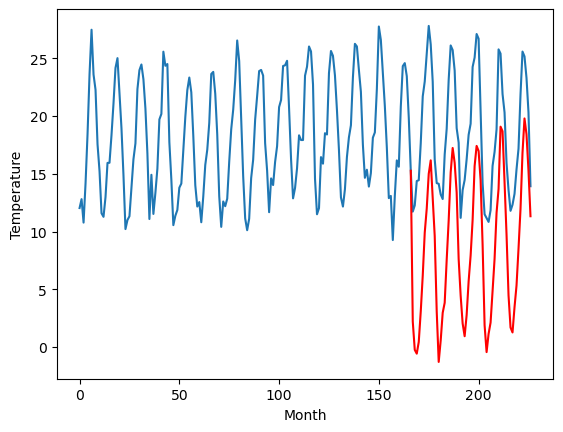

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.04		3.72		1.68
1.63		2.62		0.99
1.34		1.99		0.65
2.38		1.96		-0.42
7.61		7.43		-0.18
8.91		8.59		-0.32
11.51		12.65		1.14
16.80		16.61		-0.19
19.79		19.55		-0.24
18.79		18.90		0.11
14.76		15.51		0.75
10.84		12.23		1.39
6.23		8.47		2.24
-0.77		1.48		2.25
-1.18		1.63		2.81
-0.68		2.19		2.87
6.20		8.31		2.11
8.99		10.88		1.89
13.01		14.32		1.31
17.30		18.41		1.11
18.87		19.63		0.76
18.96		20.04		1.08
14.85		17.00		2.15
11.57		13.44		1.87
2.66		5.98		3.32
4.58		7.87		3.29
-1.90		1.21		3.11
2.12		4.75		2.63
6.23		8.42		2.19
9.52		11.84		2.32
14.37		17.13		2.76
18.13		20.64		2.51
19.57		21.51		1.94
18.19		19.94		1.75
14.88		17.04		2.16
7.57		11.34		3.77
5.45		8.06		2.61
-1.08		3.20		4.28
2.12		4.87		2.75
5.14		7.17		2.03
5.59		9.20		3.61
9.11		12.27		3.16
11.89		15.41		3.52
15.55		18.91		3.36
19.14		22.44		3.30
18.59		22.30		3.71
14.63		18.69		4.06
9.34		13.56		4.22
3.44		7.74		4.30
0.97		5.08		

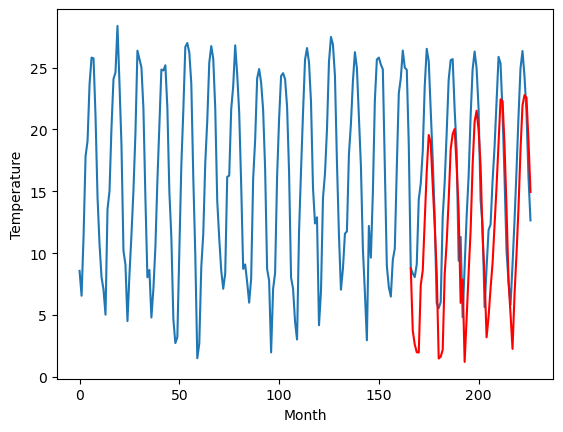

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.92		0.21		2.13
-1.32		-0.98		0.34
-1.76		-1.62		0.14
-1.96		-1.76		0.20
4.08		3.94		-0.14
4.51		5.21		0.70
8.55		9.62		1.07
13.92		13.95		0.03
17.21		16.90		-0.31
15.95		16.08		0.13
12.00		12.40		0.40
7.34		8.70		1.36
2.29		5.06		2.77
-4.77		-1.99		2.78
-4.44		-2.02		2.42
-3.09		-1.95		1.14
3.12		4.94		1.82
5.09		7.61		2.52
10.00		11.18		1.18
15.41		15.69		0.28
16.72		16.86		0.14
16.80		17.29		0.49
12.31		14.12		1.81
8.55		10.36		1.81
-1.67		2.63		4.30
0.43		4.26		3.83
-6.44		-2.71		3.73
-1.85		0.74		2.59
2.70		4.75		2.05
5.86		8.31		2.45
12.10		13.97		1.87
15.75		17.61		1.86
17.10		18.64		1.54
15.85		16.98		1.13
11.70		13.90		2.20
4.42		8.01		3.59
1.97		4.38		2.41
-3.49		-0.70		2.79
-1.57		1.03		2.60
1.22		3.26		2.04
1.75		5.38		3.63
6.64		8.88		2.24
9.99		12.34		2.35
12.90		15.95		3.05
16.45		19.47		3.02
15.74		19.23		3.49
12.96		15.62		2.66
6.91		10.28		3.37
0.70		4.30		3.60
-2.15		1.6

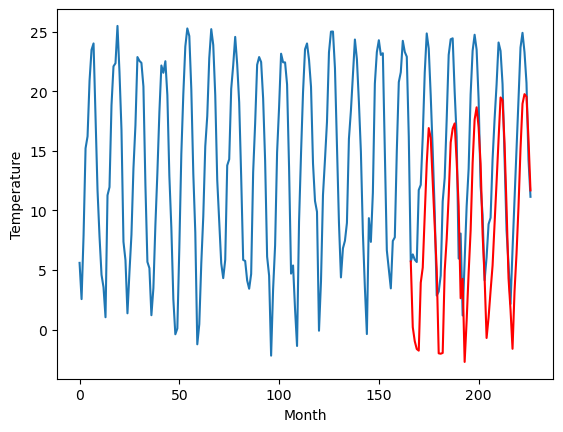

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.65   1.160259
1                 1    3.41   3.204618
2                 2   -0.10  -1.171509
3                 3    9.24   9.216735
4                 4   -6.25  -4.803385
5                 5    7.27   7.340916
6                 6    6.65   7.600849
7                 7    6.03   6.572440
8                 8    2.17   2.210570
9                 9    2.04   3.724203
10               10   -1.92   0.211685


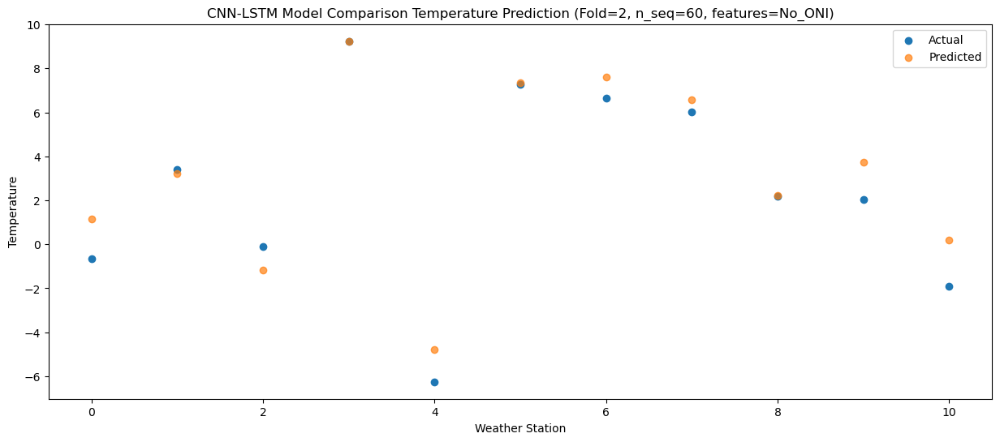

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.31  -0.085777
1                 1    1.13   0.939127
2                 2   -1.22  -1.873931
3                 3    6.18   7.413594
4                 4   -5.90  -5.583834
5                 5    5.84   6.168823
6                 6    4.84   6.271860
7                 7    1.50   4.604011
8                 8   -1.37  -0.240041
9                 9    1.63   2.621593
10               10   -1.32  -0.975543


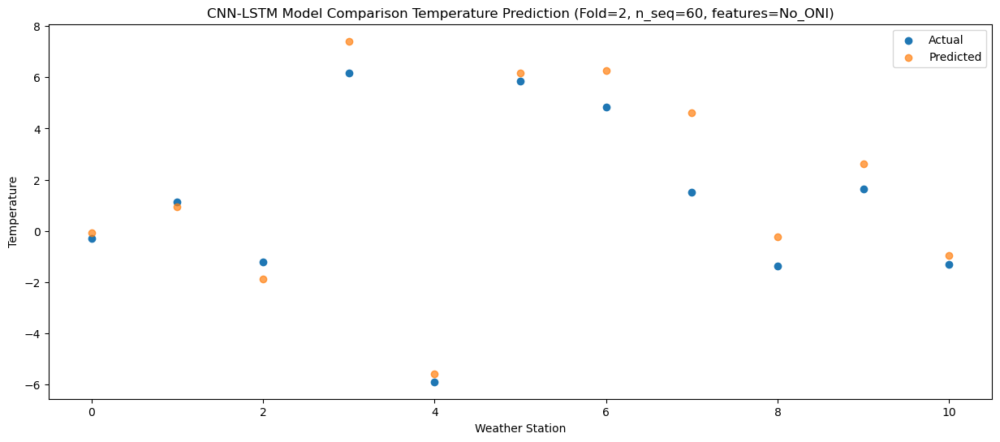

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.90  -0.792250
1                 1    0.89   0.152110
2                 2   -2.37  -2.403927
3                 3    6.45   6.830364
4                 4   -5.56  -6.181425
5                 5    6.21   5.565066
6                 6    5.19   5.605246
7                 7    2.75   4.126498
8                 8   -0.83  -0.568705
9                 9    1.34   1.994622
10               10   -1.76  -1.624761


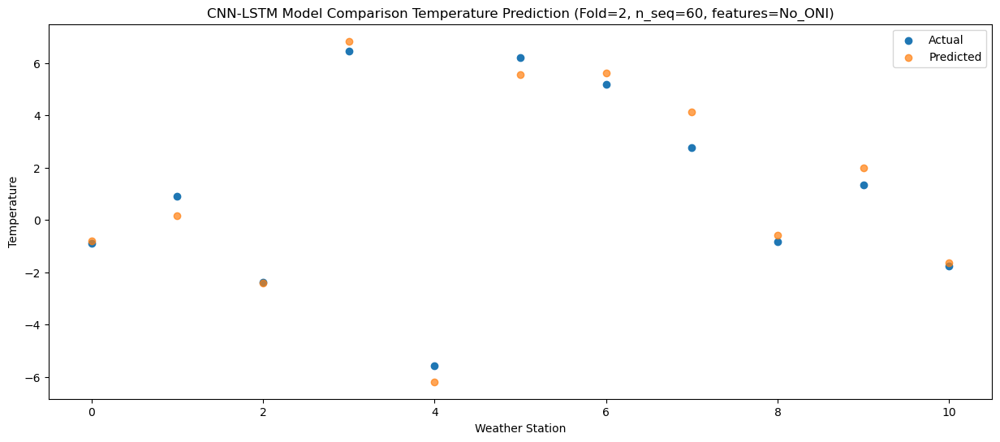

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -1.072992
1                 1    0.16   0.183592
2                 2   -1.33  -1.836306
3                 3    6.60   6.651817
4                 4   -4.92  -6.017551
5                 5    5.45   5.559918
6                 6    4.63   5.454997
7                 7    3.56   4.609814
8                 8    1.28   0.445117
9                 9    2.38   1.963066
10               10   -1.96  -1.760101


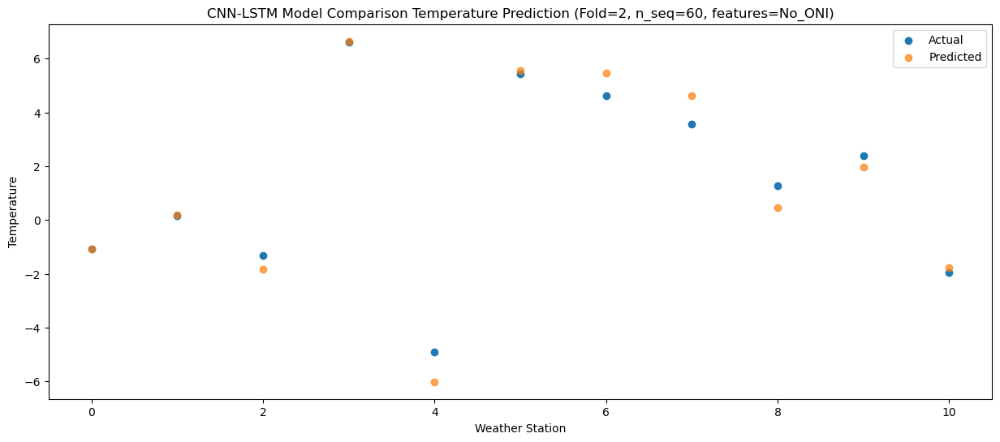

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    5.50   6.061434
1                 1    8.17   6.804219
2                 2    2.29   2.436156
3                 3   10.15  11.180599
4                 4    1.77  -0.093091
5                 5   13.54  12.373255
6                 6   12.28  12.822606
7                 7    8.06   9.161376
8                 8    1.35   3.083274
9                 9    7.61   7.426077
10               10    4.08   3.938019


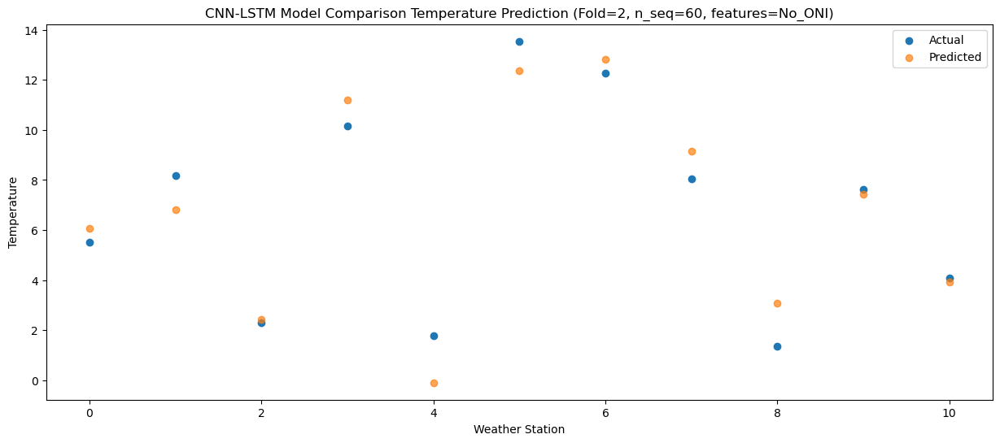

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.98   7.184565
1                 1   10.40   9.076051
2                 2    3.68   3.226881
3                 3   11.38  13.278414
4                 4    1.24   0.550331
5                 5   13.51  13.360076
6                 6   12.59  13.926238
7                 7   13.04  11.480204
8                 8    4.56   6.193989
9                 9    8.91   8.588762
10               10    4.51   5.206179


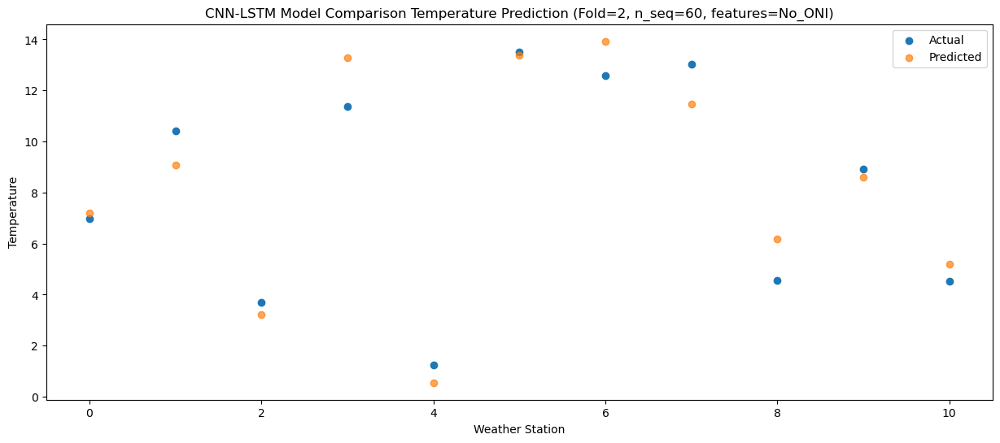

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.27  11.875559
1                 1   17.20  14.566656
2                 2    4.99   5.466901
3                 3   17.27  18.639064
4                 4    4.21   3.718212
5                 5   17.35  17.360460
6                 6   17.49  18.424979
7                 7   19.33  15.614377
8                 8    8.61   9.909064
9                 9   11.51  12.647905
10               10    8.55   9.615393


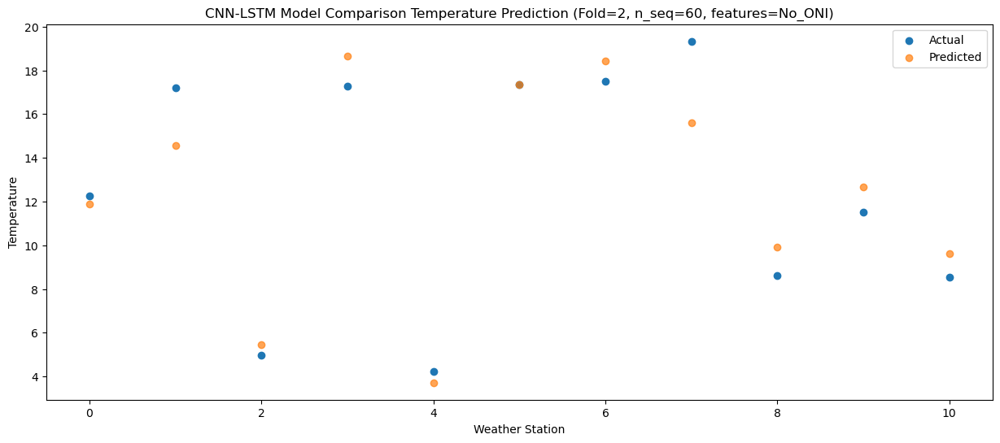

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.27  16.520029
1                 1   24.40  19.510988
2                 2    7.58   7.335834
3                 3   23.33  23.595316
4                 4    7.25   6.708776
5                 5   20.96  21.014655
6                 6   22.23  22.658697
7                 7   22.85  18.735483
8                 8    9.90  11.992316
9                 9   16.80  16.611467
10               10   13.92  13.948321


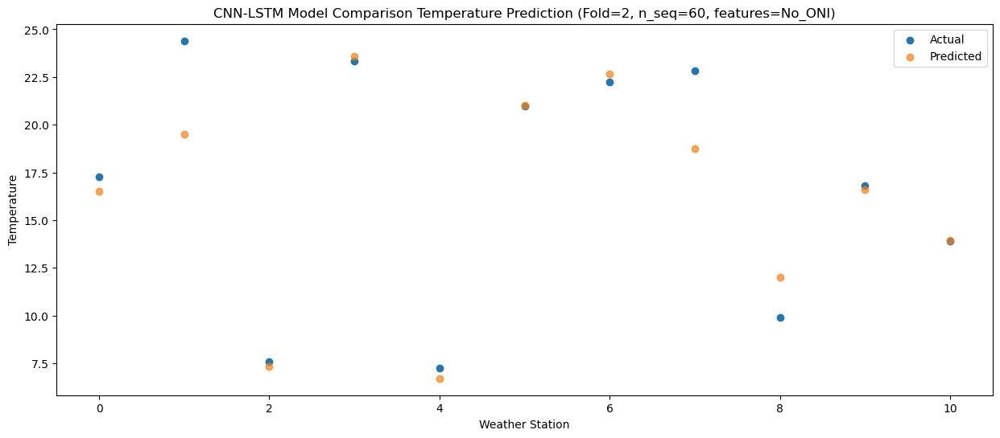

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   19.43  18.812732
1                 1   24.43  21.734163
2                 2    8.22   9.937092
3                 3   27.61  27.346348
4                 4    7.99   9.010009
5                 5   22.66  23.060720
6                 6   23.41  24.613640
7                 7   24.95  21.431748
8                 8   12.31  15.001660
9                 9   19.79  19.553546
10               10   17.21  16.902473


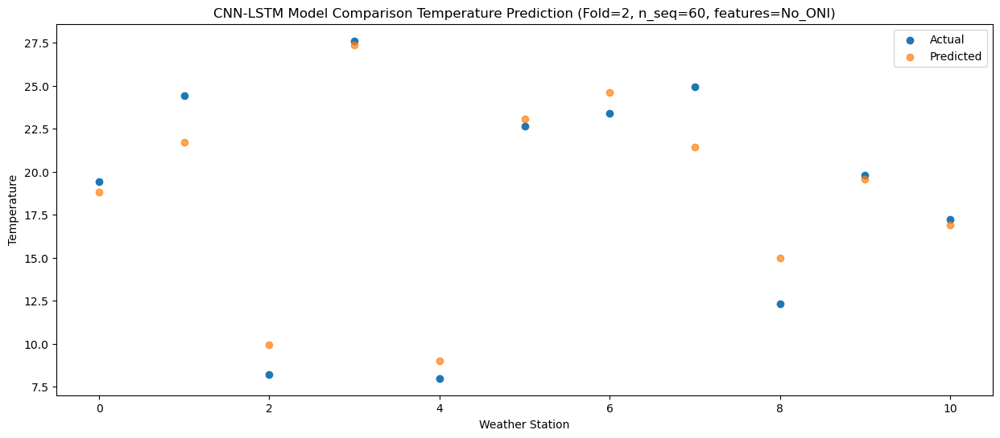

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.45  18.147375
1                 1   23.10  21.669899
2                 2    7.91  10.380001
3                 3   25.76  26.199466
4                 4    8.36   8.948938
5                 5   22.96  22.966229
6                 6   23.64  24.363898
7                 7   25.39  21.870095
8                 8   14.71  16.169823
9                 9   18.79  18.902257
10               10   15.95  16.084503


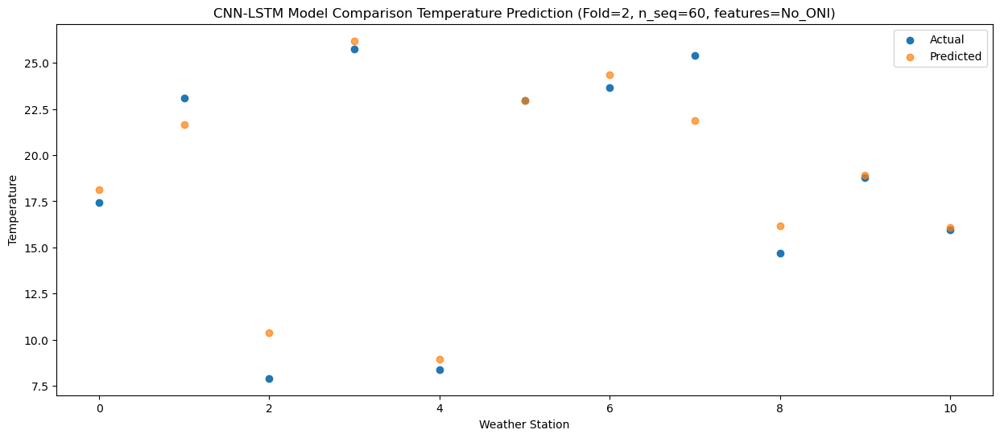

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.61  13.775552
1                 1   16.97  16.368974
2                 2    6.65   8.346942
3                 3   21.18  22.143267
4                 4    6.01   5.918000
5                 5   18.56  18.951795
6                 6   17.70  19.843145
7                 7   19.14  18.018101
8                 8   13.11  12.885426
9                 9   14.76  15.507870
10               10   12.00  12.404011


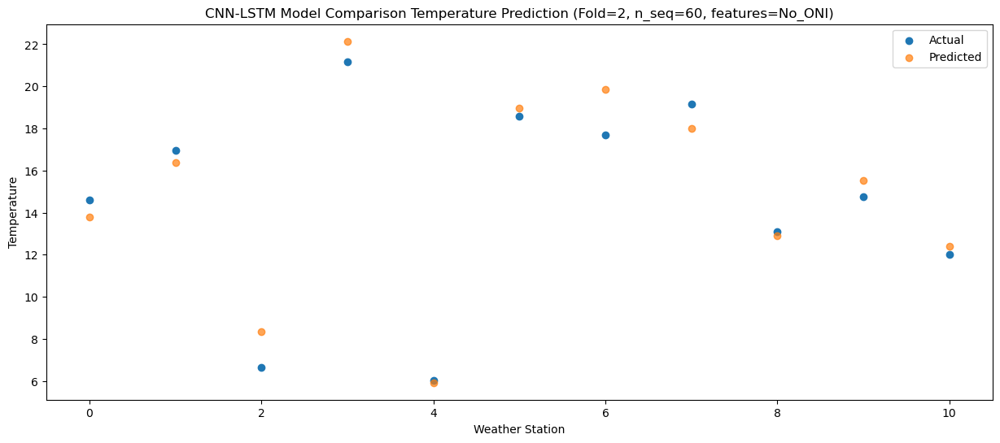

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.60   9.206082
1                 1    9.98  10.498652
2                 2    5.38   7.119201
3                 3   15.96  17.824837
4                 4    2.32   3.360940
5                 5   14.09  15.120699
6                 6   12.22  15.267012
7                 7   13.54  14.193952
8                 8    9.87   9.619246
9                 9   10.84  12.227467
10               10    7.34   8.698252


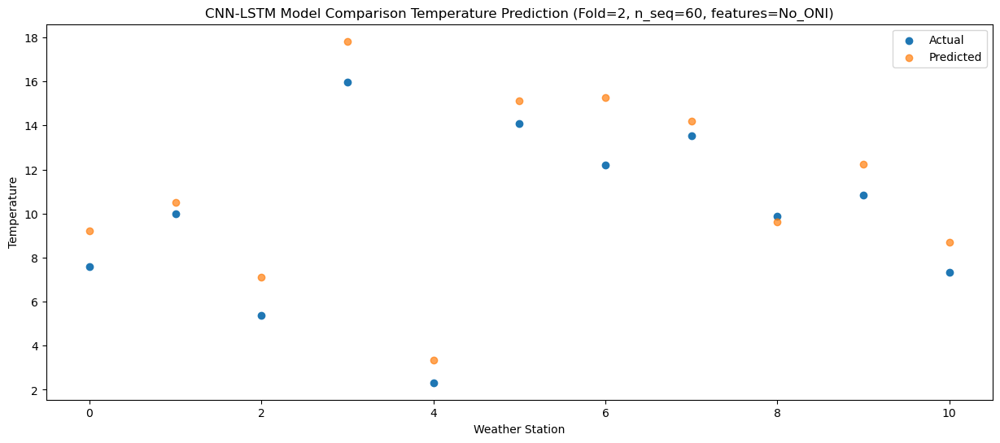

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.47   6.130583
1                 1    6.86   6.802988
2                 2    1.96   2.552833
3                 3   12.00  13.538960
4                 4   -1.80  -0.344513
5                 5   11.41  11.594801
6                 6    9.73  12.061648
7                 7    7.98   9.074814
8                 8    3.15   3.092530
9                 9    6.23   8.472416
10               10    2.29   5.060283


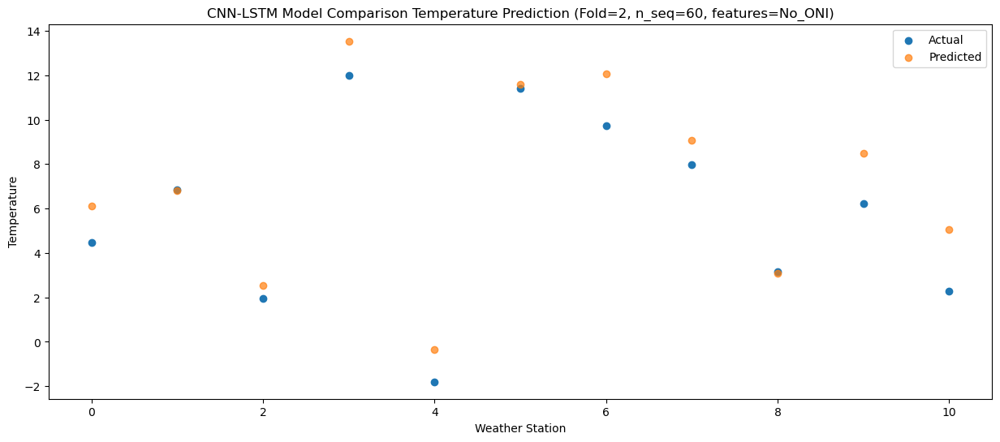

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -1.058766
1                 1    0.23   0.484525
2                 2   -5.03  -3.862025
3                 3    5.17   6.879437
4                 4   -8.10  -7.270311
5                 5    5.30   4.784381
6                 6    3.27   5.109556
7                 7    0.33   3.537986
8                 8    1.10  -1.283682
9                 9   -0.77   1.484307
10               10   -4.77  -1.985535


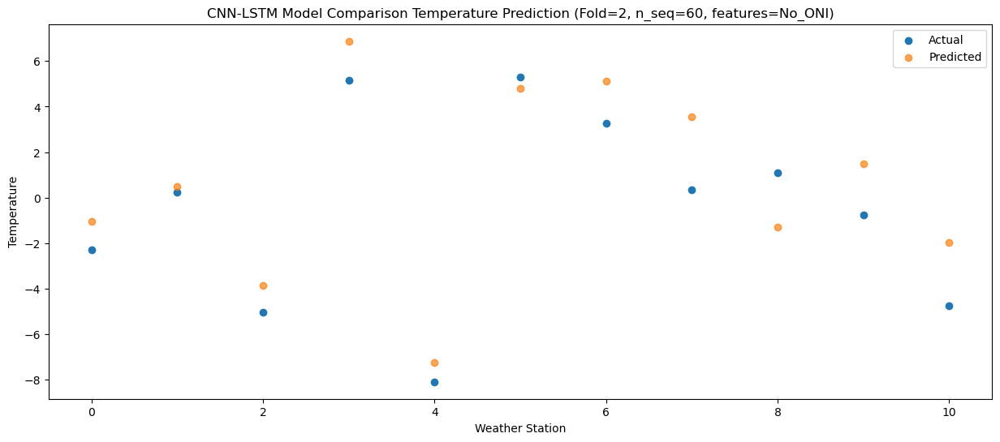

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -0.902906
1                 1    0.15   1.025086
2                 2   -4.37  -2.505986
3                 3    2.09   6.333932
4                 4   -7.75  -6.417544
5                 5    4.71   5.588226
6                 6    2.57   5.718895
7                 7    0.87   4.736000
8                 8    1.04   0.577266
9                 9   -1.18   1.630898
10               10   -4.44  -2.019440


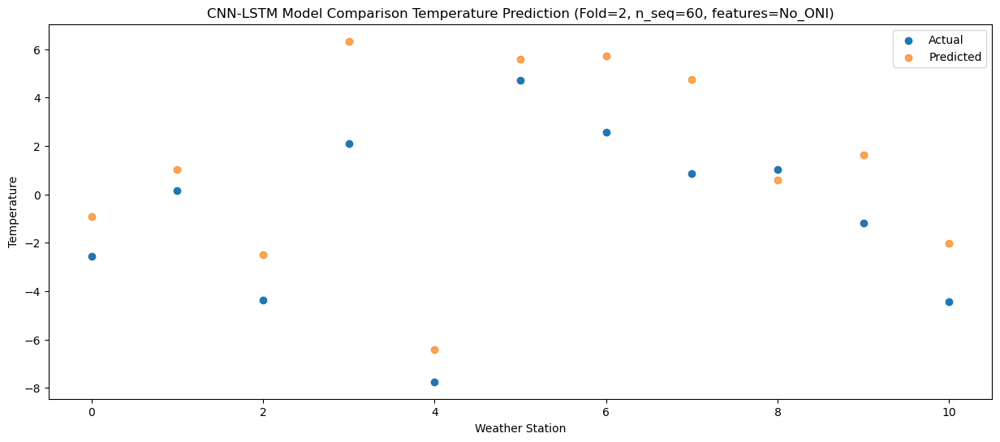

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -6.95  -2.474659
1                 1   -3.89  -1.529408
2                 2   -1.64   0.426609
3                 3    2.11   6.608405
4                 4   -8.49  -5.570233
5                 5    2.36   4.809954
6                 6   -0.54   3.947983
7                 7    3.79   5.421336
8                 8    0.12   2.969821
9                 9   -0.68   2.185729
10               10   -3.09  -1.952580


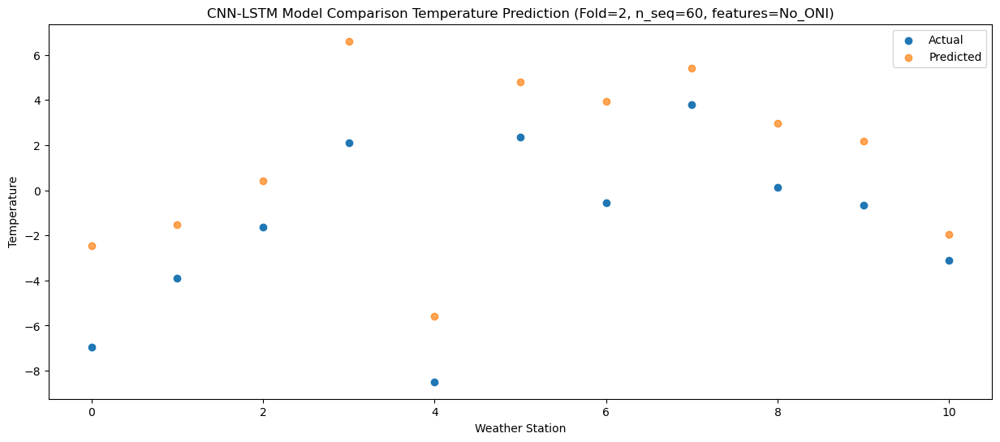

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.47   7.009611
1                 1    6.30   8.091944
2                 2    0.17   2.567200
3                 3    6.22  12.501372
4                 4   -1.16   0.173628
5                 5   10.74  12.773488
6                 6    9.83  13.429221
7                 7    6.89   9.859355
8                 8   -0.28   3.839418
9                 9    6.20   8.305289
10               10    3.12   4.941643


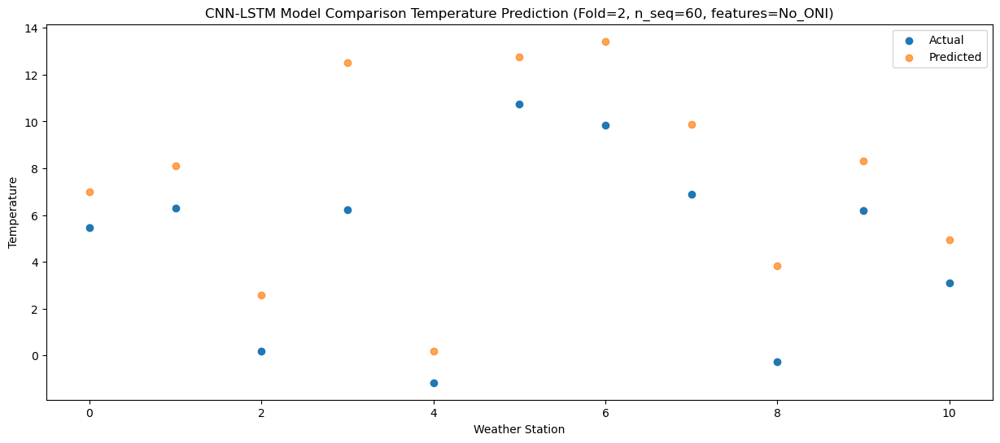

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.34   8.953036
1                 1   10.06  10.692445
2                 2    1.98   4.551181
3                 3   10.72  16.404429
4                 4   -0.29   1.796626
5                 5   12.86  14.331371
6                 6   11.53  14.982968
7                 7   13.55  12.789321
8                 8    3.58   7.546040
9                 9    8.99  10.878842
10               10    5.09   7.608313


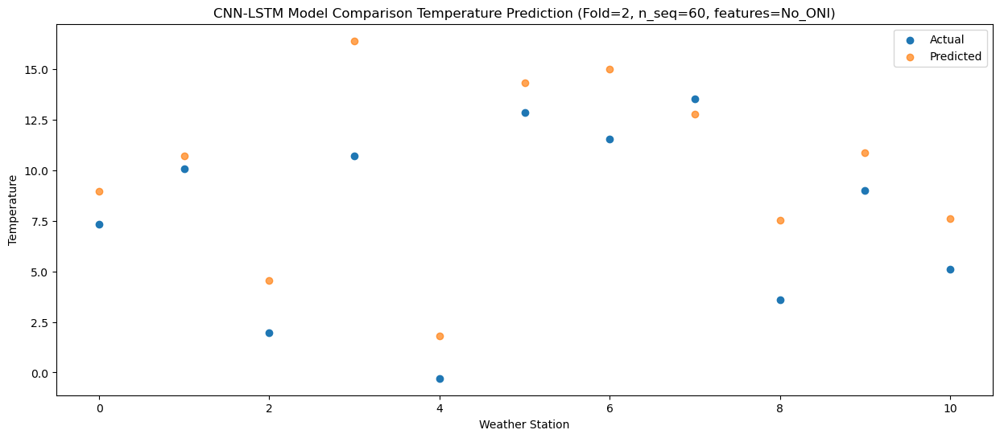

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   12.12  12.742921
1                 1   15.24  14.883904
2                 2    5.56   7.365272
3                 3   15.98  20.314945
4                 4    4.18   4.974192
5                 5   16.90  17.879966
6                 6   15.61  18.762246
7                 7   18.56  16.392887
8                 8    5.80  10.967788
9                 9   13.01  14.315091
10               10   10.00  11.183438


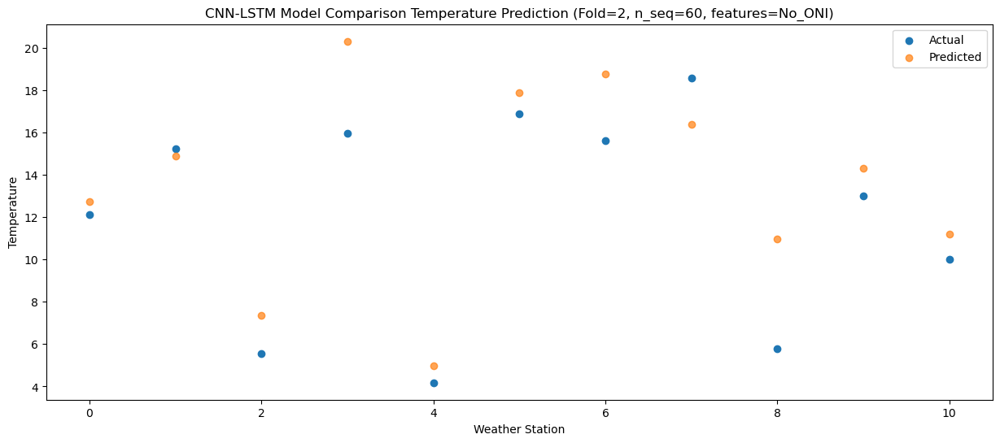

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   17.37  17.768489
1                 1   22.49  21.182686
2                 2    6.78   9.259644
3                 3   21.55  25.709753
4                 4    7.66   8.037806
5                 5   21.45  22.088758
6                 6   21.17  23.630974
7                 7   23.55  20.936996
8                 8   10.04  15.128340
9                 9   17.30  18.407545
10               10   15.41  15.694045


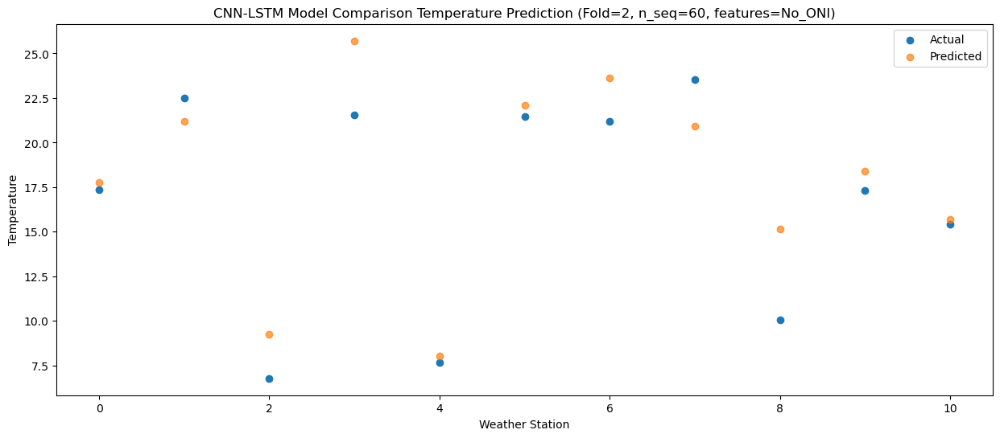

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   18.38  18.845966
1                 1   23.18  22.602977
2                 2    7.57  10.900011
3                 3   23.55  26.885183
4                 4    8.25   9.374588
5                 5   21.53  23.329640
6                 6   22.06  24.805907
7                 7   22.35  22.637247
8                 8   13.02  17.241414
9                 9   18.87  19.628886
10               10   16.72  16.855639


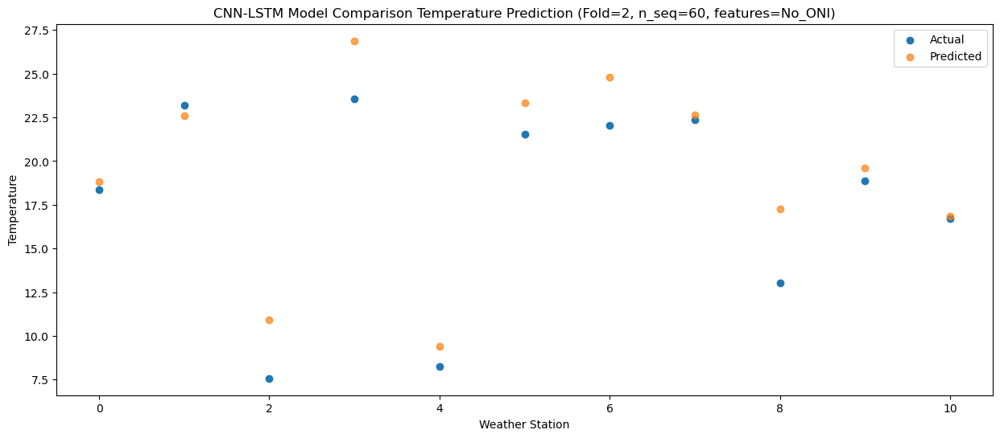

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.83  19.196932
1                 1   23.94  21.977921
2                 2    7.62  10.946786
3                 3   24.61  27.146942
4                 4    8.42   9.656583
5                 5   22.64  23.446228
6                 6   22.62  24.912832
7                 7   21.83  21.964955
8                 8   12.62  15.952405
9                 9   18.96  20.044720
10               10   16.80  17.294496


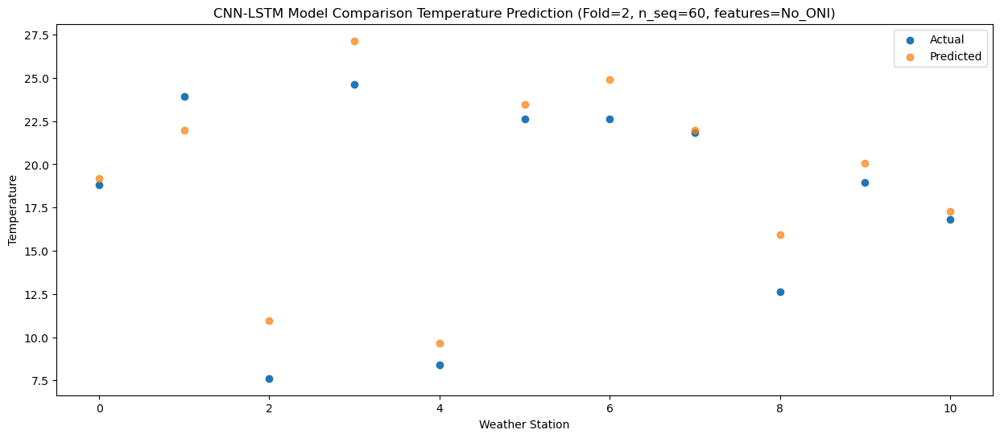

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   15.53  16.375361
1                 1   21.70  19.196831
2                 2    6.34   8.794351
3                 3   21.44  23.297842
4                 4    5.88   7.342333
5                 5   19.90  21.117989
6                 6   20.35  22.485398
7                 7   19.65  19.380129
8                 8   10.84  13.383175
9                 9   14.85  17.002019
10               10   12.31  14.116663


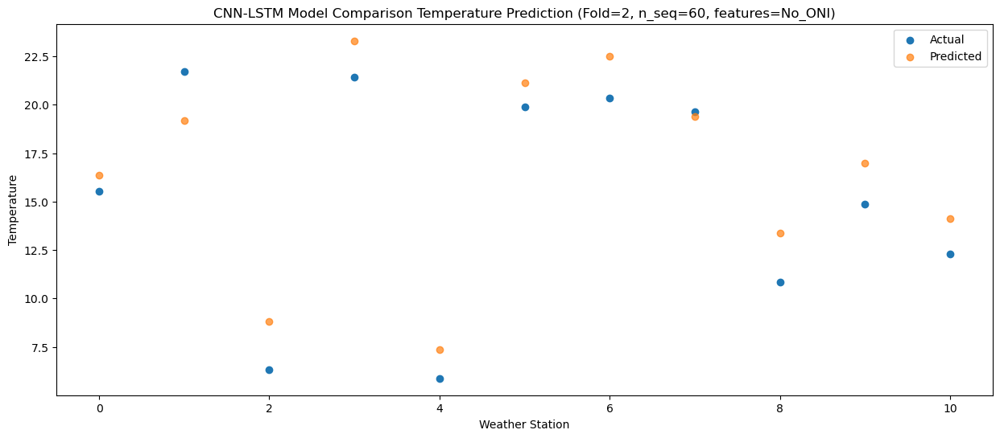

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.78  11.710476
1                 1   13.44  12.697397
2                 2    5.20   5.835142
3                 3   17.61  19.255855
4                 4    3.14   3.750326
5                 5   16.60  16.368495
6                 6   15.84  17.287354
7                 7   13.09  13.936213
8                 8    5.86   7.622921
9                 9   11.57  13.442240
10               10    8.55  10.358259


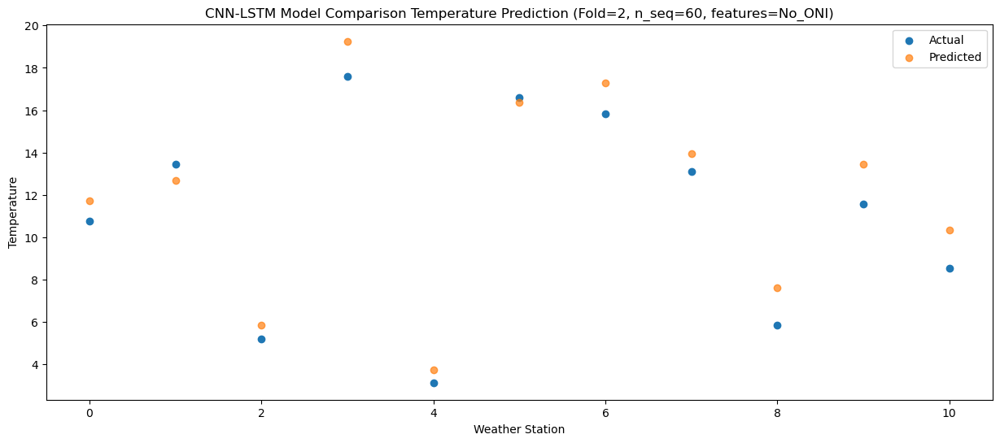

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.16   4.178874
1                 1    6.73   6.695959
2                 2   -1.65   0.269440
3                 3    9.53  11.251242
4                 4   -5.13  -2.769799
5                 5    8.96   9.967446
6                 6    7.87  10.598152
7                 7    7.69   9.116095
8                 8    4.60   4.455255
9                 9    2.66   5.980340
10               10   -1.67   2.632075


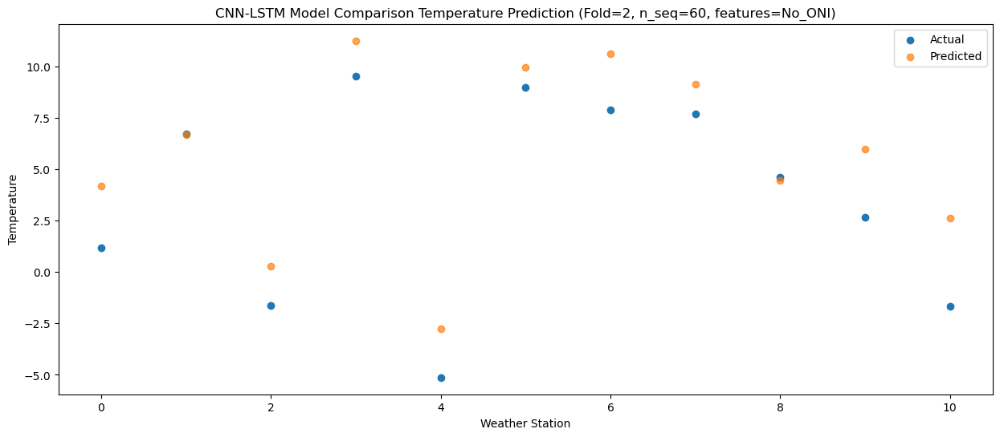

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.25   6.065845
1                 1    4.34   5.419336
2                 2   -0.75   3.189177
3                 3    7.61  10.709782
4                 4   -1.72   0.337172
5                 5   12.20  12.179786
6                 6   10.16  12.416246
7                 7    4.34   8.380923
8                 8   -1.91   2.044560
9                 9    4.58   7.872055
10               10    0.43   4.257522


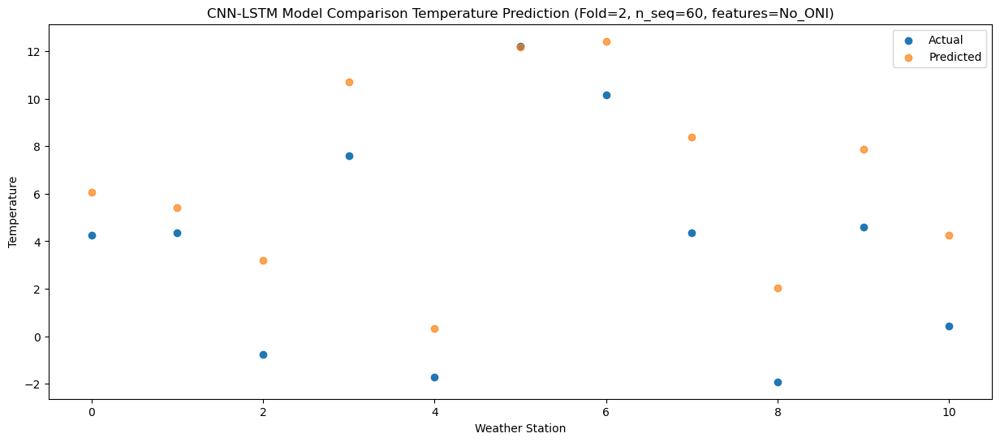

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.05  -1.650092
1                 1   -0.35  -0.229736
2                 2   -5.01  -1.584369
3                 3    1.46   4.569459
4                 4   -9.45  -6.104116
5                 5    3.77   5.448936
6                 6    1.68   5.218664
7                 7    1.34   4.644001
8                 8    0.50   0.941824
9                 9   -1.90   1.210253
10               10   -6.44  -2.706928


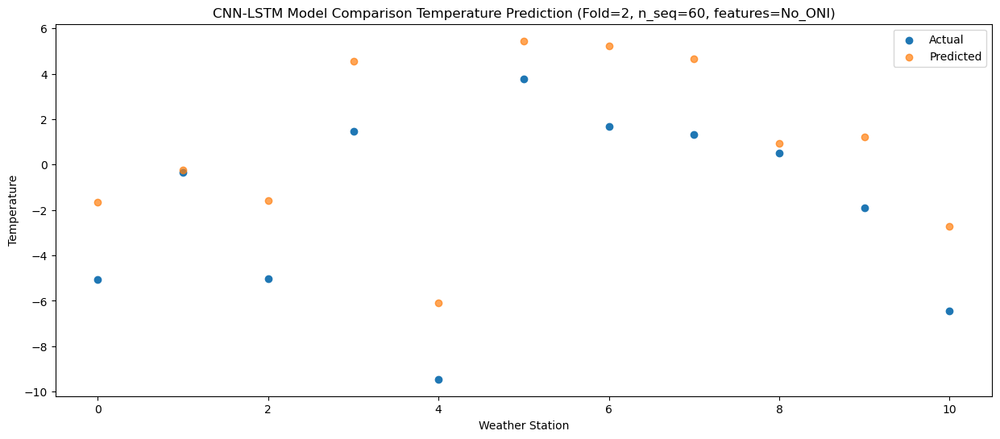

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.81   0.539986
1                 1   -0.36   0.831204
2                 2   -2.68   1.911156
3                 3    3.78   8.574088
4                 4   -6.31  -3.315070
5                 5    3.39   7.142480
6                 6    1.51   6.612559
7                 7    2.31   6.505329
8                 8    1.37   2.773844
9                 9    2.12   4.754118
10               10   -1.85   0.740015


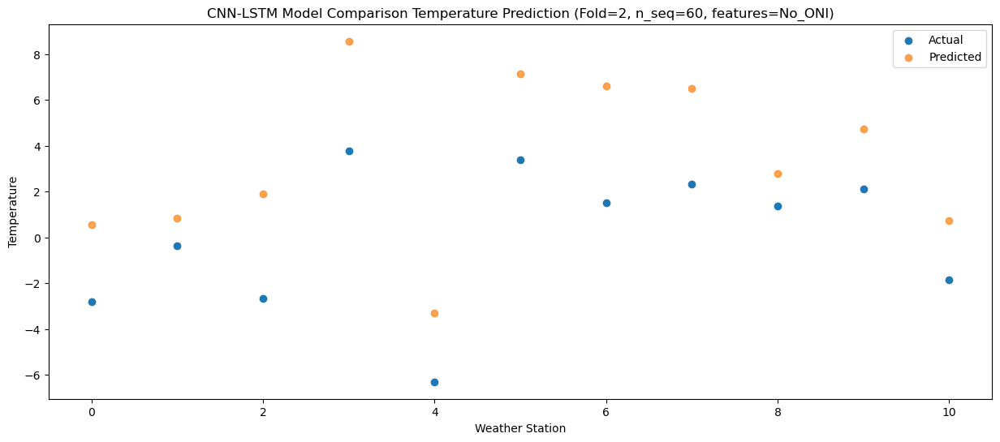

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.48   5.613228
1                 1    6.62   6.550127
2                 2    0.79   4.073205
3                 3    7.64  12.557914
4                 4   -2.55   0.196485
5                 5    9.51  11.791367
6                 6    8.09  11.852452
7                 7    7.37  10.361600
8                 8    3.16   5.702919
9                 9    6.23   8.424416
10               10    2.70   4.746630


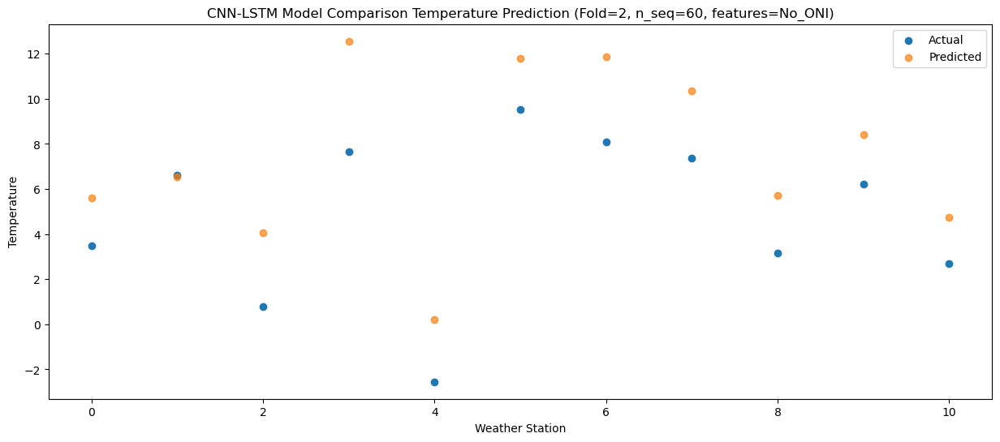

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    7.51  10.218011
1                 1   13.30  11.084383
2                 2    2.60   6.839460
3                 3   12.08  15.571378
4                 4    1.25   4.009346
5                 5   15.66  16.342955
6                 6   14.36  16.753813
7                 7   14.56  13.659917
8                 8    5.28   7.936240
9                 9    9.52  11.842605
10               10    5.86   8.313584


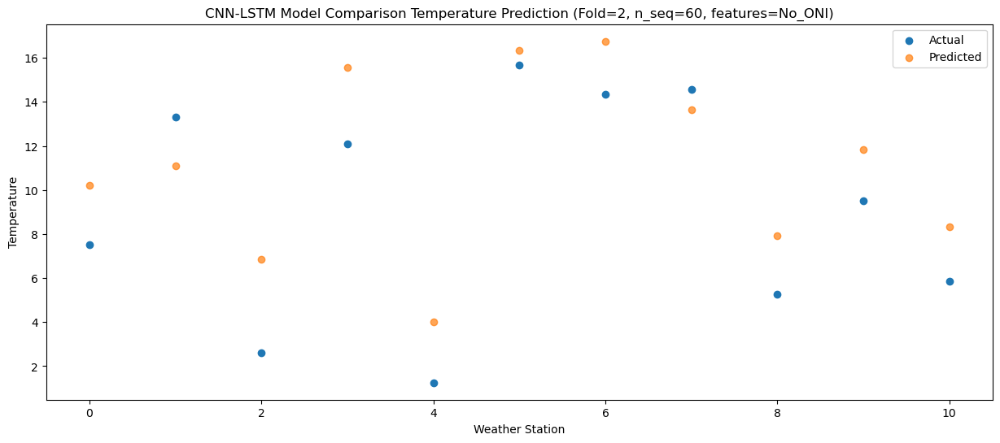

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.06  15.751906
1                 1   19.10  16.652334
2                 2    5.36   9.929981
3                 3   17.42  22.149274
4                 4    6.41   8.024667
5                 5   20.26  20.714958
6                 6   19.38  21.607642
7                 7   19.26  17.724296
8                 8    6.24  11.015513
9                 9   14.37  17.130450
10               10   12.10  13.972492


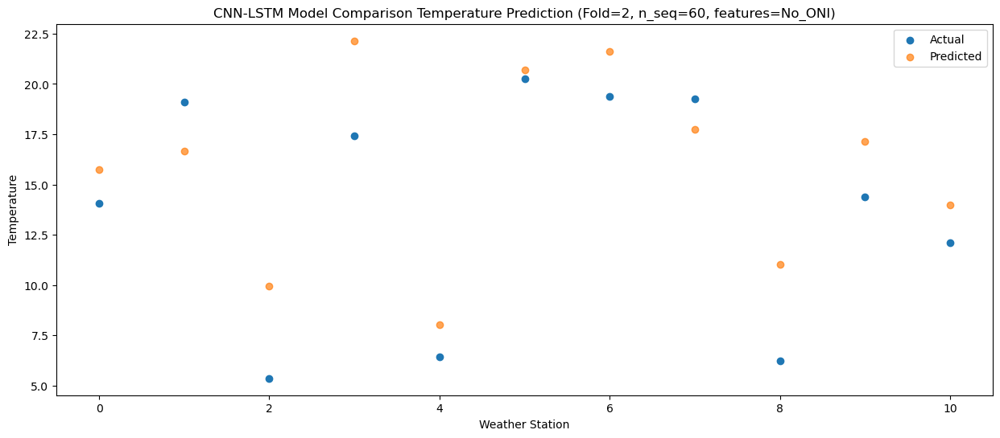

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   18.11  19.904784
1                 1   22.90  21.832365
2                 2    7.17  12.975726
3                 3   21.66  25.943352
4                 4    9.00  11.513416
5                 5   23.98  24.860353
6                 6   24.09  26.010538
7                 7   23.12  22.216899
8                 8   11.16  15.675724
9                 9   18.13  20.639947
10               10   15.75  17.614864


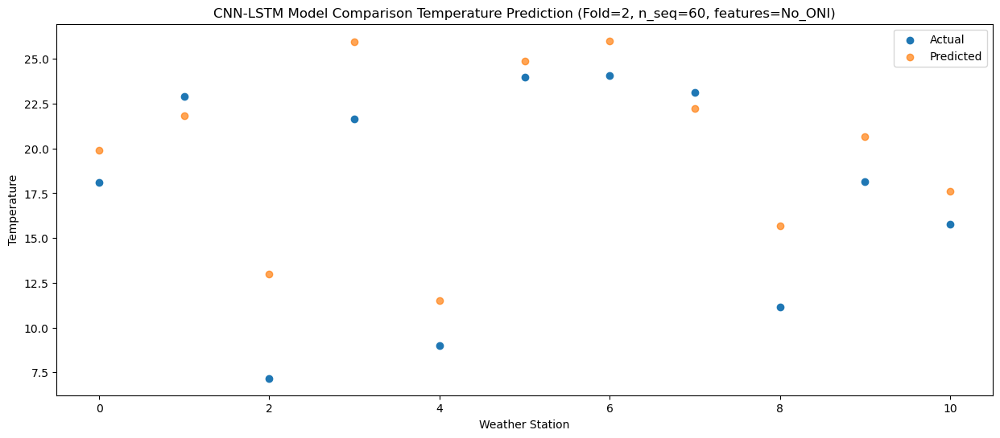

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   20.61  21.218722
1                 1   26.14  24.185585
2                 2    7.35  13.091832
3                 3   26.28  27.619029
4                 4    8.83  12.008660
5                 5   25.34  25.977440
6                 6   26.88  27.442157
7                 7   24.26  23.835890
8                 8   11.97  17.421073
9                 9   19.57  21.513787
10               10   17.10  18.644336


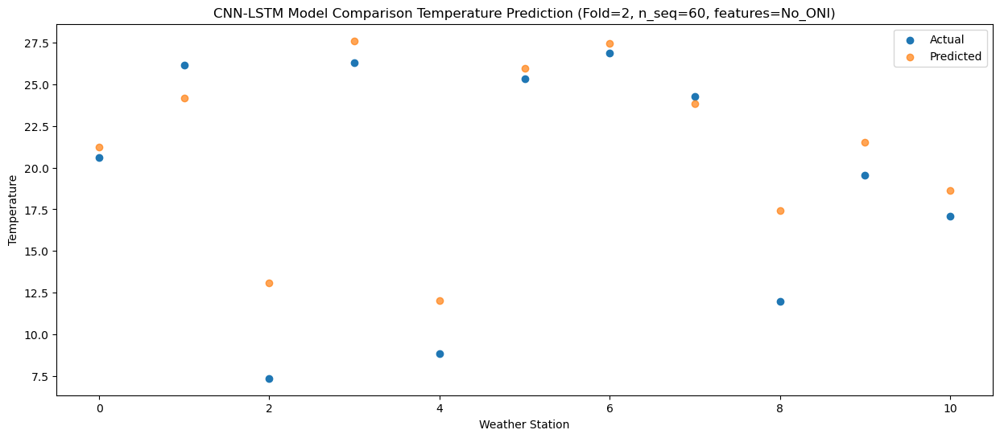

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   18.06  18.717126
1                 1   23.83  22.011546
2                 2    6.78  11.875453
3                 3   26.20  26.637515
4                 4    8.01  10.034439
5                 5   22.62  23.517170
6                 6   24.07  24.727014
7                 7   21.24  22.526651
8                 8   14.01  16.981212
9                 9   18.19  19.937416
10               10   15.85  16.979517


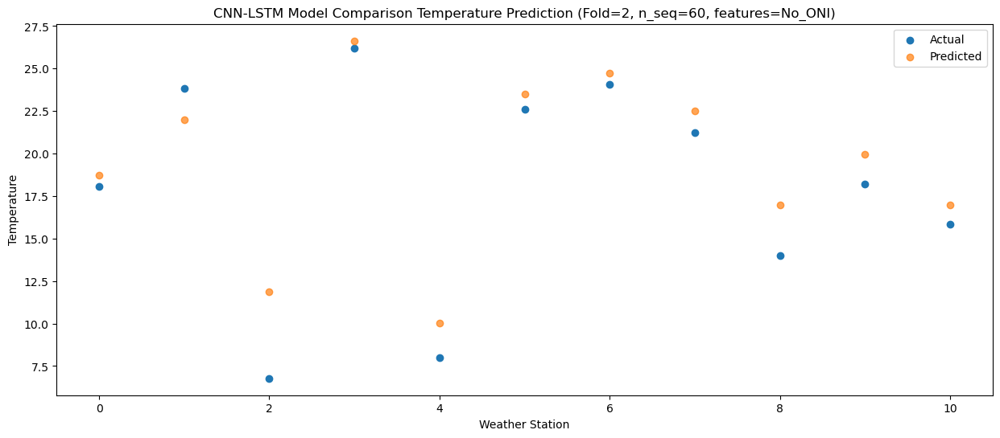

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   16.31  15.763068
1                 1   21.07  18.755165
2                 2    5.37  10.095671
3                 3   21.16  22.798303
4                 4    6.04   7.876412
5                 5   19.96  21.077704
6                 6   20.24  22.053589
7                 7   19.51  19.853635
8                 8   13.60  14.451087
9                 9   14.88  17.043400
10               10   11.70  13.896934


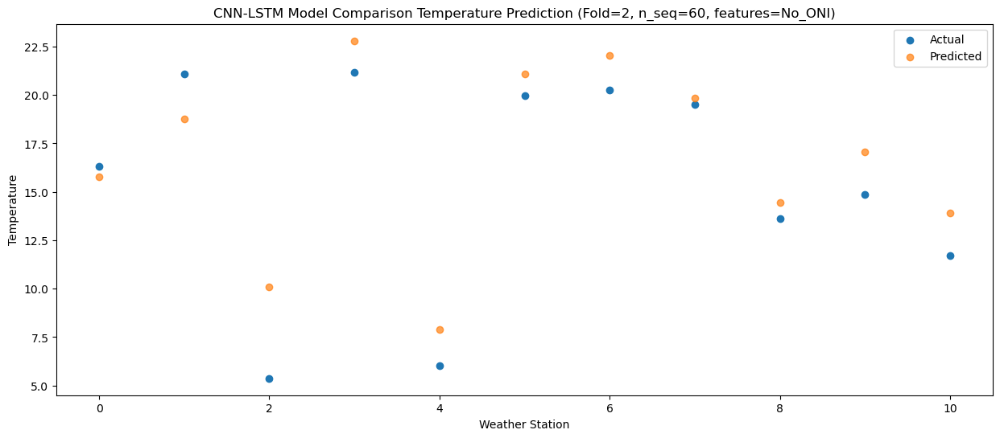

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    7.97   9.550209
1                 1   12.69  11.961283
2                 2    2.74   5.354660
3                 3   15.72  16.661530
4                 4   -0.15   2.560791
5                 5   14.39  15.215215
6                 6   13.86  15.879739
7                 7   11.30  14.006113
8                 8    7.33   8.875294
9                 9    7.57  11.344483
10               10    4.42   8.005605


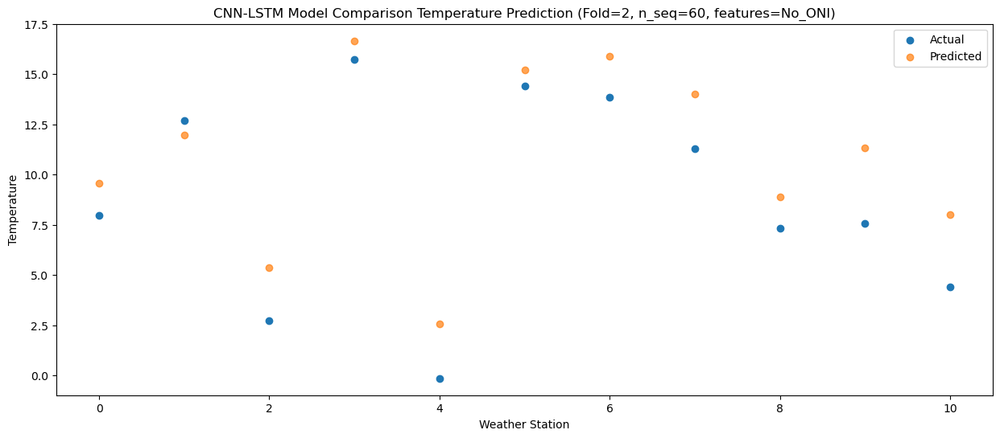

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.84   4.150570
1                 1    2.70   3.657680
2                 2    0.98   3.008208
3                 3   11.92  12.914944
4                 4   -3.22  -1.041962
5                 5    8.51   9.549670
6                 6    7.19   9.486477
7                 7    4.41   7.532781
8                 8    1.10   1.898149
9                 9    5.45   8.060713
10               10    1.97   4.376899


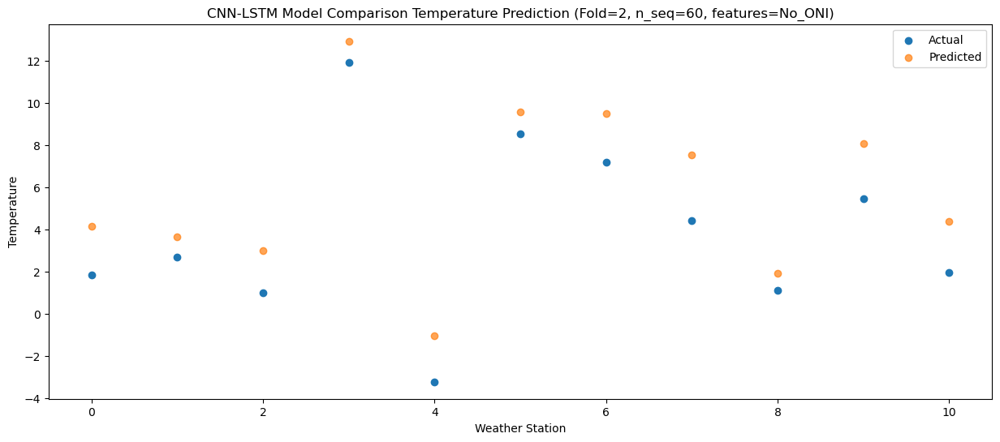

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.67  -0.148059
1                 1   -0.01  -0.344412
2                 2   -3.12  -0.186936
3                 3    5.75   6.856451
4                 4   -5.73  -4.476206
5                 5    6.28   6.453776
6                 6    4.57   6.131119
7                 7    2.24   4.499769
8                 8   -1.60  -0.433160
9                 9   -1.08   3.198939
10               10   -3.49  -0.698482


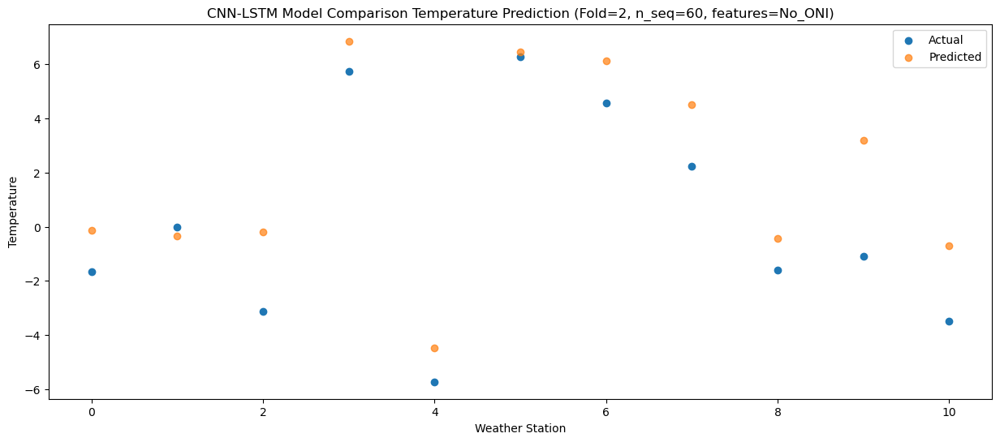

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.35   1.361650
1                 1   -0.26   1.139765
2                 2   -3.32   1.056538
3                 3    7.04   8.931454
4                 4   -4.56  -3.195460
5                 5    7.04   7.746173
6                 6    5.45   7.445724
7                 7    1.53   6.026724
8                 8   -1.94   1.144569
9                 9    2.12   4.871668
10               10   -1.57   1.031031


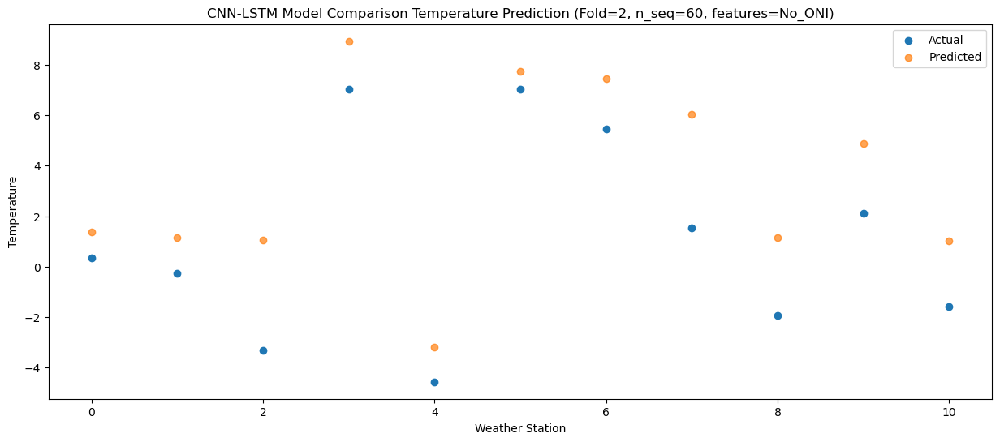

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.37   3.963048
1                 1    1.34   3.130190
2                 2   -0.26   3.705973
3                 3    5.16  10.159923
4                 4   -2.43  -0.357766
5                 5    8.23  10.430128
6                 6    5.64  10.148467
7                 7    2.74   7.692772
8                 8   -2.26   2.123420
9                 9    5.14   7.168794
10               10    1.22   3.256925


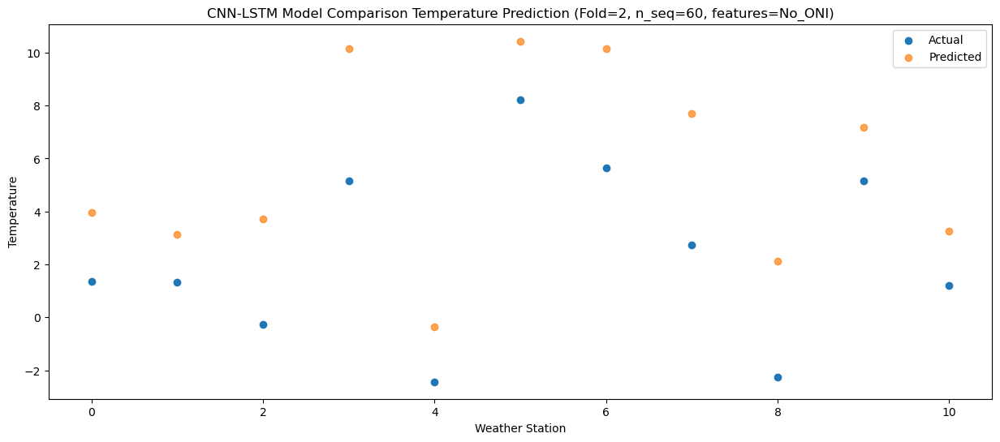

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.64   7.034095
1                 1    5.41   6.773198
2                 2    0.76   5.631004
3                 3    7.60  11.882566
4                 4   -0.60   2.212380
5                 5   12.03  13.780133
6                 6   10.29  13.745976
7                 7    7.44  10.643835
8                 8   -1.25   4.853386
9                 9    5.59   9.203535
10               10    1.75   5.375096


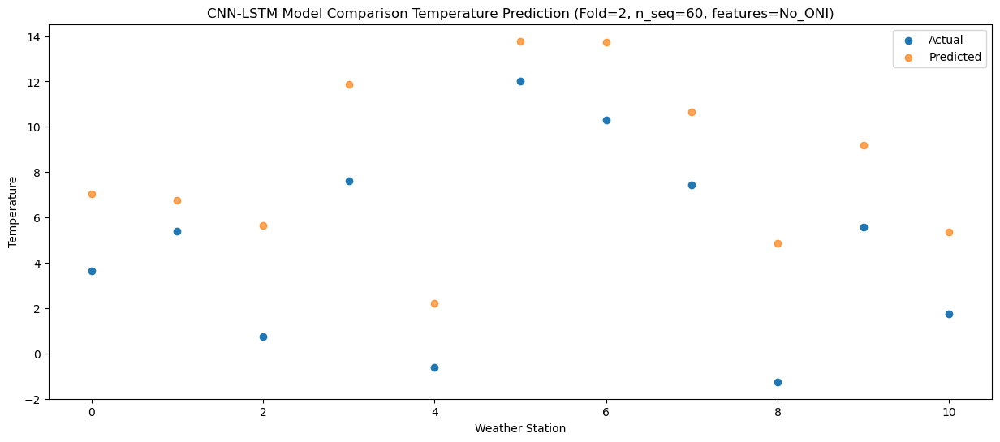

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.79  10.064637
1                 1   11.27  11.053359
2                 2    3.30   6.173927
3                 3   13.32  17.238338
4                 4    1.32   3.383016
5                 5   12.95  15.531497
6                 6   12.11  16.063992
7                 7   13.08  13.497814
8                 8    2.59   7.630345
9                 9    9.11  12.267145
10               10    6.64   8.875730


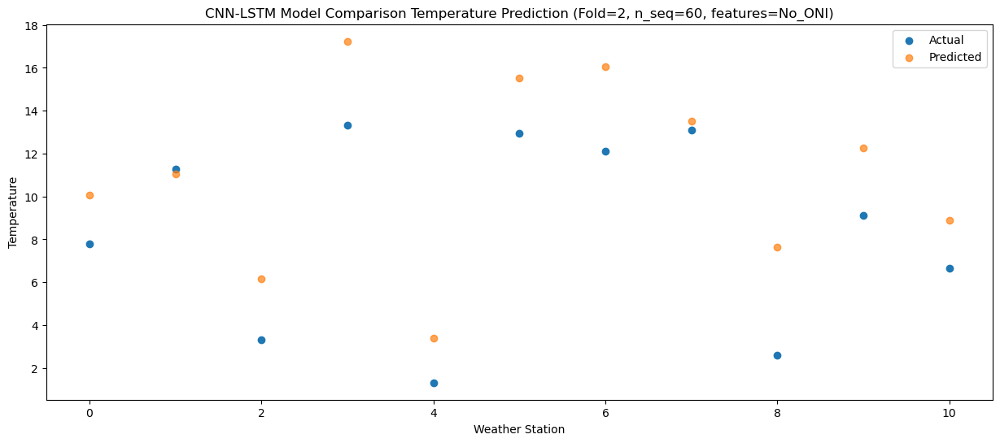

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.84  14.931813
1                 1   16.76  17.595083
2                 2    4.28   8.025589
3                 3   16.95  20.640990
4                 4    5.35   6.533359
5                 5   18.03  20.151677
6                 6   17.85  21.400283
7                 7   17.73  17.932550
8                 8    3.80  11.634331
9                 9   11.89  15.405232
10               10    9.99  12.343421


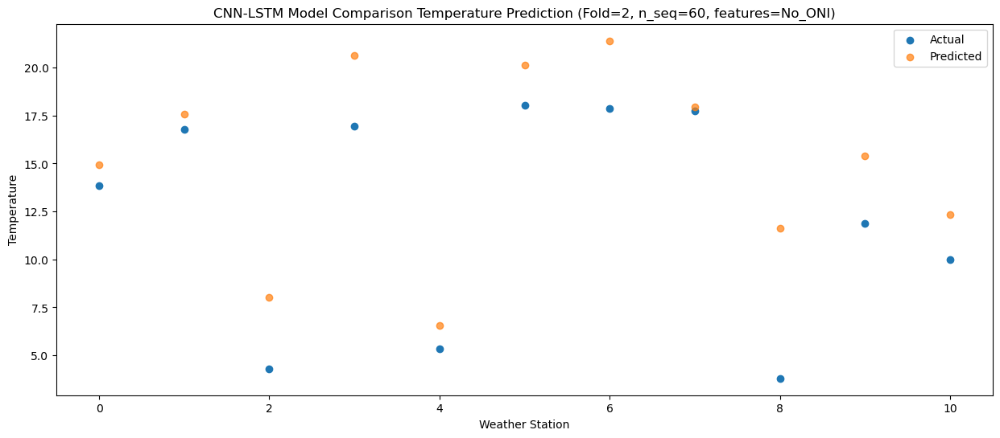

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.47  18.779773
1                 1   19.37  21.065282
2                 2    6.69  10.920954
3                 3   20.74  24.065564
4                 4    9.00   9.936745
5                 5   22.95  23.700045
6                 6   22.00  25.118643
7                 7   22.39  20.734968
8                 8    5.76  13.691956
9                 9   15.55  18.907848
10               10   12.90  15.949499


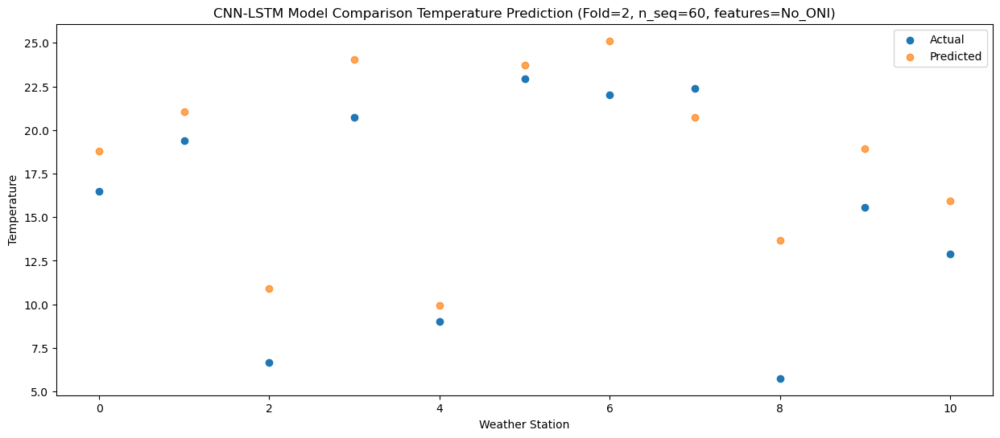

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.22  21.662072
1                 1   23.47  24.357086
2                 2    8.60  14.458515
3                 3   26.31  28.642918
4                 4   10.44  12.946093
5                 5   25.11  26.630325
6                 6   24.56  27.874955
7                 7   27.14  25.005377
8                 8   12.68  19.087148
9                 9   19.14  22.435778
10               10   16.45  19.470088


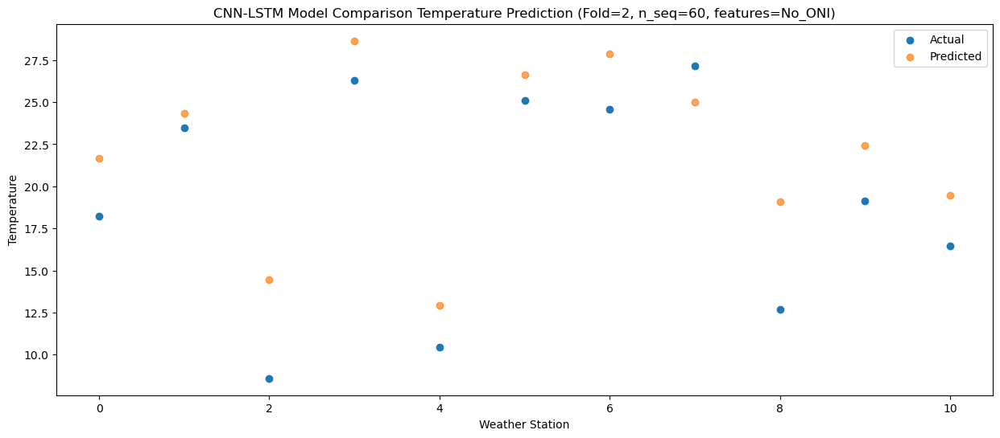

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.73  22.300198
1                 1   23.96  24.942375
2                 2    8.78  14.996393
3                 3   24.30  27.162762
4                 4   11.74  13.801590
5                 5   26.81  27.737427
6                 6   26.90  29.037452
7                 7   24.14  25.102694
8                 8   12.31  18.686316
9                 9   18.59  22.296341
10               10   15.74  19.227443


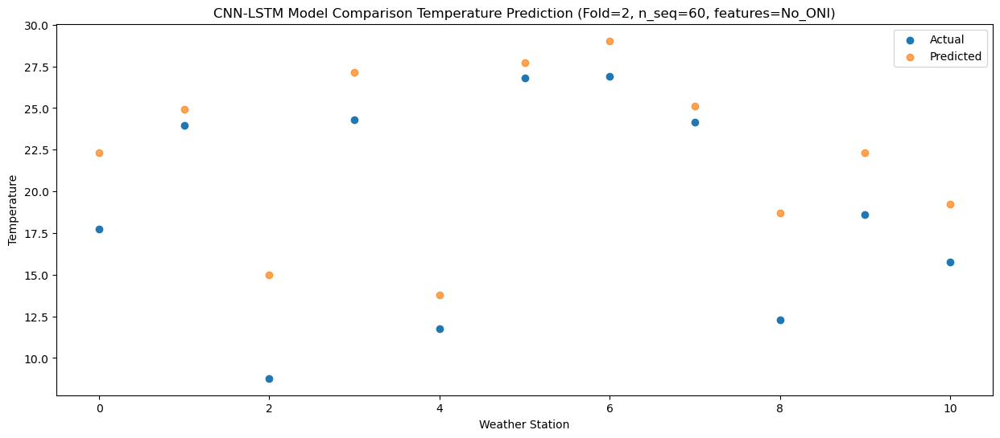

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.44  18.266525
1                 1   21.09  20.458678
2                 2    6.83  11.186010
3                 3   21.88  23.818495
4                 4    7.31   9.859184
5                 5   22.33  23.496663
6                 6   22.12  24.708668
7                 7   21.48  20.827569
8                 8    8.81  14.299868
9                 9   14.63  18.693217
10               10   12.96  15.622263


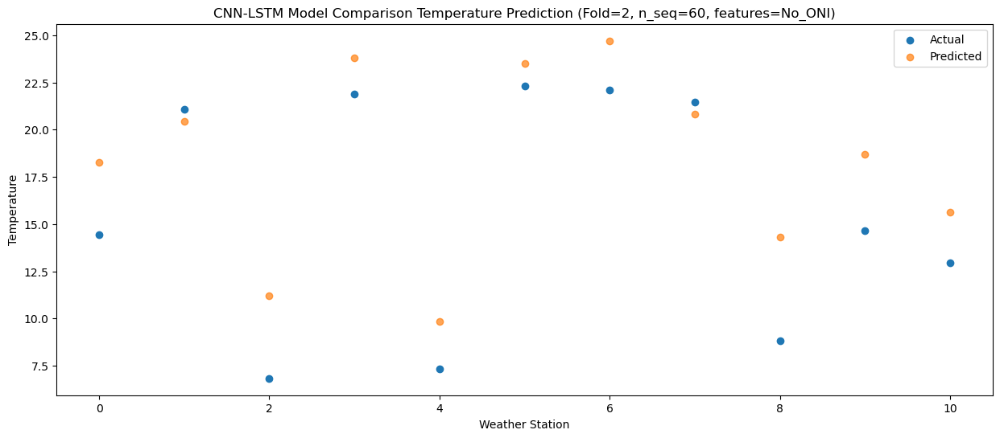

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    9.28  11.683961
1                 1   12.05  13.126562
2                 2    3.25   6.935438
3                 3   16.86  19.067399
4                 4    1.15   4.425829
5                 5   14.44  17.057327
6                 6   13.40  17.728808
7                 7   14.74  15.342790
8                 8    7.22   9.736273
9                 9    9.34  13.559833
10               10    6.91  10.277251


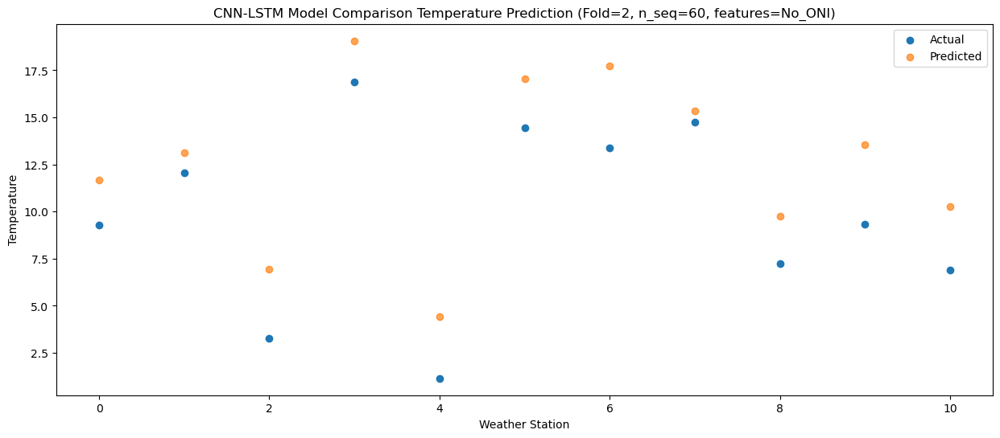

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.17   5.824577
1                 1    5.33   7.239765
2                 2   -0.73   2.058314
3                 3    8.88  12.471815
4                 4   -3.96  -0.775975
5                 5    8.16  11.665333
6                 6    8.06  12.146445
7                 7    7.63   9.881853
8                 8    2.83   4.480908
9                 9    3.44   7.740602
10               10    0.70   4.297490


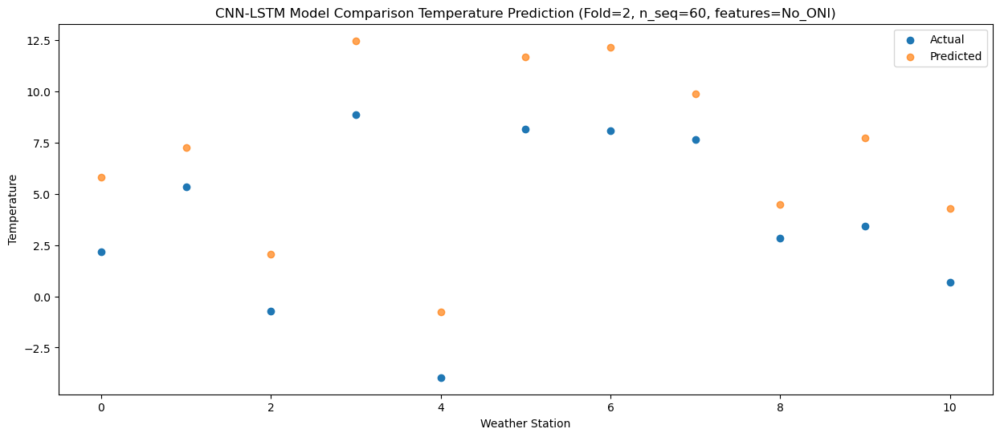

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.89   2.436709
1                 1    1.66   3.652904
2                 2   -2.66  -1.003331
3                 3    8.14  10.641795
4                 4   -6.56  -4.130016
5                 5    6.05   7.974273
6                 6    5.08   8.333722
7                 7    2.59   6.820063
8                 8    0.50   1.696397
9                 9    0.97   5.081558
10               10   -2.15   1.662157


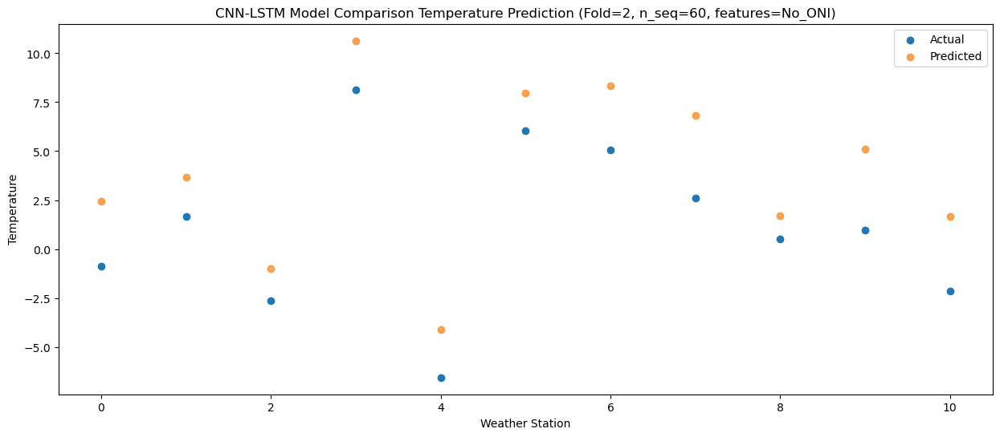

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -6.68  -2.062130
1                 1   -3.43  -1.039633
2                 2   -4.66  -1.583415
3                 3    3.97   7.494411
4                 4   -8.64  -6.582321
5                 5    1.90   4.280951
6                 6   -0.10   3.863617
7                 7    2.26   4.728366
8                 8   -1.30   1.267650
9                 9   -0.88   2.263107
10               10   -5.47  -1.606330


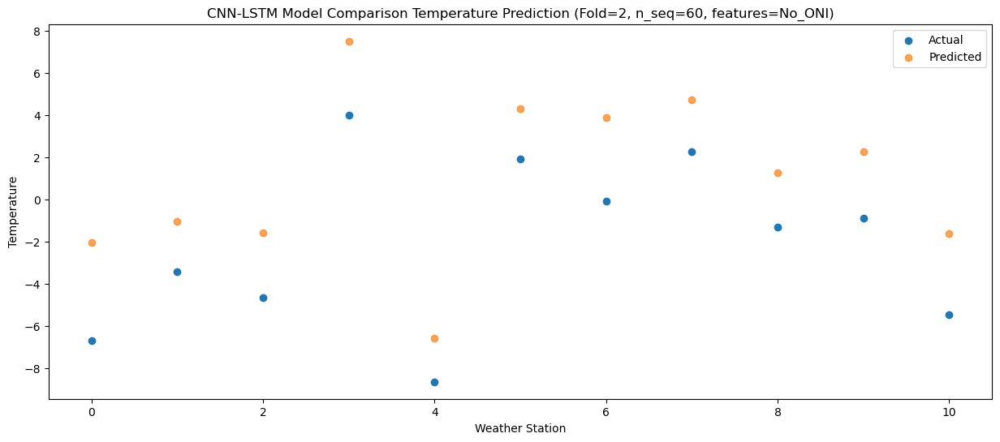

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.64   5.489892
1                 1    4.05   6.901710
2                 2   -4.18   1.170821
3                 3    4.65  10.425231
4                 4   -4.48  -1.201798
5                 5    8.66  11.653955
6                 6    8.16  12.219672
7                 7    5.47   9.265154
8                 8   -0.77   3.453175
9                 9    2.34   6.666599
10               10   -0.93   3.197746


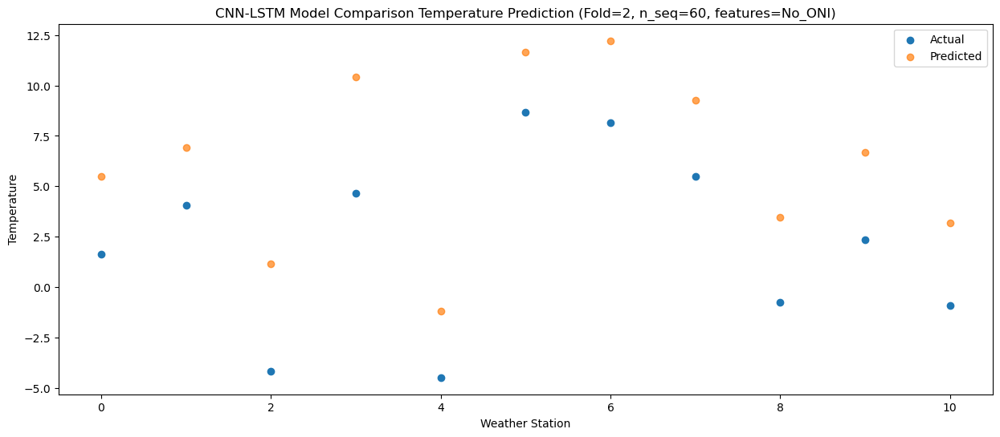

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.53   8.072174
1                 1    6.82   8.623131
2                 2    0.24   4.548992
3                 3    9.05  13.569277
4                 4   -1.81   1.844572
5                 5   11.03  14.040678
6                 6   10.51  14.439346
7                 7    8.04  11.373778
8                 8    0.17   5.324852
9                 9    5.90   9.924277
10               10    3.24   6.351715


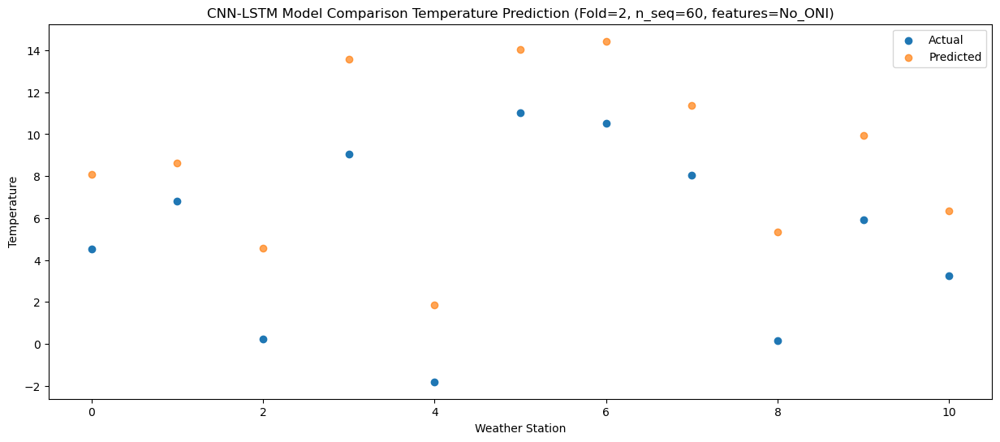

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.29  12.516666
1                 1   12.23  13.656281
2                 2    1.63   7.023470
3                 3   11.48  17.768019
4                 4    1.85   5.147818
5                 5   14.77  18.019467
6                 6   13.96  18.841626
7                 7   12.45  15.140261
8                 8    2.28   8.514914
9                 9    9.96  13.670779
10               10    7.22  10.327794


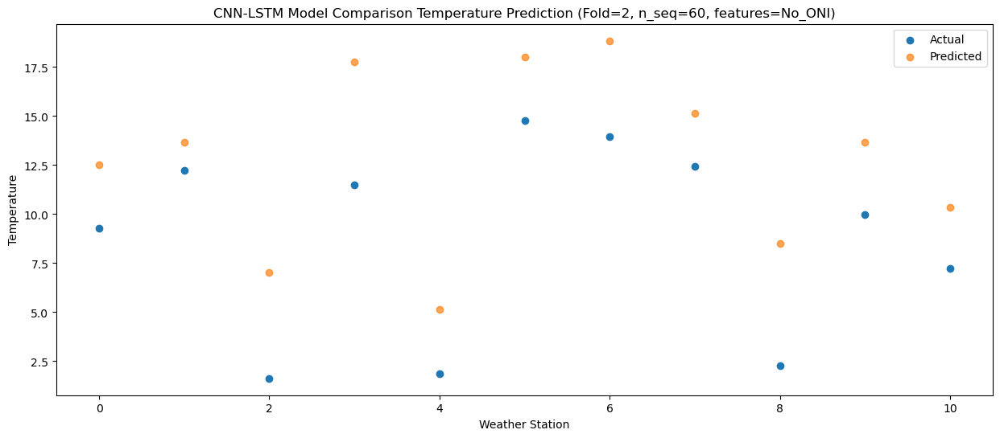

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.22  17.080261
1                 1   16.84  17.864433
2                 2    6.48  10.767138
3                 3   17.27  23.050900
4                 4    6.90   9.192266
5                 5   18.47  22.027467
6                 6   18.85  22.973536
7                 7   18.27  18.982423
8                 8    4.08  11.945545
9                 9   14.34  18.349203
10               10   11.68  15.163893


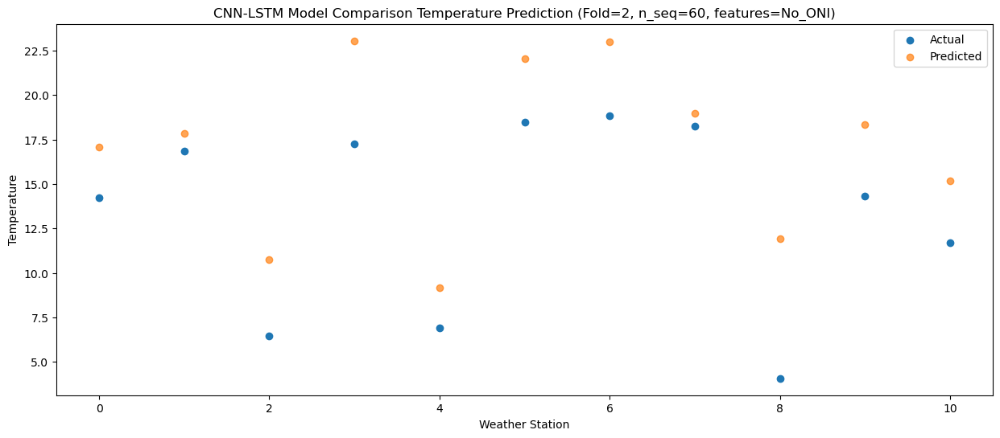

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.30  21.102451
1                 1   23.01  23.270367
2                 2    7.39  13.490607
3                 3   23.24  27.541442
4                 4    8.73  12.292108
5                 5   21.70  25.842912
6                 6   22.35  27.129620
7                 7   24.69  23.628830
8                 8    8.76  16.814973
9                 9   18.22  21.953068
10               10   16.03  18.942155


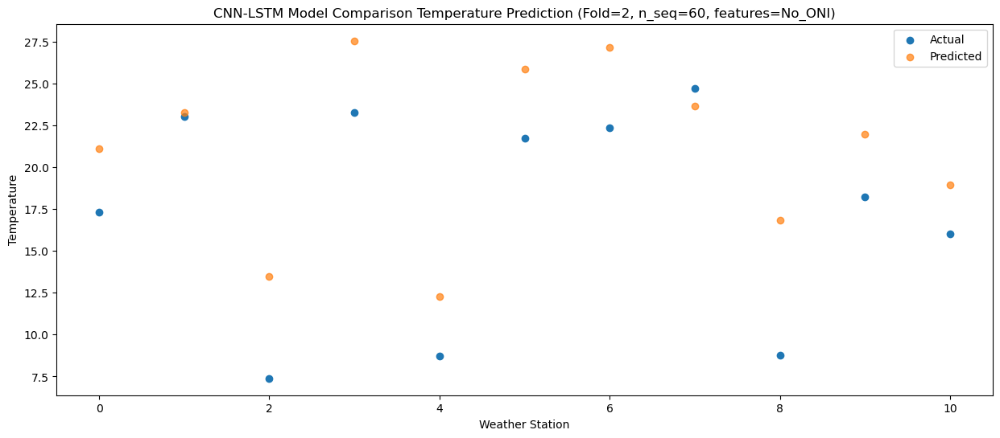

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   17.79  21.285094
1                 1   23.56  24.442508
2                 2    8.23  14.368997
3                 3   26.02  29.453122
4                 4    9.34  12.567762
5                 5   20.18  26.066348
6                 6   22.66  27.254961
7                 7   24.16  25.464044
8                 8   12.49  19.798346
9                 9   19.61  22.780898
10               10   17.26  19.748110


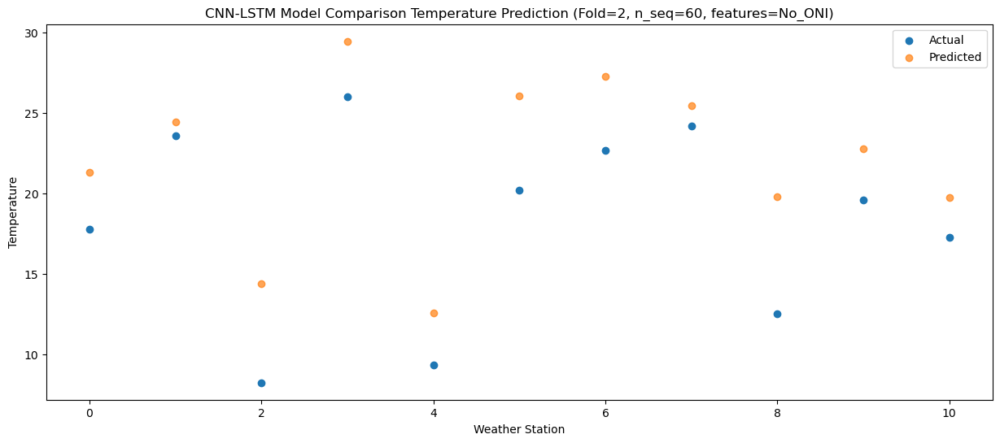

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.02  22.149921
1                 1   23.61  24.833740
2                 2    8.19  14.414496
3                 3   24.31  27.911314
4                 4    9.69  13.344615
5                 5   21.83  27.251239
6                 6   24.46  28.586034
7                 7   24.55  25.116985
8                 8   12.07  18.431790
9                 9   17.59  22.570891
10               10   15.64  19.536643


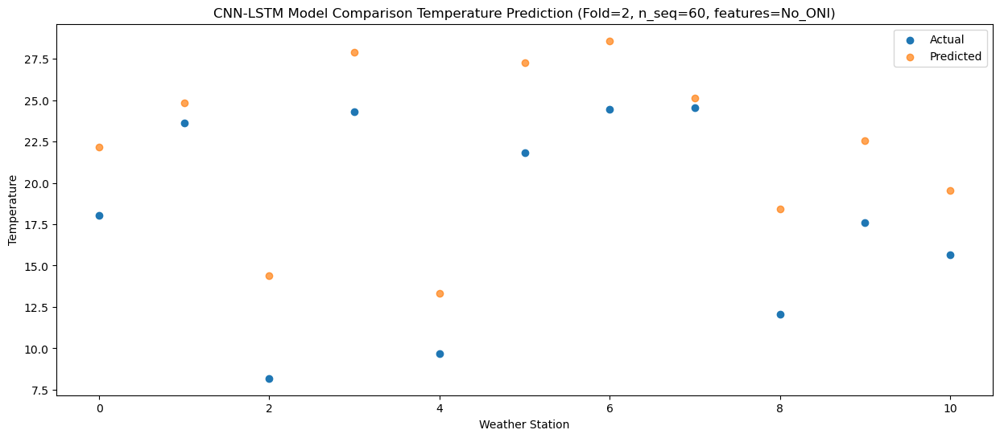

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.04  18.013625
1                 1   19.88  20.768756
2                 2    7.87  11.229284
3                 3   20.79  24.722989
4                 4    6.89   9.615297
5                 5   19.10  23.067738
6                 6   20.23  24.235688
7                 7   20.52  21.543442
8                 8   10.22  15.279689
9                 9   14.63  19.107469
10               10   13.05  15.991226


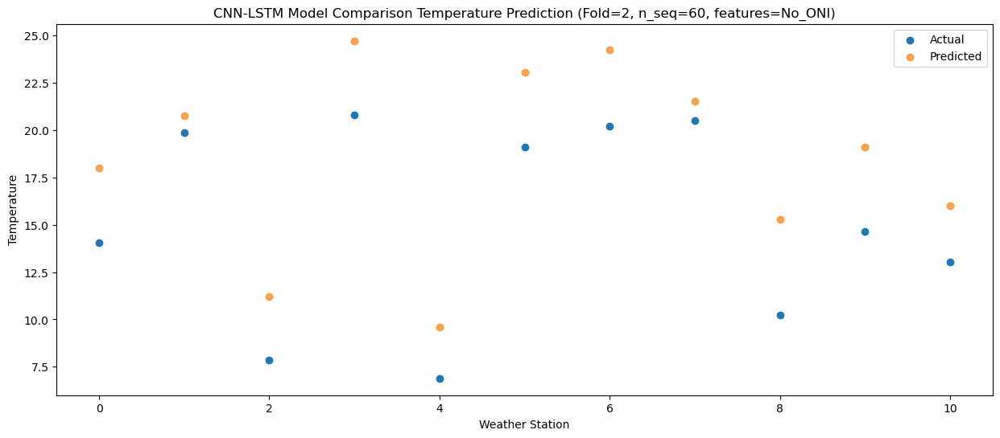

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    9.77  14.204119
1                 1   14.91  16.520895
2                 2    4.40   8.048302
3                 3   15.53  19.546871
4                 4    2.20   6.389013
5                 5   16.45  19.887776
6                 6   17.26  20.905474
7                 7   16.26  17.707087
8                 8    7.23  11.331608
9                 9    9.41  14.949628
10               10    6.63  11.680261


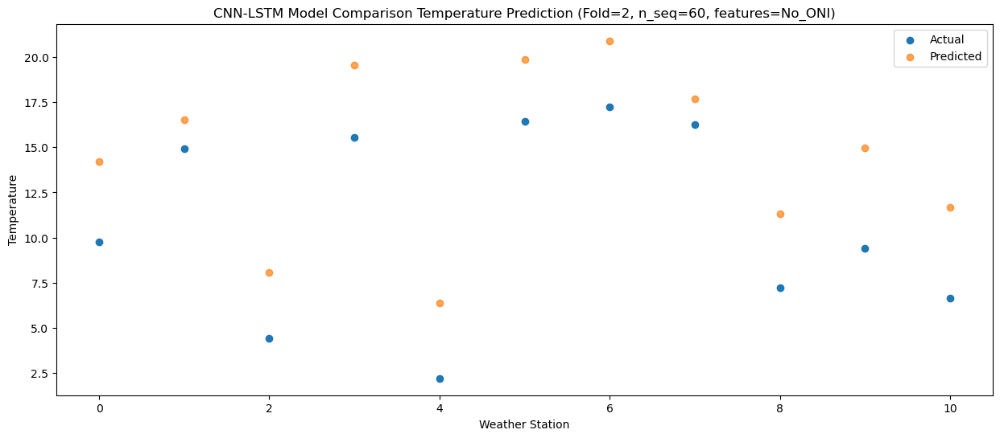

f, t:
[[-6.500e-01  3.410e+00 -1.000e-01  9.240e+00 -6.250e+00  7.270e+00
   6.650e+00  6.030e+00  2.170e+00  2.040e+00 -1.920e+00]
 [-3.100e-01  1.130e+00 -1.220e+00  6.180e+00 -5.900e+00  5.840e+00
   4.840e+00  1.500e+00 -1.370e+00  1.630e+00 -1.320e+00]
 [-9.000e-01  8.900e-01 -2.370e+00  6.450e+00 -5.560e+00  6.210e+00
   5.190e+00  2.750e+00 -8.300e-01  1.340e+00 -1.760e+00]
 [-1.090e+00  1.600e-01 -1.330e+00  6.600e+00 -4.920e+00  5.450e+00
   4.630e+00  3.560e+00  1.280e+00  2.380e+00 -1.960e+00]
 [ 5.500e+00  8.170e+00  2.290e+00  1.015e+01  1.770e+00  1.354e+01
   1.228e+01  8.060e+00  1.350e+00  7.610e+00  4.080e+00]
 [ 6.980e+00  1.040e+01  3.680e+00  1.138e+01  1.240e+00  1.351e+01
   1.259e+01  1.304e+01  4.560e+00  8.910e+00  4.510e+00]
 [ 1.227e+01  1.720e+01  4.990e+00  1.727e+01  4.210e+00  1.735e+01
   1.749e+01  1.933e+01  8.610e+00  1.151e+01  8.550e+00]
 [ 1.727e+01  2.440e+01  7.580e+00  2.333e+01  7.250e+00  2.096e+01
   2.223e+01  2.285e+01  9.900e+00  1.680e+0

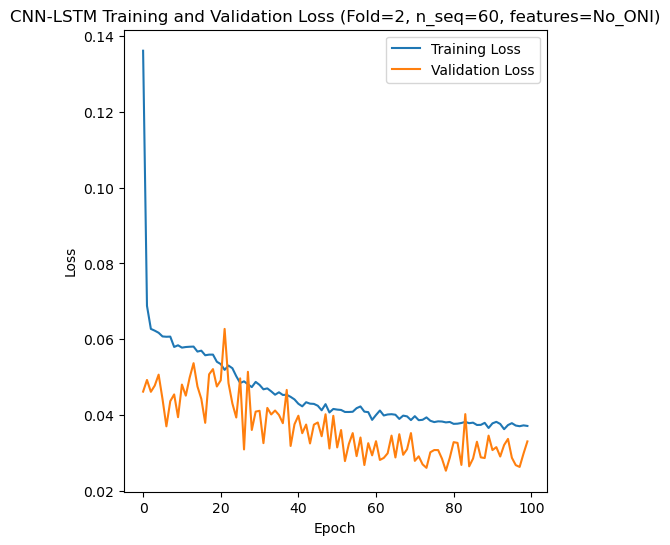

[[ 8.9   6.89 11.3  ... 22.19 16.88 13.54]
 [ 7.02  3.15 10.24 ... 22.31 18.92 11.32]
 [ 7.65  9.7   9.44 ... 25.68 20.65 11.46]
 ...
 [ 9.57 11.93 12.22 ... 30.9  25.01 12.37]
 [ 9.04  9.3   8.59 ... 17.72 17.26 10.73]
 [ 3.2   0.4   3.78 ... 18.92 14.39 10.04]]
Epoch 1/100
84/84 [==============================] - 37s 154ms/step - loss: 0.1261 - accuracy: 0.3929 - mae: 0.1082 - rmse: 0.1261 - mape: 23.5759 - pearson: 0.6892 - val_loss: 0.0877 - val_accuracy: 0.5000 - val_mae: 0.0698 - val_rmse: 0.0877 - val_mape: 16.0477 - val_pearson: 0.7746
Epoch 2/100
84/84 [==============================] - 7s 83ms/step - loss: 0.0666 - accuracy: 0.4643 - mae: 0.0529 - rmse: 0.0666 - mape: 12.2716 - pearson: 0.8315 - val_loss: 0.0834 - val_accuracy: 0.5000 - val_mae: 0.0652 - val_rmse: 0.0834 - val_mape: 15.7611 - val_pearson: 0.7763
Epoch 3/100
84/84 [==============================] - 6s 73ms/step - loss: 0.0631 - accuracy: 0.5238 - mae: 0.0502 - rmse: 0.0631 - mape: 11.8922 - pearson: 0.8425 - v

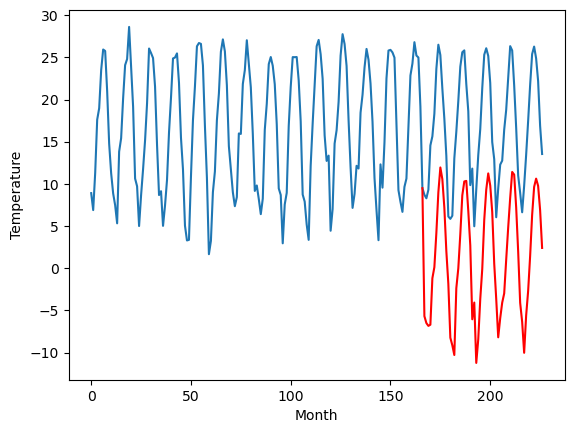

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.22		1.71		-0.51
0.87		0.16		-0.71
0.03		-0.29		-0.32
0.18		-0.39		-0.57
7.67		6.63		-1.04
8.59		8.18		-0.41
12.99		13.31		0.32
20.09		18.93		-1.16
21.95		21.02		-0.93
20.09		19.72		-0.37
16.42		14.90		-1.52
9.31		7.82		-1.49
6.49		4.58		-1.91
-0.06		-1.51		-1.45
-1.21		-2.41		-1.20
-4.93		-6.70		-1.77
7.04		5.03		-2.01
8.90		6.98		-1.92
13.12		11.53		-1.59
19.83		17.59		-2.24
21.14		19.00		-2.14
21.71		18.84		-2.87
18.98		15.45		-3.53
12.38		9.56		-2.82
4.67		1.32		-3.35
5.98		2.32		-3.66
-2.85		-5.31		-2.46
-1.63		-4.53		-2.90
5.15		2.02		-3.13
10.00		7.16		-2.84
15.43		13.04		-2.39
20.58		17.67		-2.91
24.62		20.22		-4.40
21.54		17.75		-3.79
17.68		14.38		-3.30
11.13		7.36		-3.77
3.90		-0.49		-4.39
-0.15		-4.07		-3.92
0.55		-2.29		-2.84
2.51		-1.13		-3.64
5.11		1.63		-3.48
10.16		5.84		-4.32
15.47		11.98		-3.49
19.80		15.83		-3.97
22.06		18.00		-4.06
22.24		18.92		-3.32
18.19		14.27		-3.92

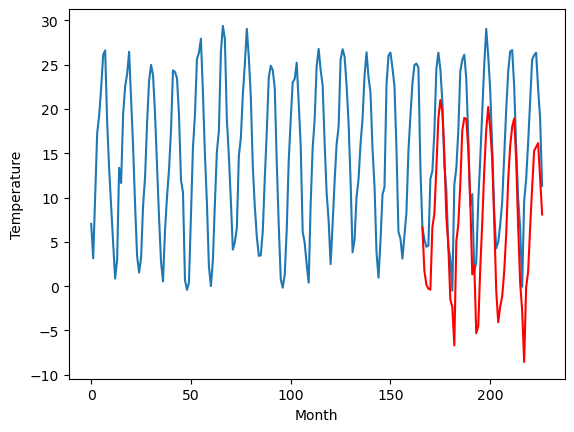

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.71		4.11		1.40
0.18		0.69		0.51
-1.04		1.95		2.99
1.38		2.47		1.09
3.17		5.43		2.26
7.83		9.20		1.37
13.02		13.75		0.73
16.37		16.91		0.54
19.15		20.27		1.12
19.68		21.23		1.55
15.35		16.67		1.32
9.86		10.62		0.76
1.21		5.50		4.29
-1.99		2.17		4.16
-0.73		2.69		3.42
1.57		2.18		0.61
2.72		5.49		2.77
8.45		9.45		1.00
13.25		13.46		0.21
18.10		19.69		1.59
21.23		21.79		0.56
19.03		20.19		1.16
15.72		16.88		1.16
7.06		9.64		2.58
2.72		6.70		3.98
-1.20		2.42		3.62
-1.53		2.00		3.53
0.17		2.21		2.04
4.88		6.44		1.56
7.95		9.55		1.60
12.19		12.98		0.79
17.58		18.21		0.63
20.15		23.24		3.09
20.33		22.94		2.61
17.51		19.37		1.86
10.33		13.29		2.96
-0.40		3.97		4.37
-1.36		1.24		2.60
0.03		2.72		2.69
-0.82		2.64		3.46
2.05		5.45		3.40
7.68		9.97		2.29
12.12		16.00		3.88
14.92		17.99		3.07
20.58		23.18		2.60
18.89		23.33		4.44
15.12		18.42		3.30
9.81		12.27		2.46
2.90		7.01		4.11
1.06		4.66		3.60
0.8

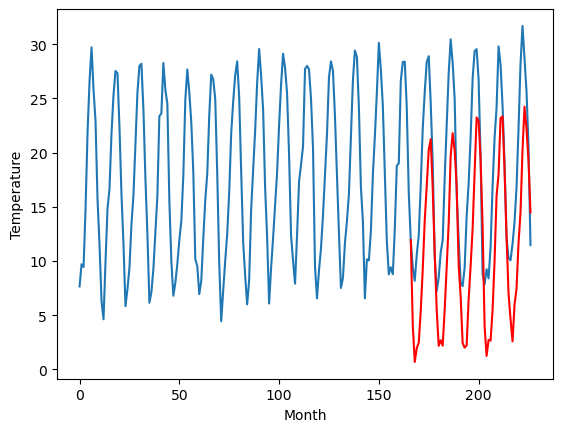

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.86		-1.45		1.41
-2.85		-2.61		0.24
-3.40		-3.09		0.31
-3.75		-3.25		0.50
3.16		2.82		-0.34
3.80		4.29		0.49
8.37		9.33		0.96
14.19		15.20		1.01
17.99		18.20		0.21
15.57		16.26		0.69
11.51		12.23		0.72
6.09		5.90		-0.19
2.17		2.22		0.05
-5.03		-4.27		0.76
-6.49		-5.73		0.76
-7.81		-8.30		-0.49
2.40		1.59		-0.81
4.75		4.28		-0.47
8.82		8.73		-0.09
14.74		14.39		-0.35
15.73		15.79		0.06
16.25		15.97		-0.28
12.12		12.08		-0.04
8.54		7.52		-1.02
-1.12		-2.05		-0.93
0.37		-0.68		-1.05
-8.58		-8.70		-0.12
-4.06		-6.06		-2.00
1.69		-0.41		-2.10
4.70		3.77		-0.93
11.48		10.52		-0.96
14.96		14.47		-0.49
16.51		16.72		0.21
15.44		15.01		-0.43
11.46		11.36		-0.10
4.19		4.73		0.54
1.07		-0.37		-1.44
-4.20		-5.41		-1.21
-2.45		-3.07		-0.62
-0.11		-1.83		-1.72
0.13		-0.41		-0.54
6.37		4.71		-1.66
9.06		9.26		0.20
12.80		13.10		0.30
16.42		16.01		-0.41
15.31		15.45		0.14
12.58		11.61		-0.97
7.14		5.69		-1

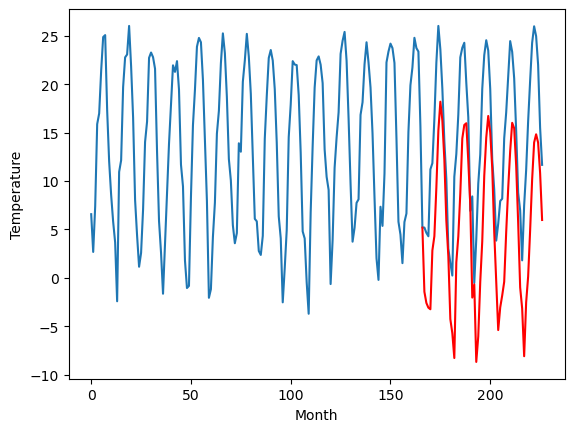

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.31		-1.54		-4.85
0.05		-3.01		-3.06
-2.82		-3.88		-1.06
-1.67		-4.01		-2.34
5.74		2.82		-2.92
8.77		4.71		-4.06
14.84		10.20		-4.64
21.89		16.77		-5.12
23.35		19.21		-4.14
20.79		17.21		-3.58
16.72		12.48		-4.24
8.99		4.96		-4.03
6.17		1.85		-4.32
-1.00		-4.68		-3.68
-2.47		-6.13		-3.66
-6.34		-10.53		-4.19
6.74		1.70		-5.04
10.03		4.26		-5.77
14.60		9.01		-5.59
22.08		15.50		-6.58
22.08		16.69		-5.39
22.20		16.65		-5.55
18.84		12.83		-6.01
13.42		7.27		-6.15
3.68		-2.04		-5.72
3.32		-1.77		-5.09
-6.15		-9.80		-3.65
-3.63		-8.03		-4.40
4.83		-1.39		-6.22
8.96		3.27		-5.69
16.53		10.34		-6.19
21.98		15.00		-6.98
23.10		17.38		-5.72
21.28		15.33		-5.95
16.96		11.60		-5.36
9.69		4.40		-5.29
3.80		-2.58		-6.38
-2.17		-7.60		-5.43
-0.45		-5.49		-5.04
6.07		-4.31		-10.38
3.11		-2.19		-5.30
10.32		3.40		-6.92
16.32		9.31		-7.01
20.42		13.37		-7.05
22.12		15.48		-6.64
20.83		15.47		-5.36
17.47		11.

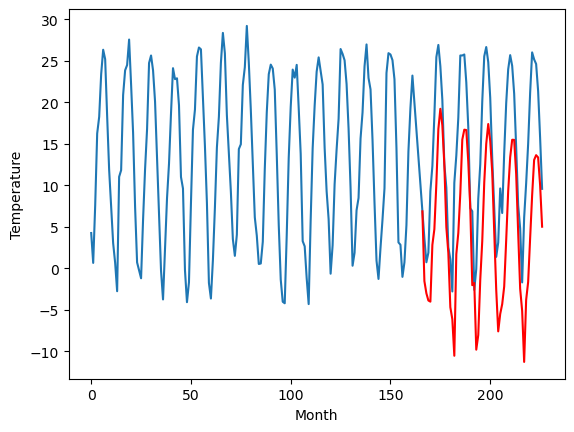

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.82		-4.61		1.21
-5.61		-5.88		-0.27
-7.03		-6.61		0.42
-7.44		-6.82		0.62
-0.58		-0.29		0.29
1.69		1.36		-0.33
7.10		6.70		-0.40
14.09		13.06		-1.03
15.98		15.83		-0.15
13.47		13.71		0.24
9.84		9.33		-0.51
3.84		2.32		-1.52
-0.10		-1.05		-0.95
-7.71		-7.65		0.06
-9.16		-9.21		-0.05
-11.88		-12.77		-0.89
-0.55		-1.50		-0.95
2.90		1.16		-1.74
7.18		5.78		-1.40
13.89		11.91		-1.98
14.27		13.16		-1.11
14.59		13.29		-1.30
11.33		9.35		-1.98
6.75		4.39		-2.36
-4.10		-5.34		-1.24
-3.05		-4.42		-1.37
-11.87		-12.71		-0.84
-8.68		-10.37		-1.69
-1.72		-4.16		-2.44
2.13		0.25		-1.88
9.93		7.37		-2.56
13.87		11.64		-2.23
15.86		13.89		-1.97
14.21		12.01		-2.20
10.26		8.25		-2.01
4.22		1.30		-2.92
-2.33		-4.57		-2.24
-7.87		-9.78		-1.91
-5.73		-7.51		-1.78
-4.01		-6.31		-2.30
-3.11		-4.64		-1.53
3.12		0.87		-2.25
8.53		6.04		-2.49
11.99		10.05		-1.94
15.25		12.52		-2.73
13.70		12.10		-1.60
10.24		8.19	

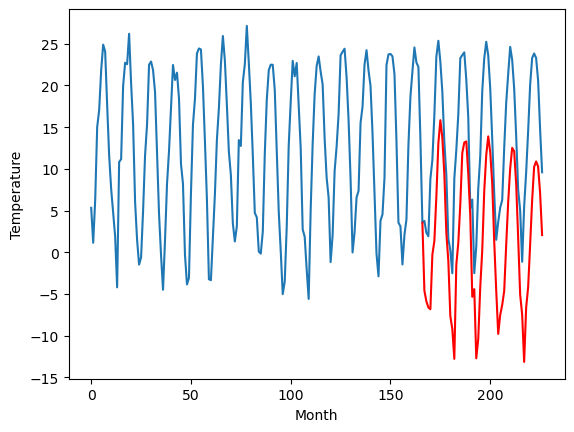

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		1.17		7.63
-12.13		-1.78		10.35
-12.22		-1.11		11.11
-12.03		-0.81		11.22
-7.10		3.50		10.60
-4.12		6.69		10.81
2.99		11.71		8.72
7.20		15.91		8.71
9.19		18.91		9.72
9.94		19.10		9.16
4.44		14.23		9.79
0.70		7.50		6.80
-6.49		3.02		9.51
-12.19		-1.18		11.01
-11.92		-1.22		10.70
-11.82		-3.30		8.52
-8.85		3.13		11.98
-4.07		6.55		10.62
0.98		10.89		9.91
8.37		17.36		8.99
10.21		19.26		9.05
8.29		18.06		9.77
6.42		14.64		8.22
-1.55		7.60		9.15
-4.29		2.94		7.23
-9.05		-0.03		9.02
-11.34		-2.77		8.57
-13.06		-2.49		10.57
-8.52		2.67		11.19
-4.20		6.54		10.74
1.71		10.96		9.25
7.48		16.16		8.68
9.40		20.53		11.13
8.64		19.53		10.89
6.48		15.93		9.45
-1.78		9.41		11.19
-9.46		0.22		9.68
-11.63		-2.91		8.72
-12.36		-1.32		11.04
-12.33		-1.10		11.23
-10.54		1.83		12.37
-5.20		6.60		11.80
2.01		12.95		10.94
6.59		15.62		9.03
12.73		19.82		7.09
10.14		20.19		10.05
5.99		15.34		9.35
-0.14		8.58	

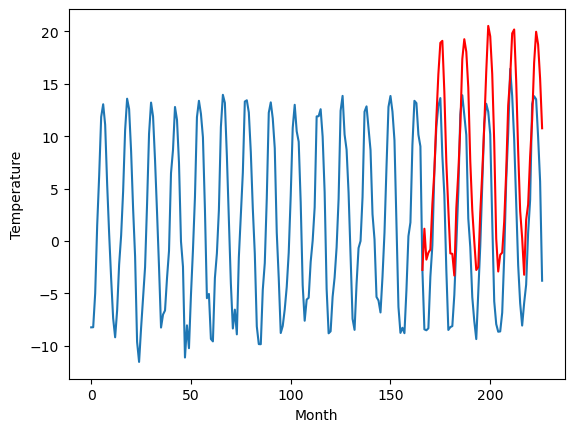

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-13.16		-11.23		1.93
-17.89		-14.67		3.22
-16.73		-13.61		3.12
-15.22		-13.17		2.05
-12.11		-9.75		2.36
-6.20		-5.98		0.22
1.07		-1.05		-2.12
4.53		2.57		-1.96
8.76		5.80		-2.96
8.87		6.54		-2.33
4.06		1.64		-2.42
-2.88		-4.94		-2.06
-11.69		-9.82		1.87
-17.38		-13.36		4.02
-16.83		-13.04		3.79
-13.98		-14.40		-0.42
-12.38		-9.76		2.62
-4.41		-5.87		-1.46
0.02		-1.66		-1.68
7.66		4.95		-2.71
8.74		6.98		-1.76
7.51		5.42		-2.09
3.54		2.05		-1.49
-6.81		-5.45		1.36
-9.33		-8.76		0.57
-16.60		-13.11		3.49
-16.67		-14.10		2.57
-14.63		-14.09		0.54
-9.92		-9.37		0.55
-5.29		-5.92		-0.63
-0.62		-2.11		-1.49
5.86		3.31		-2.55
8.09		8.32		0.23
6.50		7.77		1.27
4.14		4.11		-0.03
-3.75		-2.25		1.50
-15.17		-12.04		3.13
-17.50		-14.89		2.61
-18.01		-13.42		4.59
-17.10		-13.54		3.56
-14.27		-10.51		3.76
-6.32		-5.66		0.66
-0.52		0.81		1.33
1.98		3.04		1.06
10.34		7.91		-2.43
5.71		8.18		2.47
1.01		3.23		

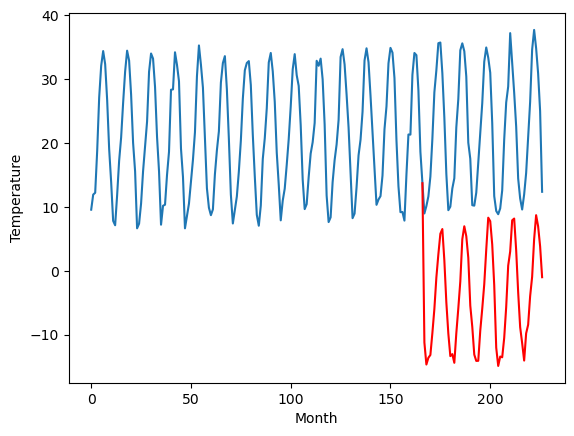

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.28		6.60		1.32
4.03		3.47		-0.56
3.40		4.79		1.39
5.42		5.39		-0.03
4.86		8.19		3.33
8.48		11.72		3.24
10.88		15.58		4.70
13.42		18.13		4.71
12.61		21.33		8.72
14.49		22.55		8.06
13.91		18.47		4.56
11.69		13.16		1.47
4.53		7.98		3.45
2.48		4.64		2.16
3.70		5.46		1.76
4.63		5.70		1.07
4.41		8.08		3.67
6.60		11.70		5.10
10.89		15.39		4.50
12.59		20.89		8.30
11.77		23.00		11.23
12.32		21.42		9.10
11.77		18.33		6.56
9.01		11.53		2.52
6.19		8.87		2.68
2.49		5.32		2.83
3.11		5.12		2.01
4.07		5.45		1.38
6.30		9.17		2.87
7.74		12.00		4.26
10.73		14.91		4.18
13.88		19.82		5.94
12.23		24.48		12.25
13.65		24.25		10.60
13.88		21.03		7.15
9.15		15.27		6.12
3.42		6.62		3.20
2.22		4.21		1.99
3.89		5.66		1.77
2.09		5.97		3.88
3.55		8.54		4.99
7.63		12.22		4.59
8.66		17.74		9.08
10.56		19.56		9.00
13.57		24.64		11.07
14.60		24.98		10.38
11.99		20.09		8.10
10.53		14.32		3.79
6.49		9.40		2.91
4.65		6.99		2.34

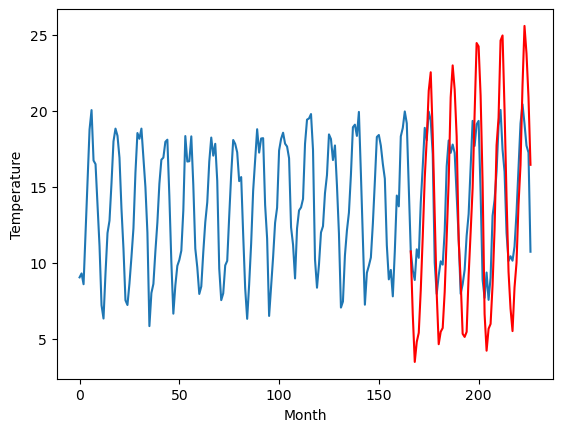

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.63		0.37		-0.26
-2.13		-1.58		0.55
-2.10		-1.50		0.60
-1.66		-1.65		0.01
1.92		3.23		1.31
3.36		5.30		1.94
8.92		11.10		2.18
15.90		16.98		1.08
19.85		20.84		0.99
18.67		19.08		0.41
14.33		14.76		0.43
9.01		8.34		-0.67
4.94		4.07		-0.87
-1.40		-1.79		-0.39
-4.42		-3.55		0.87
-4.54		-5.35		-0.81
0.46		2.58		2.12
5.08		6.42		1.34
9.91		11.01		1.10
15.78		17.33		1.55
17.92		18.88		0.96
18.54		18.92		0.38
15.22		14.65		-0.57
10.78		9.78		-1.00
1.86		0.77		-1.09
0.26		0.39		0.13
-6.29		-6.34		-0.05
-3.53		-3.41		0.12
0.43		1.80		1.37
4.72		5.76		1.04
10.51		12.63		2.12
14.83		16.72		1.89
19.38		20.15		0.77
19.30		19.06		-0.24
14.39		14.77		0.38
8.13		8.28		0.15
4.17		2.98		-1.19
-2.19		-2.42		-0.23
-0.21		-0.00		0.21
-1.94		0.16		2.10
0.03		1.51		1.48
6.08		7.84		1.76
9.72		12.27		2.55
13.71		15.92		2.21
19.39		20.16		0.77
17.14		18.75		1.61
14.57		15.14		0.57
9.14		9.61		0.47
1.29		2.56		1.27


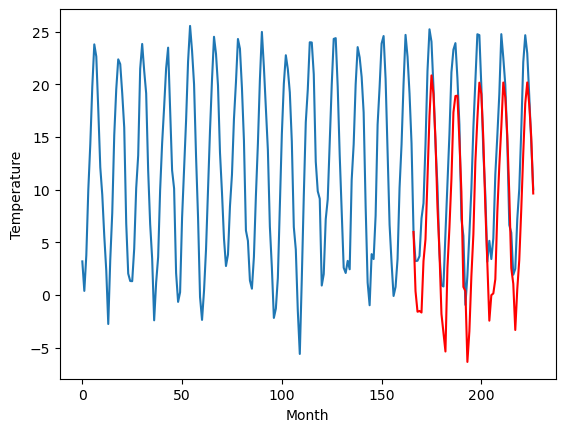

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-5.87		0.59
-9.42		-7.59		1.83
-9.01		-7.68		1.33
-8.09		-7.86		0.23
-3.68		-2.67		1.01
-1.74		-0.79		0.95
4.03		4.91		0.88
10.75		10.92		0.17
14.52		14.64		0.12
12.65		12.70		0.05
7.68		8.46		0.78
2.19		2.05		-0.14
-2.09		-2.07		0.02
-8.91		-8.19		0.72
-10.47		-10.00		0.47
-11.27		-11.98		-0.71
-4.08		-3.46		0.62
0.79		0.17		-0.62
5.05		4.76		-0.29
11.22		10.95		-0.27
12.86		12.45		-0.41
12.59		12.60		0.01
8.33		8.36		0.03
4.21		3.68		-0.53
-6.01		-5.73		0.28
-6.42		-5.57		0.85
-13.40		-12.86		0.54
-9.59		-9.84		-0.25
-4.41		-4.51		-0.10
-0.59		-0.49		0.10
6.19		6.54		0.35
10.18		10.54		0.36
13.96		13.63		-0.33
13.09		12.39		-0.70
7.86		8.19		0.33
0.25		1.65		1.40
-2.87		-3.38		-0.51
-9.90		-8.87		1.03
-7.25		-6.41		0.84
-7.04		-6.01		1.03
-5.48		-4.74		0.74
2.09		1.47		-0.62
4.56		5.81		1.25
8.49		9.57		1.08
13.33		13.51		0.18
11.36		12.16		0.80
8.07		8.58		0.51
2.78		3.02		0.24
-5.

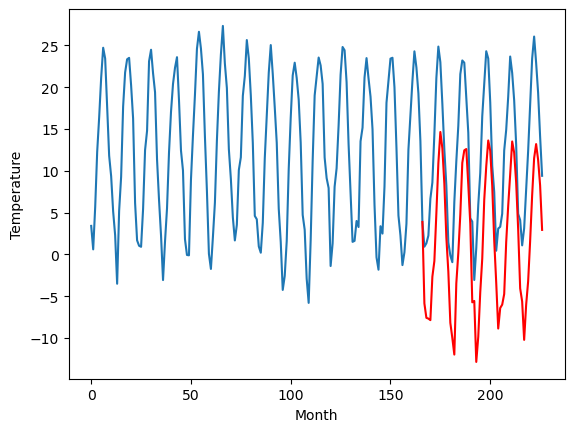

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -6.46  -5.688403
1                 1    2.22   1.712004
2                 2    2.71   4.111882
3                 3   -2.86  -1.449124
4                 4    3.31  -1.541714
5                 5   -5.82  -4.612864
6                 6   -6.46   1.172613
7                 7  -13.16 -11.226631
8                 8    5.28   6.599072
9                 9    0.63   0.371700
10               10   -6.46  -5.868099


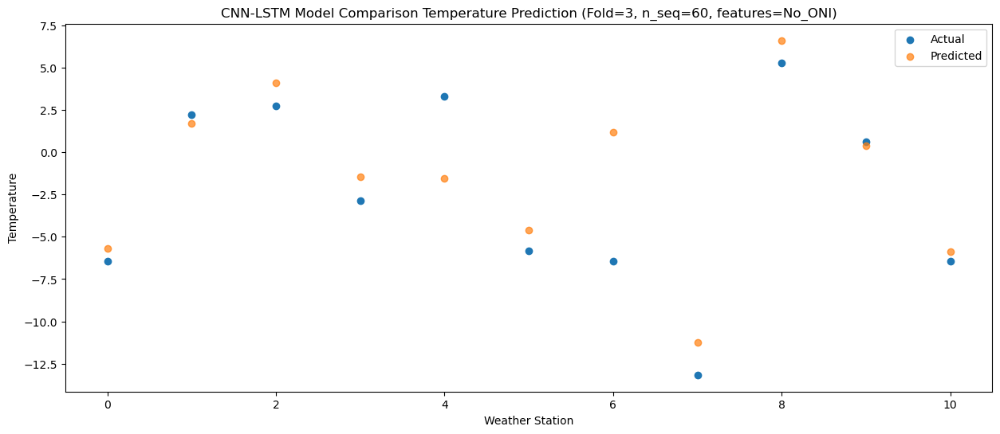

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -7.24  -6.507659
1                 1    0.87   0.162854
2                 2    0.18   0.685786
3                 3   -2.85  -2.605290
4                 4    0.05  -3.011891
5                 5   -5.61  -5.878985
6                 6  -12.13  -1.775876
7                 7  -17.89 -14.671455
8                 8    4.03   3.471282
9                 9   -2.13  -1.578224
10               10   -9.42  -7.588176


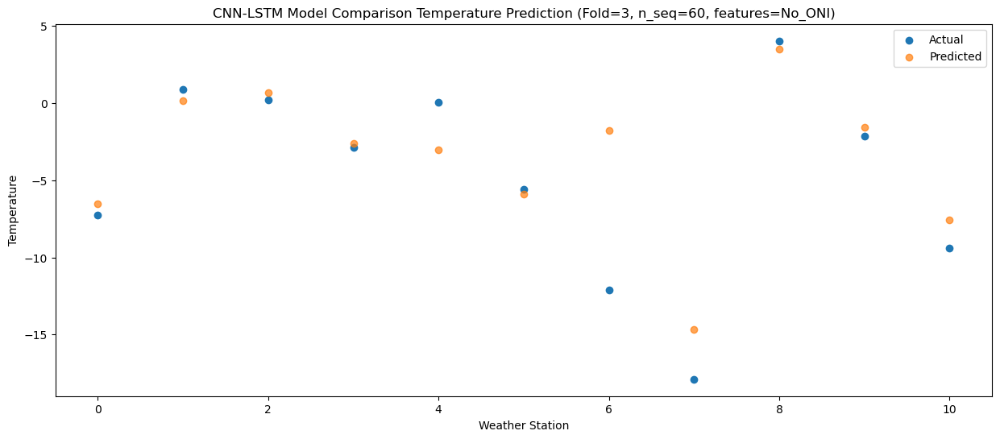

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.66  -6.841049
1                 1    0.03  -0.293045
2                 2   -1.04   1.950225
3                 3   -3.40  -3.091651
4                 4   -2.82  -3.876360
5                 5   -7.03  -6.613216
6                 6  -12.22  -1.113475
7                 7  -16.73 -13.611439
8                 8    3.40   4.793296
9                 9   -2.10  -1.501959
10               10   -9.01  -7.680491


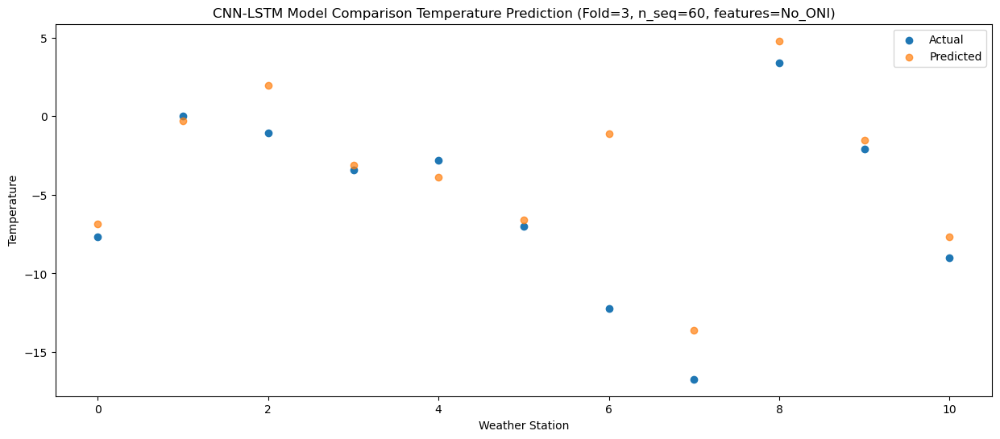

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.65  -6.701032
1                 1    0.18  -0.391635
2                 2    1.38   2.467288
3                 3   -3.75  -3.254309
4                 4   -1.67  -4.014093
5                 5   -7.44  -6.820756
6                 6  -12.03  -0.812280
7                 7  -15.22 -13.170943
8                 8    5.42   5.388403
9                 9   -1.66  -1.649986
10               10   -8.09  -7.862110


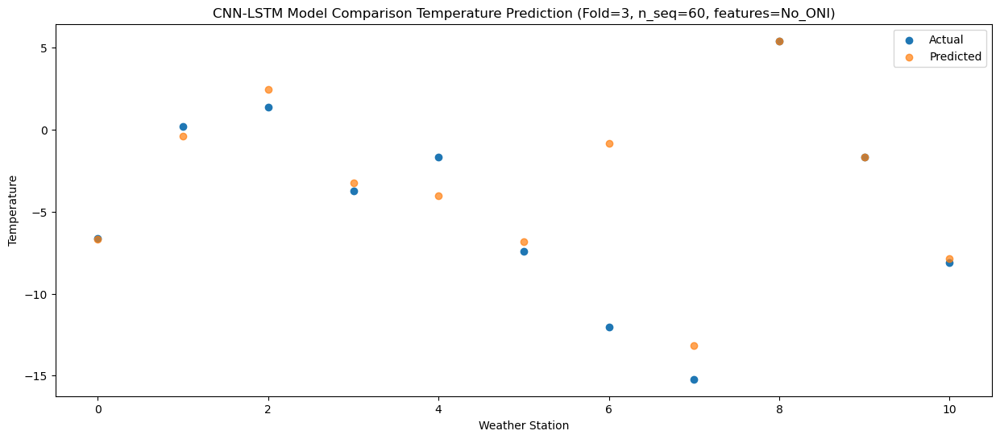

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.39  -1.193268
1                 1    7.67   6.634265
2                 2    3.17   5.425743
3                 3    3.16   2.819063
4                 4    5.74   2.821747
5                 5   -0.58  -0.287524
6                 6   -7.10   3.500334
7                 7  -12.11  -9.747919
8                 8    4.86   8.187311
9                 9    1.92   3.233095
10               10   -3.68  -2.665038


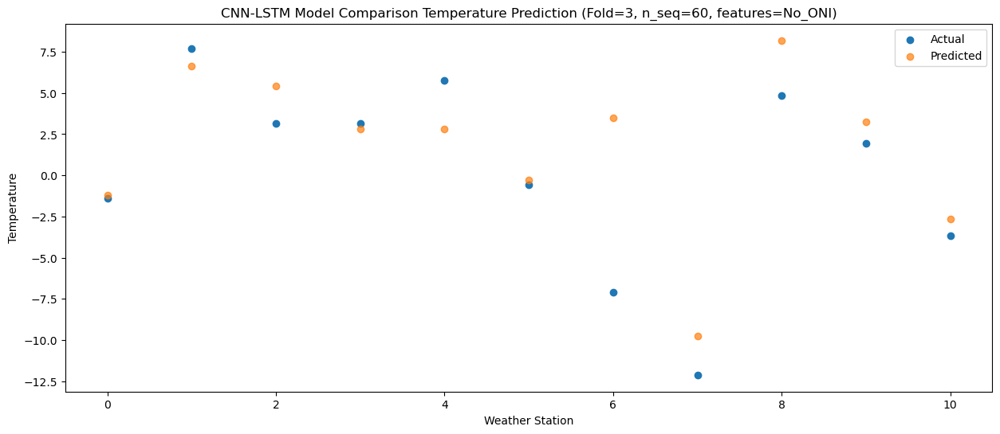

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -0.32   0.119205
1                 1    8.59   8.181438
2                 2    7.83   9.198232
3                 3    3.80   4.292121
4                 4    8.77   4.711532
5                 5    1.69   1.359453
6                 6   -4.12   6.691084
7                 7   -6.20  -5.979336
8                 8    8.48  11.721739
9                 9    3.36   5.296980
10               10   -1.74  -0.793264


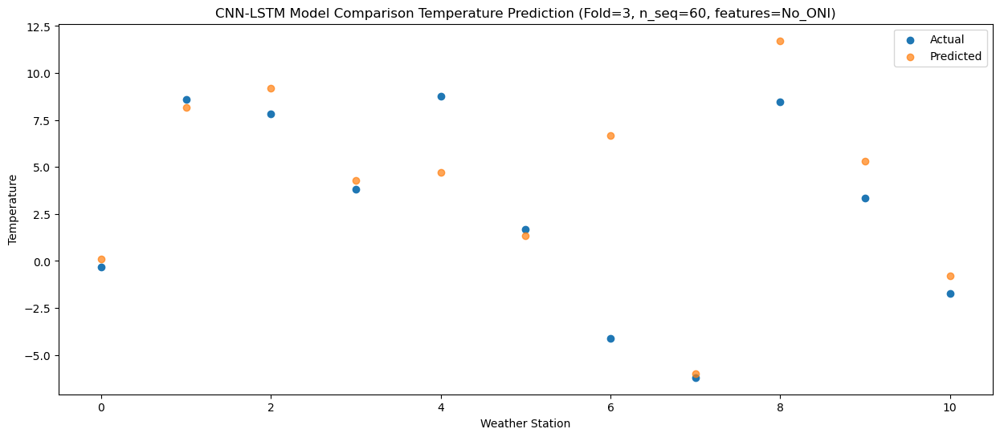

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.37   4.191224
1                 1   12.99  13.312429
2                 2   13.02  13.753803
3                 3    8.37   9.329516
4                 4   14.84  10.199002
5                 5    7.10   6.698104
6                 6    2.99  11.707984
7                 7    1.07  -1.053844
8                 8   10.88  15.583686
9                 9    8.92  11.097082
10               10    4.03   4.909345


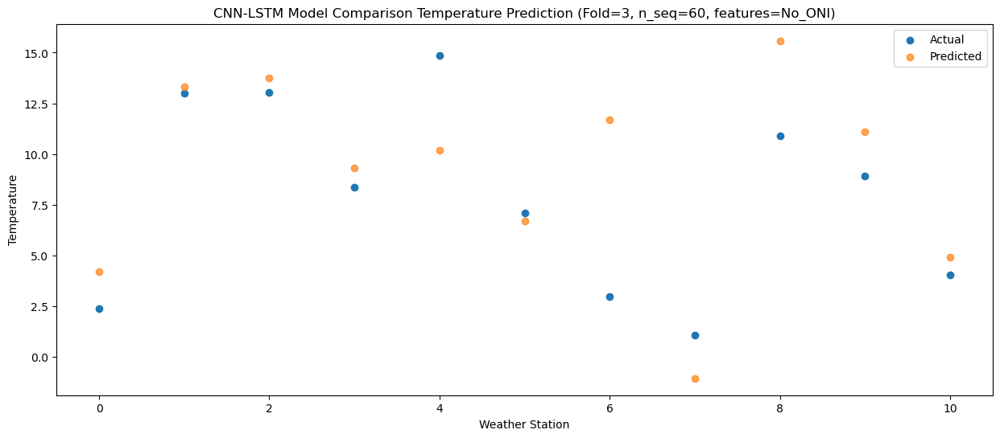

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.69   9.000669
1                 1   20.09  18.934885
2                 2   16.37  16.910050
3                 3   14.19  15.196276
4                 4   21.89  16.767854
5                 5   14.09  13.062308
6                 6    7.20  15.909495
7                 7    4.53   2.574929
8                 8   13.42  18.129315
9                 9   15.90  16.981134
10               10   10.75  10.916571


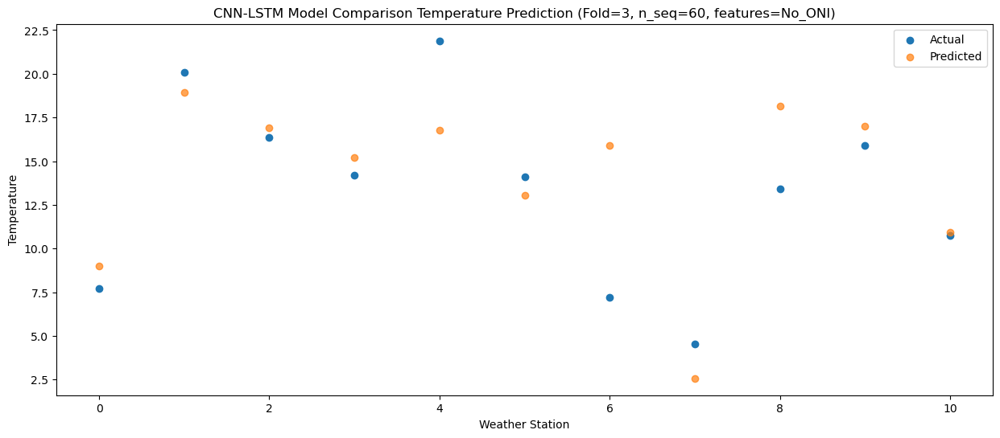

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.55  11.943601
1                 1   21.95  21.020186
2                 2   19.15  20.265045
3                 3   17.99  18.197688
4                 4   23.35  19.209271
5                 5   15.98  15.827608
6                 6    9.19  18.914972
7                 7    8.76   5.801825
8                 8   12.61  21.332075
9                 9   19.85  20.837786
10               10   14.52  14.642016


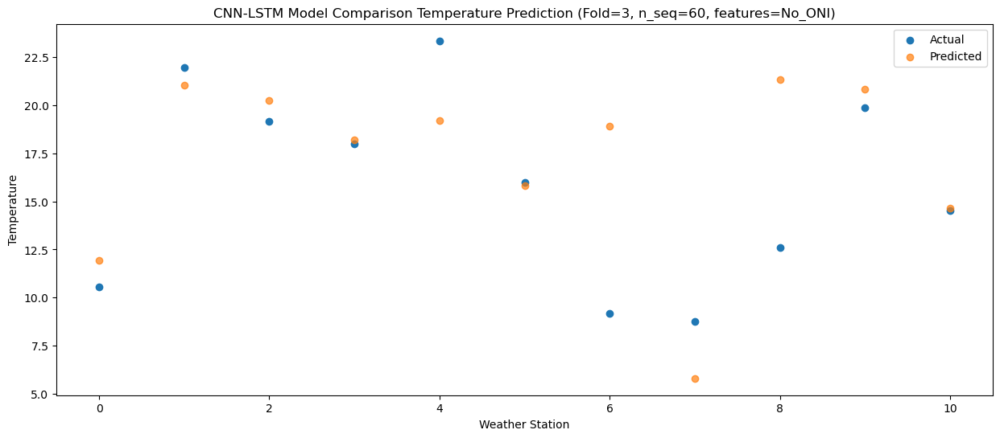

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.32  10.552876
1                 1   20.09  19.718011
2                 2   19.68  21.232507
3                 3   15.57  16.264744
4                 4   20.79  17.205507
5                 5   13.47  13.705296
6                 6    9.94  19.103841
7                 7    8.87   6.538420
8                 8   14.49  22.552005
9                 9   18.67  19.083615
10               10   12.65  12.702547


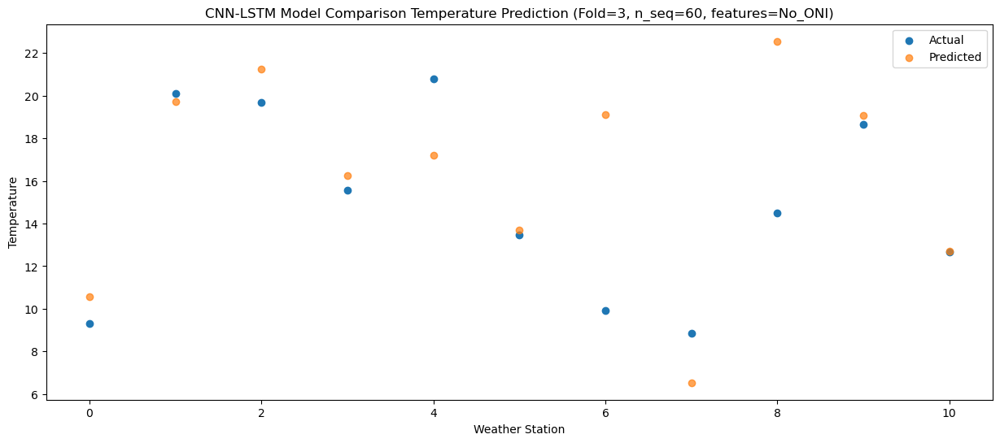

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    5.35   7.173552
1                 1   16.42  14.901423
2                 2   15.35  16.670575
3                 3   11.51  12.228673
4                 4   16.72  12.475644
5                 5    9.84   9.332288
6                 6    4.44  14.228357
7                 7    4.06   1.644724
8                 8   13.91  18.467134
9                 9   14.33  14.758535
10               10    7.68   8.457717


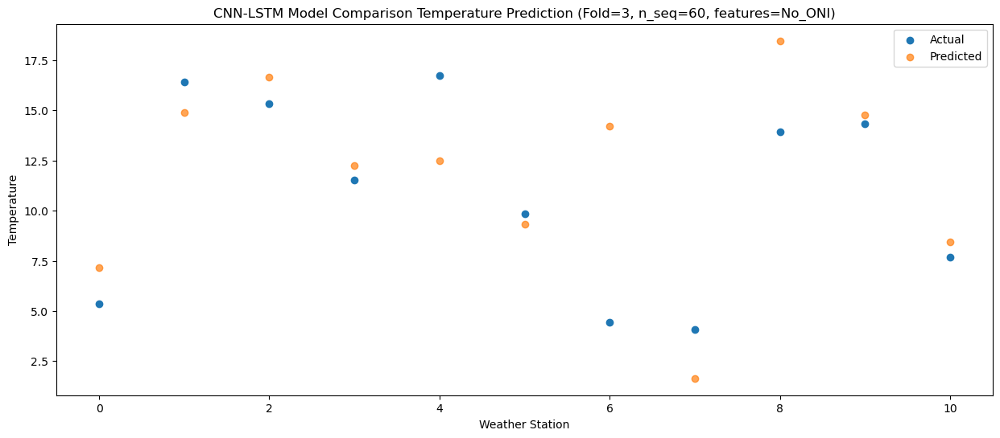

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    1.78   2.022399
1                 1    9.31   7.818164
2                 2    9.86  10.624786
3                 3    6.09   5.896408
4                 4    8.99   4.955208
5                 5    3.84   2.324693
6                 6    0.70   7.503324
7                 7   -2.88  -4.941674
8                 8   11.69  13.161875
9                 9    9.01   8.344104
10               10    2.19   2.047050


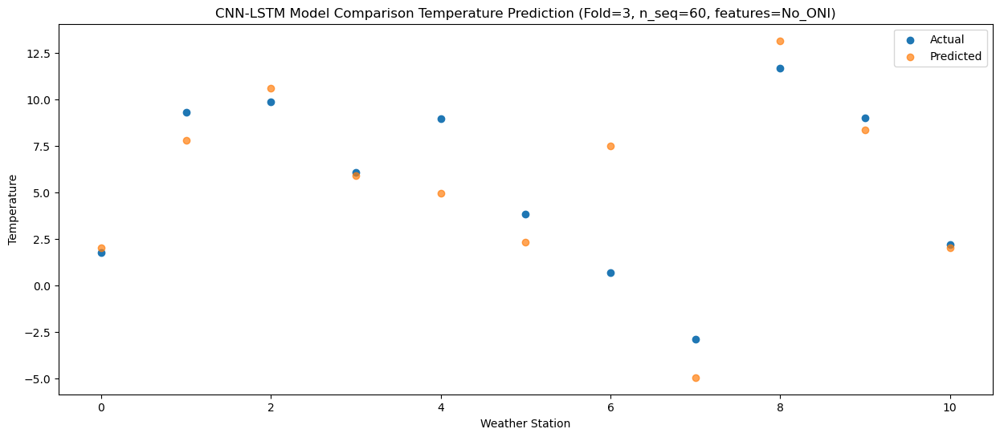

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -2.64  -1.848720
1                 1    6.49   4.577624
2                 2    1.21   5.502164
3                 3    2.17   2.217367
4                 4    6.17   1.846878
5                 5   -0.10  -1.053622
6                 6   -6.49   3.021129
7                 7  -11.69  -9.824187
8                 8    4.53   7.975062
9                 9    4.94   4.073087
10               10   -2.09  -2.068065


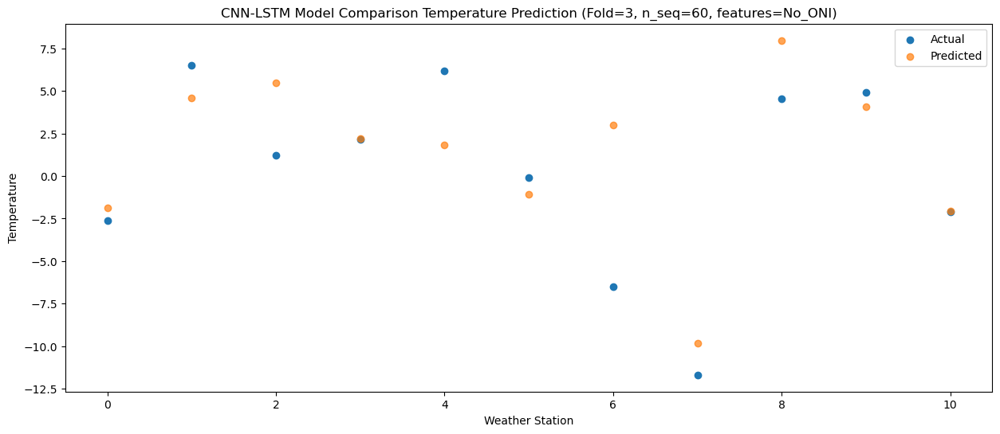

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -9.82  -8.240721
1                 1   -0.06  -1.505214
2                 2   -1.99   2.170716
3                 3   -5.03  -4.266700
4                 4   -1.00  -4.680740
5                 5   -7.71  -7.648036
6                 6  -12.19  -1.181836
7                 7  -17.38 -13.355999
8                 8    2.48   4.637843
9                 9   -1.40  -1.790223
10               10   -8.91  -8.187720


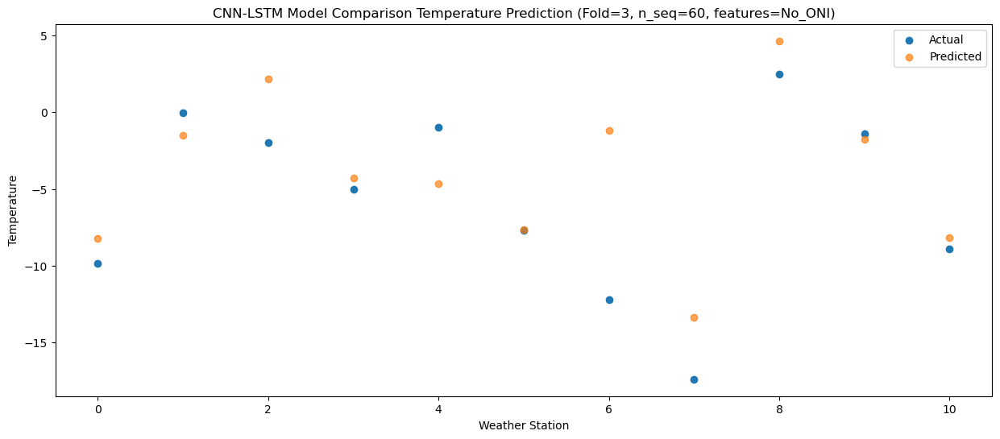

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -10.10  -9.143677
1                 1   -1.21  -2.405435
2                 2   -0.73   2.685596
3                 3   -6.49  -5.729240
4                 4   -2.47  -6.126686
5                 5   -9.16  -9.212335
6                 6  -11.92  -1.223647
7                 7  -16.83 -13.040053
8                 8    3.70   5.456157
9                 9   -4.42  -3.554110
10               10  -10.47  -9.995605


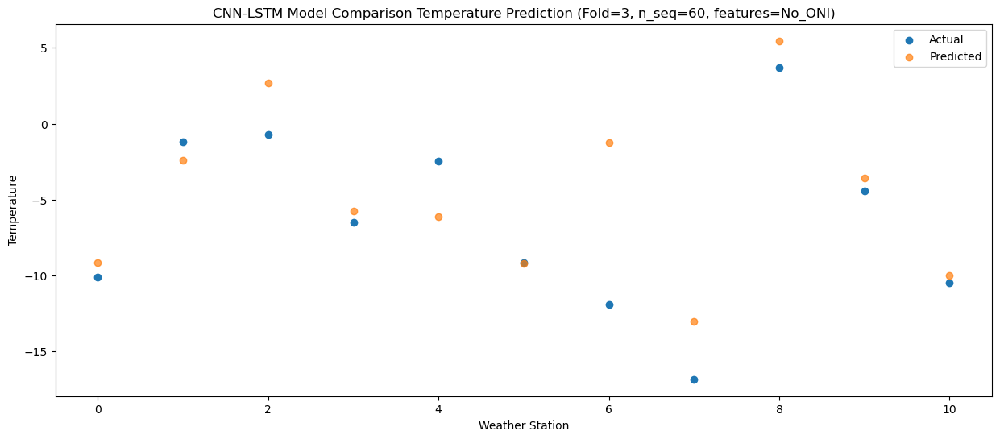

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.73 -10.294459
1                 1   -4.93  -6.698419
2                 2    1.57   2.180670
3                 3   -7.81  -8.295100
4                 4   -6.34 -10.532977
5                 5  -11.88 -12.767864
6                 6  -11.82  -3.299064
7                 7  -13.98 -14.399456
8                 8    4.63   5.704565
9                 9   -4.54  -5.348006
10               10  -11.27 -11.982924


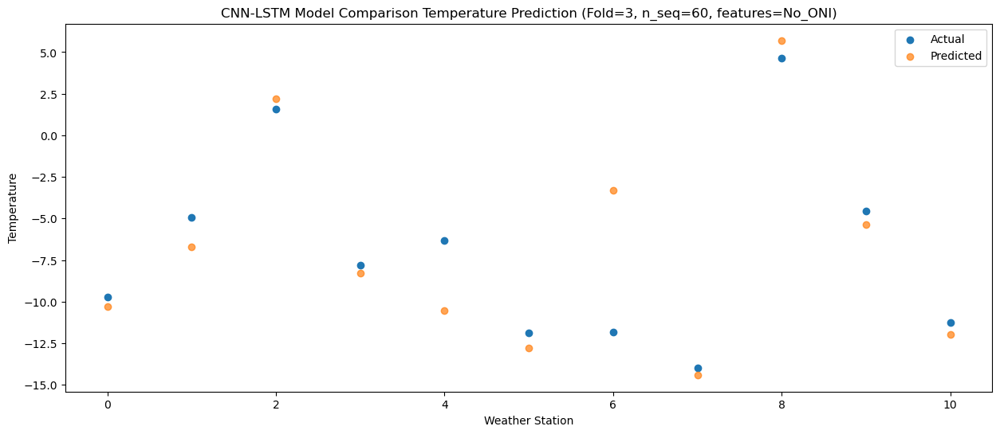

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.93  -2.374460
1                 1    7.04   5.032900
2                 2    2.72   5.489816
3                 3    2.40   1.593592
4                 4    6.74   1.703760
5                 5   -0.55  -1.498880
6                 6   -8.85   3.128753
7                 7  -12.38  -9.763879
8                 8    4.41   8.078582
9                 9    0.46   2.581384
10               10   -4.08  -3.459687


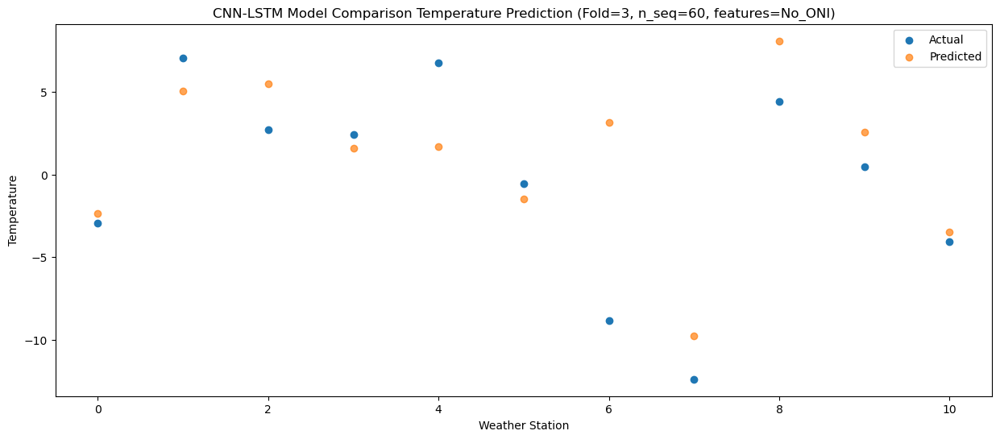

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.23  -0.007776
1                 1    8.90   6.979916
2                 2    8.45   9.446795
3                 3    4.75   4.282137
4                 4   10.03   4.260341
5                 5    2.90   1.156448
6                 6   -4.07   6.548800
7                 7   -4.41  -5.874979
8                 8    6.60  11.698773
9                 9    5.08   6.416155
10               10    0.79   0.169595


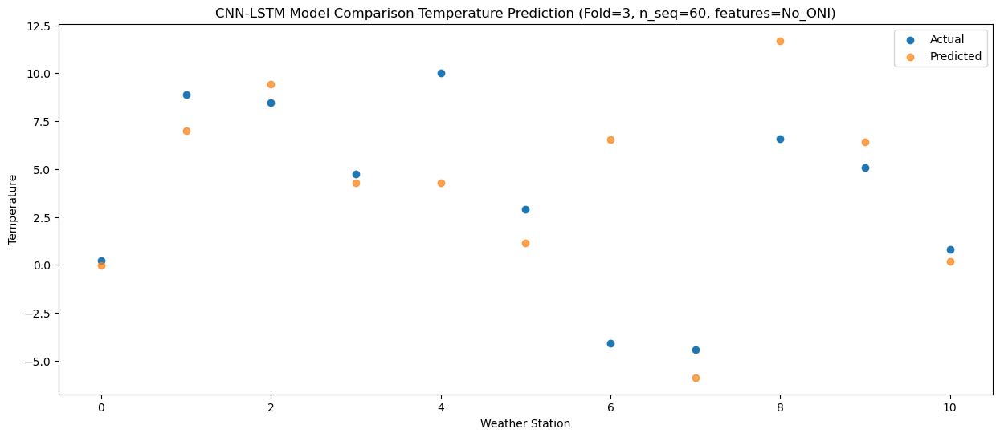

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.89   4.026015
1                 1   13.12  11.527679
2                 2   13.25  13.457309
3                 3    8.82   8.731700
4                 4   14.60   9.010468
5                 5    7.18   5.781220
6                 6    0.98  10.887065
7                 7    0.02  -1.655149
8                 8   10.89  15.390553
9                 9    9.91  11.014001
10               10    5.05   4.760837


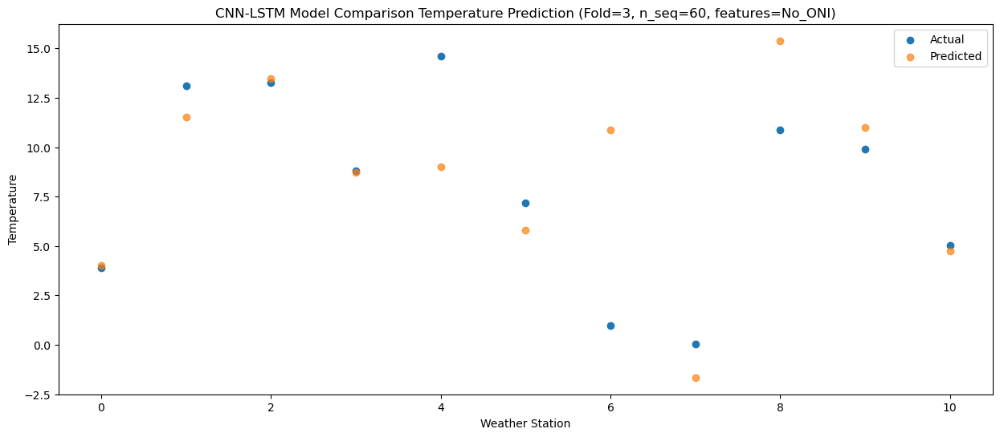

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.95   8.633974
1                 1   19.83  17.587323
2                 2   18.10  19.686096
3                 3   14.74  14.394624
4                 4   22.08  15.501859
5                 5   13.89  11.913813
6                 6    8.37  17.362930
7                 7    7.66   4.946076
8                 8   12.59  20.892021
9                 9   15.78  17.334294
10               10   11.22  10.952916


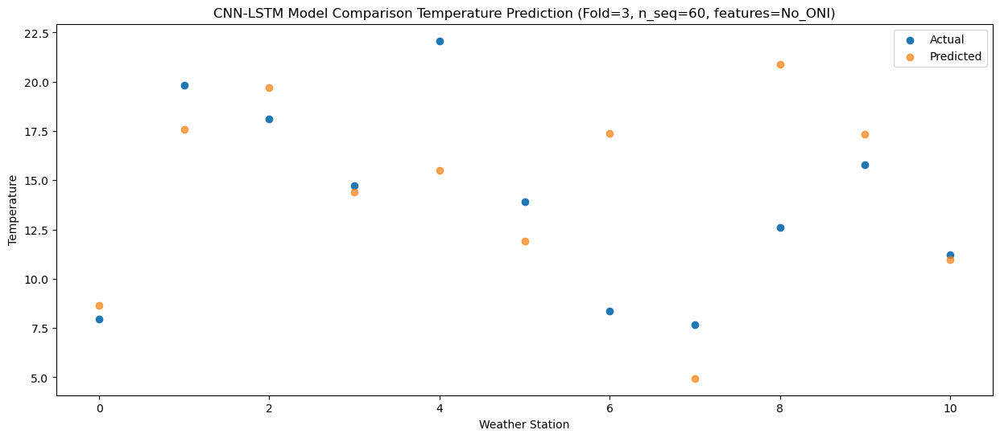

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.66  10.284643
1                 1   21.14  18.995766
2                 2   21.23  21.786462
3                 3   15.73  15.793318
4                 4   22.08  16.694715
5                 5   14.27  13.160419
6                 6   10.21  19.258792
7                 7    8.74   6.976571
8                 8   11.77  23.004704
9                 9   17.92  18.884168
10               10   12.86  12.452976


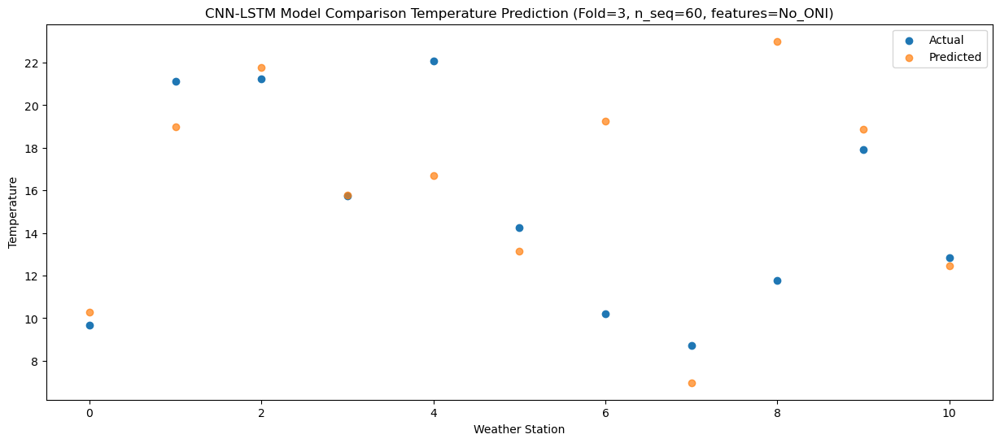

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.88  10.351894
1                 1   21.71  18.837842
2                 2   19.03  20.185143
3                 3   16.25  15.971858
4                 4   22.20  16.653071
5                 5   14.59  13.285977
6                 6    8.29  18.064026
7                 7    7.51   5.415831
8                 8   12.32  21.415084
9                 9   18.54  18.916415
10               10   12.59  12.602073


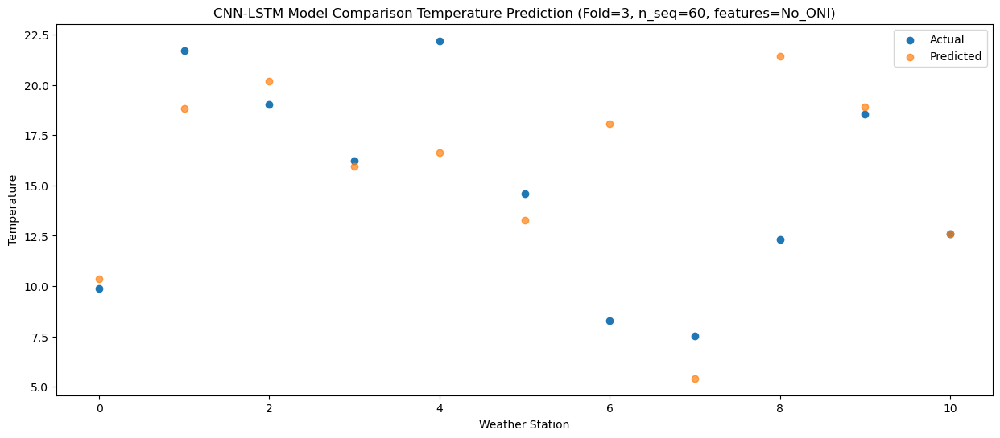

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.89   6.793320
1                 1   18.98  15.450776
2                 2   15.72  16.879387
3                 3   12.12  12.075903
4                 4   18.84  12.827331
5                 5   11.33   9.352227
6                 6    6.42  14.643036
7                 7    3.54   2.046678
8                 8   11.77  18.330599
9                 9   15.22  14.651061
10               10    8.33   8.355712


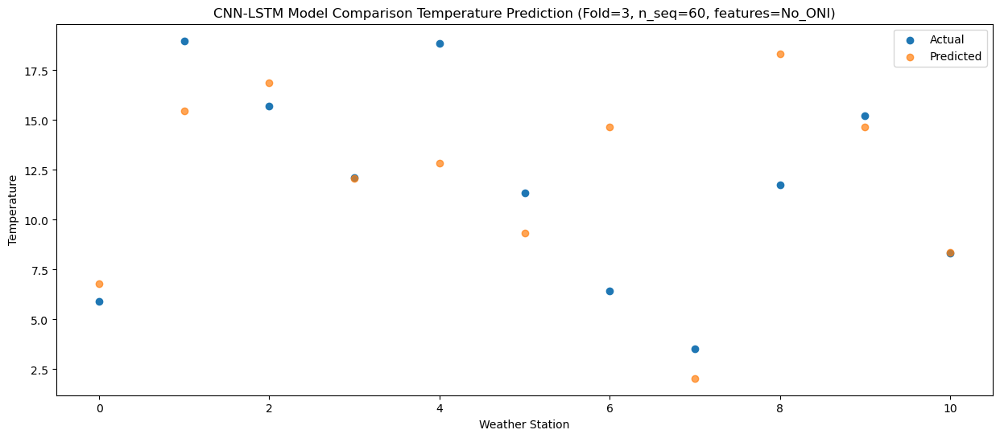

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    2.66   2.691833
1                 1   12.38   9.559851
2                 2    7.06   9.644812
3                 3    8.54   7.521452
4                 4   13.42   7.274168
5                 5    6.75   4.394134
6                 6   -1.55   7.599545
7                 7   -6.81  -5.447086
8                 8    9.01  11.533562
9                 9   10.78   9.777844
10               10    4.21   3.681602


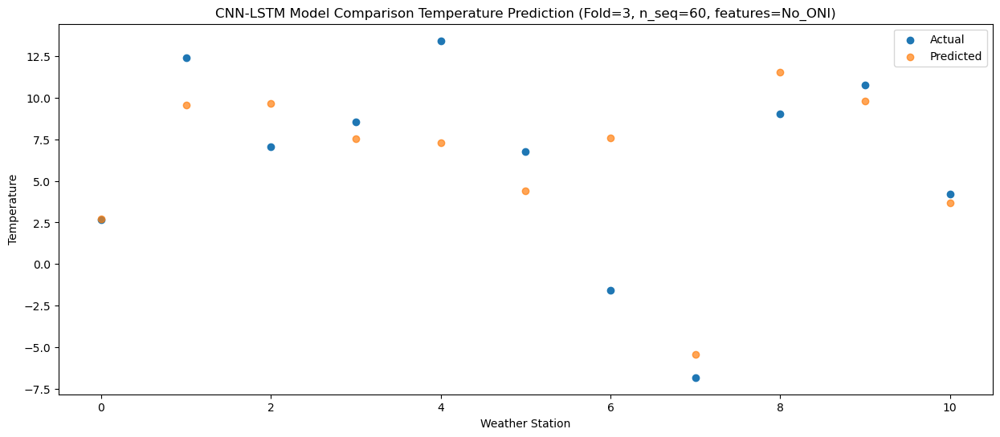

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -6.10  -6.059071
1                 1    4.67   1.321545
2                 2    2.72   6.703951
3                 3   -1.12  -2.046089
4                 4    3.68  -2.037306
5                 5   -4.10  -5.335024
6                 6   -4.29   2.942456
7                 7   -9.33  -8.761672
8                 8    6.19   8.867039
9                 9    1.86   0.771927
10               10   -6.01  -5.732776


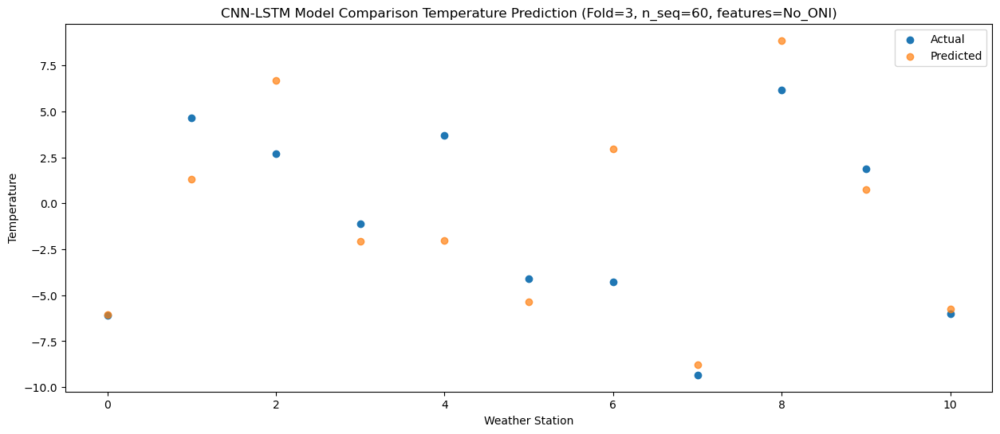

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -4.14  -4.075076
1                 1    5.98   2.320327
2                 2   -1.20   2.420073
3                 3    0.37  -0.679842
4                 4    3.32  -1.768946
5                 5   -3.05  -4.418493
6                 6   -9.05  -0.033888
7                 7  -16.60 -13.112386
8                 8    2.49   5.322932
9                 9    0.26   0.391009
10               10   -6.42  -5.568949


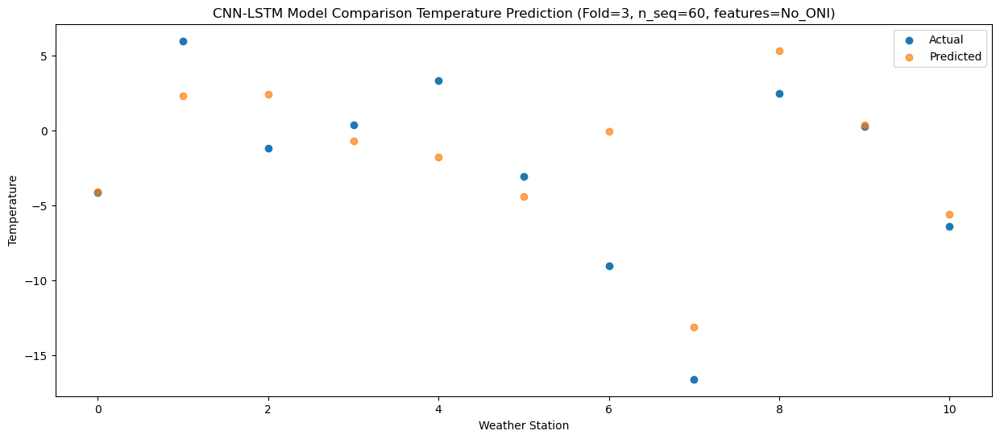

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.98 -11.233602
1                 1   -2.85  -5.310433
2                 2   -1.53   2.003857
3                 3   -8.58  -8.697991
4                 4   -6.15  -9.799142
5                 5  -11.87 -12.709478
6                 6  -11.34  -2.766028
7                 7  -16.67 -14.104192
8                 8    3.11   5.118231
9                 9   -6.29  -6.335244
10               10  -13.40 -12.861989


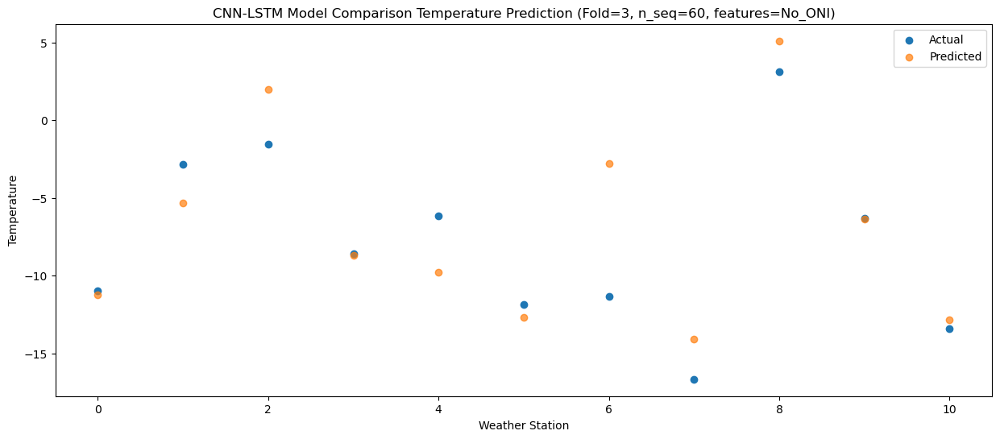

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -6.60  -8.421573
1                 1   -1.63  -4.525381
2                 2    0.17   2.212325
3                 3   -4.06  -6.055876
4                 4   -3.63  -8.033037
5                 5   -8.68 -10.366692
6                 6  -13.06  -2.492194
7                 7  -14.63 -14.087078
8                 8    4.07   5.451550
9                 9   -3.53  -3.412590
10               10   -9.59  -9.843793


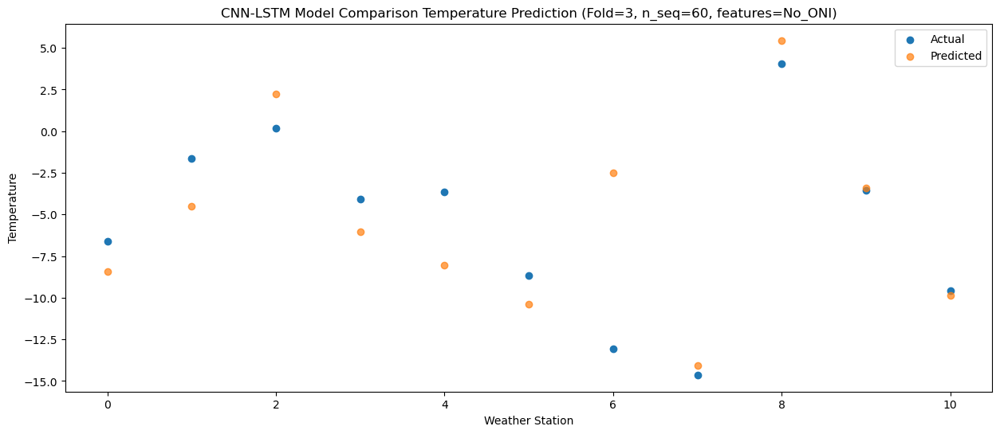

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -3.659935
1                 1    5.15   2.016190
2                 2    4.88   6.439898
3                 3    1.69  -0.406430
4                 4    4.83  -1.385994
5                 5   -1.72  -4.157322
6                 6   -8.52   2.673951
7                 7   -9.92  -9.370266
8                 8    6.30   9.168853
9                 9    0.43   1.801445
10               10   -4.41  -4.507776


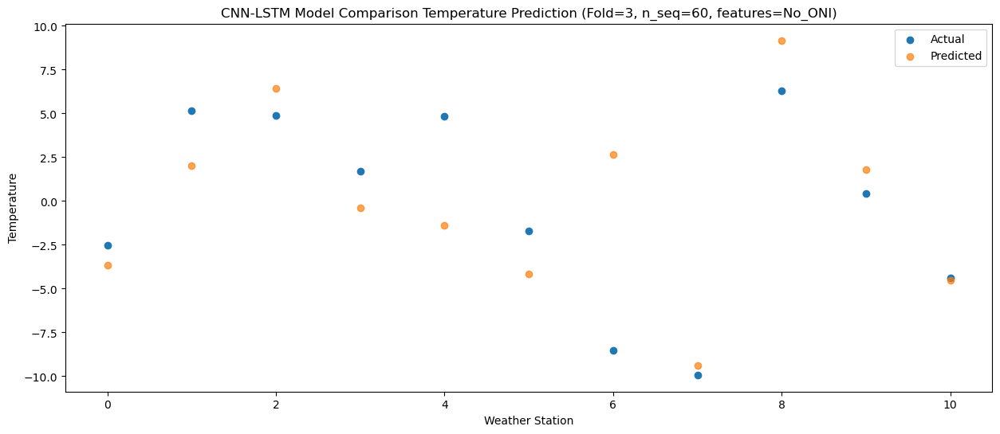

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.56  -0.093598
1                 1   10.00   7.161117
2                 2    7.95   9.551969
3                 3    4.70   3.769029
4                 4    8.96   3.273632
5                 5    2.13   0.254620
6                 6   -4.20   6.537918
7                 7   -5.29  -5.915999
8                 8    7.74  12.003717
9                 9    4.72   5.756634
10               10   -0.59  -0.491728


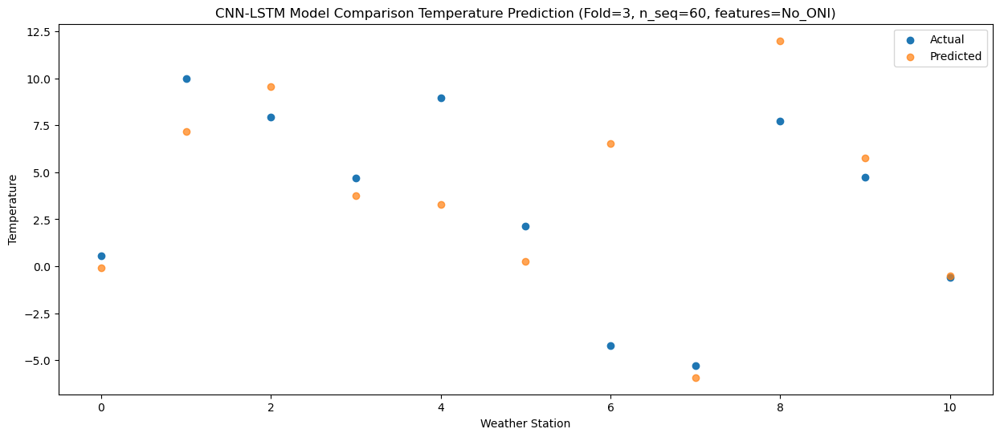

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.40   5.729226
1                 1   15.43  13.043731
2                 2   12.19  12.978360
3                 3   11.48  10.520415
4                 4   16.53  10.336896
5                 5    9.93   7.365415
6                 6    1.71  10.959230
7                 7   -0.62  -2.112222
8                 8   10.73  14.913436
9                 9   10.51  12.632835
10               10    6.19   6.540467


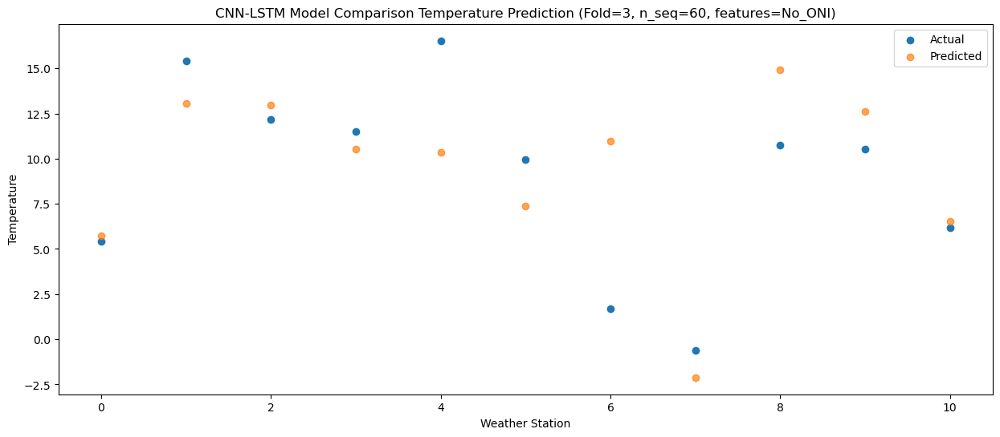

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.36   9.307225
1                 1   20.58  17.670647
2                 2   17.58  18.210485
3                 3   14.96  14.474929
4                 4   21.98  14.997208
5                 5   13.87  11.643072
6                 6    7.48  16.159159
7                 7    5.86   3.307712
8                 8   13.88  19.820413
9                 9   14.83  16.723919
10               10   10.18  10.535077


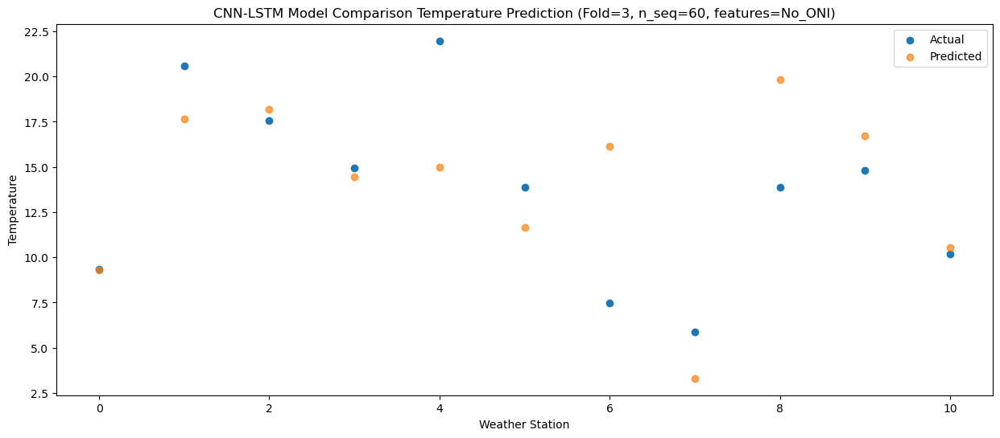

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.13  11.237563
1                 1   24.62  20.219642
2                 2   20.15  23.239704
3                 3   16.51  16.721478
4                 4   23.10  17.375352
5                 5   15.86  13.890648
6                 6    9.40  20.526343
7                 7    8.09   8.317890
8                 8   12.23  24.477007
9                 9   19.38  20.148566
10               10   13.96  13.627526


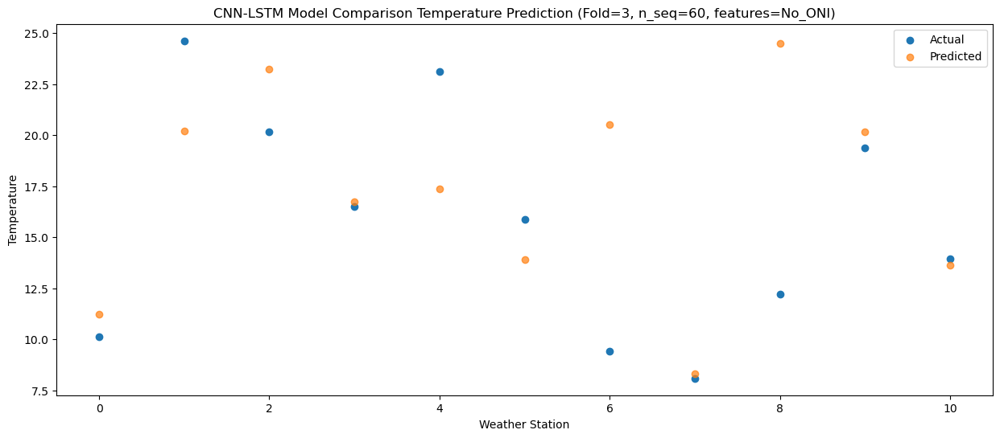

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    9.22   9.798756
1                 1   21.54  17.748182
2                 2   20.33  22.936579
3                 3   15.44  15.014308
4                 4   21.28  15.325770
5                 5   14.21  12.006355
6                 6    8.64  19.533949
7                 7    6.50   7.767949
8                 8   13.65  24.254328
9                 9   19.30  19.060869
10               10   13.09  12.393048


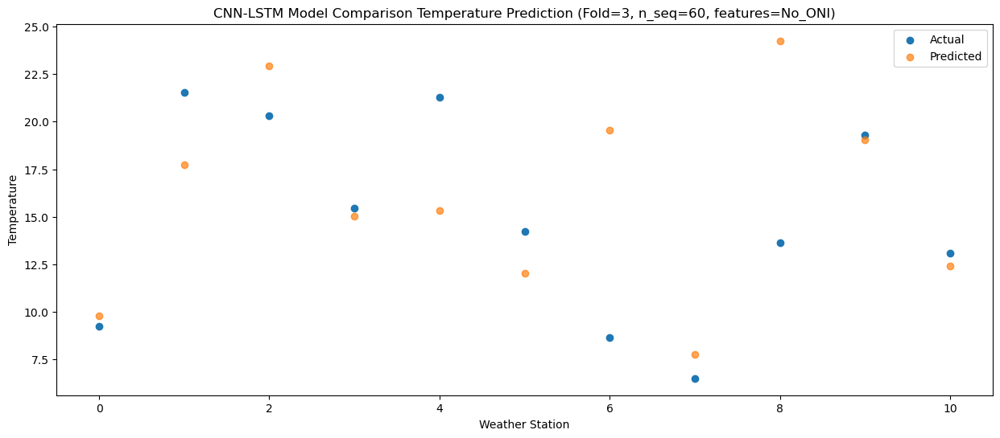

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.01   6.660258
1                 1   17.68  14.377239
2                 2   17.51  19.370081
3                 3   11.46  11.356563
4                 4   16.96  11.604419
5                 5   10.26   8.247125
6                 6    6.48  15.934708
7                 7    4.14   4.108533
8                 8   13.88  21.025656
9                 9   14.39  14.771240
10               10    7.86   8.193831


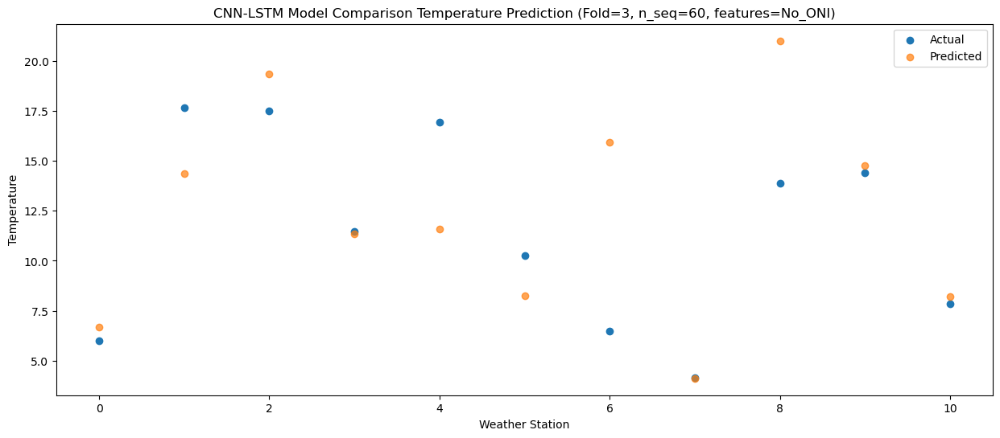

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.00   0.534295
1                 1   11.13   7.355004
2                 2   10.33  13.287305
3                 3    4.19   4.733164
4                 4    9.69   4.398909
5                 5    4.22   1.300660
6                 6   -1.78   9.413474
7                 7   -3.75  -2.247518
8                 8    9.15  15.269684
9                 9    8.13   8.275312
10               10    0.25   1.648956


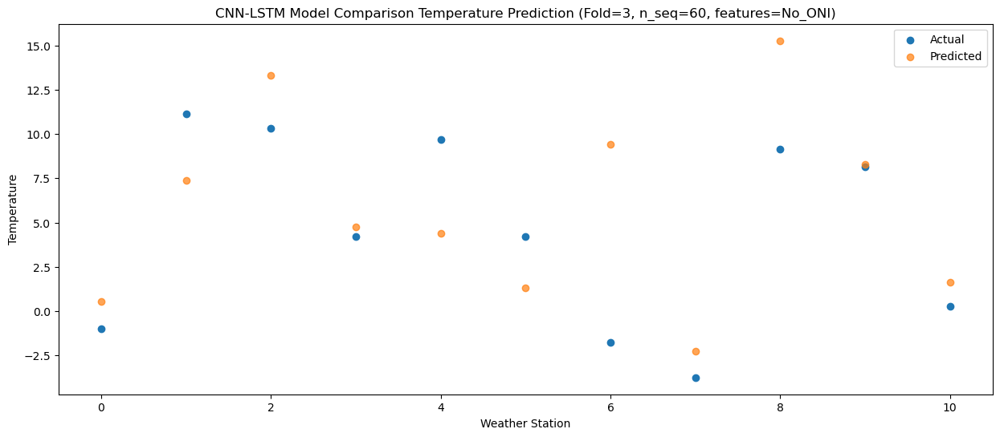

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -3.03  -3.645322
1                 1    3.90  -0.494207
2                 2   -0.40   3.966481
3                 3    1.07  -0.369770
4                 4    3.80  -2.577496
5                 5   -2.33  -4.572702
6                 6   -9.46   0.221086
7                 7  -15.17 -12.035637
8                 8    3.42   6.621759
9                 9    4.17   2.978065
10               10   -2.87  -3.384650


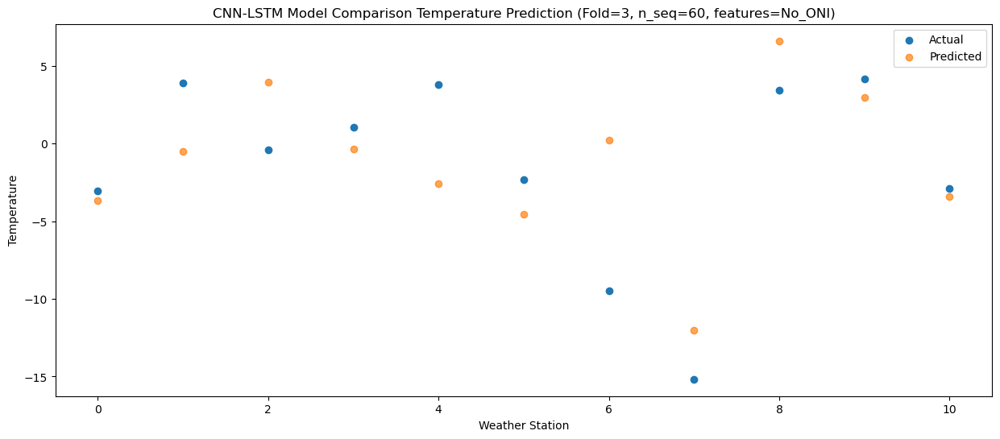

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -9.91  -8.197602
1                 1   -0.15  -4.071139
2                 2   -1.36   1.242015
3                 3   -4.20  -5.405150
4                 4   -2.17  -7.595595
5                 5   -7.87  -9.780148
6                 6  -11.63  -2.911694
7                 7  -17.50 -14.888430
8                 8    2.22   4.210723
9                 9   -2.19  -2.423255
10               10   -9.90  -8.869922


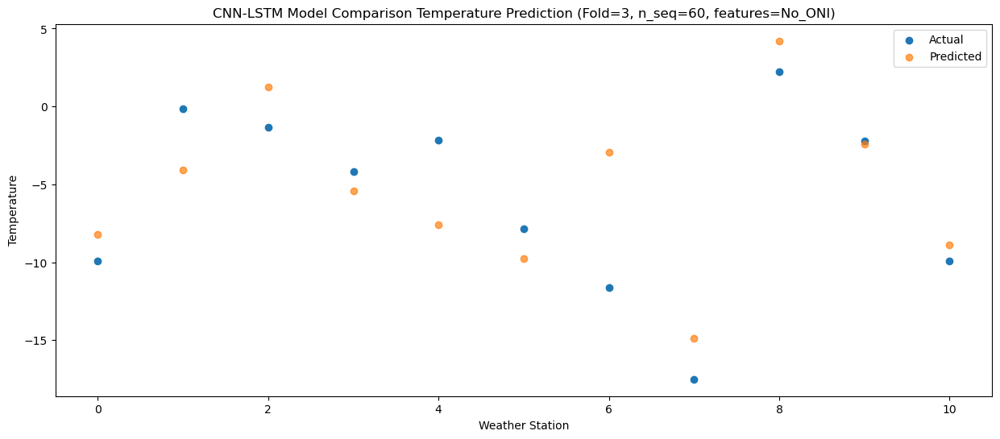

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.49  -5.926291
1                 1    0.55  -2.291244
2                 2    0.03   2.724065
3                 3   -2.45  -3.067004
4                 4   -0.45  -5.493819
5                 5   -5.73  -7.506108
6                 6  -12.36  -1.317400
7                 7  -18.01 -13.417804
8                 8    3.89   5.657556
9                 9   -0.21  -0.001630
10               10   -7.25  -6.412171


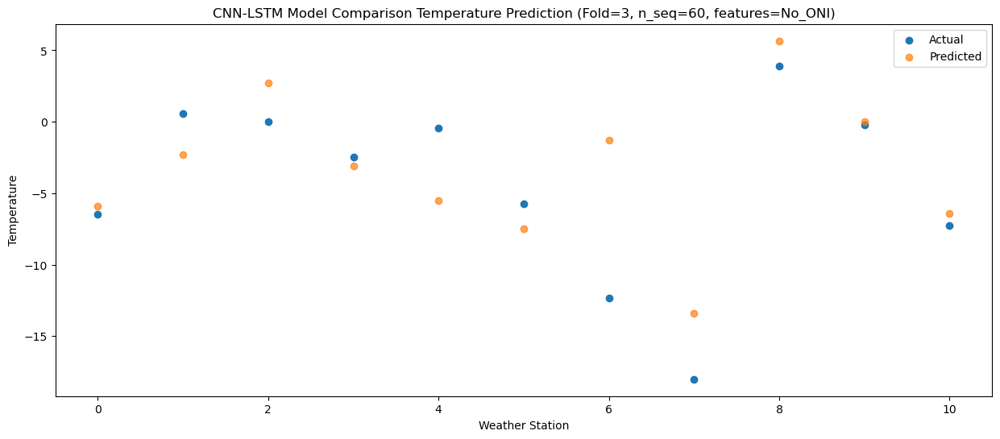

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -3.67  -4.085989
1                 1    2.51  -1.130337
2                 2   -0.82   2.642283
3                 3   -0.11  -1.826980
4                 4    6.07  -4.310543
5                 5   -4.01  -6.305181
6                 6  -12.33  -1.104594
7                 7  -17.10 -13.541624
8                 8    2.09   5.974500
9                 9   -1.94   0.161884
10               10   -7.04  -6.007698


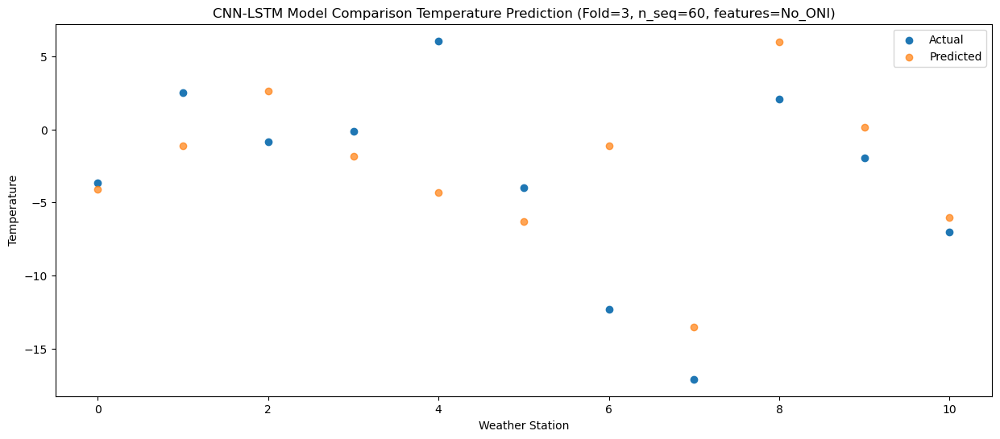

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -2.986447
1                 1    5.11   1.629634
2                 2    2.05   5.449541
3                 3    0.13  -0.413901
4                 4    3.11  -2.190450
5                 5   -3.11  -4.635870
6                 6  -10.54   1.831011
7                 7  -14.27 -10.505048
8                 8    3.55   8.536592
9                 9    0.03   1.514134
10               10   -5.48  -4.739790


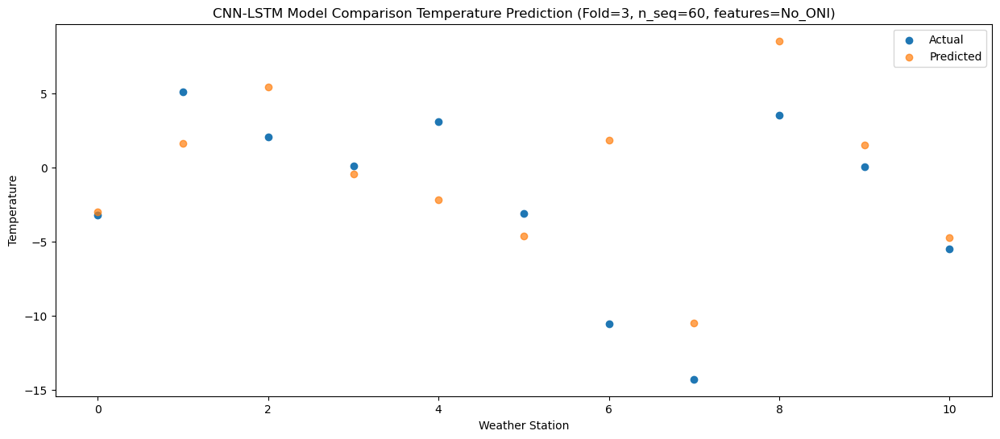

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    0.47   1.010862
1                 1   10.16   5.839632
2                 2    7.68   9.970869
3                 3    6.37   4.711209
4                 4   10.32   3.395364
5                 5    3.12   0.865284
6                 6   -5.20   6.600183
7                 7   -6.32  -5.661071
8                 8    7.63  12.217885
9                 9    6.08   7.844640
10               10    2.09   1.465976


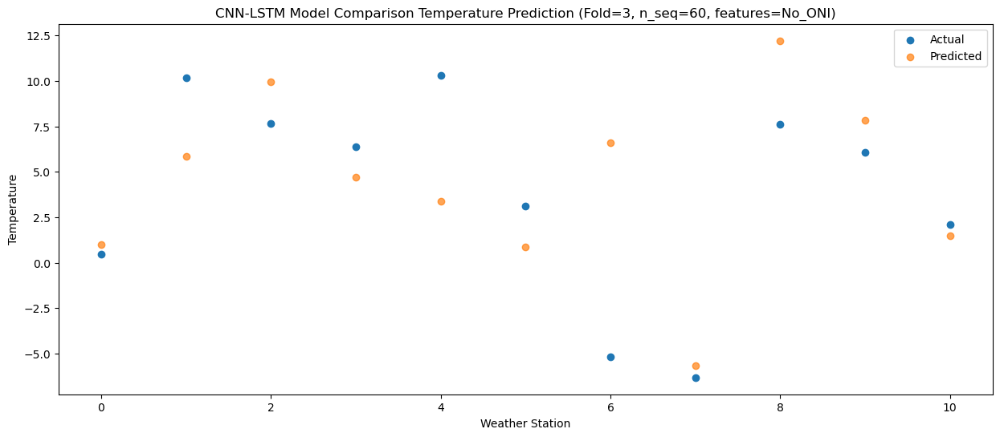

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.83   4.822669
1                 1   15.47  11.983268
2                 2   12.12  16.000776
3                 3    9.06   9.255177
4                 4   16.32   9.313573
5                 5    8.53   6.043288
6                 6    2.01  12.947785
7                 7   -0.52   0.809181
8                 8    8.66  17.737084
9                 9    9.72  12.274263
10               10    4.56   5.805719


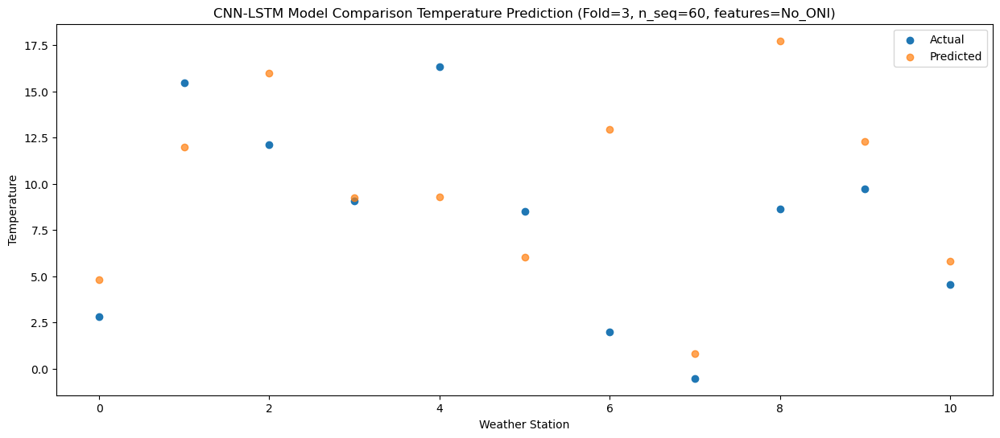

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.60   8.331733
1                 1   19.80  15.834403
2                 2   14.92  17.989036
3                 3   12.80  13.099021
4                 4   20.42  13.370461
5                 5   11.99  10.045420
6                 6    6.59  15.619279
7                 7    1.98   3.035425
8                 8   10.56  19.557487
9                 9   13.71  15.920850
10               10    8.49   9.570463


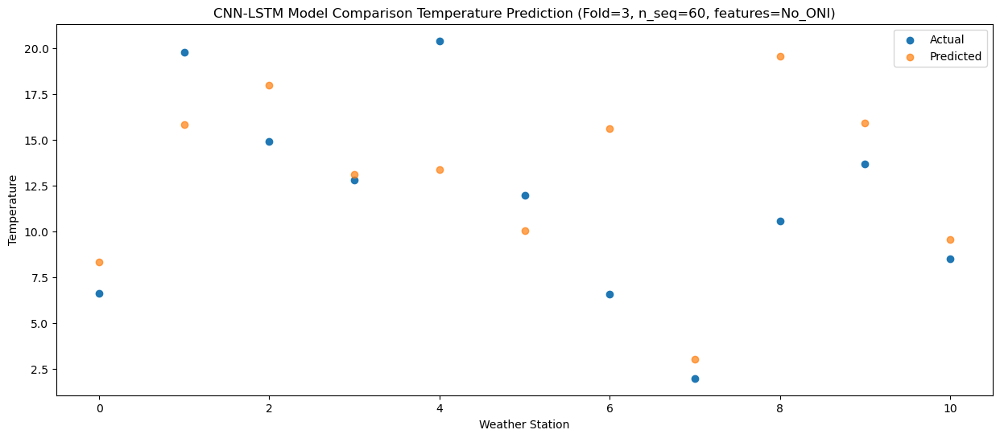

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.38  11.412097
1                 1   22.06  18.003351
2                 2   20.58  23.181544
3                 3   16.42  16.014960
4                 4   22.12  15.479994
5                 5   15.25  12.518132
6                 6   12.73  19.815713
7                 7   10.34   7.909495
8                 8   13.57  24.642352
9                 9   19.39  20.164499
10               10   13.33  13.507978


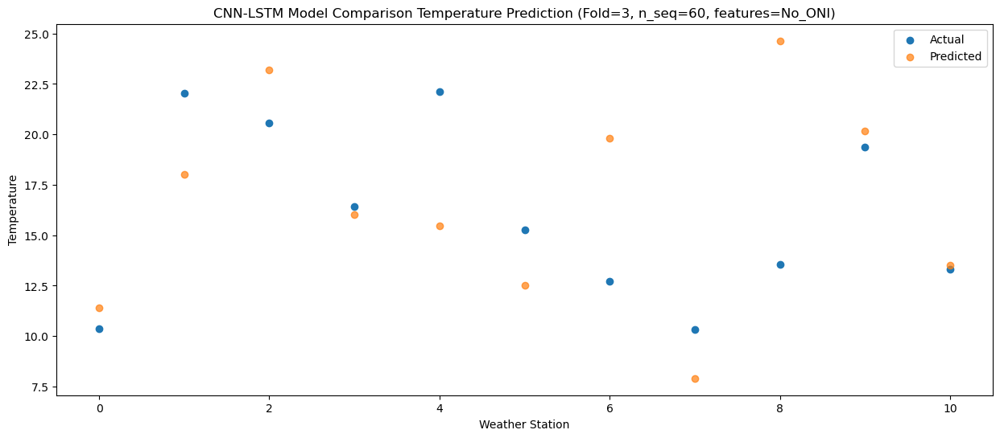

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.87  11.092489
1                 1   22.24  18.918691
2                 2   18.89  23.329742
3                 3   15.31  15.453916
4                 4   20.83  15.467457
5                 5   13.70  12.100423
6                 6   10.14  20.187034
7                 7    5.71   8.181438
8                 8   14.60  24.976678
9                 9   17.14  18.746993
10               10   11.36  12.158964


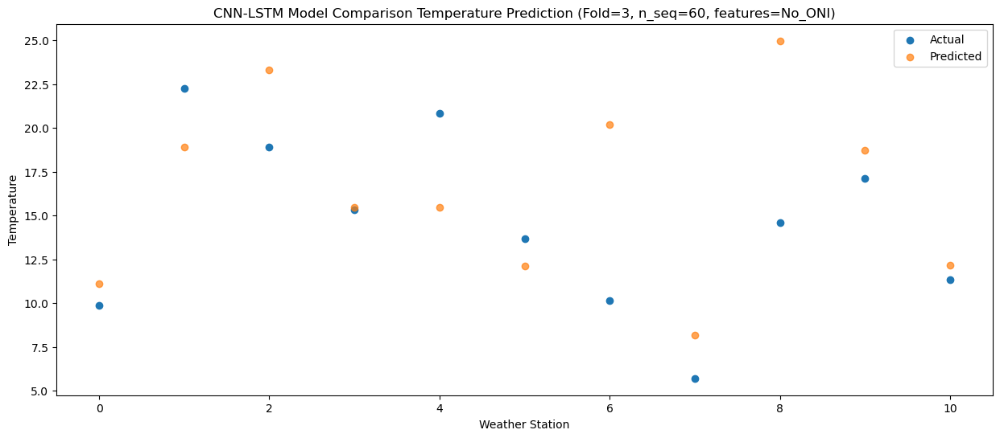

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.73   7.214078
1                 1   18.19  14.274933
2                 2   15.12  18.424652
3                 3   12.58  11.606177
4                 4   17.47  11.365725
5                 5   10.24   8.185442
6                 6    5.99  15.343539
7                 7    1.01   3.225119
8                 8   11.99  20.089407
9                 9   14.57  15.137599
10               10    8.07   8.576475


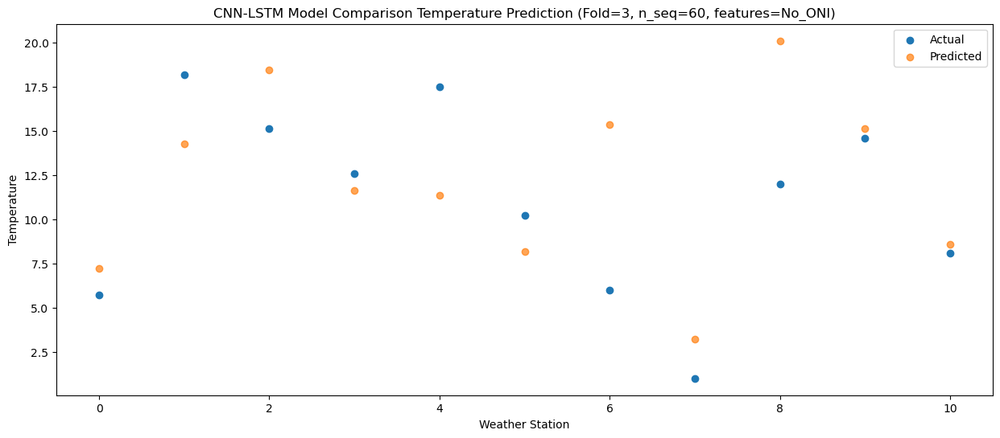

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.70   1.976210
1                 1   11.25   6.689753
2                 2    9.81  12.274909
3                 3    7.14   5.692240
4                 4   11.01   4.310039
5                 5    4.59   1.742907
6                 6   -0.14   8.578929
7                 7   -4.28  -3.357518
8                 8   10.53  14.318161
9                 9    9.14   9.609308
10               10    2.78   3.019375


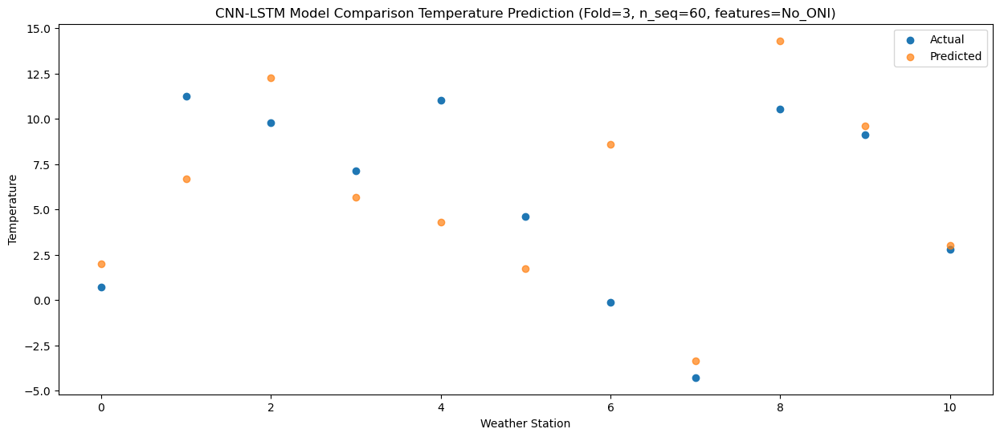

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -4.96  -4.113097
1                 1    5.47   0.389868
2                 2    2.90   7.007285
3                 3    0.75  -0.994773
4                 4    4.06  -2.454083
5                 5   -1.89  -5.085010
6                 6   -6.00   2.866989
7                 7  -12.42  -8.822359
8                 8    6.49   9.404167
9                 9    1.29   2.561442
10               10   -5.49  -4.059346


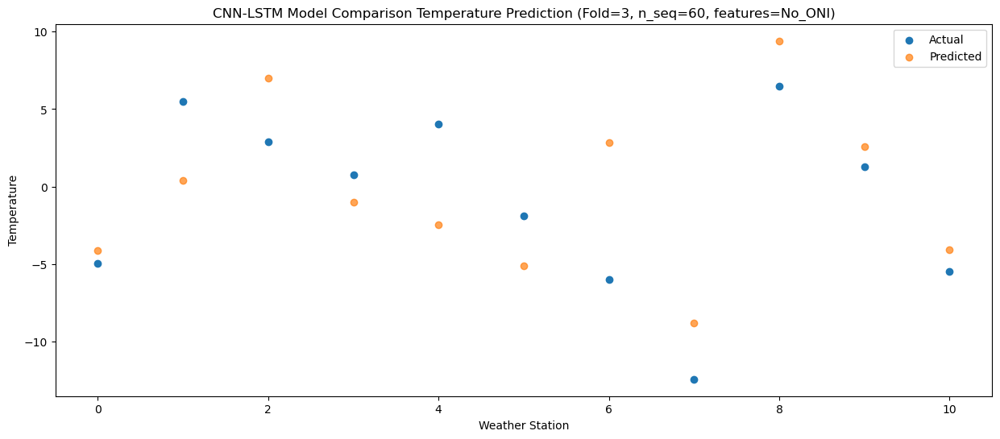

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -7.01  -6.362798
1                 1    2.12  -2.753647
2                 2    1.06   4.658808
3                 3   -1.08  -3.164140
4                 4    1.25  -5.129680
5                 5   -4.35  -7.453456
6                 6   -9.63   0.276329
7                 7  -15.55 -11.319442
8                 8    4.65   6.987275
9                 9    0.56   1.074830
10               10   -6.24  -5.632827


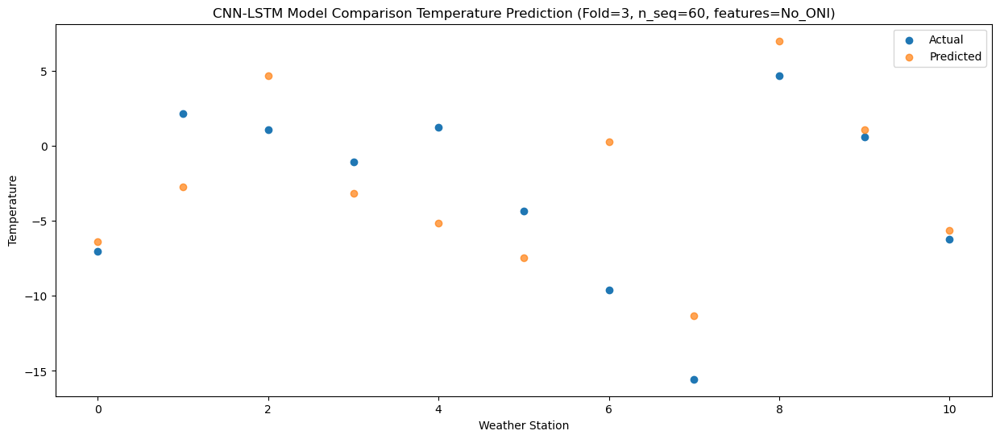

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -9.32 -10.034405
1                 1   -4.49  -8.553463
2                 2    0.85   2.578781
3                 3   -6.24  -8.109961
4                 4   -5.25 -11.274012
5                 5  -10.51 -13.137828
6                 6  -11.77  -3.221877
7                 7  -17.27 -14.050388
8                 8    4.96   5.502107
9                 9   -3.43  -3.305770
10               10   -9.26 -10.224549


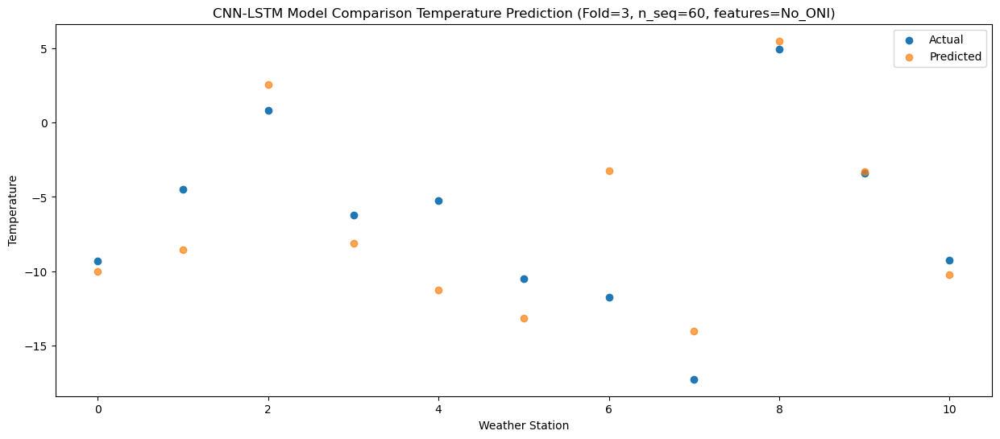

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -6.18  -5.614325
1                 1    5.16  -0.134953
2                 2    2.34   5.946602
3                 3   -0.56  -2.549998
4                 4    2.56  -3.801168
5                 5   -3.88  -6.637881
6                 6   -9.61   2.025323
7                 7  -14.91  -9.785399
8                 8    4.67   8.374005
9                 9   -2.86   0.566044
10               10   -7.22  -6.036399


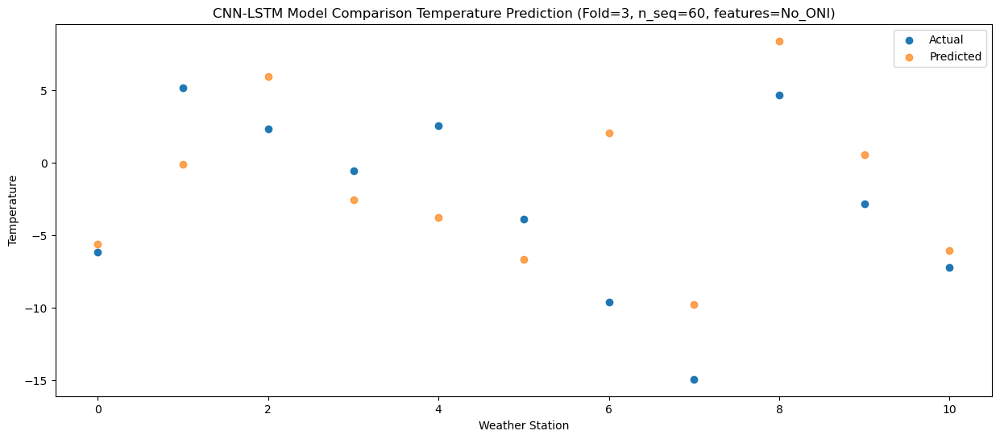

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.51  -2.695469
1                 1    7.64   1.648204
2                 2    4.37   7.423804
3                 3    3.09   0.134754
4                 4    6.67  -1.653857
5                 5    0.19  -4.172114
6                 6   -7.87   3.485048
7                 7  -11.55  -8.444138
8                 8    5.60  10.002784
9                 9    1.84   3.319367
10               10   -2.56  -3.220553


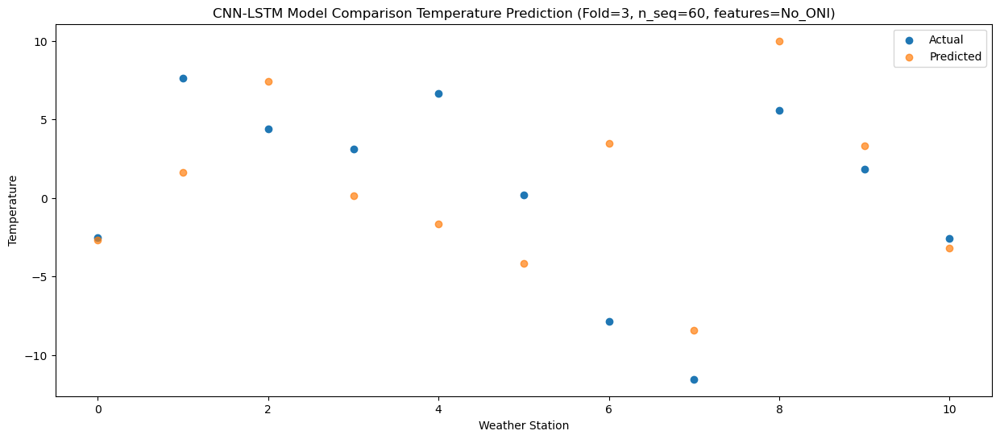

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    1.51   1.448657
1                 1   11.81   6.600488
2                 2    7.56  11.626492
3                 3    8.15   4.903172
4                 4   11.42   3.627476
5                 5    5.16   0.908743
6                 6   -2.89   8.100082
7                 7   -6.05  -3.964423
8                 8    7.83  13.836656
9                 9    4.71   8.116830
10               10    2.02   1.599841


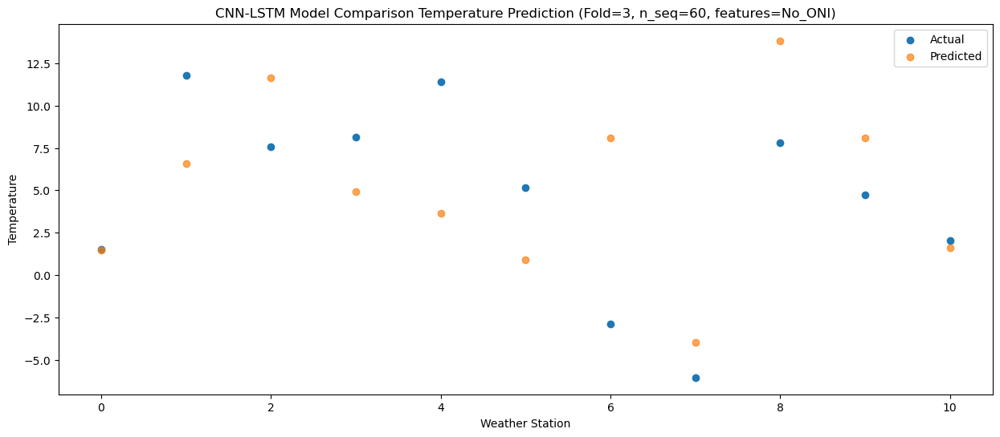

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.78   6.297825
1                 1   16.58  11.096055
2                 2   12.95  14.468019
3                 3   12.34  10.142435
4                 4   17.58   8.783020
5                 5   10.68   6.224810
6                 6    0.22  11.545646
7                 7   -0.42  -0.939233
8                 8   10.80  16.434557
9                 9   10.26  13.438901
10               10    7.69   7.029438


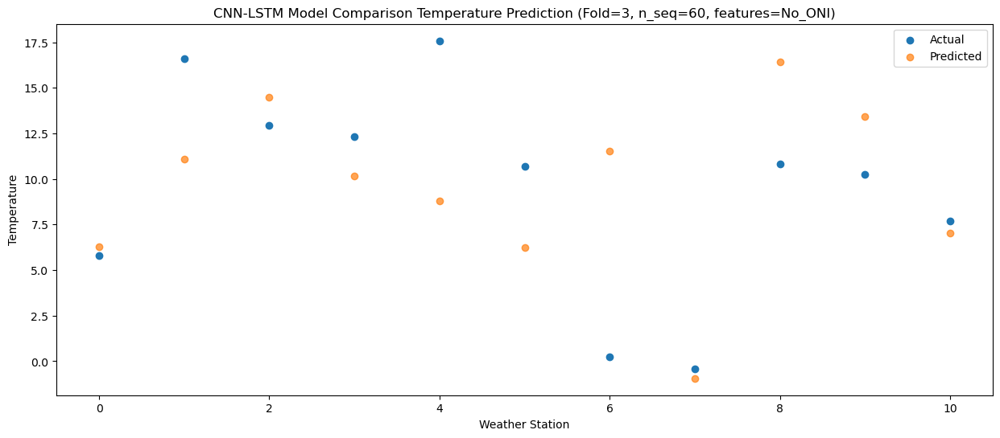

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    9.44   9.636144
1                 1   21.14  15.268980
2                 2   18.90  20.190828
3                 3   16.24  13.983686
4                 4   22.45  13.049488
5                 5   13.91  10.238265
6                 6    9.37  17.011211
7                 7    7.76   4.933161
8                 8   13.71  21.665041
9                 9   16.73  18.155328
10               10   13.06  11.510161


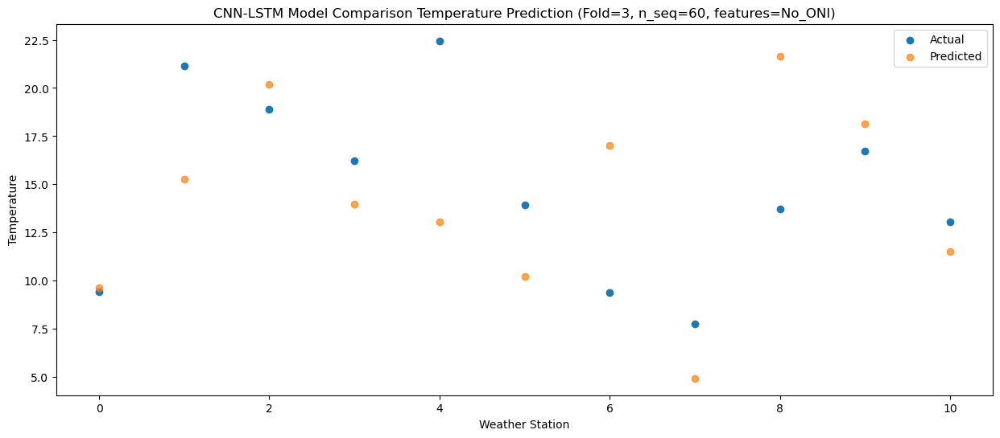

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.33  10.620133
1                 1   21.66  15.708287
2                 2   22.47  24.232663
3                 3   17.95  14.828921
4                 4   21.61  13.624649
5                 5   14.46  10.886866
6                 6   10.12  19.971438
7                 7   10.84   8.709770
8                 8   14.97  25.604401
9                 9   19.29  20.170143
10               10   15.72  13.194603


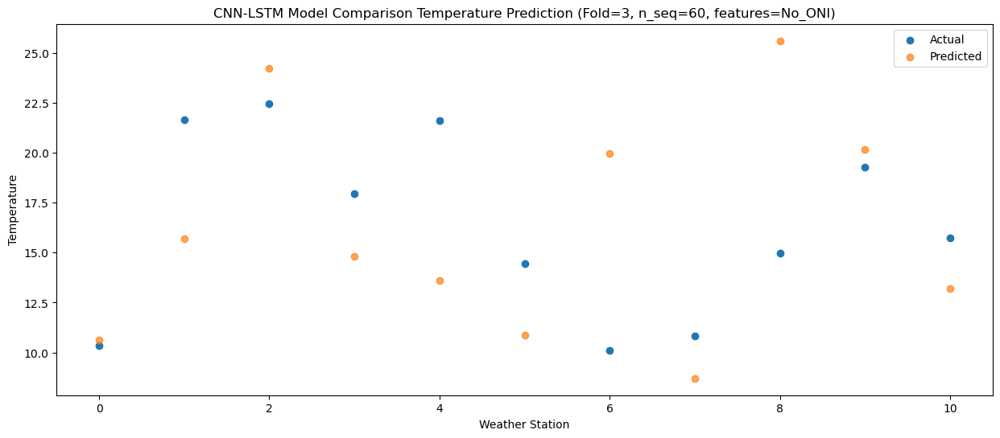

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    8.93   9.761161
1                 1   21.94  16.136533
2                 2   19.50  22.240236
3                 3   16.93  13.966476
4                 4   21.06  13.351457
5                 5   13.91  10.277213
6                 6    9.83  18.754430
7                 7    7.98   6.971097
8                 8   13.69  23.787254
9                 9   17.57  18.065039
10               10   12.58  11.309613


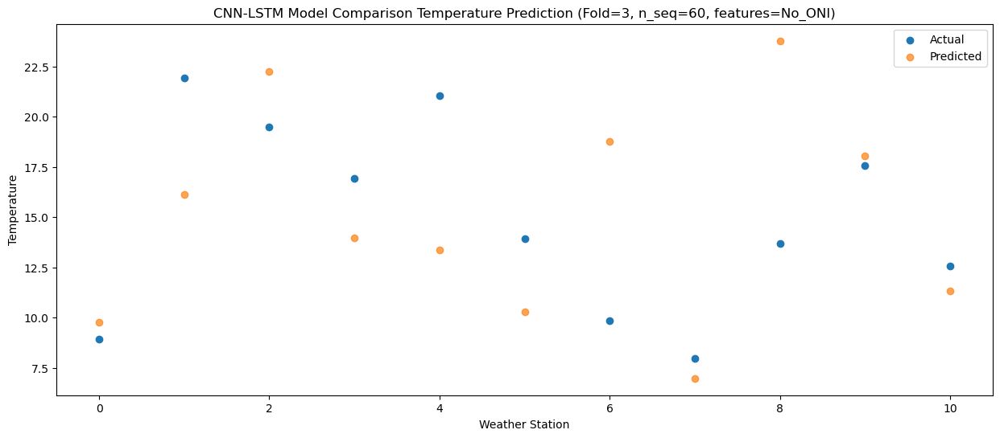

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    6.24   6.882549
1                 1   17.90  12.265419
2                 2   16.47  19.239370
3                 3   13.96  10.821963
4                 4   17.80  10.010779
5                 5   11.22   7.063256
6                 6    6.21  15.482385
7                 7    4.03   3.837769
8                 8   12.25  20.908819
9                 9   13.56  14.999855
10               10    8.99   8.244008


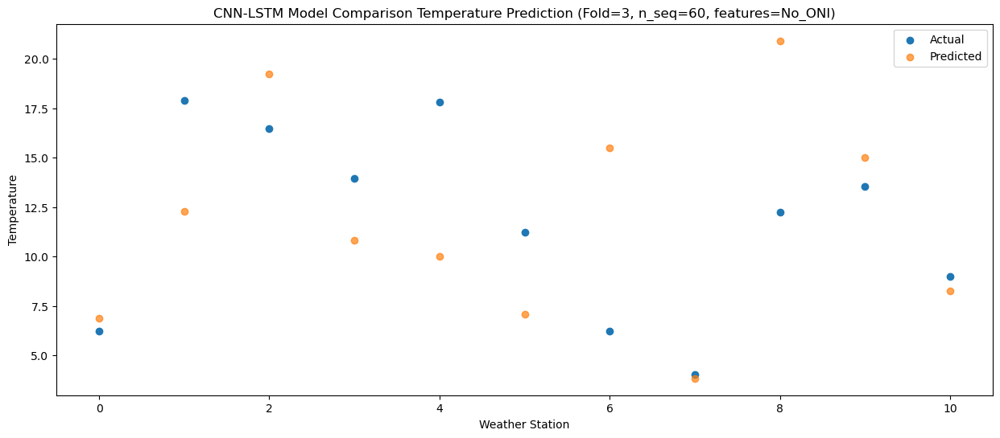

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.93   2.401650
1                 1   14.51   8.087047
2                 2   11.44  14.474212
3                 3    7.46   5.971509
4                 4   12.17   5.010376
5                 5    5.34   2.061551
6                 6    1.98  10.757782
7                 7   -1.86  -0.999253
8                 8   11.79  16.455814
9                 9    9.03   9.638299
10               10    3.75   2.931489


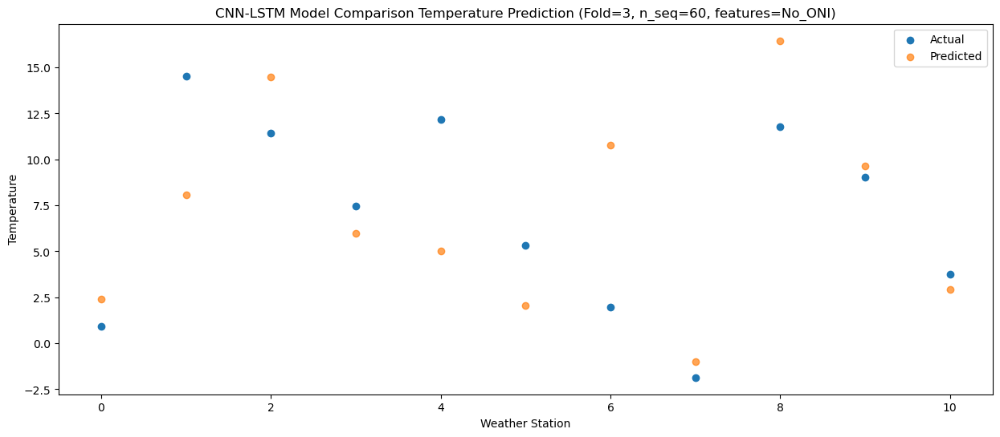

f, t:
[[-6.460e+00  2.220e+00  2.710e+00 -2.860e+00  3.310e+00 -5.820e+00
  -6.460e+00 -1.316e+01  5.280e+00  6.300e-01 -6.460e+00]
 [-7.240e+00  8.700e-01  1.800e-01 -2.850e+00  5.000e-02 -5.610e+00
  -1.213e+01 -1.789e+01  4.030e+00 -2.130e+00 -9.420e+00]
 [-7.660e+00  3.000e-02 -1.040e+00 -3.400e+00 -2.820e+00 -7.030e+00
  -1.222e+01 -1.673e+01  3.400e+00 -2.100e+00 -9.010e+00]
 [-6.650e+00  1.800e-01  1.380e+00 -3.750e+00 -1.670e+00 -7.440e+00
  -1.203e+01 -1.522e+01  5.420e+00 -1.660e+00 -8.090e+00]
 [-1.390e+00  7.670e+00  3.170e+00  3.160e+00  5.740e+00 -5.800e-01
  -7.100e+00 -1.211e+01  4.860e+00  1.920e+00 -3.680e+00]
 [-3.200e-01  8.590e+00  7.830e+00  3.800e+00  8.770e+00  1.690e+00
  -4.120e+00 -6.200e+00  8.480e+00  3.360e+00 -1.740e+00]
 [ 2.370e+00  1.299e+01  1.302e+01  8.370e+00  1.484e+01  7.100e+00
   2.990e+00  1.070e+00  1.088e+01  8.920e+00  4.030e+00]
 [ 7.690e+00  2.009e+01  1.637e+01  1.419e+01  2.189e+01  1.409e+01
   7.200e+00  4.530e+00  1.342e+01  1.590e+0

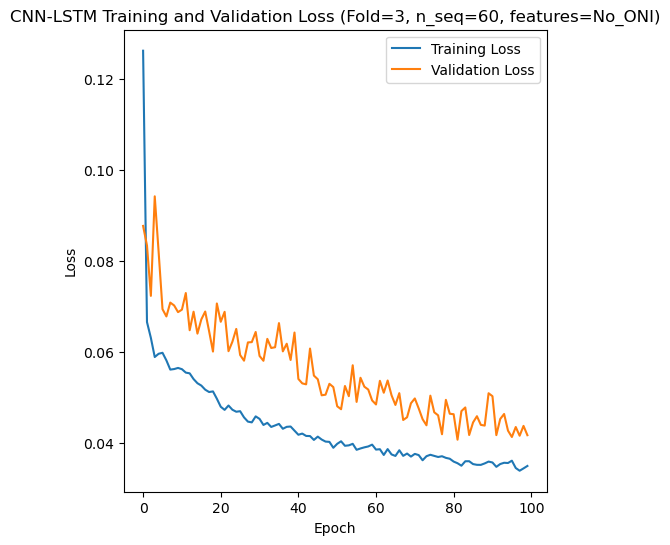

[[ 4.89  1.26  7.78 ... 22.59 18.46  9.82]
 [15.38 13.87 17.63 ... 26.66 22.89 20.2 ]
 [11.49  8.39 14.48 ... 24.97 20.83 17.82]
 ...
 [ 7.64  3.61 10.44 ... 21.3  17.62 11.34]
 [ 4.26  0.29  5.21 ... 21.47 15.54  9.34]
 [ 3.62 -0.32  6.05 ... 19.99 14.92  8.29]]
Epoch 1/100
84/84 [==============================] - 43s 139ms/step - loss: 0.1331 - accuracy: 0.2500 - mae: 0.1166 - rmse: 0.1331 - mape: inf - pearson: 0.6724 - val_loss: 0.0886 - val_accuracy: 0.6000 - val_mae: 0.0707 - val_rmse: 0.0886 - val_mape: 16.4577 - val_pearson: 0.7224
Epoch 2/100
84/84 [==============================] - 4s 49ms/step - loss: 0.0667 - accuracy: 0.4524 - mae: 0.0527 - rmse: 0.0667 - mape: inf - pearson: 0.8025 - val_loss: 0.0645 - val_accuracy: 0.6000 - val_mae: 0.0522 - val_rmse: 0.0645 - val_mape: 12.1407 - val_pearson: 0.8464
Epoch 3/100
84/84 [==============================] - 4s 51ms/step - loss: 0.0636 - accuracy: 0.4643 - mae: 0.0503 - rmse: 0.0636 - mape: inf - pearson: 0.8198 - val_loss: 0.0

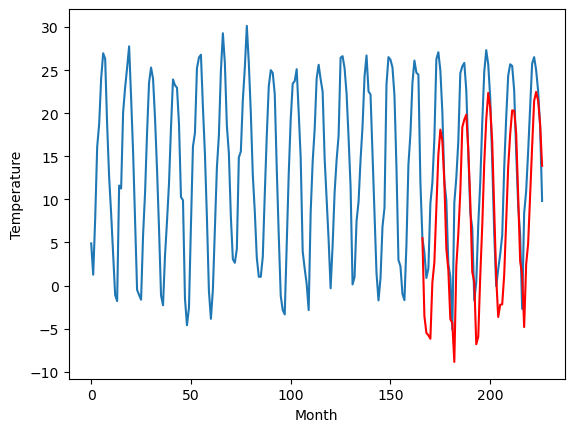

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.38		-2.19		0.19
-2.56		-3.45		-0.89
-4.02		-2.58		1.44
-2.47		-2.00		0.47
1.60		1.50		-0.10
3.28		2.60		-0.68
4.68		5.04		0.36
6.44		6.39		-0.05
6.76		8.92		2.16
6.61		9.87		3.26
6.03		7.93		1.90
4.53		5.64		1.11
1.14		0.41		-0.73
-6.61		-4.11		2.50
-5.91		-2.65		3.26
-2.48		-0.54		1.94
-0.88		0.70		1.58
0.56		3.89		3.33
4.60		6.74		2.14
6.23		9.61		3.38
6.60		10.76		4.16
6.88		11.29		4.41
5.59		8.26		2.67
3.75		5.11		1.36
-3.41		-0.23		3.18
-1.61		1.99		3.60
-6.37		-2.23		4.14
-2.94		-0.92		2.02
-0.12		2.07		2.19
2.22		6.03		3.81
5.04		8.96		3.92
6.76		11.93		5.17
7.13		13.14		6.01
7.08		12.15		5.07
5.64		10.27		4.63
1.81		4.73		2.92
0.35		1.35		1.00
-4.50		-0.55		3.95
-4.65		0.83		5.48
-1.35		1.74		3.09
0.37		4.13		3.76
3.09		5.17		2.08
3.87		7.21		3.34
6.08		9.91		3.83
7.69		14.15		6.46
8.20		14.67		6.47
6.10		11.91		5.81
2.45		8.08		5.63
-1.26		2.32		3.58
-3.38		0.71		4.09
-4.80		0.41	

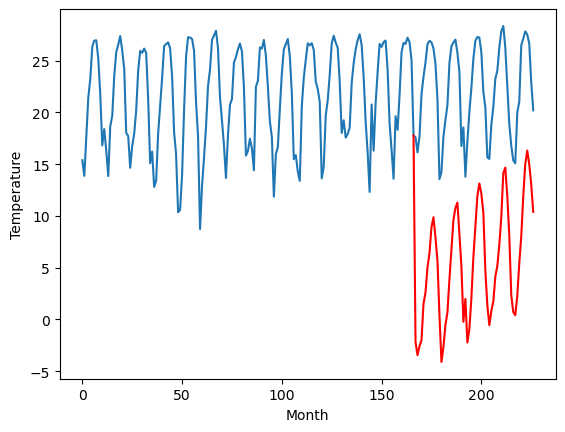

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.75		7.96		1.21
6.81		6.98		0.17
6.62		7.44		0.82
6.88		7.29		0.41
14.68		13.20		-1.48
13.73		14.05		0.32
17.61		17.80		0.19
21.70		21.05		-0.65
23.27		23.47		0.20
22.44		23.35		0.91
20.34		20.38		0.04
15.00		15.86		0.86
11.00		12.23		1.23
4.75		6.83		2.08
4.78		7.62		2.84
2.86		6.59		3.73
12.19		13.26		1.07
13.26		15.74		2.48
17.73		19.45		1.72
21.99		23.95		1.96
22.65		24.86		2.21
23.30		25.67		2.37
20.18		22.35		2.17
16.79		18.26		1.47
8.12		11.23		3.11
11.63		13.79		2.16
3.35		7.00		3.65
5.71		7.94		2.23
10.45		13.05		2.60
14.66		18.25		3.59
20.46		22.81		2.35
23.75		26.47		2.72
23.95		28.26		4.31
22.41		26.31		3.90
20.34		23.67		3.33
14.21		17.07		2.86
9.62		11.90		2.28
7.19		9.40		2.21
7.60		10.79		3.19
9.54		12.01		2.47
11.69		14.99		3.30
13.44		17.11		3.67
18.30		21.31		3.01
21.89		24.65		2.76
23.67		27.50		3.83
25.75		28.41		2.66
22.00		25.57		3.57
15.89		19.80		3.91
8.93		13.36		4.

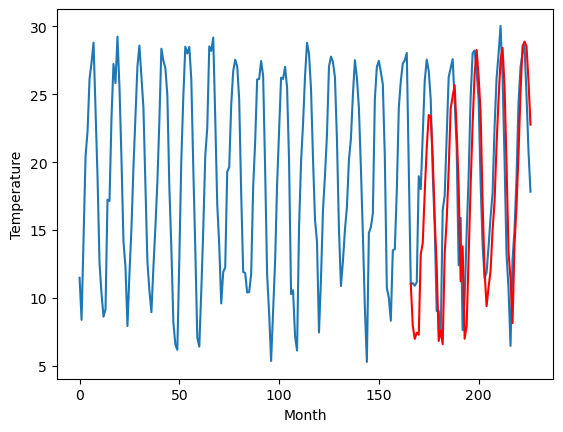

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.23		4.89		0.66
2.58		3.53		0.95
2.82		3.71		0.89
2.49		3.43		0.94
9.95		9.91		-0.04
10.61		11.28		0.67
15.74		15.88		0.14
20.70		19.97		-0.73
22.56		22.27		-0.29
22.31		22.04		-0.27
16.53		18.33		1.80
10.80		12.40		1.60
8.19		9.26		1.07
1.91		3.93		2.02
0.99		4.55		3.56
-2.47		1.81		4.28
8.49		10.52		2.03
10.18		13.08		2.90
14.34		17.24		2.90
20.02		22.85		2.83
21.61		23.79		2.18
21.98		24.41		2.43
19.19		21.07		1.88
14.54		15.79		1.25
6.54		8.94		2.40
8.54		10.13		1.59
0.07		3.45		3.38
0.33		3.73		3.40
6.51		9.73		3.22
12.56		15.47		2.91
17.27		20.57		3.30
21.82		24.93		3.11
25.12		27.24		2.12
22.39		25.14		2.75
18.96		22.18		3.22
12.09		15.02		2.93
5.04		7.89		2.85
2.35		5.34		2.99
3.34		6.54		3.20
3.40		7.45		4.05
7.93		11.00		3.07
10.53		14.09		3.56
16.21		19.64		3.43
20.40		23.05		2.65
22.95		25.64		2.69
25.50		26.70		1.20
20.80		23.73		2.93
12.67		16.92		4.25
6.60		10.19		3.59
3.58		8

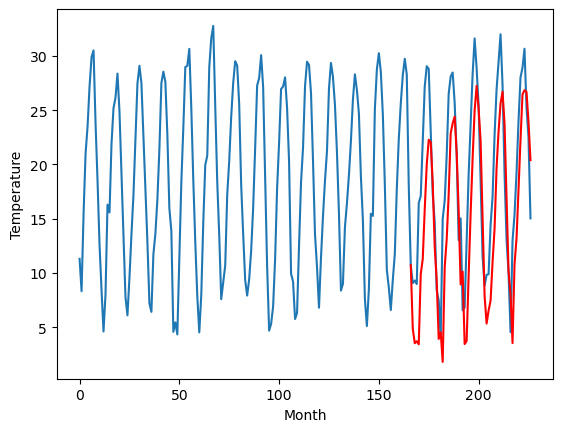

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.65		4.87		1.22
1.87		3.40		1.53
2.49		3.56		1.07
2.11		3.29		1.18
9.99		9.70		-0.29
10.68		11.20		0.52
16.33		15.92		-0.41
21.04		20.07		-0.97
23.48		22.39		-1.09
22.80		22.18		-0.62
16.50		18.38		1.88
10.75		12.32		1.57
7.99		9.17		1.18
1.42		3.90		2.48
0.82		4.51		3.69
-3.07		1.66		4.73
7.85		10.40		2.55
10.03		13.06		3.03
13.56		17.27		3.71
20.41		23.02		2.61
21.90		23.98		2.08
22.27		24.55		2.28
18.84		21.20		2.36
13.97		15.77		1.80
6.13		9.03		2.90
7.87		9.88		2.01
-1.03		3.40		4.43
-0.41		3.61		4.02
6.51		9.64		3.13
13.20		15.40		2.20
18.03		20.54		2.51
22.70		24.99		2.29
26.12		27.39		1.27
23.28		25.35		2.07
19.19		22.36		3.17
12.04		15.14		3.10
4.95		7.80		2.85
1.98		5.22		3.24
2.75		6.40		3.65
2.98		7.21		4.23
7.83		10.81		2.98
10.48		14.08		3.60
16.64		19.72		3.08
21.75		23.12		1.37
24.83		25.78		0.95
26.70		26.81		0.11
21.61		23.84		2.23
12.78		16.98		4.20
6.25		10.22		3.97
3.12	

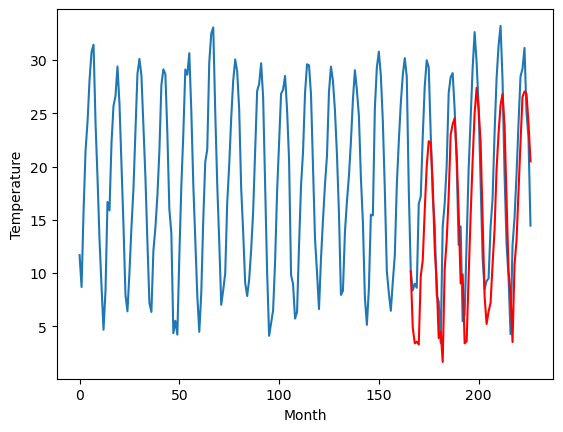

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.12		5.94		0.82
3.48		3.99		0.51
2.75		4.32		1.57
1.99		4.36		2.37
9.55		9.52		-0.03
12.52		11.48		-1.04
19.09		16.05		-3.04
22.42		19.53		-2.89
25.25		22.02		-3.23
24.63		22.39		-2.24
16.90		18.75		1.85
12.94		13.23		0.29
9.06		9.26		0.20
2.08		4.67		2.59
0.98		5.58		4.60
-0.59		3.82		4.41
8.66		10.18		1.52
10.89		13.42		2.53
16.38		17.47		1.09
21.34		22.96		1.62
21.08		24.11		3.03
21.40		24.42		3.02
20.71		21.15		0.44
15.01		15.54		0.53
8.07		9.98		1.91
8.48		9.70		1.22
1.11		4.97		3.86
0.91		5.02		4.11
8.23		10.30		2.07
15.74		15.63		-0.11
21.43		20.11		-1.32
23.80		24.61		0.81
25.70		27.12		1.42
22.40		25.65		3.25
19.50		22.84		3.34
12.69		15.88		3.19
4.84		8.45		3.61
3.24		6.24		3.00
3.61		7.36		3.75
3.78		7.67		3.89
8.85		11.22		2.37
13.07		14.46		1.39
17.99		19.54		1.55
24.47		22.65		-1.82
25.93		26.21		0.28
26.02		26.95		0.93
22.54		24.01		1.47
14.01		17.82		3.81
7.30		11.21		3.91
4.

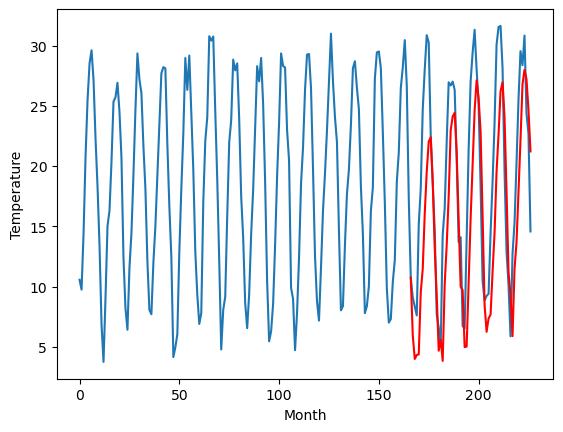

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.86		2.45		1.59
0.51		1.12		0.61
0.34		1.76		1.42
0.81		1.86		1.05
6.42		6.48		0.06
7.69		7.70		0.01
10.48		11.66		1.18
15.07		15.09		0.02
18.11		18.22		0.11
16.91		17.87		0.96
13.11		14.95		1.84
9.29		10.99		1.70
4.98		6.82		1.84
-2.27		1.51		3.78
-2.04		1.87		3.91
-1.37		1.98		3.35
5.03		6.83		1.80
7.76		10.29		2.53
11.21		14.01		2.80
15.23		18.56		3.33
16.97		19.62		2.65
17.10		20.43		3.33
13.13		16.73		3.60
9.33		13.17		3.84
1.17		5.77		4.60
3.08		7.58		4.50
-2.98		1.30		4.28
1.30		3.14		1.84
4.86		7.58		2.72
7.52		12.15		4.63
13.50		17.06		3.56
16.71		20.55		3.84
17.98		22.64		4.66
16.46		21.39		4.93
13.37		18.32		4.95
6.50		11.93		5.43
3.80		8.05		4.25
-2.15		4.51		6.66
0.87		6.29		5.42
4.29		6.89		2.60
4.77		9.34		4.57
7.88		12.53		4.65
10.50		15.56		5.06
14.14		18.89		4.75
18.01		22.82		4.81
17.45		22.80		5.35
13.61		20.31		6.70
8.17		15.51		7.34
2.44		8.68		6.24
0.23		7.44		7.21
-2.

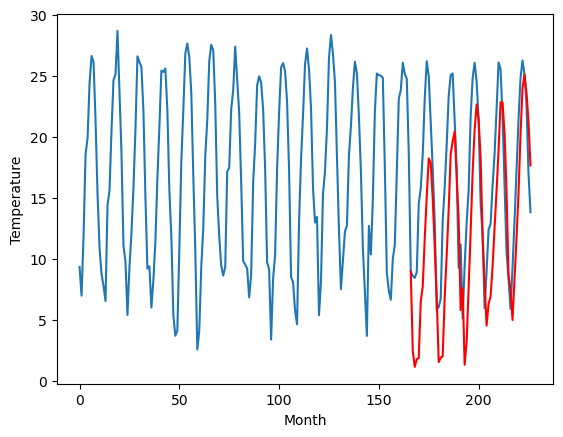

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.01		1.78		-0.23
1.20		0.48		-0.72
-0.45		0.53		0.98
0.12		0.16		0.04
7.05		6.67		-0.38
8.63		8.11		-0.52
12.73		13.18		0.45
19.08		18.04		-1.04
21.62		20.71		-0.91
19.63		19.85		0.22
16.05		15.99		-0.06
9.12		9.76		0.64
6.57		6.88		0.31
0.04		1.15		1.11
-1.63		1.25		2.88
-5.24		-1.74		3.50
7.03		7.70		0.67
8.93		10.64		1.71
12.97		14.95		1.98
19.27		21.02		1.75
20.56		21.87		1.31
21.08		22.66		1.58
18.04		18.94		0.90
12.27		14.03		1.76
4.33		6.07		1.74
5.79		7.14		1.35
-3.28		-0.34		2.94
-1.22		0.64		1.86
5.44		6.89		1.45
9.30		12.53		3.23
14.97		18.59		3.62
20.29		22.93		2.64
23.99		25.37		1.38
20.47		23.36		2.89
16.88		19.99		3.11
10.51		12.69		2.18
3.96		6.22		2.26
-0.89		2.65		3.54
0.76		4.07		3.31
2.90		4.82		1.92
4.62		8.03		3.41
10.24		12.14		1.90
15.02		17.51		2.49
19.10		21.16		2.06
21.06		23.77		2.71
20.87		24.26		3.39
16.93		21.52		4.59
11.03		14.91		3.88
5.13		7.83		2.70
2.25		6

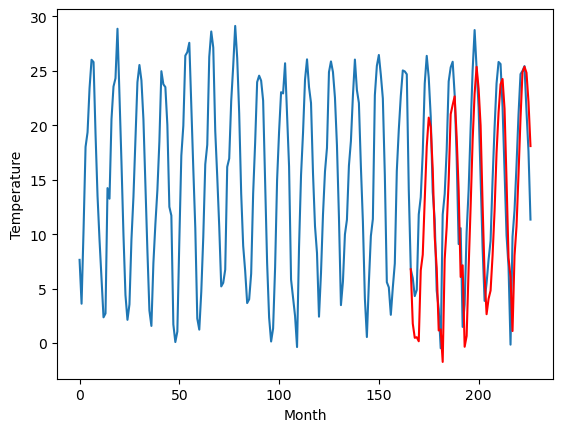

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.64		-1.20		1.44
-3.46		-2.84		0.62
-4.39		-2.83		1.56
-5.22		-3.18		2.04
1.60		2.63		1.03
4.59		4.54		-0.05
10.17		10.47		0.30
17.46		16.47		-0.99
19.50		20.07		0.57
17.30		18.35		1.05
13.54		14.17		0.63
6.70		7.67		0.97
2.86		4.75		1.89
-4.65		-1.23		3.42
-6.23		-2.04		4.19
-9.59		-4.85		4.74
2.38		4.46		2.08
6.03		8.53		2.50
10.44		13.13		2.69
17.68		19.98		2.30
18.25		20.83		2.58
19.11		21.79		2.68
15.62		17.38		1.76
10.27		13.00		2.73
-0.59		3.60		4.19
-0.27		3.67		3.94
-9.11		-4.33		4.78
-6.09		-2.08		4.01
1.38		4.19		2.81
5.16		9.43		4.27
13.66		16.91		3.25
18.14		21.23		3.09
20.08		24.13		4.05
17.85		22.72		4.87
13.94		18.53		4.59
6.45		11.13		4.68
0.66		5.84		5.18
-5.12		0.46		5.58
-3.16		2.36		5.52
-1.57		2.31		3.88
-0.30		4.89		5.19
6.20		11.05		4.85
11.91		15.73		3.82
15.79		19.66		3.87
18.52		22.99		4.47
17.36		22.20		4.84
14.27		19.94		5.67
8.13		14.05		5.92
1.06		6.17		5.11
-

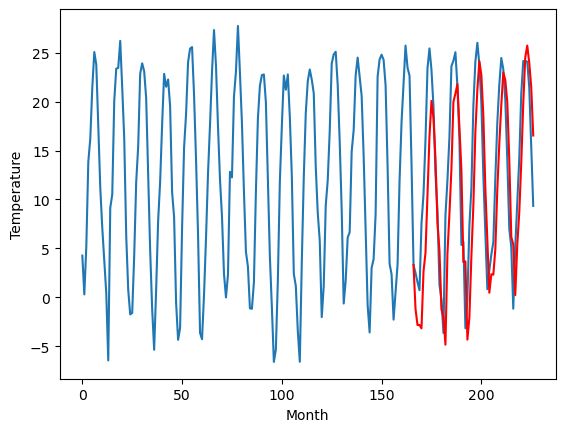

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.88		-4.08		0.80
-5.20		-5.82		-0.62
-7.64		-6.02		1.62
-7.89		-6.47		1.42
-0.29		-0.11		0.18
2.82		2.02		-0.80
8.70		8.33		-0.37
16.43		14.75		-1.68
17.64		18.12		0.48
15.04		16.33		1.29
11.14		11.76		0.62
3.80		4.44		0.64
1.16		1.93		0.77
-6.72		-4.09		2.63
-8.75		-4.92		3.83
-13.19		-8.85		4.34
0.67		1.93		1.26
4.38		5.88		1.50
9.16		10.71		1.55
16.55		18.10		1.55
16.26		18.90		2.64
16.54		19.75		3.21
13.43		15.36		1.93
7.97		10.33		2.36
-2.34		1.03		3.37
-2.59		0.51		3.10
-12.07		-7.54		4.53
-9.24		-5.74		3.50
-1.03		1.11		2.14
3.09		6.70		3.61
11.62		14.47		2.85
16.23		19.14		2.91
17.05		22.17		5.12
15.75		20.58		4.83
11.61		16.34		4.73
4.14		8.63		4.49
-1.40		2.19		3.59
-8.13		-3.13		5.00
-5.89		-1.41		4.48
-4.70		-1.44		3.26
-2.16		1.48		3.64
5.17		8.01		2.84
10.93		13.58		2.65
15.24		17.56		2.32
16.77		20.47		3.70
15.51		19.91		4.40
12.47		17.54		5.07
6.06		10.97		4.91
-1.03		3.07	

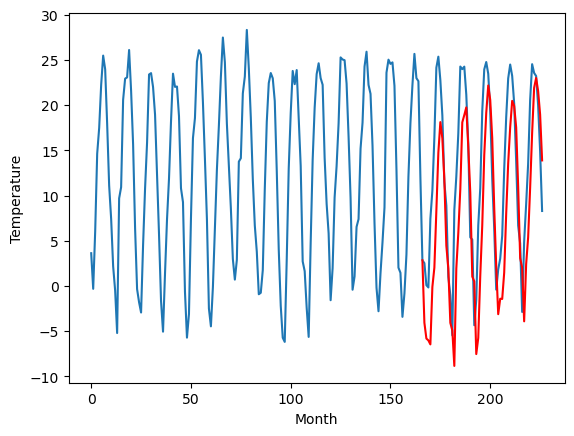

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.79		-5.60		1.19
-7.57		-7.54		0.03
-8.77		-7.34		1.43
-9.58		-7.53		2.05
-3.42		-2.69		0.73
-2.04		-0.56		1.48
4.70		5.42		0.72
11.19		11.33		0.14
14.63		15.46		0.83
12.22		13.70		1.48
8.23		9.61		1.38
2.07		3.62		1.55
-1.16		0.20		1.36
-8.72		-5.60		3.12
-10.64		-6.63		4.01
-12.88		-8.44		4.44
-2.99		-0.76		2.23
0.81		3.96		3.15
5.34		8.54		3.20
12.23		15.29		3.06
12.39		16.27		3.88
13.59		17.26		3.67
9.30		12.61		3.31
5.77		8.62		2.85
-4.63		-0.88		3.75
-5.49		-1.24		4.25
-14.32		-8.79		5.53
-10.76		-5.97		4.79
-4.79		-0.28		4.51
-0.79		4.53		5.32
7.79		12.07		4.28
11.06		16.22		5.16
13.66		19.30		5.64
12.59		18.41		5.82
8.54		13.96		5.42
1.68		6.77		5.09
-2.40		2.39		4.79
-9.11		-3.52		5.59
-7.48		-1.38		6.10
-7.34		-1.92		5.42
-6.46		0.31		6.77
2.01		6.97		4.96
5.70		10.78		5.08
10.01		14.67		4.66
13.10		18.81		5.71
11.77		17.42		5.65
9.43		15.41		5.98
4.17		10.27		6.10
-3.22		2.12		5

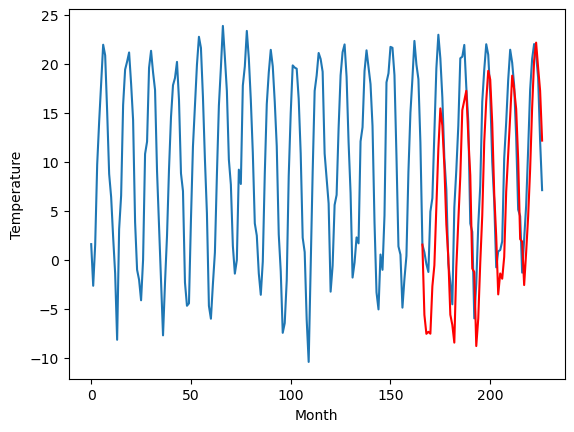

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -3.543753
1                 1   -2.38  -2.191718
2                 2    6.75   7.958014
3                 3    4.23   4.892057
4                 4    3.65   4.865166
5                 5    5.12   5.937855
6                 6    0.86   2.451453
7                 7    2.01   1.783846
8                 8   -2.64  -1.202807
9                 9   -4.88  -4.076445
10               10   -6.79  -5.604983


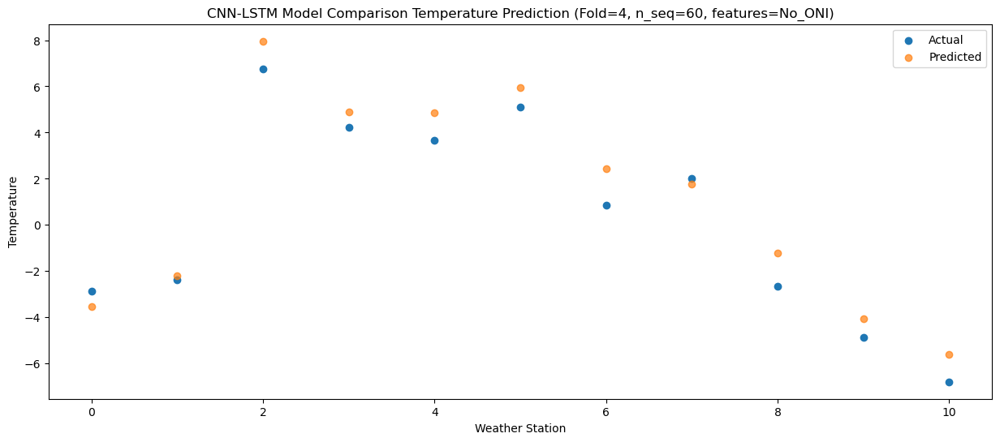

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -4.52  -5.486922
1                 1   -2.56  -3.452269
2                 2    6.81   6.983711
3                 3    2.58   3.531231
4                 4    1.87   3.401019
5                 5    3.48   3.986282
6                 6    0.51   1.119066
7                 7    1.20   0.475899
8                 8   -3.46  -2.839773
9                 9   -5.20  -5.819059
10               10   -7.57  -7.541902


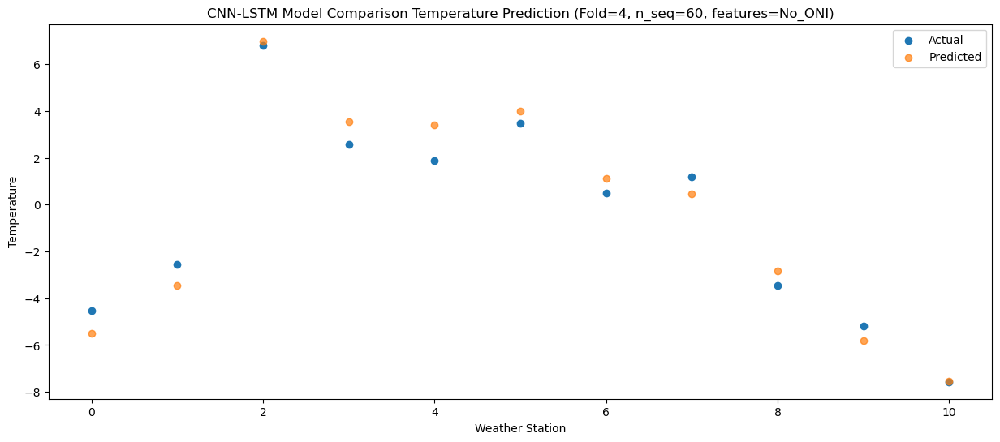

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.48  -5.766743
1                 1   -4.02  -2.582941
2                 2    6.62   7.438484
3                 3    2.82   3.713653
4                 4    2.49   3.560839
5                 5    2.75   4.321982
6                 6    0.34   1.755210
7                 7   -0.45   0.534792
8                 8   -4.39  -2.832558
9                 9   -7.64  -6.024920
10               10   -8.77  -7.335782


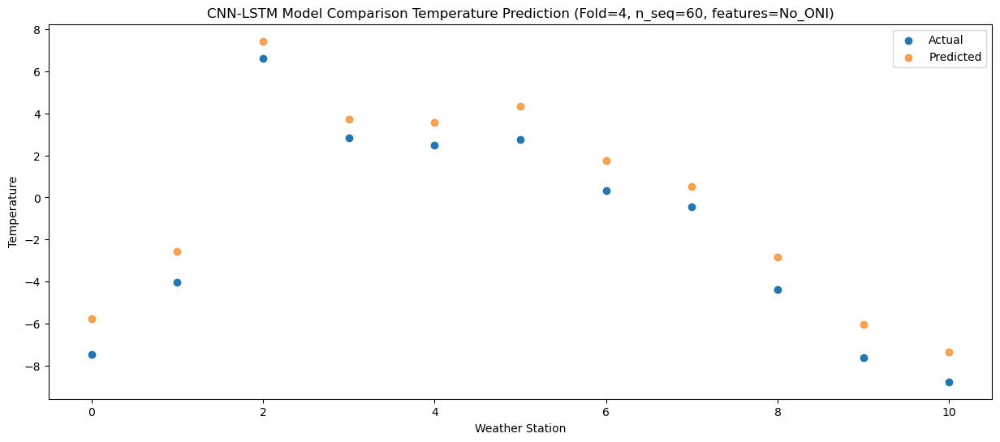

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.37  -6.176575
1                 1   -2.47  -1.999905
2                 2    6.88   7.292932
3                 3    2.49   3.430714
4                 4    2.11   3.293229
5                 5    1.99   4.361940
6                 6    0.81   1.857130
7                 7    0.12   0.159699
8                 8   -5.22  -3.182592
9                 9   -7.89  -6.466998
10               10   -9.58  -7.529407


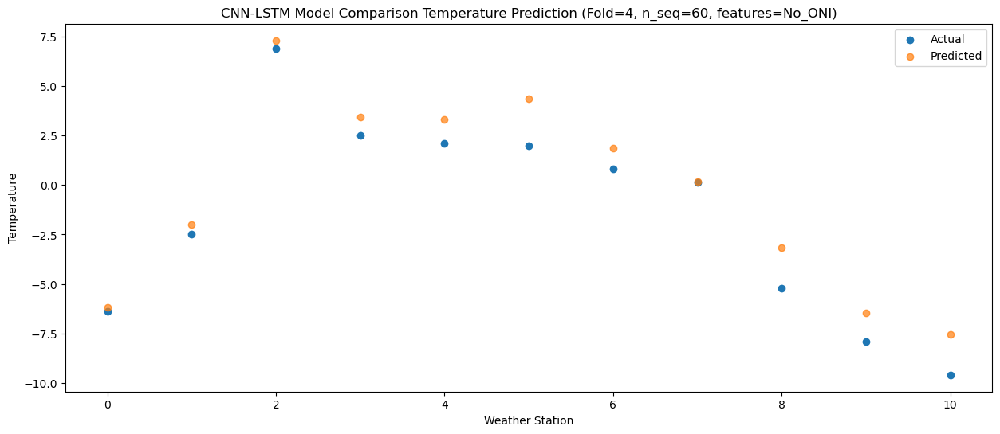

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.16   0.364147
1                 1    1.60   1.501224
2                 2   14.68  13.199471
3                 3    9.95   9.911684
4                 4    9.99   9.704625
5                 5    9.55   9.519747
6                 6    6.42   6.483656
7                 7    7.05   6.673662
8                 8    1.60   2.625718
9                 9   -0.29  -0.109874
10               10   -3.42  -2.685769


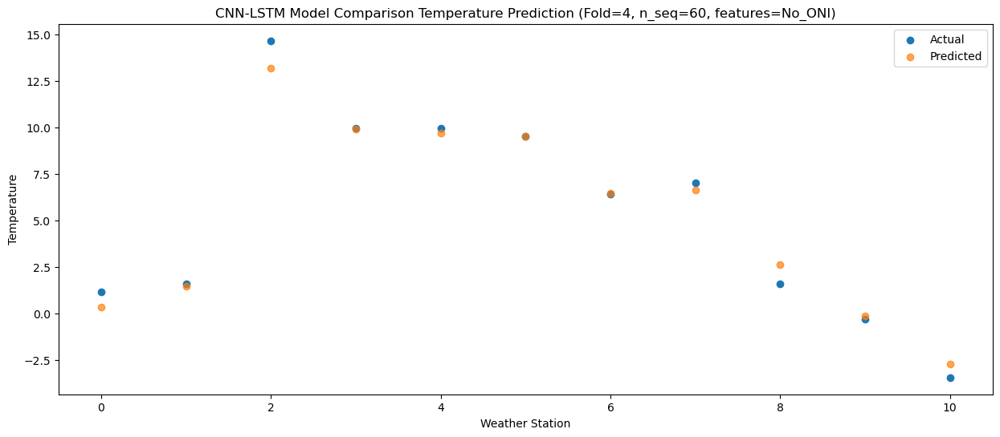

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.59   2.689364
1                 1    3.28   2.601036
2                 2   13.73  14.050088
3                 3   10.61  11.276346
4                 4   10.68  11.198705
5                 5   12.52  11.476605
6                 6    7.69   7.700685
7                 7    8.63   8.107662
8                 8    4.59   4.542738
9                 9    2.82   2.018225
10               10   -2.04  -0.562763


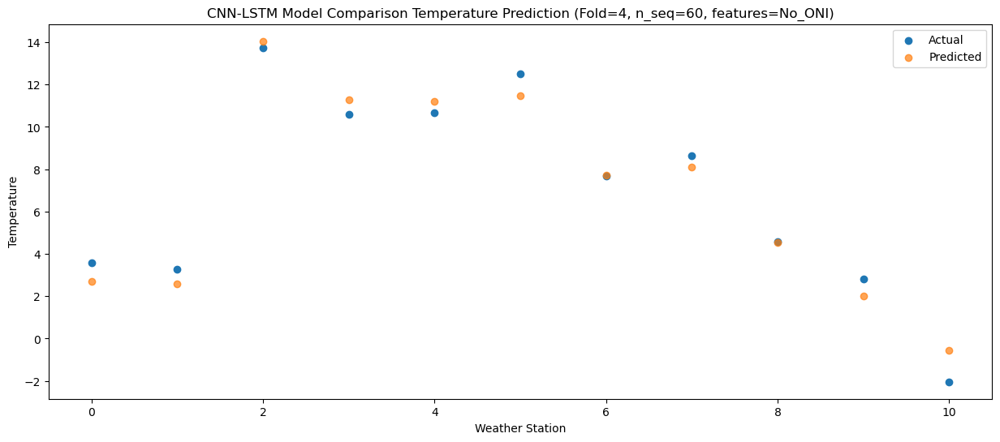

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.66   8.993934
1                 1    4.68   5.039622
2                 2   17.61  17.800895
3                 3   15.74  15.881851
4                 4   16.33  15.915156
5                 5   19.09  16.050709
6                 6   10.48  11.658165
7                 7   12.73  13.175268
8                 8   10.17  10.470267
9                 9    8.70   8.330247
10               10    4.70   5.418683


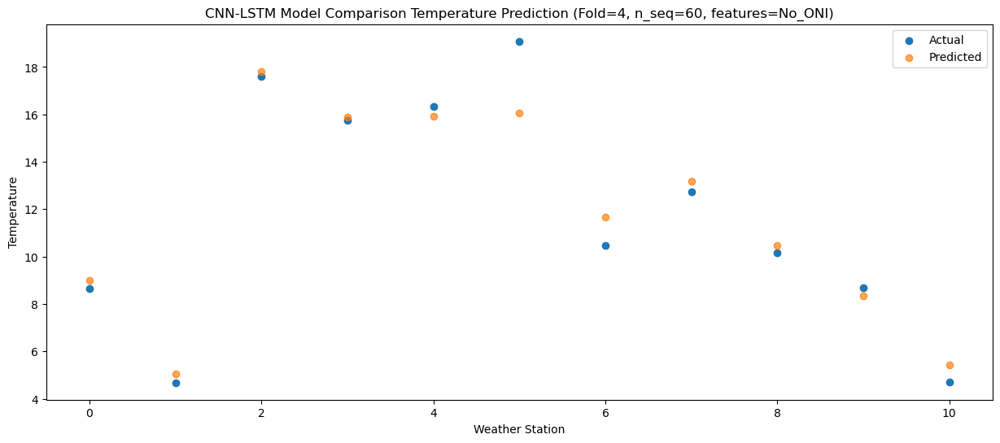

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.91  15.167241
1                 1    6.44   6.388901
2                 2   21.70  21.053103
3                 3   20.70  19.974741
4                 4   21.04  20.072947
5                 5   22.42  19.526867
6                 6   15.07  15.090535
7                 7   19.08  18.041161
8                 8   17.46  16.467899
9                 9   16.43  14.749797
10               10   11.19  11.334199


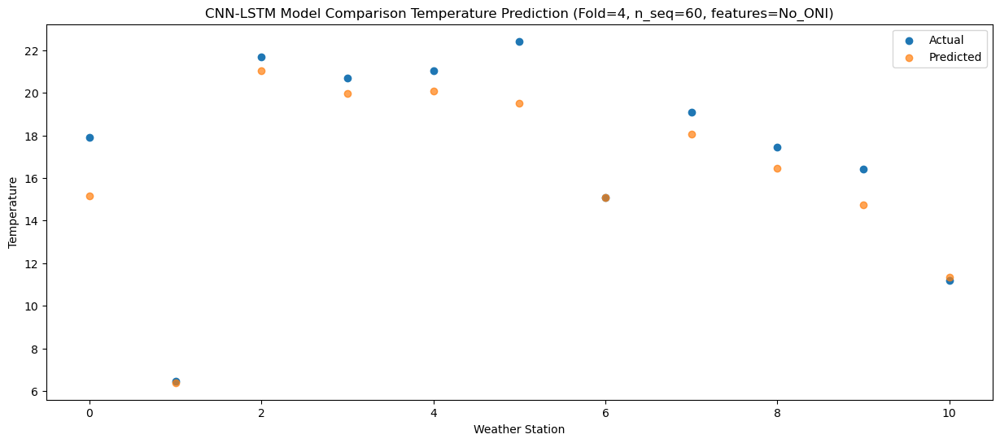

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.72  18.092325
1                 1    6.76   8.915744
2                 2   23.27  23.468666
3                 3   22.56  22.273506
4                 4   23.48  22.386163
5                 5   25.25  22.020500
6                 6   18.11  18.219148
7                 7   21.62  20.705780
8                 8   19.50  20.074542
9                 9   17.64  18.121948
10               10   14.63  15.462244


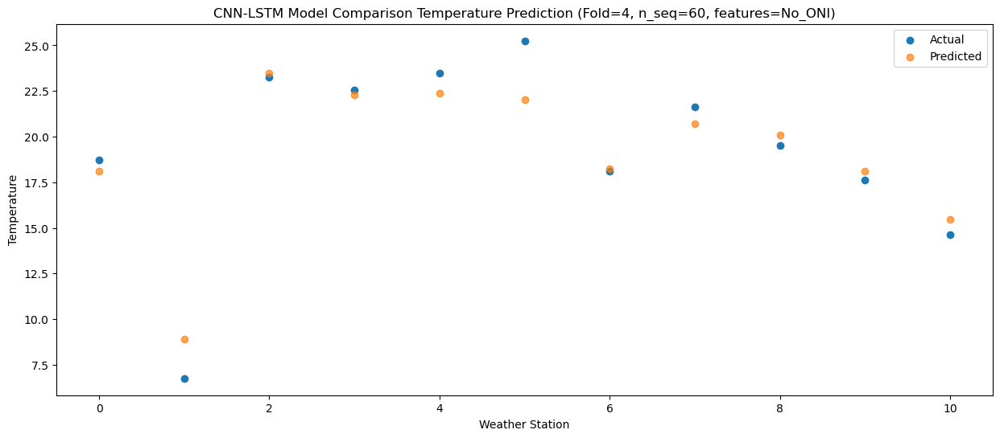

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   16.62  16.790961
1                 1    6.61   9.869138
2                 2   22.44  23.347081
3                 3   22.31  22.041044
4                 4   22.80  22.179077
5                 5   24.63  22.388578
6                 6   16.91  17.868349
7                 7   19.63  19.848975
8                 8   17.30  18.346165
9                 9   15.04  16.333622
10               10   12.22  13.696764


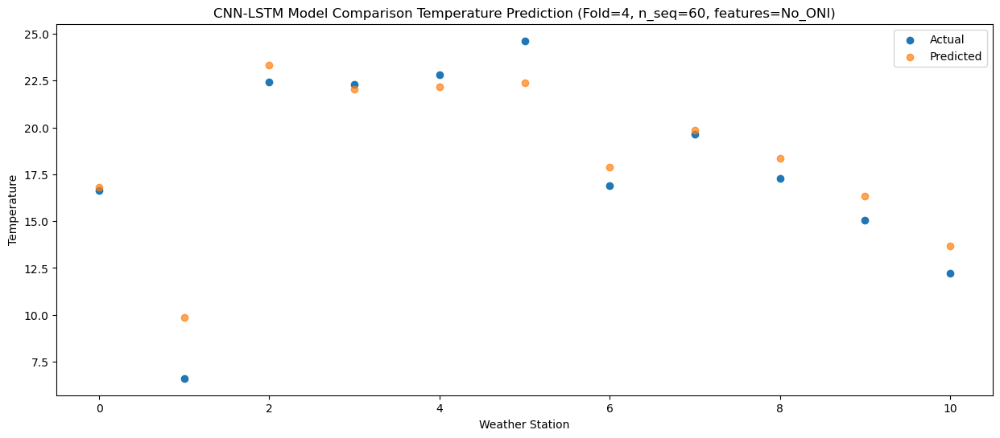

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.78  12.017084
1                 1    6.03   7.934899
2                 2   20.34  20.384449
3                 3   16.53  18.329153
4                 4   16.50  18.378568
5                 5   16.90  18.745986
6                 6   13.11  14.948221
7                 7   16.05  15.986989
8                 8   13.54  14.172592
9                 9   11.14  11.763295
10               10    8.23   9.607095


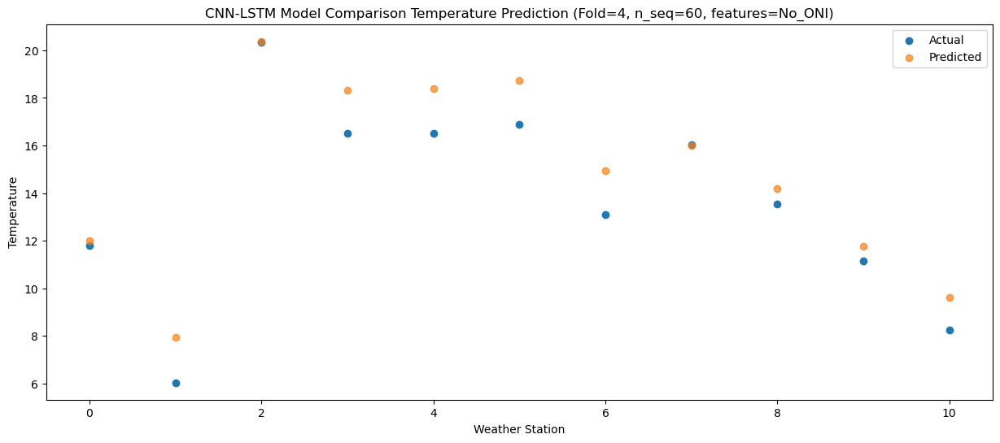

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.73   4.293904
1                 1    4.53   5.643981
2                 2   15.00  15.857465
3                 3   10.80  12.398353
4                 4   10.75  12.323846
5                 5   12.94  13.231684
6                 6    9.29  10.988491
7                 7    9.12   9.755038
8                 8    6.70   7.672080
9                 9    3.80   4.444999
10               10    2.07   3.620712


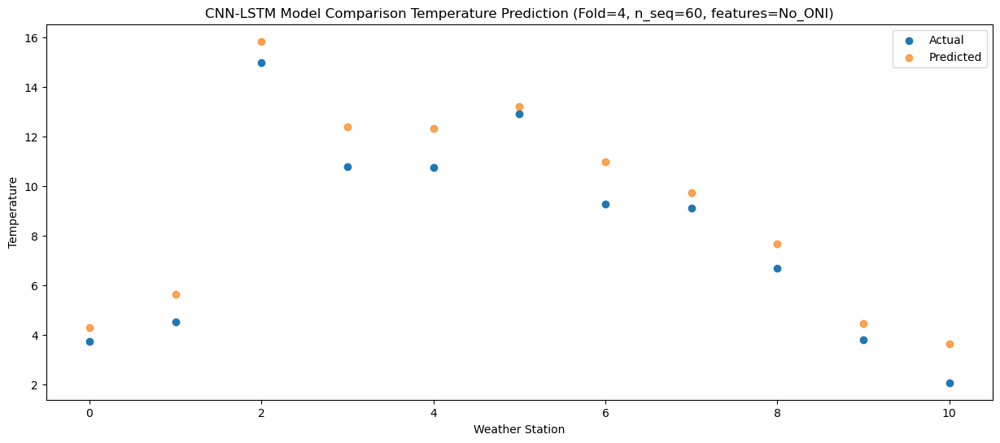

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.54   1.816353
1                 1    1.14   0.411616
2                 2   11.00  12.234801
3                 3    8.19   9.263513
4                 4    7.99   9.173082
5                 5    9.06   9.257247
6                 6    4.98   6.817039
7                 7    6.57   6.877602
8                 8    2.86   4.751052
9                 9    1.16   1.926754
10               10   -1.16   0.196960


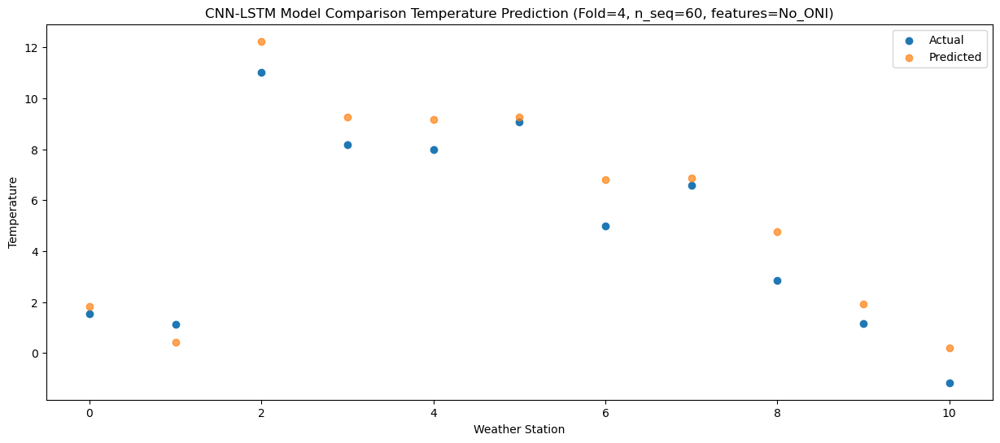

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -5.84  -3.896382
1                 1   -6.61  -4.105434
2                 2    4.75   6.833260
3                 3    1.91   3.926675
4                 4    1.42   3.896298
5                 5    2.08   4.670194
6                 6   -2.27   1.512949
7                 7    0.04   1.154197
8                 8   -4.65  -1.226825
9                 9   -6.72  -4.086151
10               10   -8.72  -5.595349


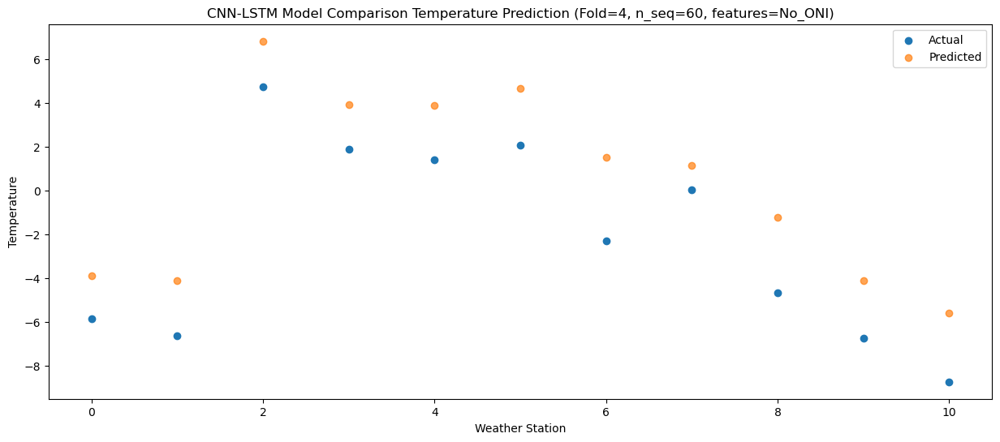

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -7.35  -4.341368
1                 1   -5.91  -2.645466
2                 2    4.78   7.623282
3                 3    0.99   4.548172
4                 4    0.82   4.505283
5                 5    0.98   5.579506
6                 6   -2.04   1.872673
7                 7   -1.63   1.248704
8                 8   -6.23  -2.039560
9                 9   -8.75  -4.915614
10               10  -10.64  -6.633454


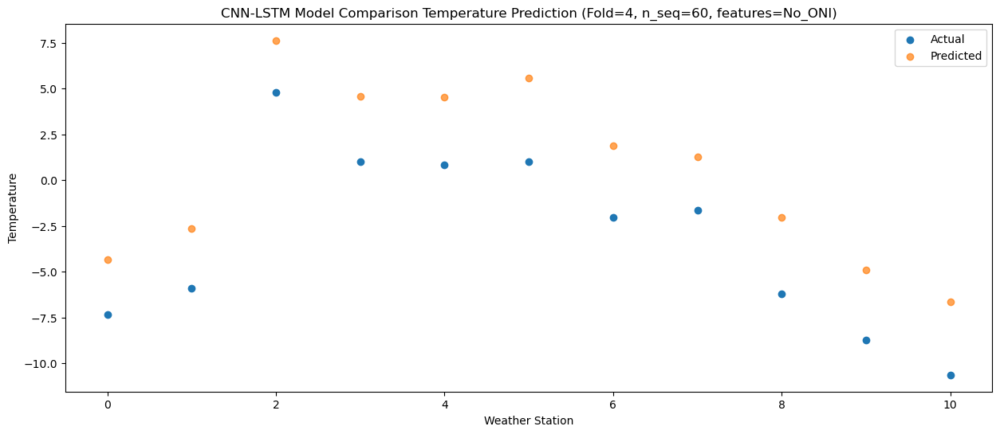

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -13.48  -8.862241
1                 1   -2.48  -0.537660
2                 2    2.86   6.594634
3                 3   -2.47   1.808508
4                 4   -3.07   1.658436
5                 5   -0.59   3.823212
6                 6   -1.37   1.981876
7                 7   -5.24  -1.736771
8                 8   -9.59  -4.850601
9                 9  -13.19  -8.848411
10               10  -12.88  -8.440291


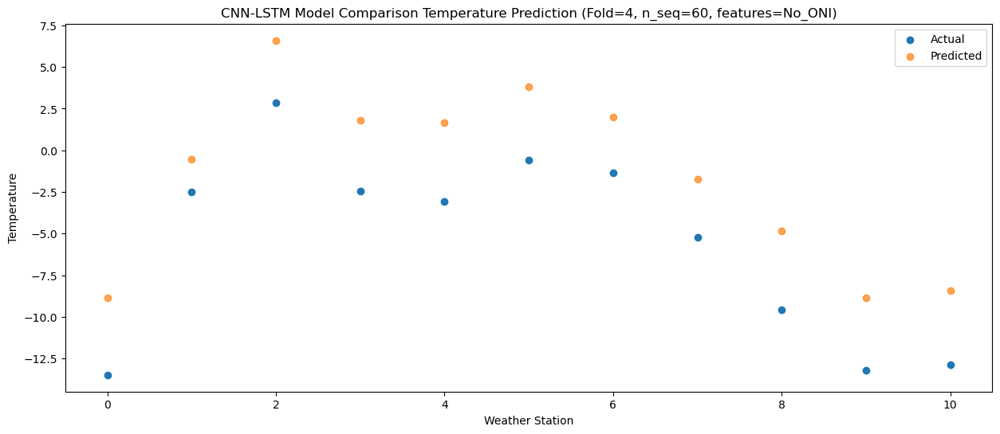

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.25   2.263362
1                 1   -0.88   0.697275
2                 2   12.19  13.262078
3                 3    8.49  10.522630
4                 4    7.85  10.398353
5                 5    8.66  10.176786
6                 6    5.03   6.825520
7                 7    7.03   7.696947
8                 8    2.38   4.461540
9                 9    0.67   1.927281
10               10   -2.99  -0.757640


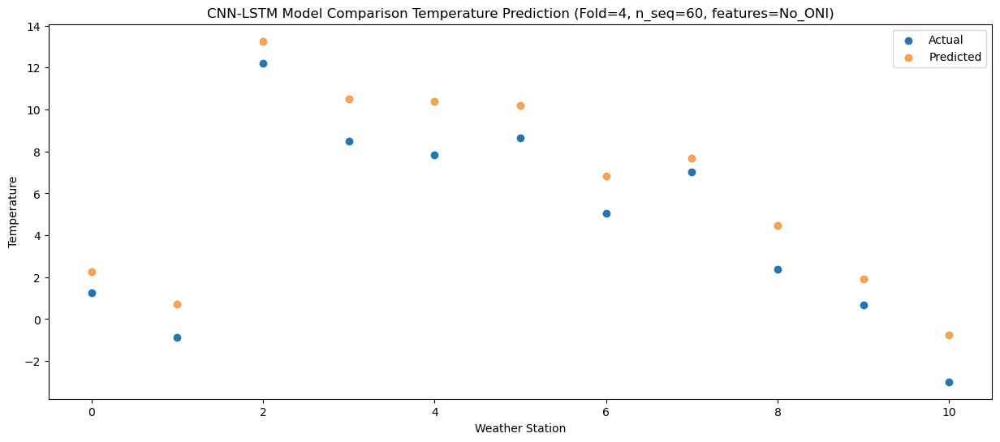

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.16   5.981236
1                 1    0.56   3.885594
2                 2   13.26  15.735581
3                 3   10.18  13.082716
4                 4   10.03  13.059444
5                 5   10.89  13.417275
6                 6    7.76  10.288307
7                 7    8.93  10.640779
8                 8    6.03   8.531115
9                 9    4.38   5.884802
10               10    0.81   3.956011


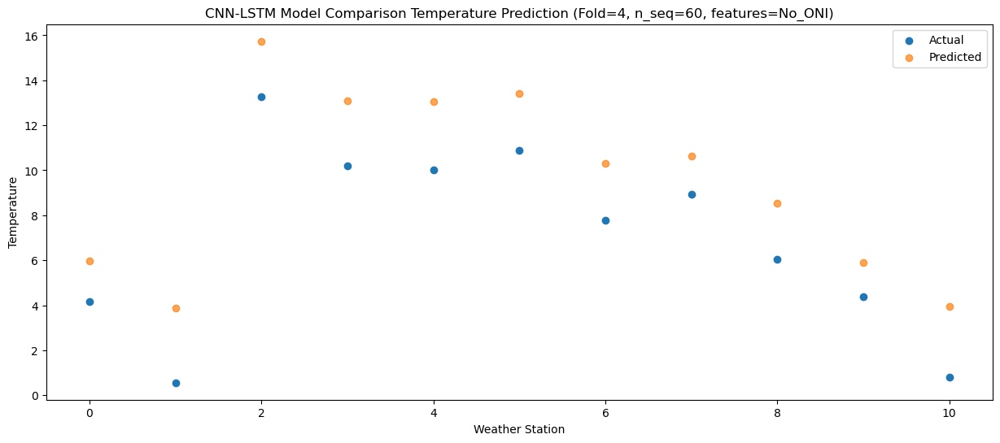

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.37  10.856767
1                 1    4.60   6.738901
2                 2   17.73  19.452952
3                 3   14.34  17.242880
4                 4   13.56  17.272565
5                 5   16.38  17.465934
6                 6   11.21  14.012405
7                 7   12.97  14.954839
8                 8   10.44  13.134372
9                 9    9.16  10.706439
10               10    5.34   8.540051


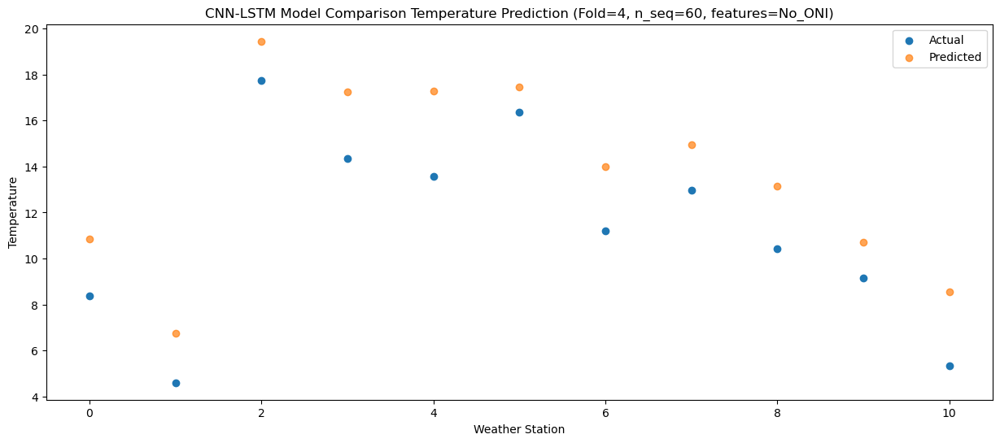

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.28  18.374976
1                 1    6.23   9.609817
2                 2   21.99  23.954131
3                 3   20.02  22.850965
4                 4   20.41  23.016688
5                 5   21.34  22.955731
6                 6   15.23  18.558769
7                 7   19.27  21.020449
8                 8   17.68  19.979815
9                 9   16.55  18.098689
10               10   12.23  15.293876


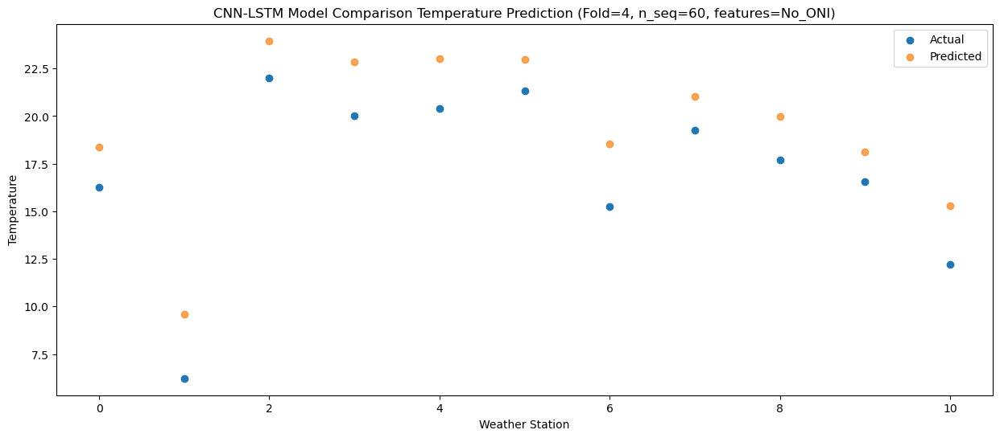

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.08  19.263128
1                 1    6.60  10.762503
2                 2   22.65  24.855698
3                 3   21.61  23.787530
4                 4   21.90  23.981846
5                 5   21.08  24.112207
6                 6   16.97  19.620873
7                 7   20.56  21.873348
8                 8   18.25  20.828986
9                 9   16.26  18.902048
10               10   12.39  16.267587


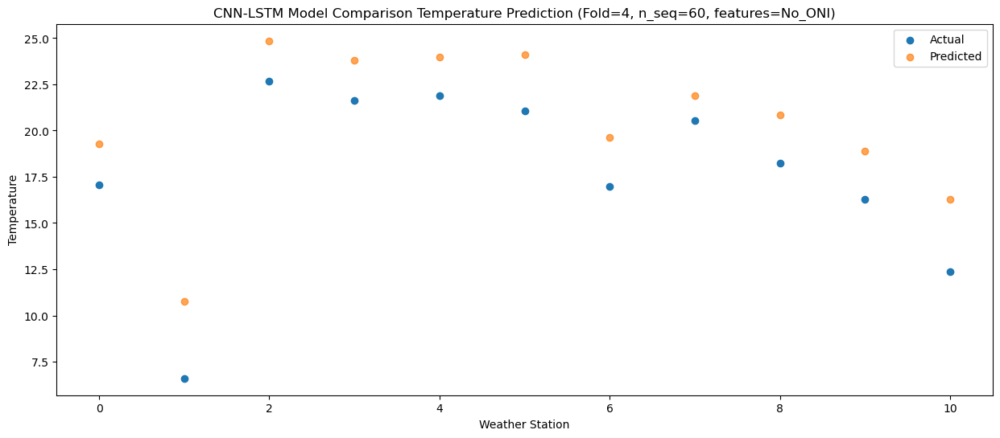

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   17.48  19.835036
1                 1    6.88  11.292061
2                 2   23.30  25.667929
3                 3   21.98  24.407331
4                 4   22.27  24.554851
5                 5   21.40  24.424672
6                 6   17.10  20.429750
7                 7   21.08  22.657478
8                 8   19.11  21.785953
9                 9   16.54  19.747956
10               10   13.59  17.256738


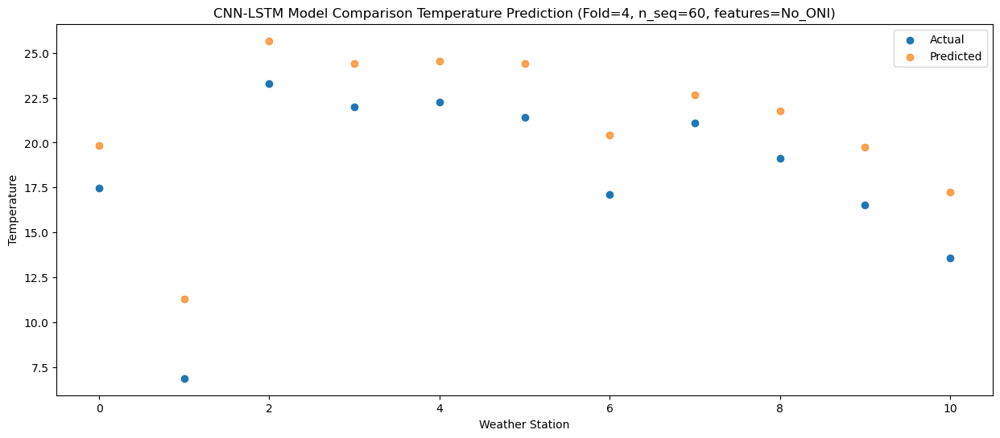

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.29  15.719272
1                 1    5.59   8.262777
2                 2   20.18  22.345848
3                 3   19.19  21.067862
4                 4   18.84  21.203243
5                 5   20.71  21.148564
6                 6   13.13  16.728279
7                 7   18.04  18.941882
8                 8   15.62  17.379636
9                 9   13.43  15.357568
10               10    9.30  12.614367


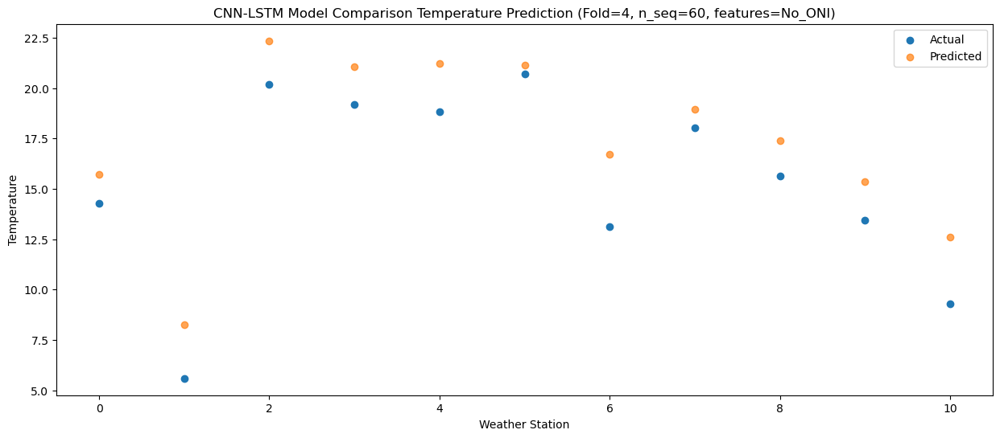

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.16   9.820446
1                 1    3.75   5.110245
2                 2   16.79  18.262573
3                 3   14.54  15.790038
4                 4   13.97  15.765490
5                 5   15.01  15.542838
6                 6    9.33  13.166663
7                 7   12.27  14.025802
8                 8   10.27  12.999071
9                 9    7.97  10.328487
10               10    5.77   8.623442


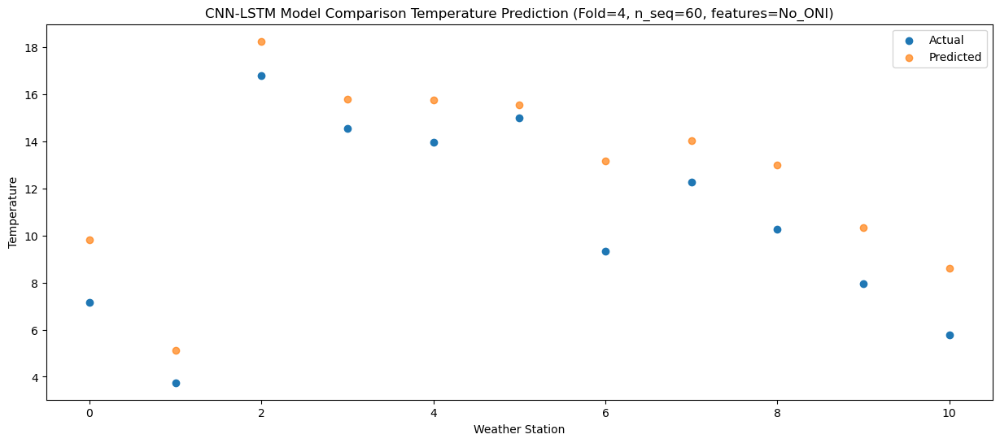

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.10   1.575230
1                 1   -3.41  -0.231256
2                 2    8.12  11.226896
3                 3    6.54   8.941856
4                 4    6.13   9.025677
5                 5    8.07   9.981604
6                 6    1.17   5.771147
7                 7    4.33   6.067562
8                 8   -0.59   3.596732
9                 9   -2.34   1.031175
10               10   -4.63  -0.877868


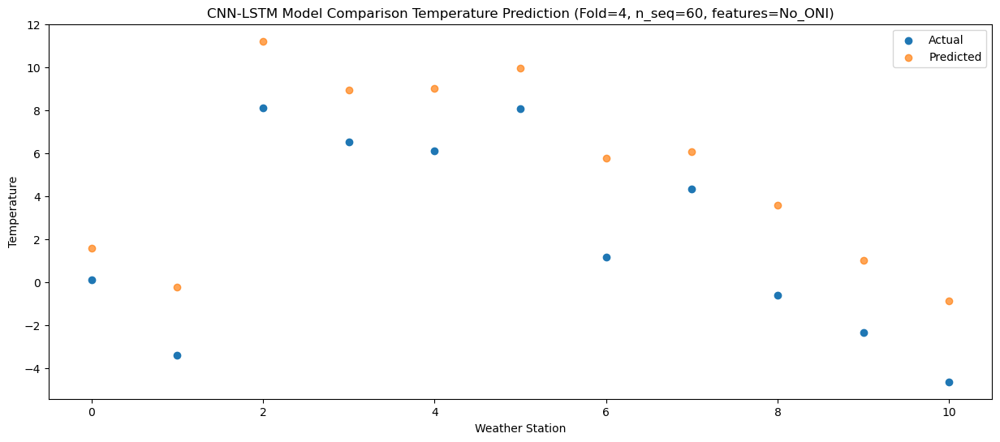

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.69   0.398343
1                 1   -1.61   1.985155
2                 2   11.63  13.793157
3                 3    8.54  10.129394
4                 4    7.87   9.884200
5                 5    8.48   9.697356
6                 6    3.08   7.578235
7                 7    5.79   7.139520
8                 8   -0.27   3.673134
9                 9   -2.59   0.506973
10               10   -5.49  -1.241893


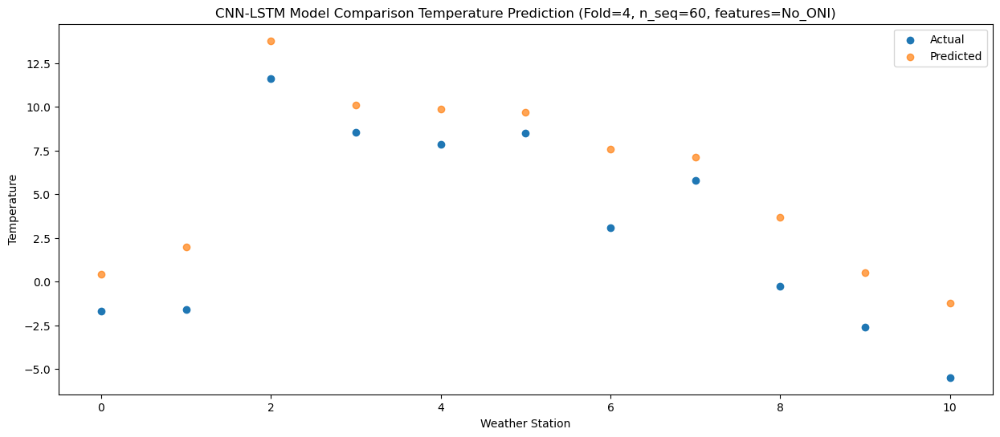

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.07  -6.809370
1                 1   -6.37  -2.230949
2                 2    3.35   6.997762
3                 3    0.07   3.453857
4                 4   -1.03   3.398976
5                 5    1.11   4.971091
6                 6   -2.98   1.295752
7                 7   -3.28  -0.344685
8                 8   -9.11  -4.332599
9                 9  -12.07  -7.537977
10               10  -14.32  -8.790312


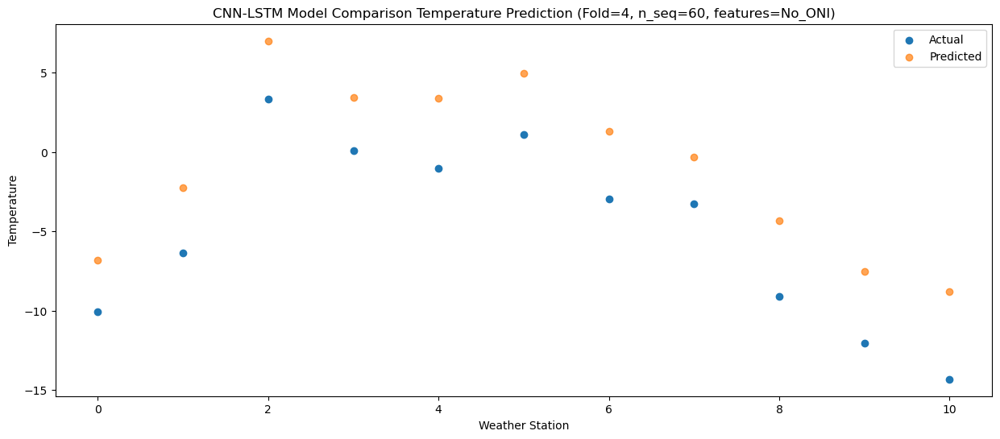

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -8.00  -5.923090
1                 1   -2.94  -0.922702
2                 2    5.71   7.941410
3                 3    0.33   3.733314
4                 4   -0.41   3.605759
5                 5    0.91   5.015882
6                 6    1.30   3.143526
7                 7   -1.22   0.644590
8                 8   -6.09  -2.075942
9                 9   -9.24  -5.744813
10               10  -10.76  -5.969465


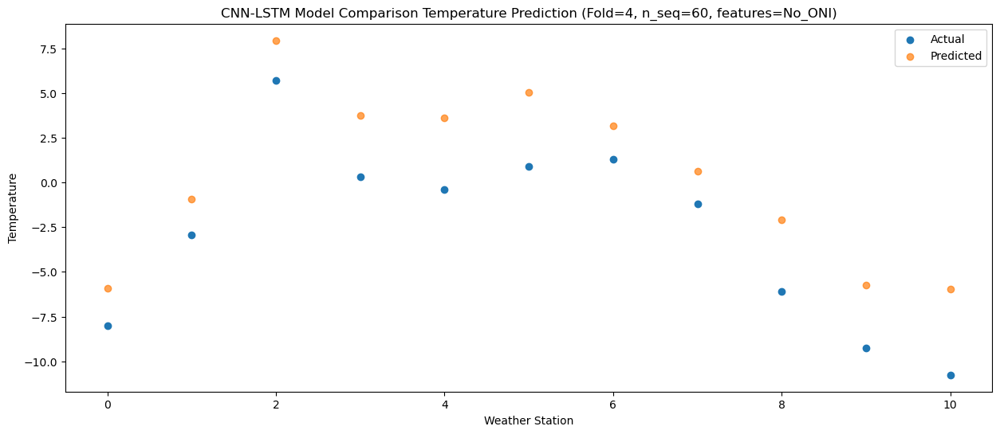

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -1.29   1.101285
1                 1   -0.12   2.074983
2                 2   10.45  13.049707
3                 3    6.51   9.728291
4                 4    6.51   9.639034
5                 5    8.23  10.300014
6                 6    4.86   7.583856
7                 7    5.44   6.893434
8                 8    1.38   4.185897
9                 9   -1.03   1.111560
10               10   -4.79  -0.279702


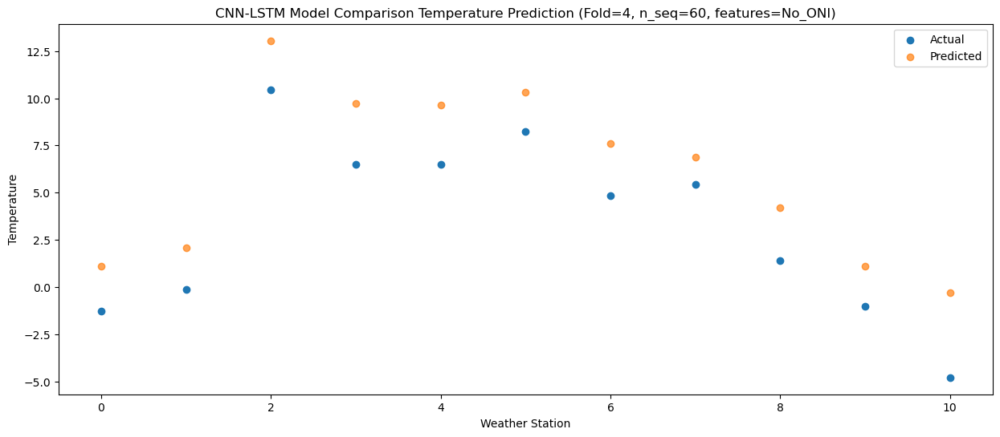

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.59   6.949741
1                 1    2.22   6.028499
2                 2   14.66  18.254138
3                 3   12.56  15.471006
4                 4   13.20  15.397293
5                 5   15.74  15.631404
6                 6    7.52  12.154244
7                 7    9.30  12.531431
8                 8    5.16   9.433539
9                 9    3.09   6.696028
10               10   -0.79   4.532956


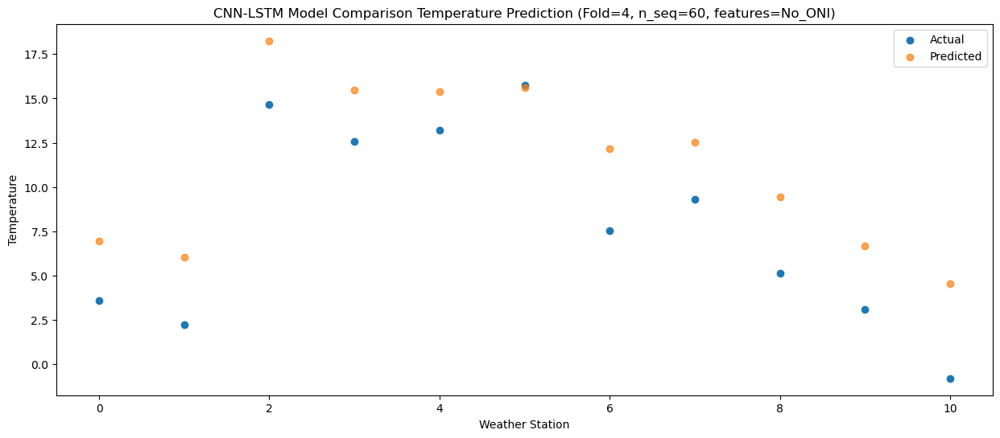

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.53  14.208335
1                 1    5.04   8.963116
2                 2   20.46  22.810213
3                 3   17.27  20.574743
4                 4   18.03  20.538327
5                 5   21.43  20.105058
6                 6   13.50  17.056029
7                 7   14.97  18.591166
8                 8   13.66  16.912096
9                 9   11.62  14.467817
10               10    7.79  12.072348


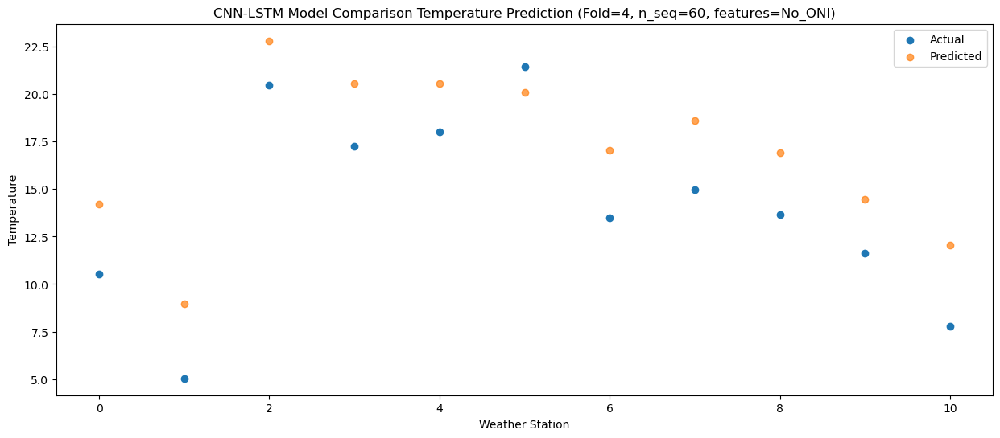

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   16.44  19.239412
1                 1    6.76  11.933498
2                 2   23.75  26.473114
3                 3   21.82  24.934517
4                 4   22.70  24.992202
5                 5   23.80  24.609524
6                 6   16.71  20.546132
7                 7   20.29  22.927299
8                 8   18.14  21.234758
9                 9   16.23  19.137503
10               10   11.06  16.220109


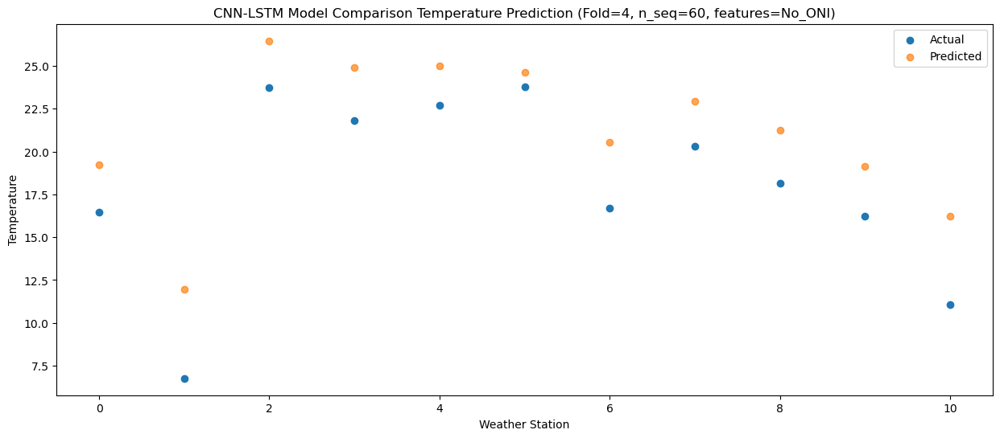

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   18.96  22.359251
1                 1    7.13  13.140115
2                 2   23.95  28.261703
3                 3   25.12  27.242677
4                 4   26.12  27.391872
5                 5   25.70  27.118319
6                 6   17.98  22.641335
7                 7   23.99  25.368229
8                 8   20.08  24.132277
9                 9   17.05  22.171255
10               10   13.66  19.295092


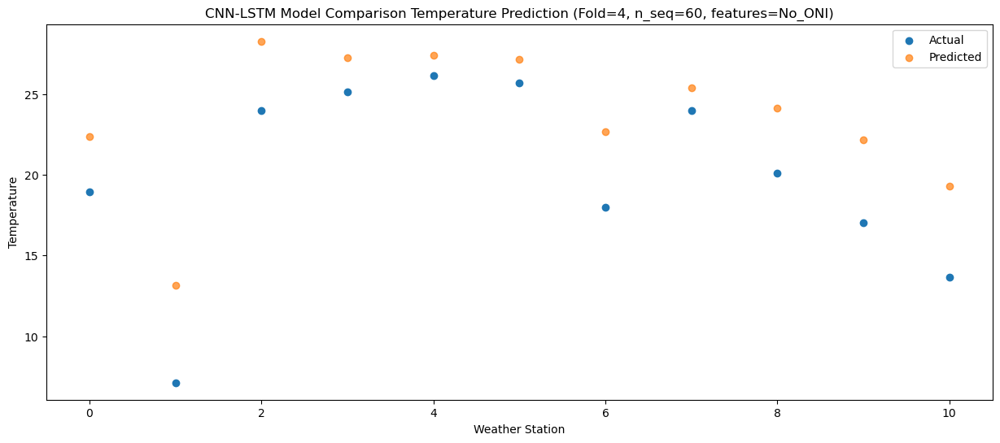

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.30  20.633482
1                 1    7.08  12.152739
2                 2   22.41  26.311140
3                 3   22.39  25.137404
4                 4   23.28  25.348382
5                 5   22.40  25.649860
6                 6   16.46  21.387629
7                 7   20.47  23.362681
8                 8   17.85  22.723336
9                 9   15.75  20.578531
10               10   12.59  18.405712


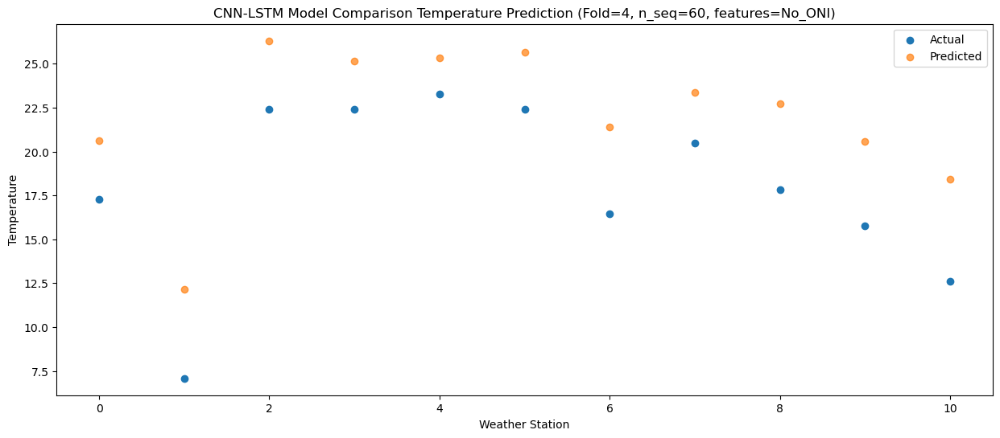

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   13.39  16.649711
1                 1    5.64  10.272778
2                 2   20.34  23.666101
3                 3   18.96  22.182080
4                 4   19.19  22.356385
5                 5   19.50  22.839380
6                 6   13.37  18.322174
7                 7   16.88  19.987998
8                 8   13.94  18.532942
9                 9   11.61  16.341140
10               10    8.54  13.957139


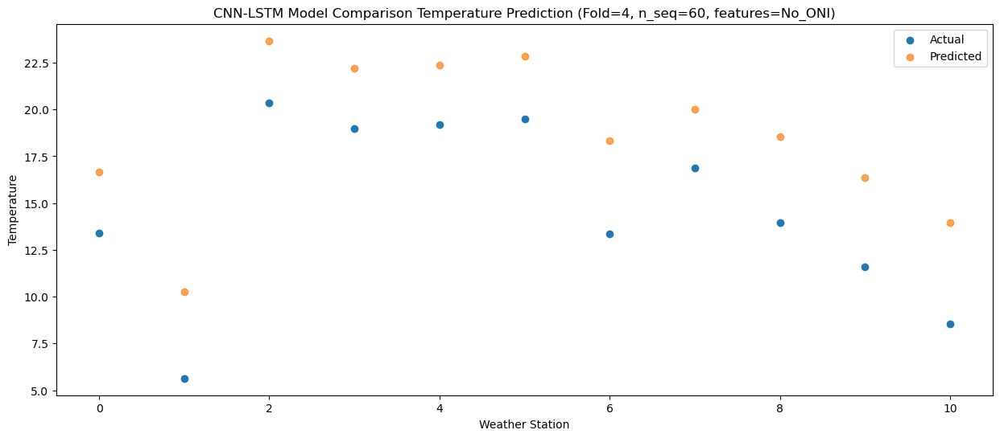

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    6.04   8.785595
1                 1    1.81   4.728858
2                 2   14.21  17.069955
3                 3   12.09  15.016034
4                 4   12.04  15.144310
5                 5   12.69  15.876061
6                 6    6.50  11.927056
7                 7   10.51  12.689033
8                 8    6.45  11.133234
9                 9    4.14   8.634900
10               10    1.68   6.766351


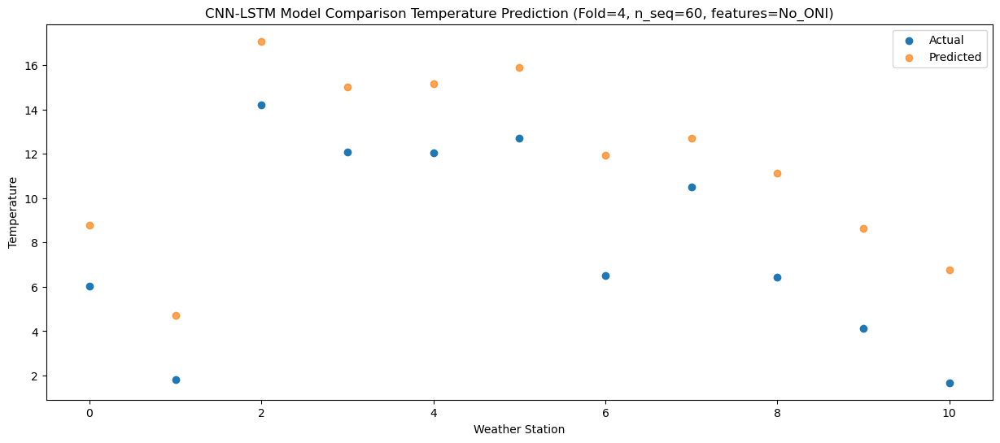

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -2.29   0.903101
1                 1    0.35   1.348357
2                 2    9.62  11.904022
3                 3    5.04   7.893646
4                 4    4.95   7.797521
5                 5    4.84   8.454170
6                 6    3.80   8.052359
7                 7    3.96   6.224933
8                 8    0.66   5.840238
9                 9   -1.40   2.186200
10               10   -2.40   2.387941


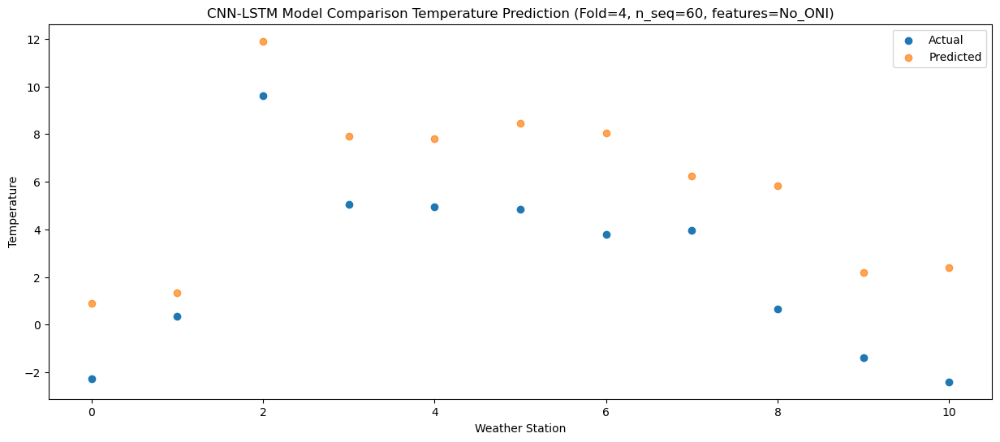

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -8.43  -3.646991
1                 1   -4.50  -0.553614
2                 2    7.19   9.395398
3                 3    2.35   5.340890
4                 4    1.98   5.222247
5                 5    3.24   6.240586
6                 6   -2.15   4.513386
7                 7   -0.89   2.645946
8                 8   -5.12   0.463971
9                 9   -8.13  -3.125520
10               10   -9.11  -3.519525


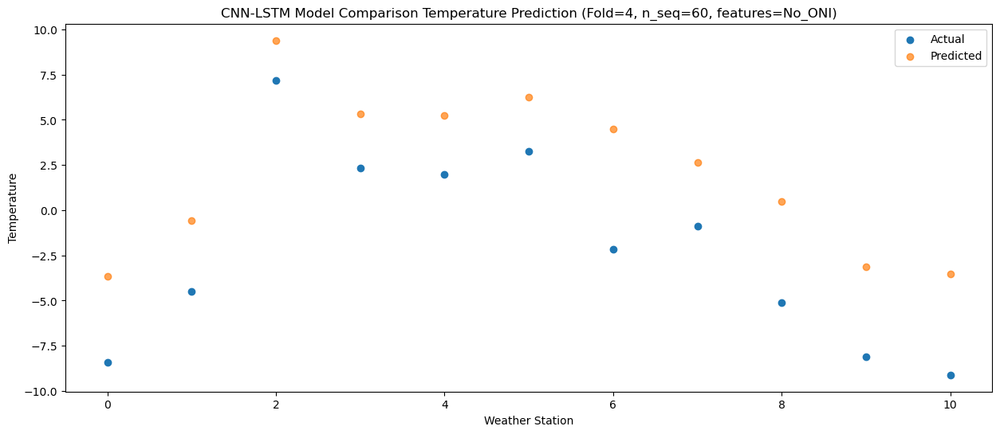

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.47  -2.225783
1                 1   -4.65   0.828290
2                 2    7.60  10.792988
3                 3    3.34   6.537090
4                 4    2.75   6.398683
5                 5    3.61   7.357124
6                 6    0.87   6.289020
7                 7    0.76   4.068585
8                 8   -3.16   2.355845
9                 9   -5.89  -1.414261
10               10   -7.48  -1.379858


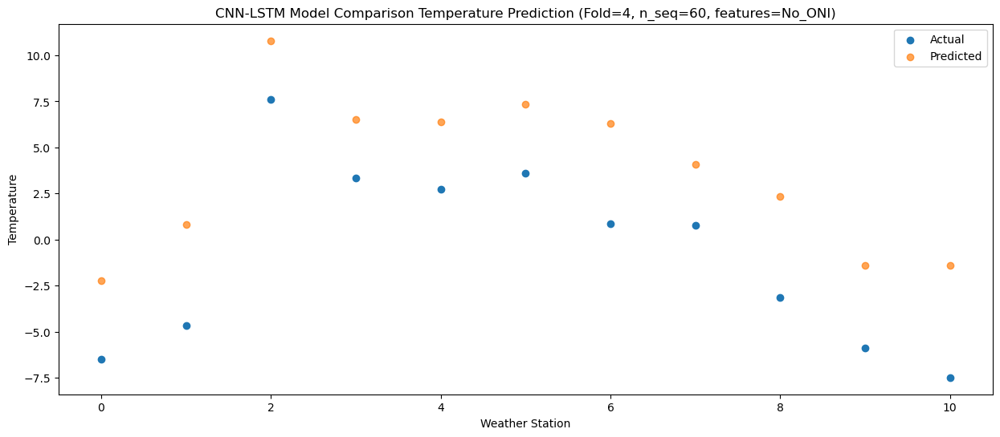

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -4.72  -2.182646
1                 1   -1.35   1.743408
2                 2    9.54  12.005873
3                 3    3.40   7.452294
4                 4    2.98   7.212386
5                 5    3.78   7.669500
6                 6    4.29   6.890556
7                 7    2.90   4.820109
8                 8   -1.57   2.307745
9                 9   -4.70  -1.440400
10               10   -7.34  -1.921494


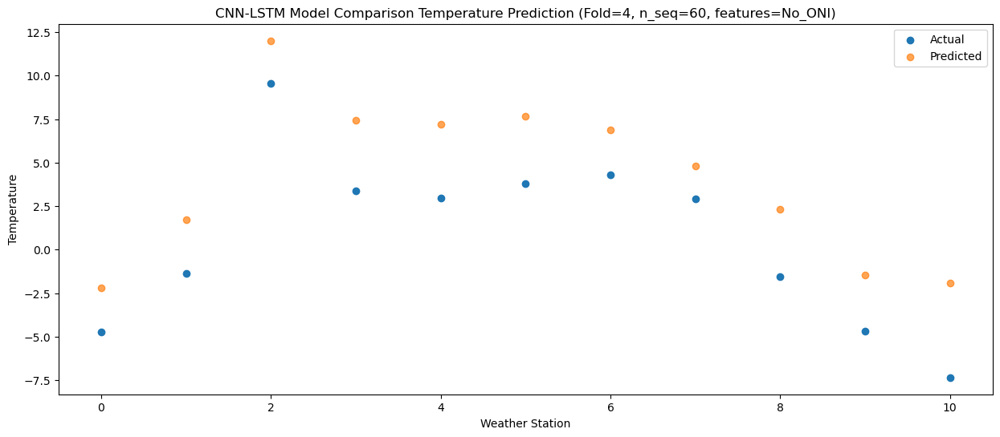

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.54   1.244765
1                 1    0.37   4.130514
2                 2   11.69  14.985891
3                 3    7.93  11.002491
4                 4    7.83  10.811135
5                 5    8.85  11.216351
6                 6    4.77   9.338028
7                 7    4.62   8.033725
8                 8   -0.30   4.894921
9                 9   -2.16   1.481086
10               10   -6.46   0.312046


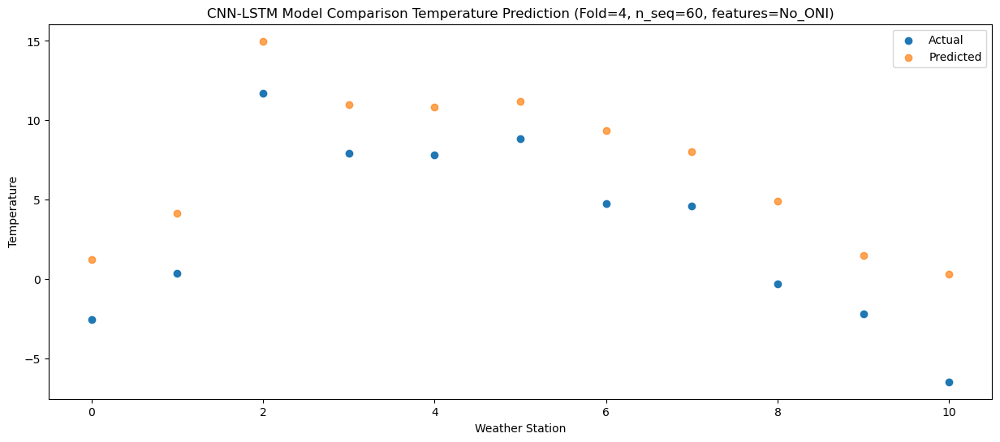

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    5.29   7.446017
1                 1    3.09   5.174957
2                 2   13.44  17.108990
3                 3   10.53  14.088162
4                 4   10.48  14.076921
5                 5   13.07  14.458948
6                 6    7.88  12.526924
7                 7   10.24  12.143007
8                 8    6.20  11.049074
9                 9    5.17   8.007750
10               10    2.01   6.966717


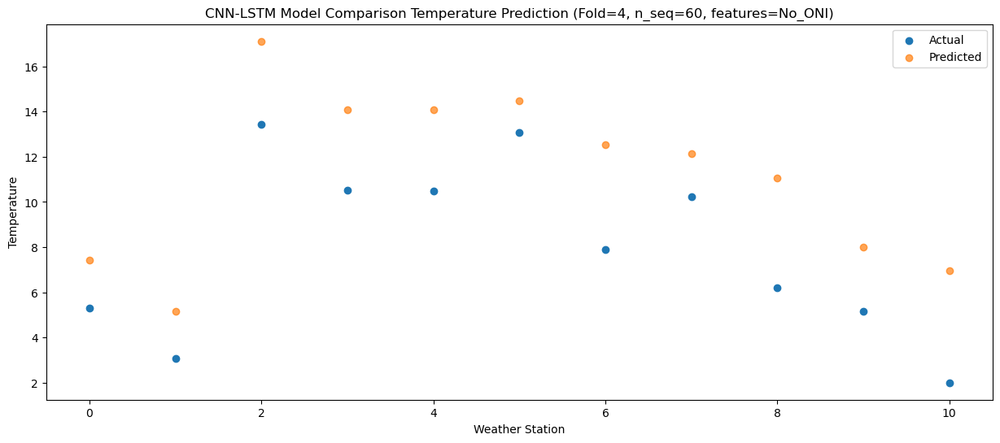

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   11.10  13.769706
1                 1    3.87   7.213063
2                 2   18.30  21.308663
3                 3   16.21  19.635494
4                 4   16.64  19.724838
5                 5   17.99  19.544896
6                 6   10.50  15.559567
7                 7   15.02  17.507079
8                 8   11.91  15.733300
9                 9   10.93  13.575107
10               10    5.70  10.782300


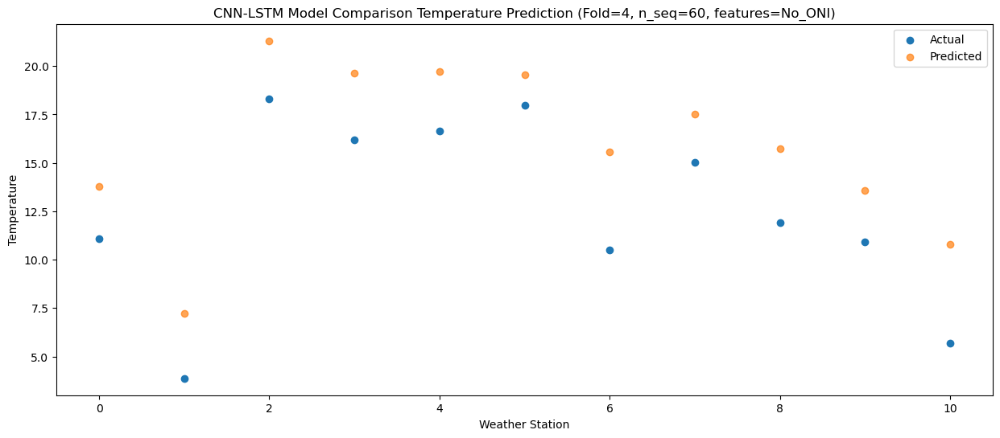

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.01  17.578415
1                 1    6.08   9.911762
2                 2   21.89  24.651594
3                 3   20.40  23.047006
4                 4   21.75  23.124440
5                 5   24.47  22.647693
6                 6   14.14  18.891176
7                 7   19.10  21.162884
8                 8   15.79  19.661771
9                 9   15.24  17.558208
10               10   10.01  14.666296


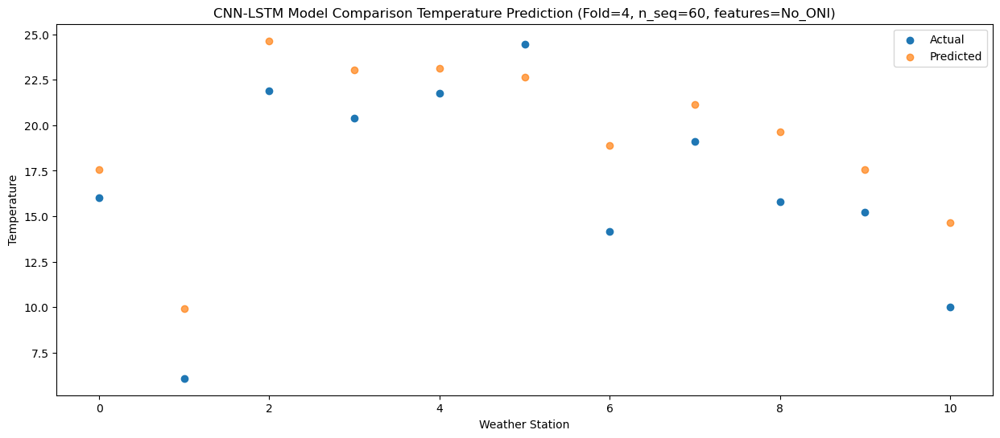

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   17.32  20.331639
1                 1    7.69  14.145949
2                 2   23.67  27.499103
3                 3   22.95  25.636256
4                 4   24.83  25.781717
5                 5   25.93  26.208425
6                 6   18.01  22.821845
7                 7   21.06  23.767432
8                 8   18.52  22.989460
9                 9   16.77  20.473705
10               10   13.10  18.805119


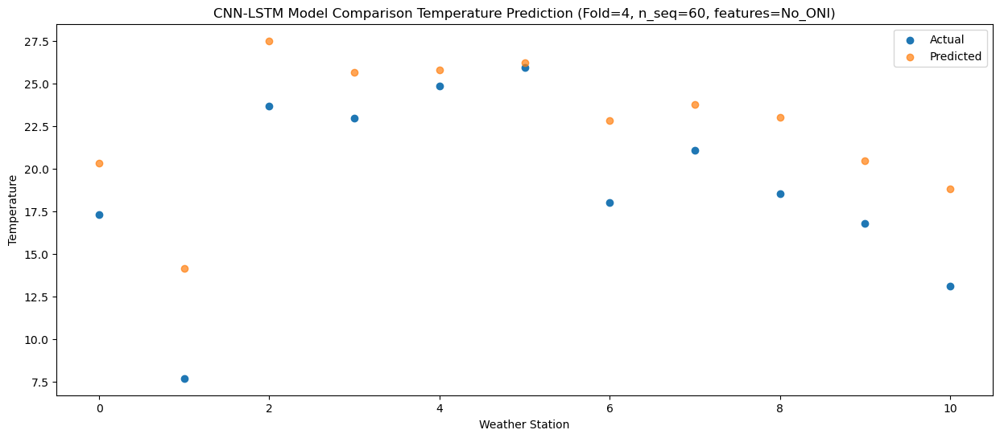

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.12  20.284040
1                 1    8.20  14.667759
2                 2   25.75  28.414533
3                 3   25.50  26.698045
4                 4   26.70  26.808316
5                 5   26.02  26.948530
6                 6   17.45  22.801230
7                 7   20.87  24.255272
8                 8   17.36  22.201603
9                 9   15.51  19.907164
10               10   11.77  17.420282


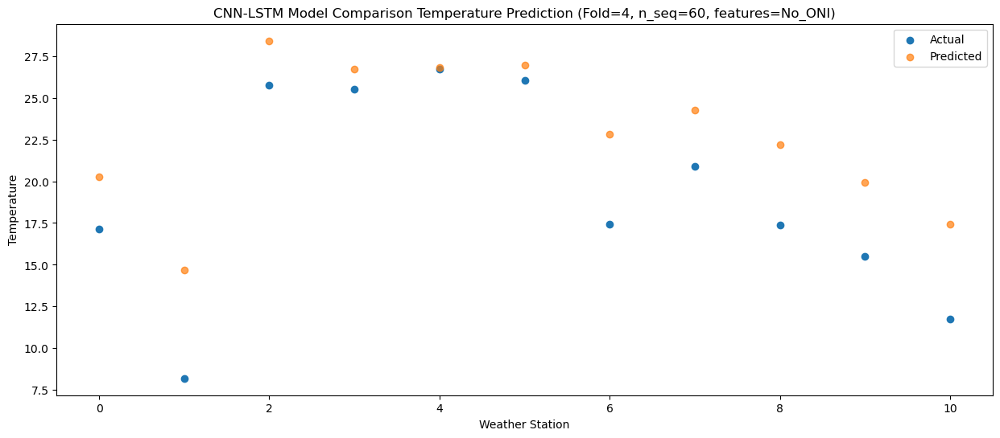

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.29  17.673436
1                 1    6.10  11.911672
2                 2   22.00  25.573549
3                 3   20.80  23.726893
4                 4   21.61  23.838851
5                 5   22.54  24.012309
6                 6   13.61  20.311110
7                 7   16.93  21.519822
8                 8   14.27  19.939722
9                 9   12.47  17.540743
10               10    9.43  15.407936


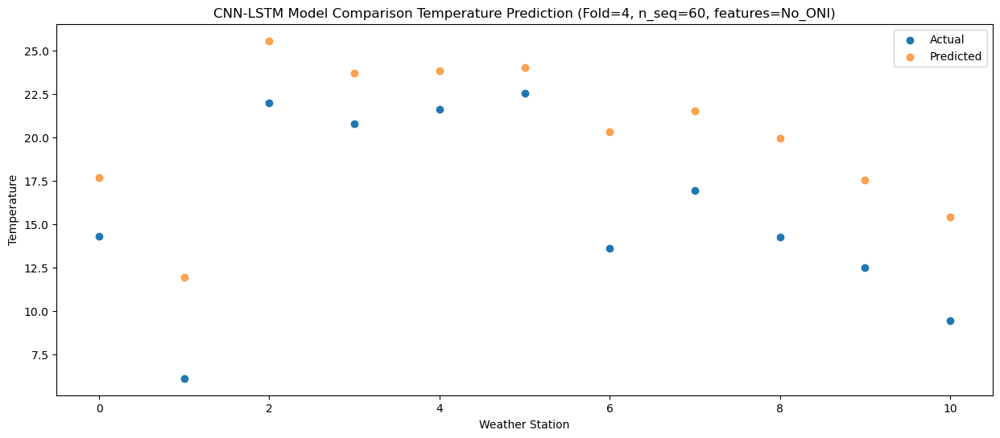

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    7.17  10.465192
1                 1    2.45   8.082096
2                 2   15.89  19.798458
3                 3   12.67  16.919730
4                 4   12.78  16.984807
5                 5   14.01  17.824206
6                 6    8.17  15.507741
7                 7   11.03  14.907818
8                 8    8.13  14.046708
9                 9    6.06  10.965700
10               10    4.17  10.267854


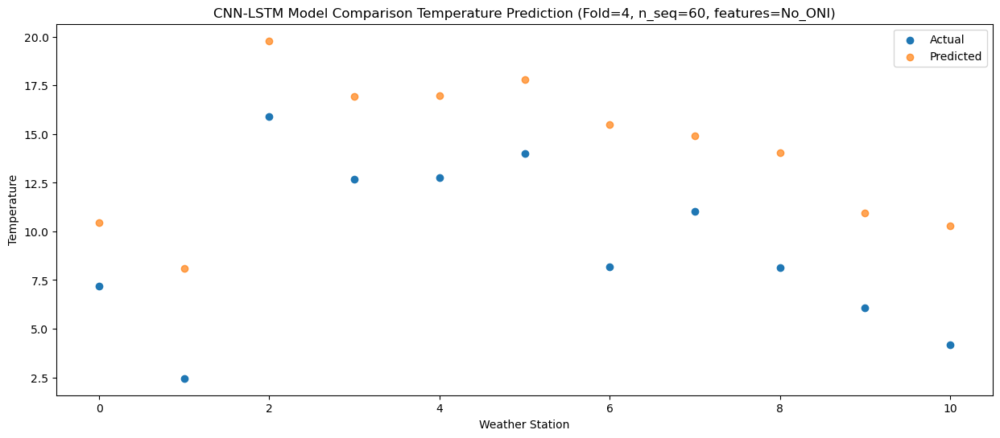

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.92   2.838019
1                 1   -1.26   2.322468
2                 2    8.93  13.358542
3                 3    6.60  10.189205
4                 4    6.25  10.220740
5                 5    7.30  11.209659
6                 6    2.44   8.675066
7                 7    5.13   7.826040
8                 8    1.06   6.169646
9                 9   -1.03   3.074924
10               10   -3.22   2.120011


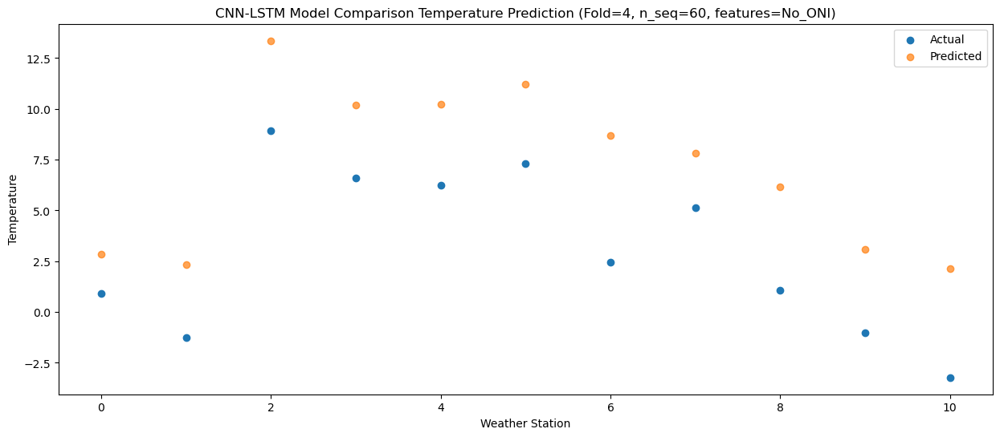

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.48   1.281573
1                 1   -3.38   0.707619
2                 2    6.38  11.431198
3                 3    3.58   8.052850
4                 4    3.12   8.085169
5                 5    4.50   9.271741
6                 6    0.23   7.439333
7                 7    2.25   6.058406
8                 8   -0.83   5.378342
9                 9   -3.02   2.022796
10               10   -3.88   1.868877


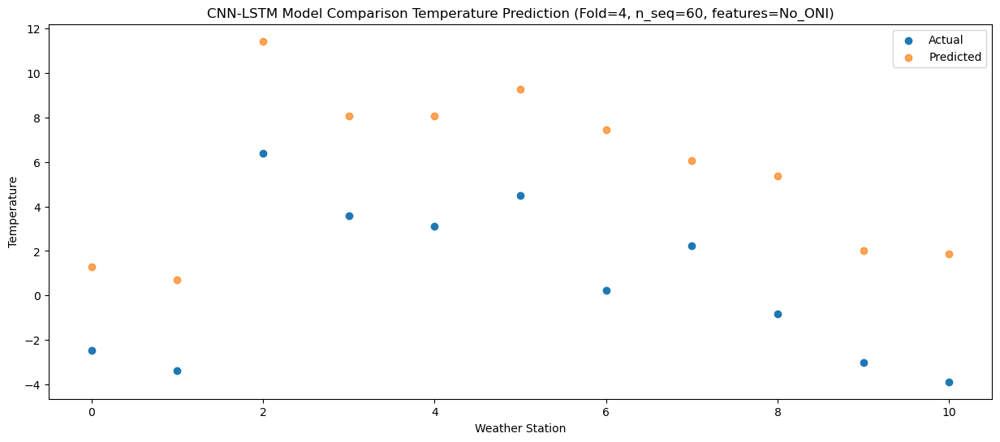

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -11.07  -4.815079
1                 1   -4.80   0.411553
2                 2    2.19   8.144477
3                 3   -1.94   3.540563
4                 4   -2.23   3.529495
5                 5    0.25   5.878921
6                 6   -2.21   4.965113
7                 7   -4.91   1.100279
8                 8   -7.11   0.223386
9                 9  -10.60  -3.917540
10               10   -9.65  -2.566249


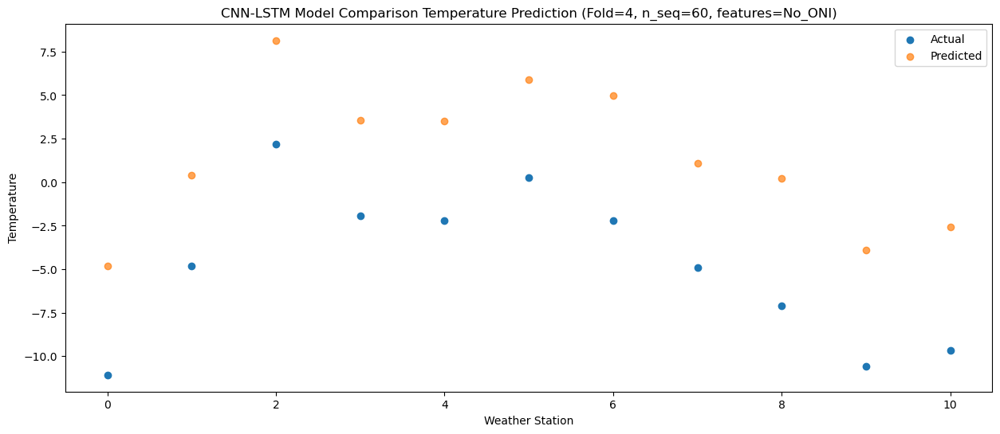

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.04   2.436026
1                 1   -5.07   2.268172
2                 2    8.51  13.908878
3                 3    6.47  10.804128
4                 4    6.09  10.768132
5                 5    7.07  11.444678
6                 6    1.20   8.311690
7                 7    5.00   8.017502
8                 8   -0.77   5.370144
9                 9   -2.83   2.406476
10               10   -6.17   0.768588


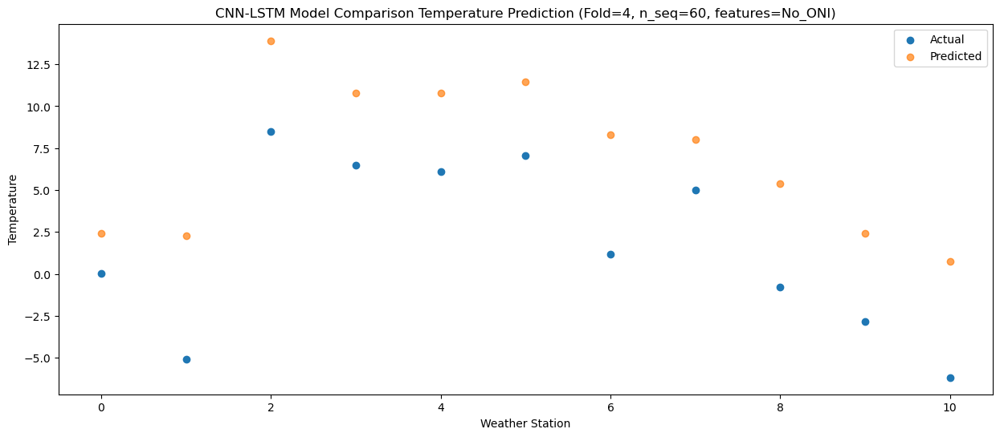

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.57   4.884617
1                 1   -0.17   5.427070
2                 2   10.74  16.757374
3                 3    8.88  13.149366
4                 4    8.66  13.056415
5                 5    9.67  13.660688
6                 6    4.99  11.670220
7                 7    7.43  10.707191
8                 8    3.67   8.672136
9                 9    1.32   5.372122
10               10   -2.82   4.416423


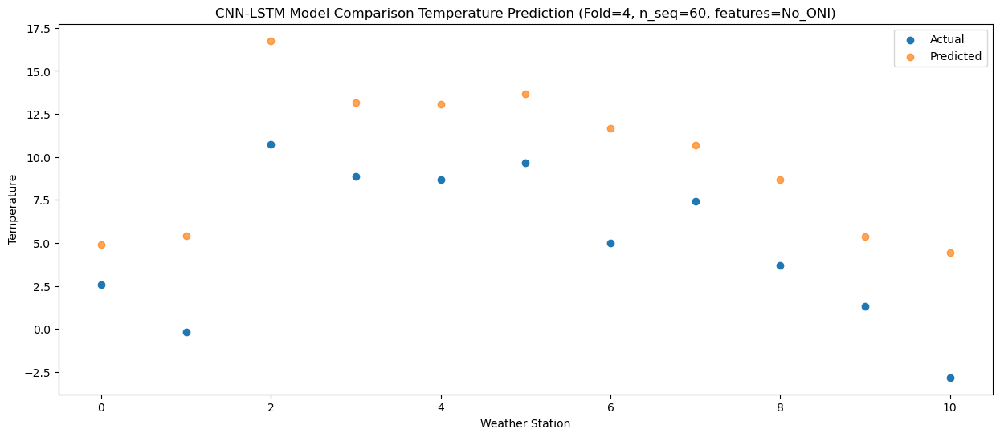

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    7.19  10.480100
1                 1    0.88   8.030313
2                 2   14.56  20.602621
3                 3   12.73  17.665765
4                 4   12.71  17.636998
5                 5   14.63  17.867153
6                 6    9.22  15.339243
7                 7   11.57  15.483589
8                 8    8.25  13.741632
9                 9    5.81  10.847175
10               10    2.90   9.248158


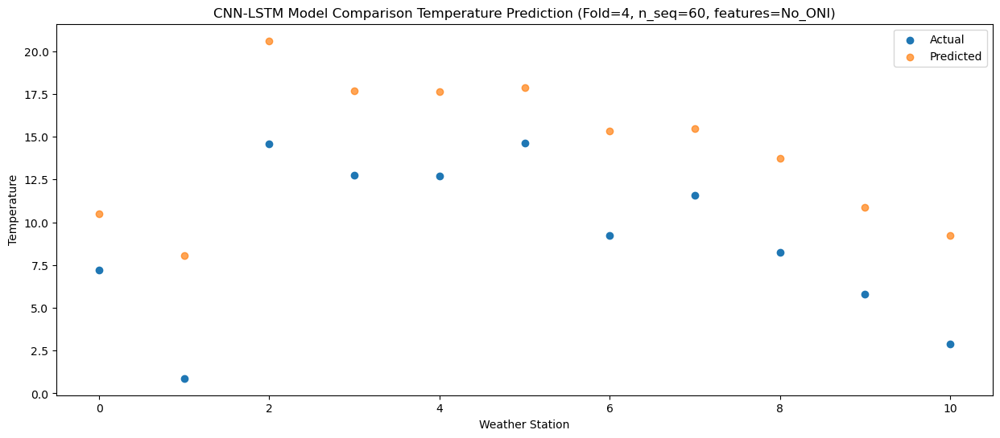

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   12.20  16.124968
1                 1    6.33  11.925893
2                 2   20.08  25.088768
3                 3   17.49  22.286565
4                 4   17.51  22.253760
5                 5   19.92  22.174003
6                 6   13.29  20.190500
7                 7   16.22  20.642192
8                 8   14.85  19.820850
9                 9   12.84  16.918988
10               10    9.00  15.525933


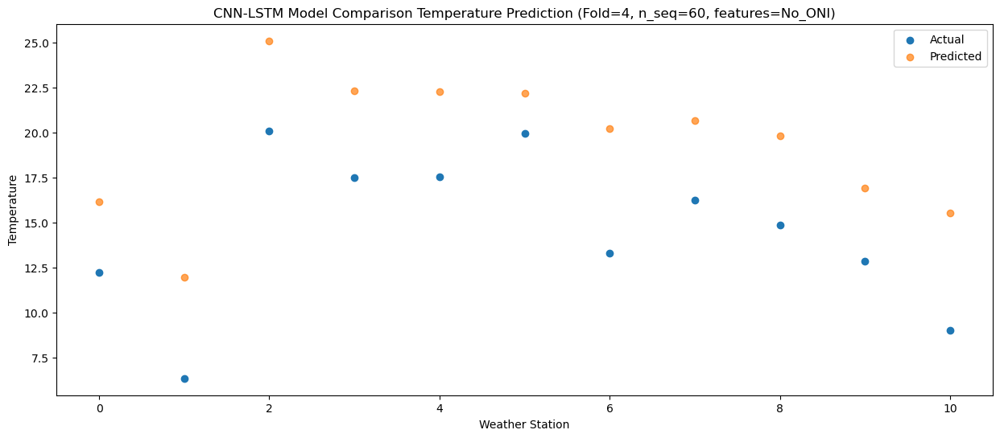

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.39  21.414489
1                 1    6.98  14.994071
2                 2   22.71  28.519366
3                 3   21.52  26.448222
4                 4   21.96  26.556110
5                 5   23.93  26.779573
6                 6   16.71  23.939033
7                 7   19.94  24.884646
8                 8   18.21  24.509345
9                 9   16.81  21.911885
10               10   12.16  20.358508


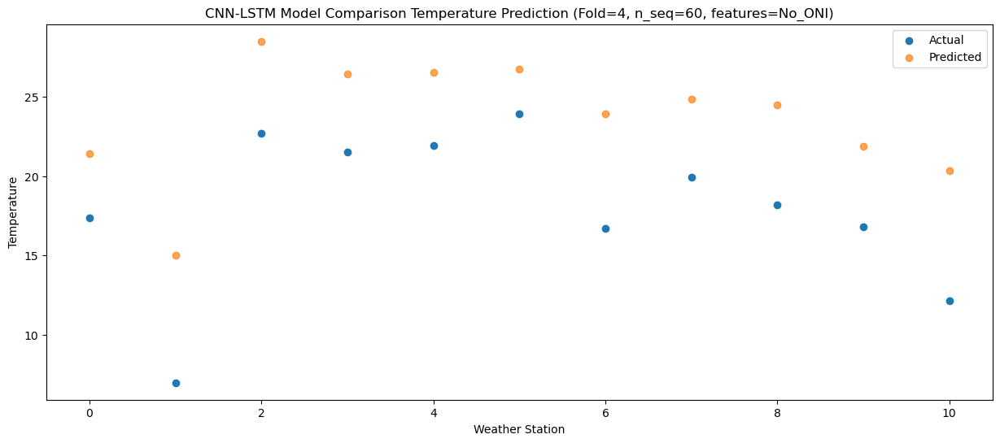

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.15  22.470519
1                 1    7.67  16.317995
2                 2   23.73  28.879549
3                 3   22.42  26.843610
4                 4   22.67  27.052945
5                 5   22.76  27.986215
6                 6   18.17  25.095741
7                 7   20.24  25.383143
8                 8   18.22  25.730111
9                 9   15.84  23.005809
10               10   13.68  22.175766


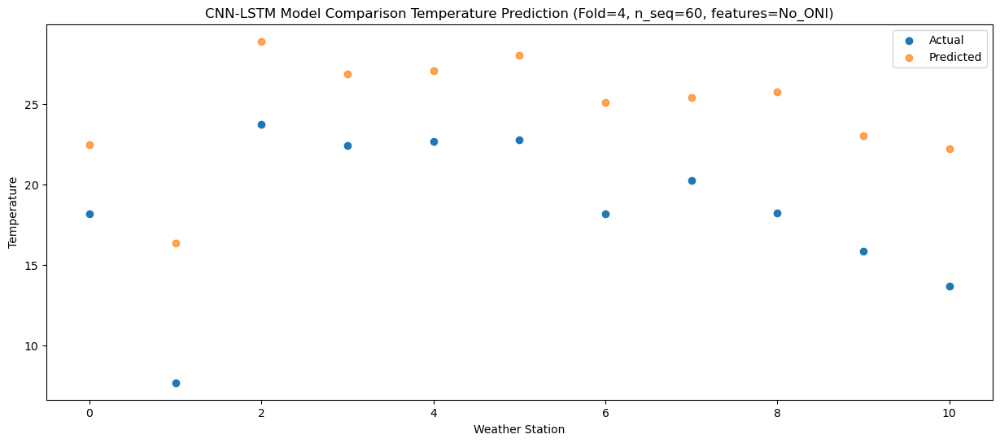

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   16.66  21.456423
1                 1    7.37  14.988809
2                 2   24.30  28.537822
3                 3   24.17  26.692145
4                 4   24.63  26.846745
5                 5   25.22  27.210816
6                 6   17.01  23.626255
7                 7   20.68  24.828500
8                 8   18.14  23.978724
9                 9   15.50  21.564579
10               10   12.54  19.622025


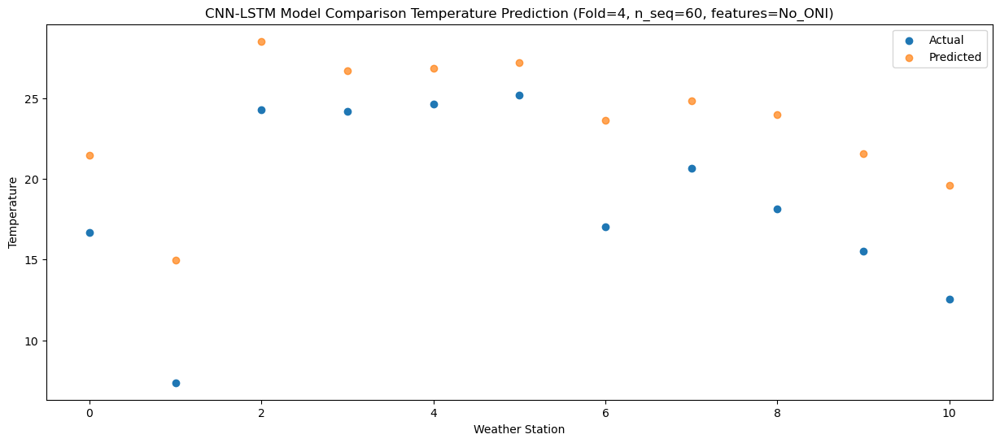

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.23  18.772094
1                 1    6.50  13.038957
2                 2   20.69  25.987580
3                 3   18.78  23.948344
4                 4   18.62  24.099484
5                 5   18.77  24.659476
6                 6   14.57  21.267635
7                 7   16.54  22.155178
8                 8   15.53  21.478290
9                 9   12.27  18.972402
10               10   10.27  17.264475


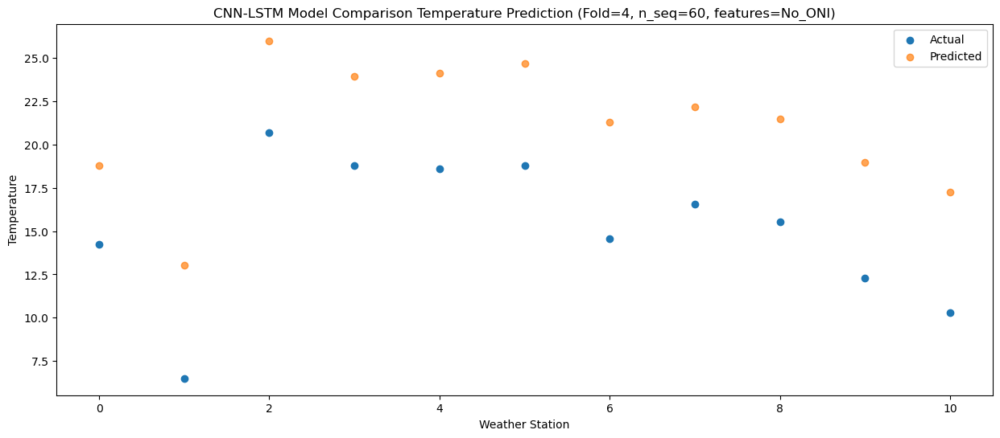

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   10.10  13.900703
1                 1    2.73  10.390594
2                 2   16.55  22.760254
3                 3   16.03  20.396271
4                 4   16.20  20.493851
5                 5   17.06  21.211791
6                 6    8.95  17.637214
7                 7   12.86  18.092494
8                 8    9.60  16.536561
9                 9    7.20  13.885194
10               10    3.80  12.175614


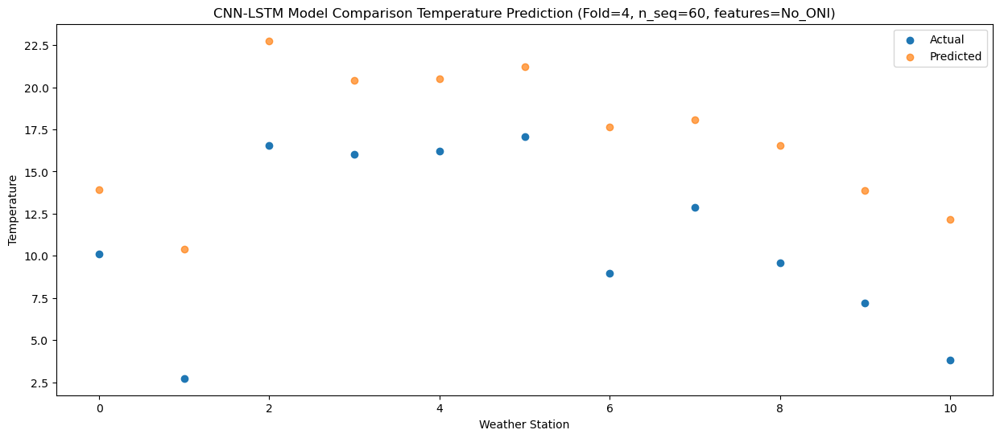

f, t:
[[ -2.86  -2.38   6.75   4.23   3.65   5.12   0.86   2.01  -2.64  -4.88
   -6.79]
 [ -4.52  -2.56   6.81   2.58   1.87   3.48   0.51   1.2   -3.46  -5.2
   -7.57]
 [ -7.48  -4.02   6.62   2.82   2.49   2.75   0.34  -0.45  -4.39  -7.64
   -8.77]
 [ -6.37  -2.47   6.88   2.49   2.11   1.99   0.81   0.12  -5.22  -7.89
   -9.58]
 [  1.16   1.6   14.68   9.95   9.99   9.55   6.42   7.05   1.6   -0.29
   -3.42]
 [  3.59   3.28  13.73  10.61  10.68  12.52   7.69   8.63   4.59   2.82
   -2.04]
 [  8.66   4.68  17.61  15.74  16.33  19.09  10.48  12.73  10.17   8.7
    4.7 ]
 [ 17.91   6.44  21.7   20.7   21.04  22.42  15.07  19.08  17.46  16.43
   11.19]
 [ 18.72   6.76  23.27  22.56  23.48  25.25  18.11  21.62  19.5   17.64
   14.63]
 [ 16.62   6.61  22.44  22.31  22.8   24.63  16.91  19.63  17.3   15.04
   12.22]
 [ 11.78   6.03  20.34  16.53  16.5   16.9   13.11  16.05  13.54  11.14
    8.23]
 [  3.73   4.53  15.    10.8   10.75  12.94   9.29   9.12   6.7    3.8
    2.07]
 [  1.54   1.

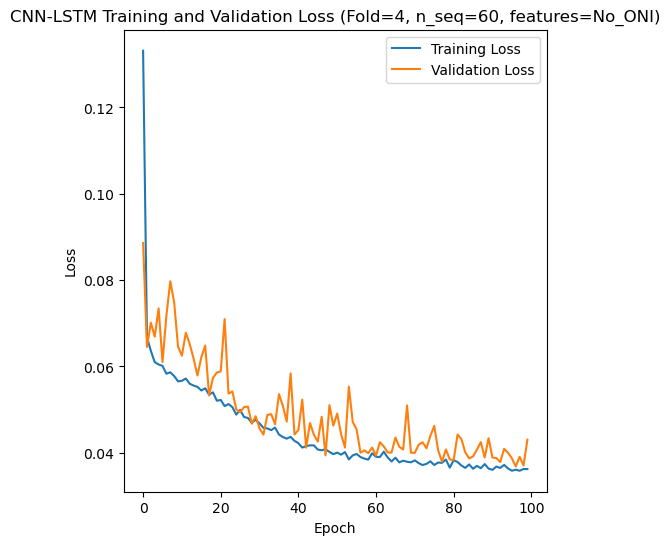

[[2.203461441775599], [2.6161874797015052], [2.813490790686997], [4.297177973222757], [3.6805219962910147]]
[[array(2.20346144)], [array(2.61618748)], [array(2.81349079)], [array(4.29717797)], [array(3.680522)]]
[[1.705106075402631], [2.1939613380369987], [2.319937026028887], [3.0421354377253946], [3.159077973451127]]
[[0.9604551428111885], [1.188541663221697], [0.9378207453481447], [1.4340223242746588], [1.1625818942245096]]
[[0.9219973402031435], [0.8940317361764603], [0.8887198333708848], [0.7897215586938944], [0.836665485880308]]
[[array(-0.19878168)], [array(0.46303071)], [array(0.13843671)], [array(0.52539449)], [array(0.39064148)]]
[[array(0.94958563)], [array(0.96796546)], [array(0.94752466)], [array(0.80272213)], [array(0.94809104)]]
[-2.98 -3.45 -3.72 ... 12.54 10.27  3.8 ]
[-2.36719509 -3.53935321 -4.3197278  ... 19.62202489 17.26447546
 12.17561352]
Accuracy Results:
RMSE for each fold:
[[2.203461441775599], [2.6161874797015052], [2.813490790686997], [4.297177973222757], [3

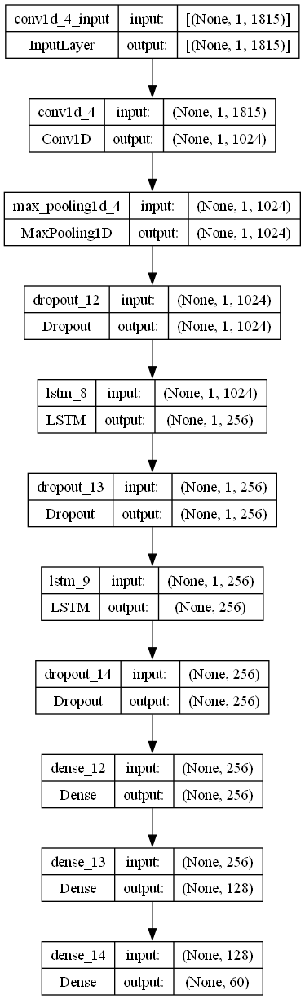

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 1024
    lr = 0.22687330685163667
    optimizer = SGD(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 256
    dropout_rate =  0.28713470692398485

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # Plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # Plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_CV_S60_No_ONI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)